In [ ]:
# %% Load data and packages

from pyspark import SparkContext, SparkConf
from pyspark.sql import SparkSession, Row
from pyspark.ml.linalg import Vectors
from pyspark.ml.feature import StandardScaler, PCA
from pyspark.ml.clustering import KMeans
from pyspark.ml.evaluation import ClusteringEvaluator
from pyspark.mllib.feature import StandardScaler as StandardScalerRDD
from pyspark.mllib.linalg.distributed import RowMatrix
import pyspark.sql.functions as F
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.animation as animation


spark = SparkSession \
        .builder \
        .appName("dr_cluster") \
        .getOrCreate()

# Read Spotify data
df = spark.read.csv('/home/mikezhu/music/data/spotify_dataset.csv', header=True)


# Note potentially relevant features like danceability, energy, acousticness, etc.
df.columns

24/11/23 21:07:02 WARN SparkSession: Using an existing Spark session; only runtime SQL configurations will take effect.


['id',
 'name',
 'popularity',
 'duration_ms',
 'explicit',
 'release_date',
 'danceability',
 'energy',
 'key',
 'loudness',
 'mode',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',
 'valence',
 'tempo',
 'time_signature',
 'artist']

In [ ]:
# %% column names

'''
['id',
 'name',
 'popularity',
 'duration_ms',
 'explicit', #ignore
 'release_date',
 'danceability',
 'energy',
 'key',
 'loudness',
 'mode',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',#ignore
 'valence',
 'tempo',
 'time_signature',
 'artist']
 '''

"\n['id',\n 'name',\n 'popularity',\n 'duration_ms',\n 'explicit', #ignore\n 'release_date',\n 'danceability',\n 'energy',\n 'key',\n 'loudness',\n 'mode',\n 'speechiness',\n 'acousticness',\n 'instrumentalness',\n 'liveness',#ignore\n 'valence',\n 'tempo',\n 'time_signature',\n 'artist']\n "

In [ ]:
# %% Data preprocessing

# identify potentially relevant features and add to a feature dataframe
feature_cols = [
    #'explicit',
    #'liveness',
    'duration_ms',
    'loudness',
    'key',
    'tempo', 
    'time_signature',
    'mode',
    'acousticness', 
    'instrumentalness',  
    'speechiness',
    'danceability', 
    'energy',
    'valence'
    ]

# select feature columns and numeric data as floats
df_features = df.select(*(F.col(c).cast("float").alias(c) for c in feature_cols),'id','name', 'artist') \
                         .dropna()
df_features = df_features.withColumn('features', F.array(*[F.col(c) for c in feature_cols])) \
                         .select('id','name', 'artist', 'features')

# convert features to dense vector format (expected by K-Means, PCA)
vectors = df_features.rdd.map(lambda row: Vectors.dense(row.features))
features = spark.createDataFrame(vectors.map(Row), ["features_unscaled"])

# scale features (some values like duration_ms are much larger than others)
standardizer = StandardScaler(inputCol="features_unscaled", outputCol="features")
model = standardizer.fit(features)
features = model.transform(features) \
                .select('features')

# persist in memory before fit model
features.persist()
features.printSchema()

root
 |-- features: vector (nullable = true)



In [ ]:
# %% K-means and PCA visualization functions

# try different numbers of clusters to find optimal k
def find_optimal_kmeans(features, k_values=range(3, 5)):
    """
    Find optimal k for KMeans clustering using silhouette scores
    
    Args:
        features: DataFrame with feature vectors
        k_values: Range of k values to try
        
    Returns:
        optimal_k: Optimal number of clusters
        kmeans_predictions: Predictions using optimal k
        silhouettes: List of silhouette scores for each k
    """
    silhouettes = []
    
    for k in k_values:
        # train model
        kmeans = KMeans(k=k, seed=1)
        model = kmeans.fit(features)
        
        # make predictions
        predictions = model.transform(features)
        
        # evaluate clustering
        evaluator = ClusteringEvaluator()
        silhouette = evaluator.evaluate(predictions)
        silhouettes.append(silhouette)
        print(f"Silhouette score for k={k}: {silhouette}")

    # Plot silhouette scores
    plt.figure(figsize=(10, 6))
    plt.plot(k_values, silhouettes, 'bo-')
    plt.xlabel('Number of Clusters (k)')
    plt.ylabel('Silhouette Score')
    plt.title('Silhouette Score vs Number of Clusters')
    plt.grid(True)
    
    # Add value labels on the points
    for k, silhouette in zip(k_values, silhouettes):
        plt.annotate(f'{silhouette:.3f}', 
                    (k, silhouette), 
                    textcoords="offset points", 
                    xytext=(0,10),
                    ha='center')
    
    plt.show()

    # find optimal k
    optimal_k = k_values[silhouettes.index(max(silhouettes))]
    print(f"\nOptimal number of clusters (k) = {optimal_k}")
    print(f"Best silhouette score = {max(silhouettes)}")
    
    # train final model with optimal k
    kmeans = KMeans(k=optimal_k, seed=1)
    kmeans_model = kmeans.fit(features)
    optimal_predictions = kmeans_model.transform(features)
    
    return optimal_k, optimal_predictions, silhouettes

def analyze_pca_composition(model_pca, feature_cols):
    """
    Analyze and visualize the composition of a trained PCA model using heatmap
    
    Args:
        model_pca: Trained PCA model
        feature_cols: List of original feature names
    """
    # Get principal components matrix
    pc_matrix = model_pca.pc.toArray()
    n_components = pc_matrix.shape[1]
    
    # Create DataFrame with component compositions
    components_df = pd.DataFrame(
        pc_matrix,
        columns=[f'PC{i}' for i in range(n_components)],
        index=feature_cols
    )
    
    # Plot heatmap
    plt.figure(figsize=(6, 8))
    im = plt.imshow(components_df, cmap='RdBu', aspect='auto')
    plt.colorbar(im, label='Component Weight')
    
    # Add value annotations
    for i in range(len(feature_cols)):
        for j in range(n_components):
            plt.text(j, i, f'{components_df.iloc[i, j]:.2f}',
                    ha='center', va='center')
    
    # Customize plot
    plt.xticks(range(n_components), components_df.columns)
    plt.yticks(range(len(feature_cols)), feature_cols)
    plt.title('PCA Components Composition')
    plt.xlabel('Principal Components')
    plt.ylabel('Original Features')
    
    plt.tight_layout()
    plt.show()
    
    return components_df

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


24/11/23 21:07:20 WARN LAPACK: Failed to load implementation from: com.github.fommil.netlib.NativeSystemLAPACK
24/11/23 21:07:20 WARN LAPACK: Failed to load implementation from: com.github.fommil.netlib.NativeRefLAPACK
Component 1 explained variance: 0.2370
Cumulative explained variance: 0.2370
Component 2 explained variance: 0.2246
Cumulative explained variance: 0.4616
Component 3 explained variance: 0.1010
Cumulative explained variance: 0.5626
Component 4 explained variance: 0.0838
Cumulative explained variance: 0.6463
Component 5 explained variance: 0.0818
Cumulative explained variance: 0.7281
Component 6 explained variance: 0.0715
Cumulative explained variance: 0.7996
Component 7 explained variance: 0.0641
Cumulative explained variance: 0.8637
Component 8 explained variance: 0.0599
Cumulative explained variance: 0.9236
Component 9 explained variance: 0.0337
Cumulative explained variance: 0.9572
Component 10 explained variance: 0.0269
Cumulative explained variance: 0.9841
Component 

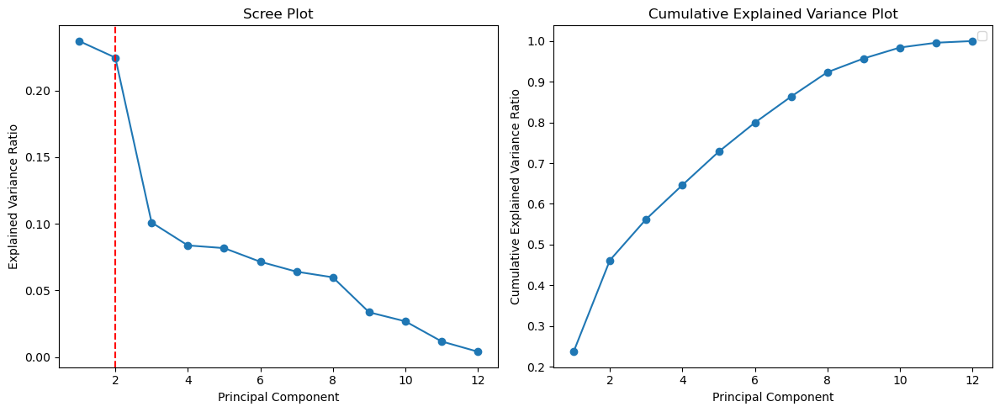

Optimal number of components: 2


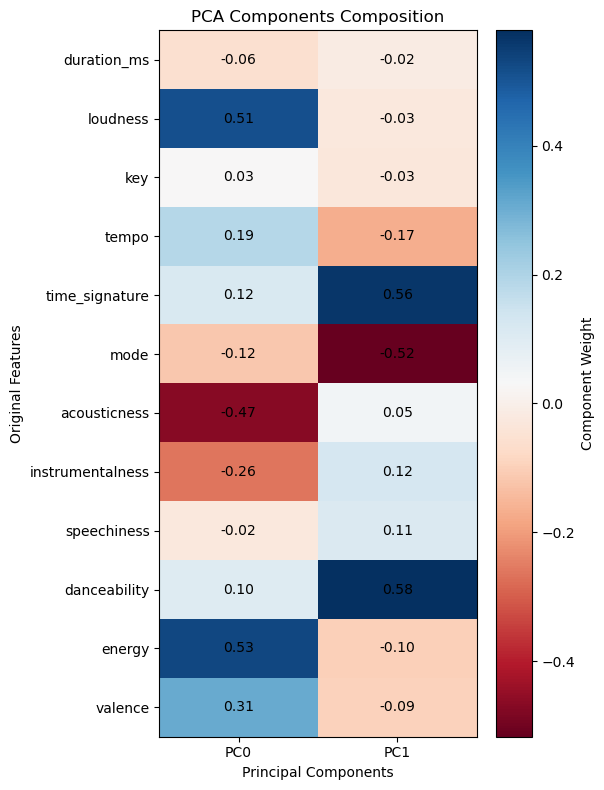

Silhouette score for k=3: 0.3628514767537176


Silhouette score for k=4: 0.6732810708951354


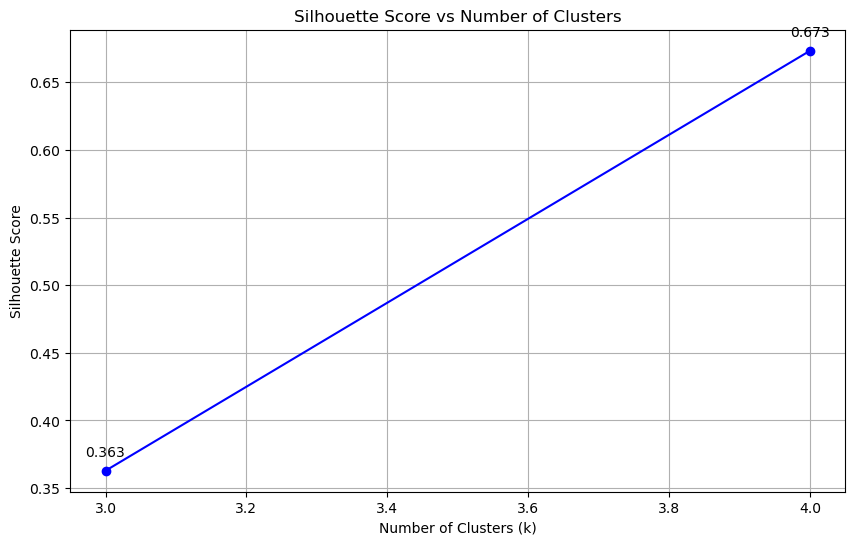


Optimal number of clusters (k) = 4
Best silhouette score = 0.6732810708951354


In [ ]:
# %% PCA-KMeans

def find_optimal_pca_components(features,threshold=0.9,k=None):
    """
    Find optimal number of PCA components by analyzing explained variance
    
    Args:
        features: DataFrame with feature vectors
        feature_cols: List of feature column names
        
    Returns:
        explained_variances: Array of explained variance ratios
        cumulative_variance: Array of cumulative explained variance ratios
    """
    n_features = features.first()["features"].size
    pca = PCA(k=n_features, inputCol="features", outputCol="pcaFeatures") 
    model = pca.fit(features)

    explained_variances = model.explainedVariance
    cumulative_variance = [sum(explained_variances[:i+1]) for i in range(len(explained_variances))]

    # Print variance explained by each component
    for i, var in enumerate(explained_variances):
        print(f"Component {i+1} explained variance: {var:.4f}")
        print(f"Cumulative explained variance: {cumulative_variance[i]:.4f}")

    # Find optimal number of components
    if k is None:
        optimal_n = next((i for i, cum_var in enumerate(cumulative_variance) if cum_var >= threshold), len(cumulative_variance))
    else:
        optimal_n = k

    # Plot explained variance analysis
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # Plot scree plot
    ax1.plot(range(1, len(explained_variances) + 1), explained_variances, marker='o')
    ax1.set_xlabel('Principal Component')
    ax1.set_ylabel('Explained Variance Ratio')
    ax1.set_title('Scree Plot')
    ax1.axvline(x=optimal_n, color='r', linestyle='--', label=f'Optimal number of components ({optimal_n})')

    # Plot cumulative variance
    ax2.plot(range(1, len(cumulative_variance) + 1), cumulative_variance, marker='o')
    # Add threshold line at 0.8
    if k is None:
        ax2.axhline(y=threshold, color='r', linestyle='--', label=f'Threshold ({threshold})')
    ax2.legend()
    ax2.set_xlabel('Principal Component')
    ax2.set_ylabel('Cumulative Explained Variance Ratio')
    ax2.set_title('Cumulative Explained Variance Plot')

    plt.tight_layout()
    plt.show()

    if k is None:
        print(f"Optimal number of components: {optimal_n}, threshold: {threshold}")
    else:
        print(f"Optimal number of components: {optimal_n}")

    # transform features according to optimal number of components
    pca = PCA(k=optimal_n, inputCol="features", outputCol="pcaFeatures") 
    model = pca.fit(features)

    pca_results = model.transform(features) \
                        .select('pcaFeatures')
    
    pca_features = pca_results.rdd.map(lambda row: Vectors.dense(row.pcaFeatures))
    pca_features = spark.createDataFrame(pca_features.map(Row), ["features"])

    return optimal_n, pca_features, explained_variances, cumulative_variance, model
# 1. PCA: find optimal number of components
optimal_n, features_pca, explained_variances, cumulative_variance, model_pca = find_optimal_pca_components(features,k=2)
components_df = analyze_pca_composition(model_pca, feature_cols)
# 2. KMeans: find optimal k, based on PCA-transformed features
features_pca.persist()
optimal_k_pca, kmeans_predictions_pca, silhouettes_pca = find_optimal_kmeans(features_pca)

In [ ]:
#%% merge cluster results

# merge to get cluster results
merged_results = kmeans_predictions_pca.withColumn("tmp_id", F.monotonically_increasing_id()) \
            .join(df_features.withColumn("tmp_id", F.monotonically_increasing_id()).withColumnRenamed("features", "raw_features"), on="tmp_id", how="inner").drop("tmp_id") \
            .join(df,on=["id","name","artist"],how="inner")
merged_results.show()
merged_results.count()
#examine cluster distribution
merged_results.groupby('prediction') \
               .count() \
               .show()
cluster_results=merged_results.filter(F.col("prediction") != 3)
cluster_results.groupby('prediction') \
               .count() \
               .show()

+--------------------+---------------------+--------------------+--------------------+----------+--------------------+----------+-----------+--------+------------+------------+------+---+--------+----+-----------+------------+----------------+--------+-------+-------+--------------+
|                  id|                 name|              artist|            features|prediction|        raw_features|popularity|duration_ms|explicit|release_date|danceability|energy|key|loudness|mode|speechiness|acousticness|instrumentalness|liveness|valence|  tempo|time_signature|
+--------------------+---------------------+--------------------+--------------------+----------+--------------------+----------+-----------+--------+------------+------------+------+---+--------+----+-----------+------------+----------------+--------+-------+-------+--------------+
|000KblXP5csWFFFsD...|               Podrás|       Tamara Castro|[0.83646507234205...|         2|[240013.0, -5.0, ...|        35|     240013|   fals

+----------+------+
|prediction| count|
+----------+------+
|         1|141078|
|         3|   969|
|         2|269051|
|         0|331126|
+----------+------+



+----------+------+
|prediction| count|
+----------+------+
|         1|141078|
|         2|269051|
|         0|331126|
+----------+------+



In [ ]:
#%% visualization functions

def exact_to_pd(cluster_full_data,artist_name=None,sample_size=0.1,seed=None):
    '''extract a subset of data, for visualization'''
    num_clusters = cluster_full_data.select('prediction').distinct().count()
    colors = plt.cm.Dark2(np.linspace(0, 1, num_clusters))
    if artist_name is None:
        if seed is None:
            cluster_data = cluster_full_data.sample(False, sample_size)  
        else:
            cluster_data = cluster_full_data.sample(False, sample_size, seed=seed)  
    else:
        cluster_data = cluster_full_data.filter(F.col("artist") == artist_name)
    cluster_data = cluster_data.toPandas()
    cluster_data['year'] = pd.to_datetime(cluster_data['release_date']).dt.year
    return num_clusters,colors,cluster_data

def plot_cluster_distribution(cluster_data,artist_name=None,sample_size=0.1,seed=None):
    """Plot distribution of songs across clusters"""
    num_clusters,colors,cluster_data=exact_to_pd(cluster_data,artist_name,sample_size,seed)
 
    all_clusters = pd.Series(0, index=range(num_clusters))
    cluster_counts = cluster_data['prediction'].value_counts()
    cluster_counts = cluster_counts.combine_first(all_clusters)
    cluster_counts = cluster_counts.sort_index()
    
    plt.figure(figsize=(10, 6))
    bars = plt.bar(cluster_counts.index, cluster_counts.values)
    for i, bar in enumerate(bars):
        bar.set_color(colors[i])
        
    plt.xlabel('Cluster')
    plt.ylabel('Number of Songs')
    plt.title(f'Distribution of Songs Across Clusters')
    plt.show()
    
    return cluster_counts

def plot_cluster_evolution(cluster_data, artist_name=None, sample_size=0.1, seed=None):
    """Plot evolution of clusters over time"""
    num_clusters, colors, cluster_data = exact_to_pd(cluster_data, artist_name, sample_size, seed)
    
    # Calculate proportion of each cluster per year
    yearly_proportions = cluster_data.pivot_table(
        index='year',
        columns='prediction',
        aggfunc='size',
        fill_value=0
    )
    yearly_proportions = yearly_proportions.div(yearly_proportions.sum(axis=1), axis=0)
    
    fig, ax = plt.subplots(figsize=(10, 6))
    
    # Plot each cluster separately to ensure correct color mapping
    bottom = np.zeros(len(yearly_proportions))
    for cluster in range(num_clusters):
        if cluster in yearly_proportions.columns:
            values = yearly_proportions[cluster].values
            ax.fill_between(yearly_proportions.index, bottom, bottom + values, 
                          alpha=0.7, label=f'Cluster {cluster}',
                          color=colors[cluster])
            bottom += values
    
    plt.xlabel('Year')
    plt.ylabel('Proportion of Songs')
    plt.title('Evolution of Song Clusters Over Time')
    plt.legend()
    plt.show()

def plot_cluster_scatter(cluster_data, artist_name=None, dim_1=0, dim_2=1,sample_size=0.1,seed=None):
    """Plot scatter of clusters in PCA space"""
    num_clusters, colors,cluster_data=exact_to_pd(cluster_data, artist_name,sample_size,seed)
    markers = ['o', 's', '^', 'v', 'D', 'p', 'h']
    plt.figure(figsize=(10, 8))
    for cluster in range(num_clusters):
        plot_data = cluster_data[cluster_data["prediction"] == cluster]
        plt.scatter(plot_data["features"].apply(lambda x: float(x[dim_1])),
                   plot_data["features"].apply(lambda x: float(x[dim_2])),
                   c=[colors[cluster]], 
                   marker=markers[cluster % len(markers)],
                   label=f'Cluster {cluster}',
                   s=100)
        for _, row in plot_data.iterrows():
            plt.annotate(row["name"], 
                        (float(row["features"][dim_1]), float(row["features"][dim_2])),
                    xytext=(5, 5),
                        textcoords='offset points',
                        bbox=dict(facecolor='white', edgecolor='none', alpha=0.7),
                        fontsize=8)
    plt.xlabel(f"Component {dim_1}")
    plt.ylabel(f"Component {dim_2}")
    plt.title("Songs Clustered in Dimensionally Reduced Space")
    plt.legend()
    plt.show()

def plot_cluster_radar(cluster_data, artist_name=None,sample_size=0.1,seed=None):
    """
    Create a radar plot to compare cluster centroids with standardized features
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
    """
    # Extract data and get number of clusters
    num_clusters, colors, cluster_data = exact_to_pd(cluster_data, artist_name,sample_size,seed)
    
    # Get feature values from the features column
    feature_values = pd.DataFrame(cluster_data['raw_features'].tolist(), 
                                columns=feature_cols)
    
    # Calculate global means and standard deviations for standardization
    global_means = feature_values[feature_cols].mean()
    global_stds = feature_values[feature_cols].std()
    
    # Standardize features
    standardized_values = feature_values.copy()
    for col in feature_cols:
        if global_stds[col] > 0:  # Avoid division by zero
            standardized_values[col] = (feature_values[col] - global_means[col]) / global_stds[col]
        else:
            standardized_values[col] = N
    
    # Add prediction column
    standardized_values['prediction'] = cluster_data['prediction']
    
    # Calculate mean values for each cluster using standardized features
    cluster_means = standardized_values.groupby('prediction')[feature_cols].mean()
    
    # Set up the angles for radar plot
    angles = np.linspace(0, 2*np.pi, len(feature_cols), endpoint=False)
    angles = np.concatenate((angles, [angles[0]]))  # Close the circle
    
    # Set up the plot
    fig, ax = plt.subplots(figsize=(10, 10), subplot_kw=dict(projection='polar'))
    
    # Plot data for each cluster
    for cluster in range(num_clusters):
        if cluster in cluster_means.index:
            values = cluster_means.loc[cluster].values
            values = np.concatenate((values, [values[0]]))  # Close the polygon
            
            ax.plot(angles, values, 'o-', linewidth=2, 
                   label=f'Cluster {cluster}', 
                   color=colors[cluster])
            ax.fill(angles, values, alpha=0.25, color=colors[cluster])

    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(feature_cols, size=15)
    plt.legend(loc='upper right', bbox_to_anchor=(0.1, 0.1), fontsize=12)
    title = "Cluster Characteristics"
    if artist_name:
        title += f" for {artist_name}"
    plt.title(title, fontsize=17)
    plt.tight_layout()
    plt.show()
    
    return cluster_means

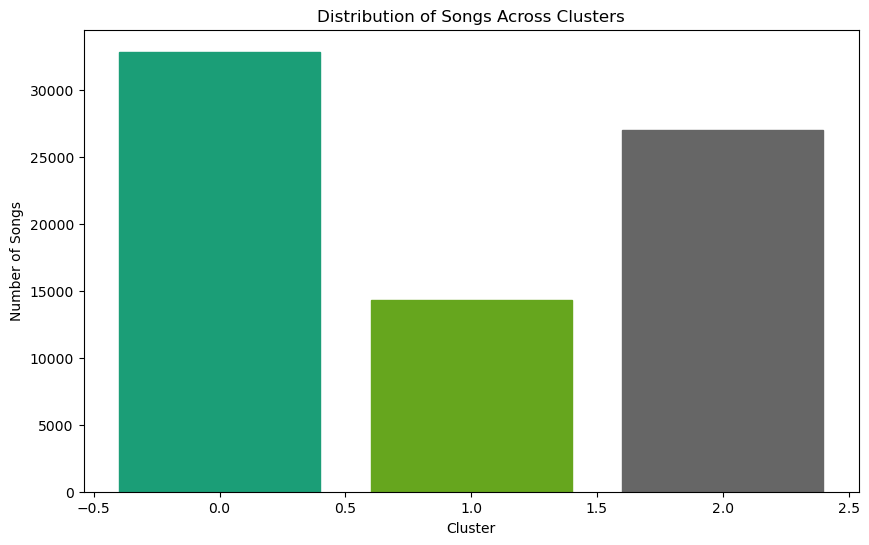

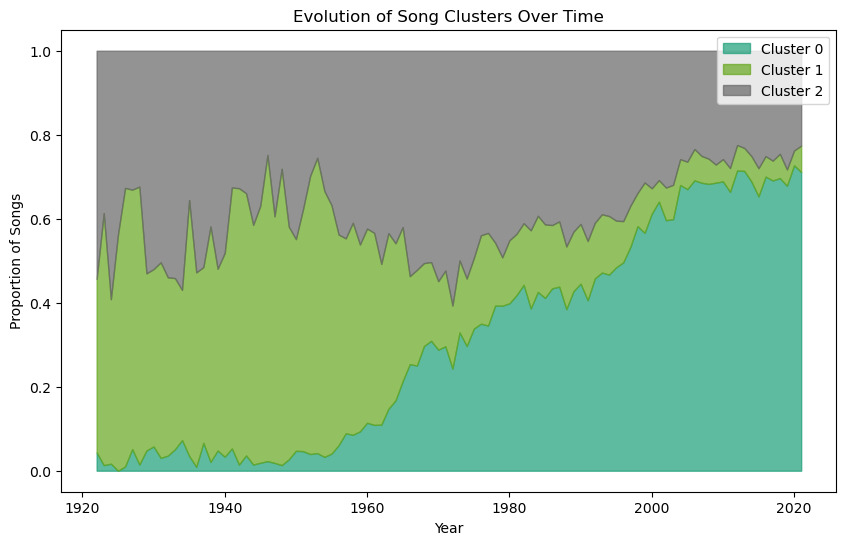

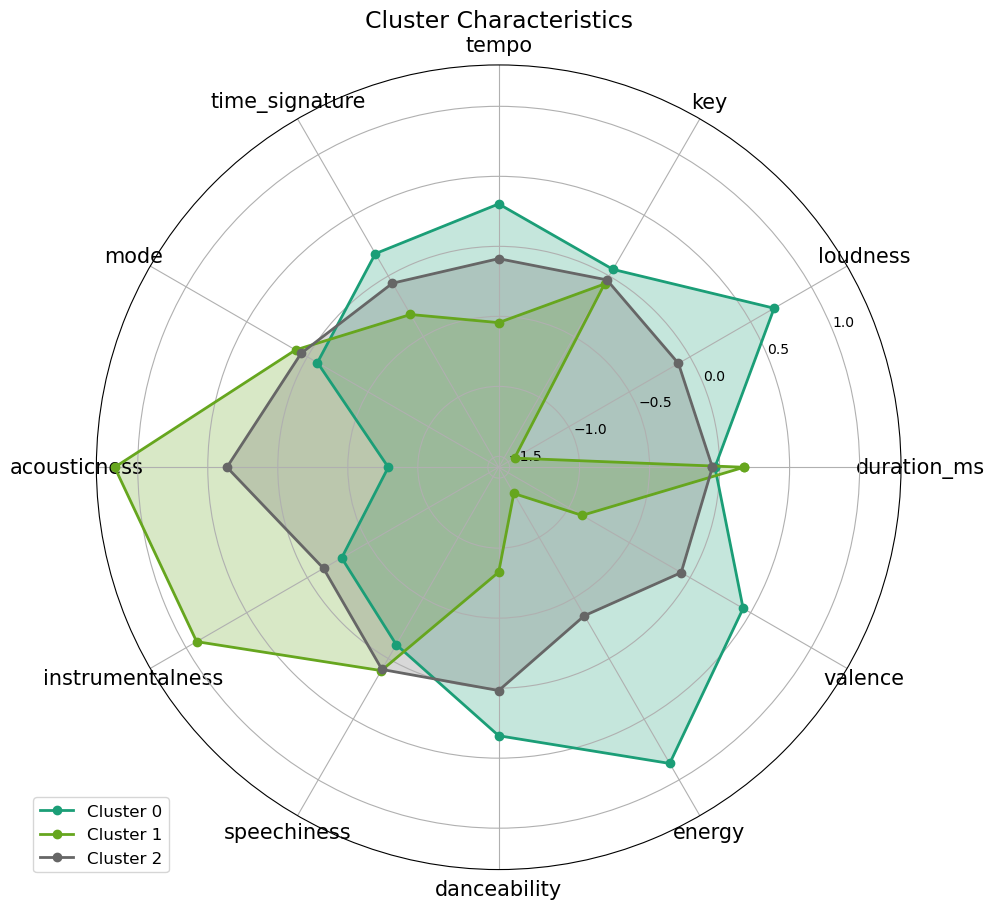

'\n#plot_cluster_scatter(cluster_results) # too many points\n#individual\nplot_cluster_distribution(cluster_results,"Coldplay")\nplot_cluster_evolution(cluster_results,"Coldplay")\nplot_cluster_scatter(cluster_results,"Coldplay")\nplot_cluster_radar(cluster_results,"Coldplay")\n\nplot_cluster_distribution(cluster_results,"Taylor Swift")\nplot_cluster_evolution(cluster_results,"Taylor Swift")\nplot_cluster_scatter(cluster_results,"Taylor Swift")\nplot_cluster_radar(cluster_results,"Taylor Swift")\n\n'

In [ ]:
#%% visualization

#global
plot_cluster_distribution(cluster_results)
plot_cluster_evolution(cluster_results)
plot_cluster_radar(cluster_results)
'''
#plot_cluster_scatter(cluster_results) # too many points
#individual
plot_cluster_distribution(cluster_results,"Coldplay")
plot_cluster_evolution(cluster_results,"Coldplay")
plot_cluster_scatter(cluster_results,"Coldplay")
plot_cluster_radar(cluster_results,"Coldplay")

plot_cluster_distribution(cluster_results,"Taylor Swift")
plot_cluster_evolution(cluster_results,"Taylor Swift")
plot_cluster_scatter(cluster_results,"Taylor Swift")
plot_cluster_radar(cluster_results,"Taylor Swift")

'''

In [ ]:
# %% more artists

'''
plot_cluster_scatter(cluster_results,"Oasis")
plot_cluster_radar(cluster_results,"Oasis")
plot_cluster_evolution(cluster_results,"Oasis")
plot_cluster_distribution(cluster_results,"Oasis")
plot_cluster_distribution(cluster_results,"Metallica")
plot_cluster_scatter(cluster_results,"Metallica")
plot_cluster_radar(cluster_results,"Metallica")
plot_cluster_evolution(cluster_results,"Metallica")
plot_cluster_distribution(cluster_results,"Pink Floyd")
plot_cluster_scatter(cluster_results,"Pink Floyd")
plot_cluster_radar(cluster_results,"Pink Floyd")
plot_cluster_evolution(cluster_results,"Pink Floyd")
plot_cluster_distribution(cluster_results,"Radiohead")
plot_cluster_scatter(cluster_results,"Radiohead")
plot_cluster_radar(cluster_results,"Radiohead")
plot_cluster_evolution(cluster_results,"Radiohead")
plot_cluster_distribution(cluster_results,"Blur")
plot_cluster_scatter(cluster_results,"Blur")
plot_cluster_radar(cluster_results,"Blur")
plot_cluster_evolution(cluster_results,"Blur")
'''

'\nplot_cluster_scatter(cluster_results,"Oasis")\nplot_cluster_radar(cluster_results,"Oasis")\nplot_cluster_evolution(cluster_results,"Oasis")\nplot_cluster_distribution(cluster_results,"Oasis")\nplot_cluster_distribution(cluster_results,"Metallica")\nplot_cluster_scatter(cluster_results,"Metallica")\nplot_cluster_radar(cluster_results,"Metallica")\nplot_cluster_evolution(cluster_results,"Metallica")\nplot_cluster_distribution(cluster_results,"Pink Floyd")\nplot_cluster_scatter(cluster_results,"Pink Floyd")\nplot_cluster_radar(cluster_results,"Pink Floyd")\nplot_cluster_evolution(cluster_results,"Pink Floyd")\nplot_cluster_distribution(cluster_results,"Radiohead")\nplot_cluster_scatter(cluster_results,"Radiohead")\nplot_cluster_radar(cluster_results,"Radiohead")\nplot_cluster_evolution(cluster_results,"Radiohead")\nplot_cluster_distribution(cluster_results,"Blur")\nplot_cluster_scatter(cluster_results,"Blur")\nplot_cluster_radar(cluster_results,"Blur")\nplot_cluster_evolution(cluster_r

In [ ]:
#%% animation based on centroid evolution of PCA space

import matplotlib.animation as animation

def plot_cluster_animation(cluster_data, artist_name=None, dim_1=0, dim_2=1, sample_size=0.1, seed=None, interval=1000):
    """
    Create an animated scatter plot showing centroid evolution over time, with innovation metrics
    """
    # Get data
    num_clusters, colors, cluster_data = exact_to_pd(cluster_data, artist_name, sample_size, seed)
    
    # Sort by year for animation
    cluster_data = cluster_data.sort_values('year')
    years = sorted(cluster_data['year'].unique())
    
    # First create static trend plot
    fig_trend, ax_trend = plt.subplots(figsize=(10, 6))
    within_year_distances = []
    between_year_distances = []
    
    historical_data = pd.DataFrame()
    
    for year in years:
        current_data = cluster_data[cluster_data['year'] == year]
        if not current_data.empty:
            current_x = current_data["features"].apply(lambda x: float(x[dim_1]))
            current_y = current_data["features"].apply(lambda x: float(x[dim_2]))
            current_centroid_x = current_x.mean()
            current_centroid_y = current_y.mean()
            
            # Calculate within-year innovation: average distance from songs to current centroid
            within_year_dist = np.mean([np.sqrt((x - current_centroid_x)**2 + (y - current_centroid_y)**2) 
                                      for x, y in zip(current_x, current_y)])
            within_year_distances.append(within_year_dist)
            
            # Calculate between-year innovation: distance from current to historical centroid
            if not historical_data.empty:
                historical_centroid_x = historical_data["features"].apply(lambda x: float(x[dim_1])).mean()
                historical_centroid_y = historical_data["features"].apply(lambda x: float(x[dim_2])).mean()
                between_year_dist = np.sqrt((current_centroid_x - historical_centroid_x)**2 + 
                                          (current_centroid_y - historical_centroid_y)**2)
            else:
                between_year_dist = np.nan
            between_year_distances.append(between_year_dist)
            
            historical_data = pd.concat([historical_data, current_data])
    
    # Plot static trend lines
    ax_trend.plot(years, within_year_distances, 'b-', label='Within-year Innovation', linewidth=2)
    ax_trend.plot(years, between_year_distances, 'r-', label='Between-year Innovation', linewidth=2)
    ax_trend.set_xlabel('Year')
    ax_trend.set_ylabel('Innovation Distance')
    ax_trend.set_ylim(0, 2.5)
    ax_trend.axhline(y=1, color='black', linestyle='--', linewidth=1)
    title = "Innovation Trends Over Time"
    if artist_name:
        title = f"{artist_name}: {title}"
    ax_trend.set_title(title)
    ax_trend.legend()
    plt.tight_layout()
    plt.show()
    
    # Set up the animation figure with two subplots
    fig = plt.figure(figsize=(18, 8))
    gs = fig.add_gridspec(1, 2, width_ratios=[2, 1])
    ax1 = fig.add_subplot(gs[0])  # Main scatter plot
    ax2 = fig.add_subplot(gs[1])  # Innovation metrics plot
    
    # Store innovation metrics for animation
    within_year_distances = []
    between_year_distances = []
    years_for_plot = []
    
    def animate(frame_year):
        ax1.clear()
        ax2.clear()
        
        # Plot historical data and centroid
        historical_data = cluster_data[cluster_data['year'] < frame_year]
        if not historical_data.empty:
            # Plot historical points
            ax1.scatter(historical_data["features"].apply(lambda x: float(x[dim_1])),
                      historical_data["features"].apply(lambda x: float(x[dim_2])),
                      c='gray',
                      alpha=0.3,
                      s=80)
            
            # Calculate and plot historical centroid
            historical_centroid_x = historical_data["features"].apply(lambda x: float(x[dim_1])).mean()
            historical_centroid_y = historical_data["features"].apply(lambda x: float(x[dim_2])).mean()
            ax1.scatter(historical_centroid_x, historical_centroid_y,
                      c='gray',
                      marker='*',
                      s=200,
                      alpha=0.5,
                      edgecolor='black',
                      linewidth=1,
                      label='Historical Centroid')
        
        # Plot current year data and centroid
        current_data = cluster_data[cluster_data['year'] == frame_year]
        if not current_data.empty:
            # Plot current year points
            current_x = current_data["features"].apply(lambda x: float(x[dim_1]))
            current_y = current_data["features"].apply(lambda x: float(x[dim_2]))
            ax1.scatter(current_x, current_y,
                      c='blue',
                      alpha=1.0,
                      s=150,
                      edgecolor='black',
                      label=f'Songs ({frame_year})')
            
            # Calculate and plot current year centroid
            current_centroid_x = current_x.mean()
            current_centroid_y = current_y.mean()
            ax1.scatter(current_centroid_x, current_centroid_y,
                      c='red',
                      marker='*',
                      s=300,
                      alpha=1.0,
                      edgecolor='black',
                      linewidth=2,
                      label=f'Current Centroid ({frame_year})')
            
            # Calculate innovation metrics
            # Within-year innovation: average distance from songs to current centroid
            within_year_dist = np.mean([np.sqrt((x - current_centroid_x)**2 + (y - current_centroid_y)**2) 
                                          for x, y in zip(current_x, current_y)])

            # Between-year innovation: distance from current to historical centroid
            if not historical_data.empty:
                between_year_dist = np.sqrt((current_centroid_x - historical_centroid_x)**2 + 
                                          (current_centroid_y - historical_centroid_y)**2)
                between_year_distances.append(between_year_dist)
            else:
                between_year_dist = np.nan
                between_year_distances.append(between_year_dist)
                
            within_year_distances.append(within_year_dist)
            years_for_plot.append(frame_year)
            
            # Plot innovation metrics
            ax2.plot(years_for_plot, within_year_distances, 'b-', label='Within-year Innovation')
            ax2.plot(years_for_plot, between_year_distances, 'r-', label='Between-year Innovation')
            ax2.set_xlabel('Year')
            ax2.set_ylabel('Innovation Distance')
            ax2.set_title('Innovation Metrics Over Time')
            ax2.legend()
            ax2.grid(True)
            ax2.set_ylim(0, 2.5)
            ax2.axhline(y=1, color='black', linestyle='--', linewidth=1)
            
            # Add song names for current year
            for _, row in current_data.iterrows():
                ax1.annotate(f"{row['name']} ({frame_year})",
                          (float(row["features"][dim_1]), float(row["features"][dim_2])),
                          xytext=(5, 5),
                          textcoords='offset points',
                          bbox=dict(facecolor='white', edgecolor='none', alpha=0.7),
                          fontsize=8)
        
        # Set labels and title for main plot
        ax1.set_xlabel(f"Component {dim_1}")
        ax1.set_ylabel(f"Component {dim_2}")
        title = f"Songs and Centroids in PCA Space\nYear: {frame_year}"
        if artist_name:
            title = f"{artist_name}: {title}"
        ax1.set_title(title)
        
        # Add year count information
        current_count = len(current_data)
        total_count = len(cluster_data[cluster_data['year'] <= frame_year])
        ax1.text(0.02, 0.98, f"New songs in {frame_year}: {current_count}\nTotal songs: {total_count}",
                transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.7),
                verticalalignment='top')
        
        # Set consistent axis limits
        all_x = cluster_data["features"].apply(lambda x: float(x[dim_1]))
        all_y = cluster_data["features"].apply(lambda x: float(x[dim_2]))
        ax1.set_xlim(all_x.min() - 0.5, all_x.max() + 0.5)
        ax1.set_ylim(all_y.min() - 0.5, all_y.max() + 0.5)
        
        # Customize legend
        ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.tight_layout()
    
    if not years:
        print("No data available for animation")
        return None
    
    ani = animation.FuncAnimation(fig, animate, frames=years,
                                interval=interval, repeat=True)
    
    # Save animation
    try:
        ani.save(f'centroid_evolution{"_" + artist_name if artist_name else ""}.gif',
                writer='pillow', fps=1)
        print(f"Animation saved successfully!")
    except Exception as e:
        print(f"Could not save animation: {e}")
    
    plt.show()
    return ani

# Example usage:
'''
try:
    ani = plot_cluster_animation(cluster_results, "Metallica", interval=1000)
    if ani is None:
        print("Animation could not be created")
except Exception as e:
    print(f"Error creating animation: {e}")
'''

'\ntry:\n    ani = plot_cluster_animation(cluster_results, "Metallica", interval=1000)\n    if ani is None:\n        print("Animation could not be created")\nexcept Exception as e:\n    print(f"Error creating animation: {e}")\n'

In [ ]:
# %% distance distribution

def plot_distance_distribution(cluster_data, artist_name=None, sample_size=0.1, seed=None):
    """
    Plot yearly distribution of songs' distances to centroids
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
    """
    # Extract data
    num_clusters, colors, cluster_data = exact_to_pd(cluster_data, artist_name, sample_size, seed)
    
    # Create figure with two subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
    
    # Process data year by year
    years = sorted(cluster_data['year'].unique())
    historical_centroid = None
    
    # Store distances for boxplot
    current_distances_by_year = {year: [] for year in years}
    historical_distances_by_year = {year: [] for year in years}
    
    for year in years:
        year_data = cluster_data[cluster_data['year'] == year]
        if not year_data.empty:
            # Extract feature coordinates
            current_points = np.array([
                [float(features[0]), float(features[1])] 
                for features in year_data['features']
            ])
            
            # Calculate current year centroid
            current_centroid = current_points.mean(axis=0)
            
            # Calculate distances to current centroid
            current_distances = np.sqrt(
                np.sum((current_points - current_centroid) ** 2, axis=1)
            )
            current_distances_by_year[year] = current_distances
            
            # Calculate distances to historical centroid if available
            if historical_centroid is not None:
                historical_distances = np.sqrt(
                    np.sum((current_points - historical_centroid) ** 2, axis=1)
                )
                historical_distances_by_year[year] = historical_distances
            
            # Update historical centroid (cumulative mean)
            if historical_centroid is None:
                historical_centroid = current_centroid
            else:
                historical_data = cluster_data[cluster_data['year'] <= year]
                historical_points = np.array([
                    [float(features[0]), float(features[1])] 
                    for features in historical_data['features']
                ])
                historical_centroid = historical_points.mean(axis=0)
    
    # Create box plots
    box_data_current = [current_distances_by_year[year] for year in years]
    box_data_historical = [historical_distances_by_year[year] for year in years]
    
    # Plot current year distances
    # Plot points
    for i, year_data in enumerate(box_data_current):
        if len(year_data) > 0:
            x = np.full_like(year_data, years[i])
            ax1.scatter(x, year_data, alpha=0.3, s=50,color="#1E337D")
    ax1.set_xlabel('Year')
    ax1.set_ylabel('Distance to Current Year Centroid')
    ax1.set_ylim(0, 5)
    title1 = "Distribution of Distances to Current Year Centroid"
    if artist_name:
        title1 = f"{artist_name}: {title1}"
    ax1.set_title(title1)
    ax1.tick_params(axis='x', rotation=45)
    
    # Plot historical distances
    # Plot points
    for i, year_data in enumerate(box_data_historical):
        if len(year_data) > 0:
            x = np.full_like(year_data, years[i])
            ax2.scatter(x, year_data, alpha=0.3, s=50,color="#BE512E")
    ax2.set_xlabel('Year')
    ax2.set_ylabel('Distance to Historical Centroid')
    ax2.set_ylim(0, 5)
    title2 = "Distribution of Distances to Historical Centroid"
    if artist_name:
        title2 = f"{artist_name}: {title2}"
    ax2.set_title(title2)
    ax2.tick_params(axis='x', rotation=45)
    
    plt.tight_layout()
    plt.show()

#plot_distance_distribution(cluster_results,sample_size=0.01)

'''
plot_distance_distribution(cluster_results, "Metallica")
plot_distance_distribution(cluster_results, "Radiohead")
plot_distance_distribution(cluster_results, "Taylor Swift")
plot_distance_distribution(cluster_results, "Oasis")
plot_distance_distribution(cluster_results, "Coldplay")
plot_distance_distribution(cluster_results, "Avril Lavigne")
plot_distance_distribution(cluster_results, "Lady Gaga")
plot_distance_distribution(cluster_results, "Ariana Grande")
plot_distance_distribution(cluster_results, "Ed Sheeran")
plot_distance_distribution(cluster_results, "Justin Bieber")
plot_distance_distribution(cluster_results, "Drake")
plot_distance_distribution(cluster_results, "Billie Eilish")
plot_distance_distribution(cluster_results, "Eminem")
plot_distance_distribution(cluster_results, "Bruno Mars")
plot_distance_distribution(cluster_results, "Linkin Park")
plot_distance_distribution(cluster_results, "OneRepublic")
plot_distance_distribution(cluster_results, "One Direction")
'''

'\nplot_distance_distribution(cluster_results, "Metallica")\nplot_distance_distribution(cluster_results, "Radiohead")\nplot_distance_distribution(cluster_results, "Taylor Swift")\nplot_distance_distribution(cluster_results, "Oasis")\nplot_distance_distribution(cluster_results, "Coldplay")\nplot_distance_distribution(cluster_results, "Avril Lavigne")\nplot_distance_distribution(cluster_results, "Lady Gaga")\nplot_distance_distribution(cluster_results, "Ariana Grande")\nplot_distance_distribution(cluster_results, "Ed Sheeran")\nplot_distance_distribution(cluster_results, "Justin Bieber")\nplot_distance_distribution(cluster_results, "Drake")\nplot_distance_distribution(cluster_results, "Billie Eilish")\nplot_distance_distribution(cluster_results, "Eminem")\nplot_distance_distribution(cluster_results, "Bruno Mars")\nplot_distance_distribution(cluster_results, "Linkin Park")\nplot_distance_distribution(cluster_results, "OneRepublic")\nplot_distance_distribution(cluster_results, "One Directi

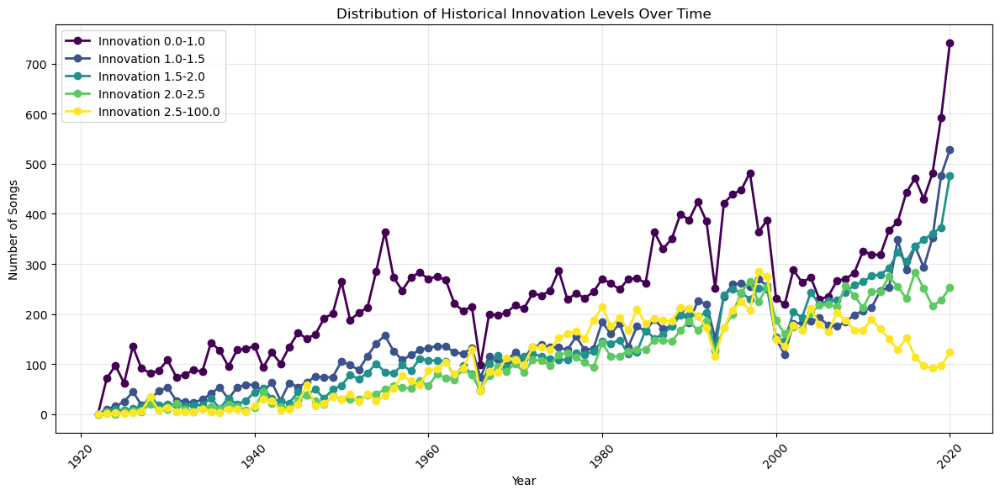

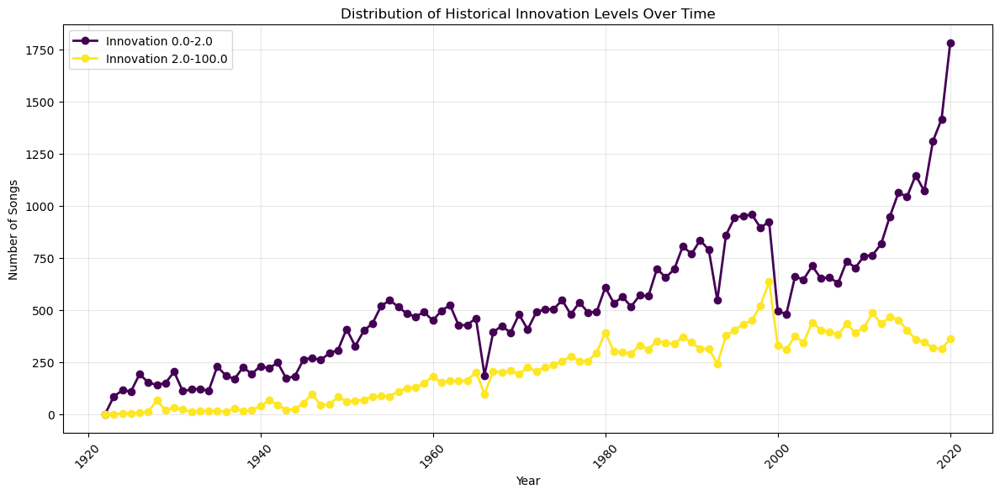

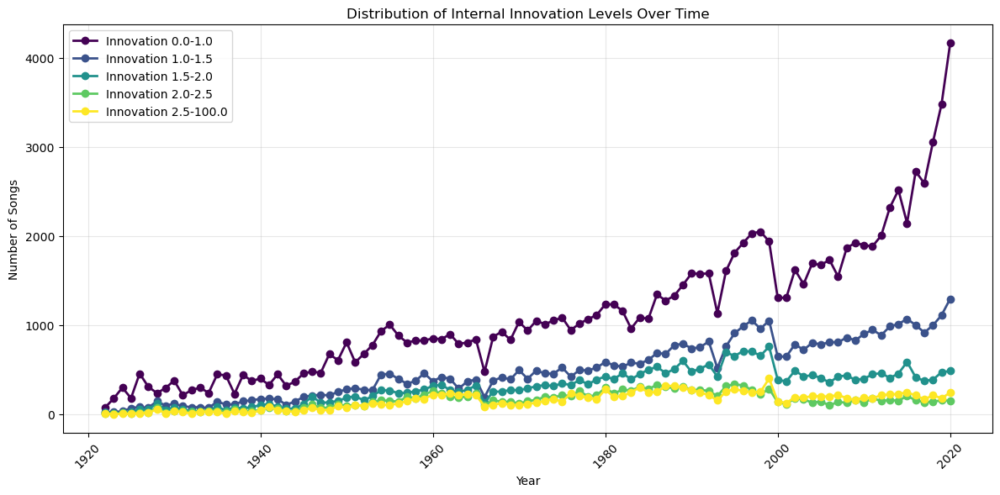

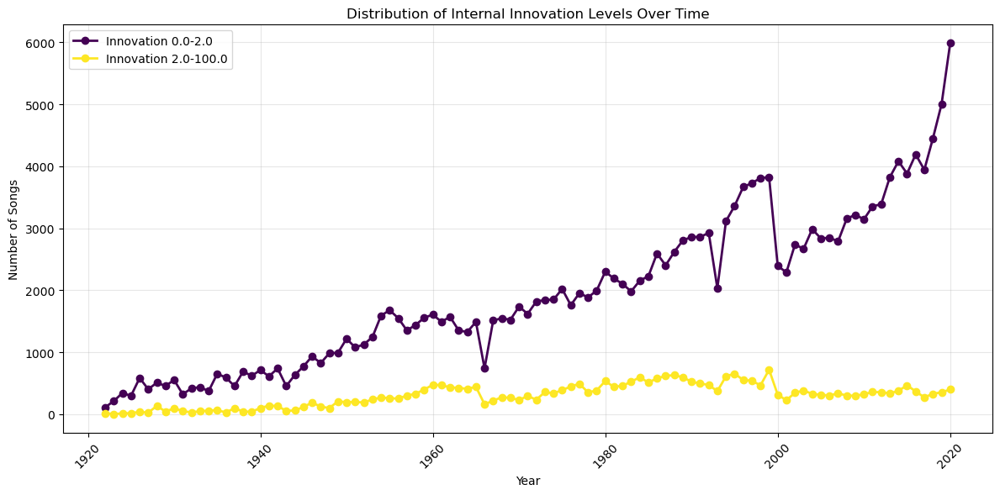

,0.0-2.0,2.0-100.0,raw_innovation_values
Year,,,
1922,110,15,"[0.8339909299651204, 0.4766589745394323, 1.512..."
1923,211,2,"[0.3927414660309197, 0.9446910691713609, 0.402..."
1924,341,12,"[1.2492931390905697, 0.5244700874179301, 0.725..."
1925,296,16,"[1.3738766387647527, 0.7831222037502279, 2.157..."
1926,584,37,"[1.6774240247204388, 0.8522703000173288, 0.800..."
...,...,...,...
2016,4192,367,"[0.6405063191498772, 0.9775922265594794, 0.292..."
2017,3944,271,"[1.743666676527201, 0.9991080454287868, 1.0565..."
2018,4452,329,"[0.6943022323669601, 0.2908134733455485, 0.819..."


In [ ]:
# %% innovation levels over time

def plot_innovation_levels_over_time(cluster_data, artist_name=None, sample_size=0.1, seed=None, 
                                   bins=[0, 1, 2, 3, 4], distance_type='historical'):
    """
    Plot the number of songs in different innovation level ranges over time and return the data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges (default: [0, 1, 2, 3, 4])
        distance_type: Type of distance to calculate ('historical' or 'internal')
        
    Returns:
        DataFrame containing innovation counts by year and range
    """
    # Extract data
    num_clusters, colors, cluster_data = exact_to_pd(cluster_data, artist_name, sample_size, seed)
    
    # Filter data for 1920-2020
    cluster_data = cluster_data[
        (cluster_data['year'] >= 1920) & 
        (cluster_data['year'] <= 2020)
    ]
    
    # Process data year by year
    years = sorted(cluster_data['year'].unique())
    historical_centroid = None
    
    # Store innovation levels for each year
    innovation_by_year = {year: [] for year in years}
    
    for year in years:
        year_data = cluster_data[cluster_data['year'] == year]
        if not year_data.empty:
            current_points = np.array([
                [float(features[0]), float(features[1])] 
                for features in year_data['features']
            ])
            current_centroid = current_points.mean(axis=0)
            
            if distance_type == 'historical':
                if historical_centroid is not None:
                    # Calculate distances to historical centroid
                    distances = np.sqrt(
                        np.sum((current_points - historical_centroid) ** 2, axis=1)
                    )
                    innovation_by_year[year].extend(distances)
                
                # Update historical centroid
                if historical_centroid is None:
                    historical_centroid = current_centroid
                else:
                    historical_data = cluster_data[cluster_data['year'] <= year]
                    historical_points = np.array([
                        [float(features[0]), float(features[1])] 
                        for features in historical_data['features']
                    ])
                    historical_centroid = historical_points.mean(axis=0)
            
            else:  # internal distance
                # Calculate distances to current year's centroid
                distances = np.sqrt(
                    np.sum((current_points - current_centroid) ** 2, axis=1)
                )
                innovation_by_year[year].extend(distances)
    
    # Create figure
    plt.figure(figsize=(12, 6))
    
    # Calculate counts for each bin range
    bin_ranges = list(zip(bins[:-1], bins[1:]))
    counts_by_range = {f"{low:.1f}-{high:.1f}": [] for low, high in bin_ranges}
    
    for year in years:
        year_innovations = innovation_by_year[year]
        if year_innovations:
            # Count songs in each range
            for (low, high) in bin_ranges:
                count = sum((low <= x < high) for x in year_innovations)
                counts_by_range[f"{low:.1f}-{high:.1f}"].append(count)
        else:
            # Add 0 if no songs in this year
            for range_key in counts_by_range:
                counts_by_range[range_key].append(0)
    
    # Plot lines for each range
    colors = plt.cm.viridis(np.linspace(0, 1, len(bin_ranges)))
    for (range_key, counts), color in zip(counts_by_range.items(), colors):
        plt.plot(years, counts, '-o', label=f'Innovation {range_key}', 
                color=color, linewidth=2, markersize=6)
    
    plt.xlabel('Year')
    plt.ylabel('Number of Songs')
    title = f"Distribution of {'Historical' if distance_type == 'historical' else 'Internal'} Innovation Levels Over Time"
    if artist_name:
        title = f"{artist_name}: {title}"
    plt.title(title)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tick_params(axis='x', rotation=45)
    
    plt.tight_layout()
    plt.show()
    
    # Create and return DataFrame with results
    results_df = pd.DataFrame(counts_by_range, index=years)
    results_df.index.name = 'Year'
    
    # Add raw innovation values
    results_df['raw_innovation_values'] = [innovation_by_year[year] for year in years]
    
    return results_df

# 使用历史距离
results_df = plot_innovation_levels_over_time(cluster_results, distance_type='historical',sample_size=0.1,bins=[0,1,1.5,2,2.5,100])
plot_innovation_levels_over_time(cluster_results, distance_type='historical',sample_size=0.1,bins=[0,2,100])

# 使用年内距离
plot_innovation_levels_over_time(cluster_results, distance_type='internal',sample_size=0.3,bins=[0,1,1.5,2,2.5,100])
plot_innovation_levels_over_time(cluster_results, distance_type='internal',sample_size=0.3,bins=[0,2,100])

In [ ]:
# %% proportion of highly innovative songs over time

def plot_innovation_ratio_over_time(cluster_data, threshold=2.0, artist_name=None, sample_size=0.1, seed=None, 
                                  distance_type='historical', window_size=5, year_range=(1920, 2020)):
    """
    Plot the ratio of highly innovative songs over time
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        threshold: Distance threshold for considering a song highly innovative
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        distance_type: Type of distance to calculate ('historical' or 'internal')
        window_size: Size of moving average window
        year_range: Tuple of (start_year, end_year)
    """
    # Extract data
    num_clusters, colors, cluster_data = exact_to_pd(cluster_data, artist_name, sample_size, seed)
    
    # Filter data by year range
    cluster_data = cluster_data[
        (cluster_data['year'] >= year_range[0]) & 
        (cluster_data['year'] <= year_range[1])
    ]
    
    # Process data year by year
    years = sorted(cluster_data['year'].unique())
    historical_centroid = None
    
    # Store innovation ratios and song counts for each year
    innovation_ratios = []
    song_counts = []
    
    for year in years:
        year_data = cluster_data[cluster_data['year'] == year]
        if not year_data.empty:
            current_points = np.array([
                [float(features[0]), float(features[1])] 
                for features in year_data['features']
            ])
            current_centroid = current_points.mean(axis=0)
            
            if distance_type == 'historical':
                if historical_centroid is not None:
                    distances = np.sqrt(np.sum((current_points - historical_centroid) ** 2, axis=1))
                    
                    # Calculate ratio of highly innovative songs
                    innovative_ratio = np.mean(distances >= threshold)
                    innovation_ratios.append(innovative_ratio)
                else:
                    innovation_ratios.append(0)
                
                # Update historical centroid
                if historical_centroid is None:
                    historical_centroid = current_centroid
                else:
                    historical_data = cluster_data[cluster_data['year'] <= year]
                    historical_points = np.array([
                        [float(features[0]), float(features[1])] 
                        for features in historical_data['features']
                    ])
                    historical_centroid = historical_points.mean(axis=0)
            else:  # internal distance
                distances = np.sqrt(np.sum((current_points - current_centroid) ** 2, axis=1))
                innovative_ratio = np.mean(distances >= threshold)
                innovation_ratios.append(innovative_ratio)
    
    # Calculate moving average
    def moving_average(data, window_size):
        return np.convolve(data, np.ones(window_size)/window_size, mode='valid')
    
    ma_ratios = moving_average(innovation_ratios, window_size)
    ma_years = years[window_size-1:]
    
    # Create figure
    plt.figure(figsize=(12, 6))
    
    # Plot original data as scatter points
    plt.scatter(years, innovation_ratios, alpha=0.3, label='Yearly ratio', color='gray')
    
    # Plot moving average line
    plt.plot(ma_years, ma_ratios, '-', label=f'{window_size}-year moving average', 
            color='blue', linewidth=2)
    
    plt.xlabel('Year')
    plt.ylabel('Ratio of Highly Innovative Songs')
    title = f"Ratio of {'Historical' if distance_type == 'historical' else 'Internal'} Innovation Over Time"
    if artist_name:
        title = f"{artist_name}: {title}"
    plt.title(title)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tick_params(axis='x', rotation=45)
    plt.ylim(0, 1)
    
    # Add threshold value to plot
    plt.text(0.02, 0.98, f'Innovation threshold: {threshold}', 
            transform=plt.gca().transAxes, 
            bbox=dict(facecolor='white', alpha=0.7))
    
    plt.tight_layout()
    plt.show()
    
    return years, innovation_ratios

# Example usage:
# Historical distance
'''
plot_innovation_ratio_over_time(cluster_results, threshold=2.0, 
                              distance_type='historical', sample_size=0.1)

# Internal distance
plot_innovation_ratio_over_time(cluster_results, threshold=2.0, 
                              distance_type='internal', sample_size=0.3)
'''

"\nplot_innovation_ratio_over_time(cluster_results, threshold=2.0, \n                              distance_type='historical', sample_size=0.1)\n\n# Internal distance\nplot_innovation_ratio_over_time(cluster_results, threshold=2.0, \n                              distance_type='internal', sample_size=0.3)\n"

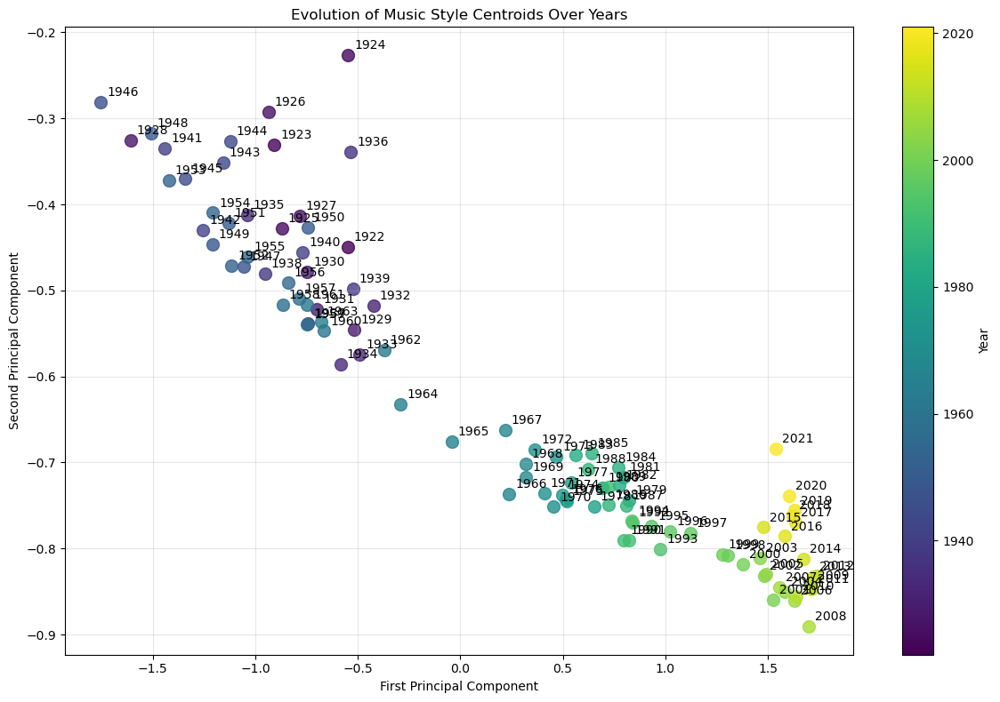

In [ ]:
# %% evolution of centroids

def plot_centroid_evolution(cluster_data, artist_name=None, sample_size=0.1, seed=None):
    """
    Plot the evolution of centroids in PCA space over years
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
    """
    # Extract data
    num_clusters, colors, cluster_data = exact_to_pd(cluster_data, artist_name, sample_size, seed)
    
    # Process data year by year
    years = sorted(cluster_data['year'].unique())
    centroids = []
    
    # Calculate centroid for each year
    for year in years:
        year_data = cluster_data[cluster_data['year'] == year]
        if not year_data.empty:
            current_points = np.array([
                [float(features[0]), float(features[1])] 
                for features in year_data['features']
            ])
            current_centroid = current_points.mean(axis=0)
            centroids.append((year, current_centroid))
    
    # Create figure
    plt.figure(figsize=(12, 8))
    
    # Create color gradient based on years
    num_years = len(centroids)
    colors = plt.cm.viridis(np.linspace(0, 1, num_years))
    
    # Plot centroids with color gradient
    for i, (year, centroid) in enumerate(centroids):
        plt.scatter(centroid[0], centroid[1], c=[colors[i]], s=100, alpha=0.8)
        plt.annotate(str(year), (centroid[0], centroid[1]), 
                    xytext=(5, 5), textcoords='offset points')
    
    # Add colorbar to show year progression
    sm = plt.cm.ScalarMappable(cmap=plt.cm.viridis, 
                              norm=plt.Normalize(vmin=min(years), vmax=max(years)))
    plt.colorbar(sm, label='Year')
    
    plt.xlabel('First Principal Component')
    plt.ylabel('Second Principal Component')
    title = "Evolution of Music Style Centroids Over Years"
    if artist_name:
        title = f"{artist_name}: {title}"
    plt.title(title)
    plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()

# Example usage
plot_centroid_evolution(cluster_results, sample_size=0.1)

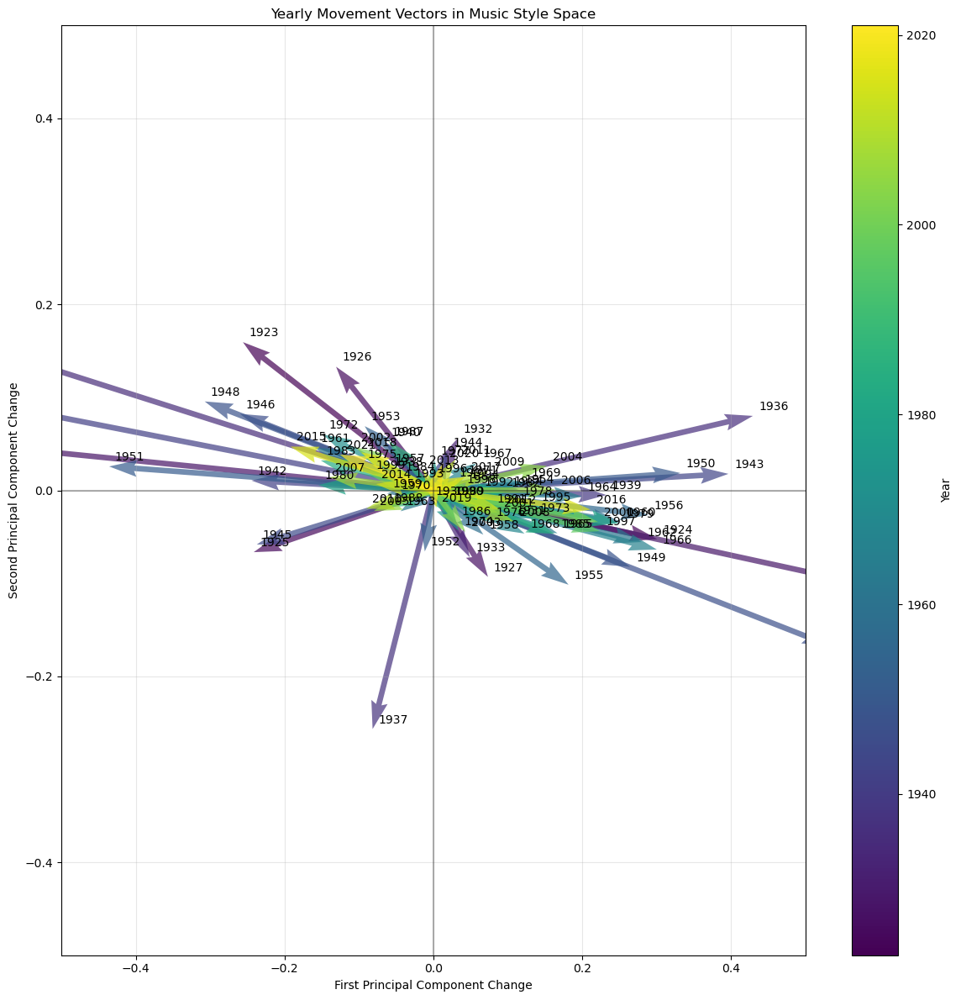

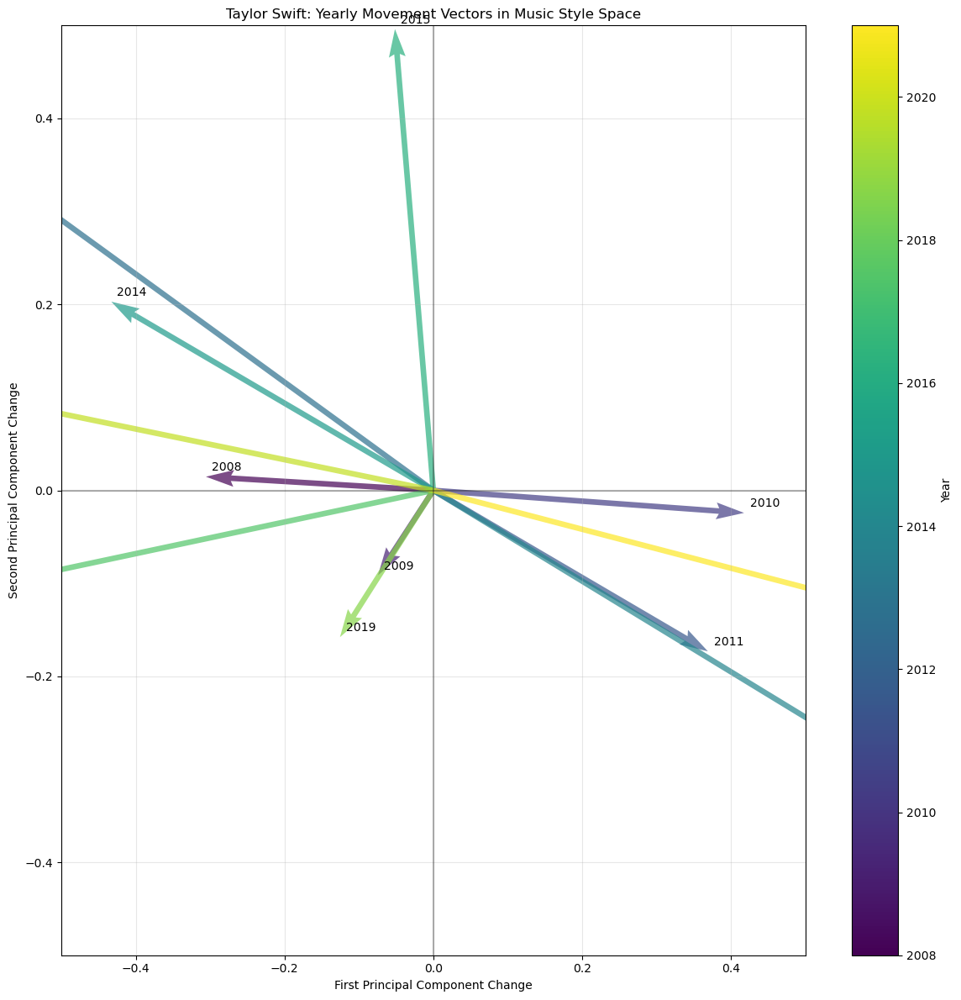

In [ ]:
# %% plot yearly centroids movement vectors

def plot_yearly_movement_vectors(cluster_data, artist_name=None, sample_size=0.1, seed=None):
    """
    Plot yearly movement vectors with tails at origin to compare directions and magnitudes
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
    """
    # Extract data
    num_clusters, colors, cluster_data = exact_to_pd(cluster_data, artist_name, sample_size, seed)
    
    # Process data year by year to get centroids
    years = sorted(cluster_data['year'].unique())
    centroids = []
    
    for year in years:
        year_data = cluster_data[cluster_data['year'] == year]
        if not year_data.empty:
            current_points = np.array([
                [float(features[0]), float(features[1])] 
                for features in year_data['features']
            ])
            current_centroid = current_points.mean(axis=0)
            centroids.append((year, current_centroid))
    
    # Calculate yearly movement vectors
    movement_vectors = []
    movement_years = []
    
    for i in range(1, len(centroids)):
        prev_year, prev_centroid = centroids[i-1]
        curr_year, curr_centroid = centroids[i]
        
        # Calculate yearly movement vector
        yearly_vector = curr_centroid - prev_centroid
        movement_vectors.append(yearly_vector)
        movement_years.append(curr_year)
    
    # Create figure
    plt.figure(figsize=(12, 12))
    
    # Create color gradient based on years
    num_years = len(movement_years)
    colors = plt.cm.viridis(np.linspace(0, 1, num_years))
    
    # Plot movement vectors from origin
    for i, vector in enumerate(movement_vectors):
        plt.quiver(0, 0, vector[0], vector[1], 
                  angles='xy', scale_units='xy', scale=1,
                  color=colors[i], alpha=0.7)
        # Add year label at vector tip
        plt.annotate(str(movement_years[i]), 
                    (vector[0], vector[1]),
                    xytext=(5, 5), textcoords='offset points')
    
    # Add colorbar to show year progression
    sm = plt.cm.ScalarMappable(cmap=plt.cm.viridis, 
                              norm=plt.Normalize(vmin=min(movement_years), 
                                               vmax=max(movement_years)))
    plt.colorbar(sm, label='Year')
    
    plt.xlabel('First Principal Component Change')
    plt.ylabel('Second Principal Component Change')
    title = "Yearly Movement Vectors in Music Style Space"
    if artist_name:
        title = f"{artist_name}: {title}"
    plt.title(title)
    plt.grid(True, alpha=0.3)
    plt.axhline(y=0, color='k', linestyle='-', alpha=0.3)
    plt.axvline(x=0, color='k', linestyle='-', alpha=0.3)
    
    plt.xlim(-0.5, 0.5)
    plt.ylim(-0.5, 0.5)
    
    plt.tight_layout()
    plt.show()

# Example usage
plot_yearly_movement_vectors(cluster_results, sample_size=0.1)

plot_yearly_movement_vectors(cluster_results, artist_name="Taylor Swift",sample_size=0.1)

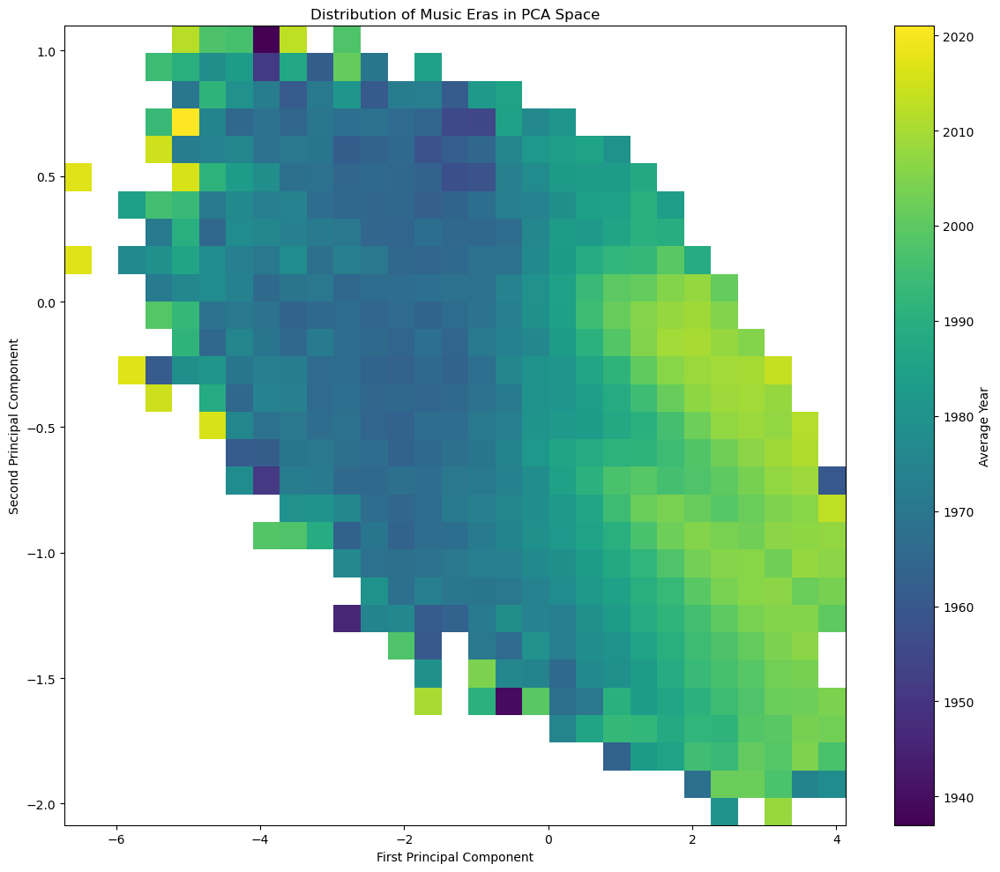

In [ ]:
# %% evolution of music (more than centroids)

def plot_music_era_heatmap(cluster_data, sample_size=0.1, grid_size=50, seed=42):
    """
    Plot a heatmap showing the distribution of music eras across the PCA space
    
    Args:
        cluster_data: Spark DataFrame containing PCA features and metadata
        sample_size: Fraction of data to sample
        grid_size: Number of grid cells in each dimension
        seed: Random seed for sampling
    """
    # Sample and convert to pandas
    _, _, df = exact_to_pd(cluster_data, sample_size=sample_size, seed=seed)
    
    # Extract PCA coordinates and years
    pca_coords = np.vstack(df['features'].values)
    years = pd.to_datetime(df['release_date']).dt.year.values
    
    # Create 2D histogram grid
    x_edges = np.linspace(pca_coords[:,0].min(), pca_coords[:,0].max(), grid_size)
    y_edges = np.linspace(pca_coords[:,1].min(), pca_coords[:,1].max(), grid_size)
    
    # Initialize grid for storing average years
    year_grid = np.zeros((grid_size-1, grid_size-1))
    count_grid = np.zeros((grid_size-1, grid_size-1))
    
    # Calculate average year for each grid cell
    for x, y, year in zip(pca_coords[:,0], pca_coords[:,1], years):
        x_idx = np.digitize(x, x_edges) - 1
        y_idx = np.digitize(y, y_edges) - 1
        if 0 <= x_idx < grid_size-1 and 0 <= y_idx < grid_size-1:
            year_grid[y_idx, x_idx] += year
            count_grid[y_idx, x_idx] += 1
    
    # Calculate average years, handling division by zero
    mask = count_grid > 0
    year_grid[mask] = year_grid[mask] / count_grid[mask]
    year_grid[~mask] = np.nan
    
    # Create figure
    plt.figure(figsize=(12, 10))
    
    # Plot heatmap using viridis colormap
    im = plt.imshow(year_grid, 
                    extent=[x_edges[0], x_edges[-1], y_edges[0], y_edges[-1]],
                    origin='lower',
                    cmap='viridis',
                    aspect='auto')
    
    # Add colorbar
    cbar = plt.colorbar(im)
    cbar.set_label('Average Year')
    
    # Customize plot
    plt.xlabel('First Principal Component')
    plt.ylabel('Second Principal Component')
    plt.title('Distribution of Music Eras in PCA Space')
    plt.grid(False)
    
    plt.tight_layout()
    plt.show()

# Example usage
plot_music_era_heatmap(cluster_results, sample_size=0.3, grid_size=30)

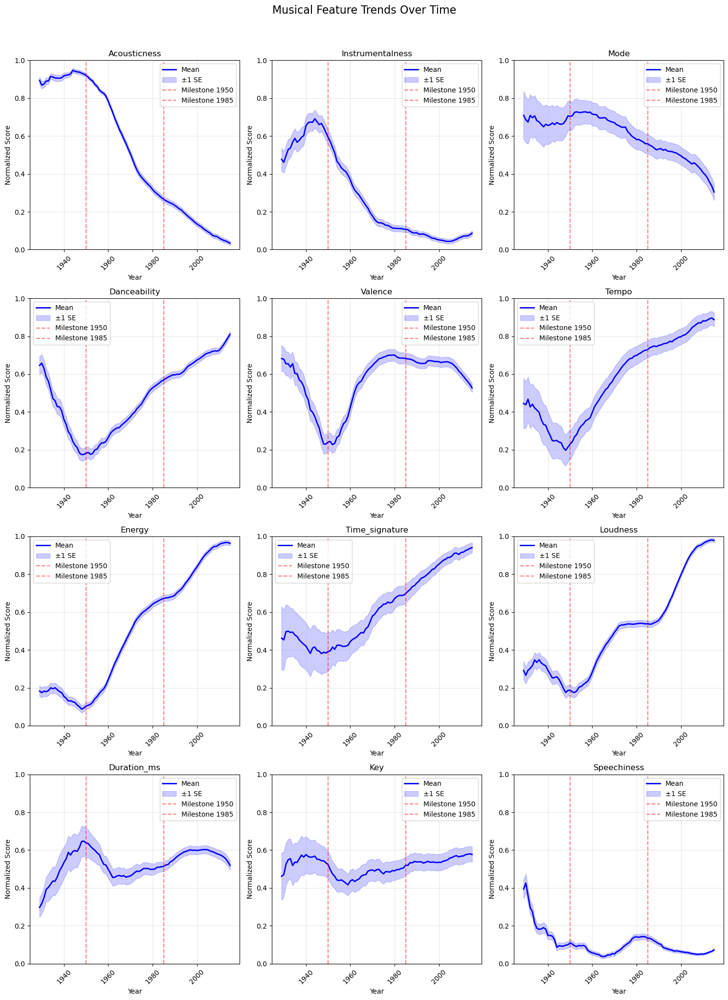

In [ ]:
# %% plot music feature trends

def plot_music_trends(cluster_data, sample_size=0.1, seed=None, window_size=3, milestone_years=None):
    """
    Plot trends of different musical features over time using smoothed curves in separate facets
    
    Args:
        cluster_data: Clustered data containing musical features
        sample_size: Fraction of data to sample (default: 0.1)
        seed: Random seed for sampling (default: None)
        window_size: Size of rolling window for smoothing (default: 3)
        milestone_years: List of years to mark with vertical lines (default: None)
    """
    # Sample and prepare data
    _, _, df = exact_to_pd(cluster_data, sample_size=sample_size, seed=seed)
    
    # Features to analyze
    features = ['acousticness', 'instrumentalness','mode', 
    'danceability', 'valence', 'tempo', 
    'energy', 'time_signature','loudness', 
    'duration_ms','key','speechiness']
    
    # Calculate yearly averages, se and normalize
    yearly_trends = pd.DataFrame()
    yearly_ses = pd.DataFrame()
    for feature in features:
        # Get feature values from raw_features array based on original order
        feature_idx = feature_cols.index(feature)
        df[feature] = df['raw_features'].apply(lambda x: x[feature_idx])
        
        # Calculate yearly means and standard errors
        yearly_stats = df.groupby('year')[feature].agg(['mean', 'std', 'count'])
        yearly_mean = yearly_stats['mean']
        yearly_se = yearly_stats['std'] / np.sqrt(yearly_stats['count'])
        
        # Normalize to 0-1 scale
        mean_min, mean_max = yearly_mean.min(), yearly_mean.max()
        yearly_normalized = (yearly_mean - mean_min) / (mean_max - mean_min)
        yearly_se_normalized = yearly_se / (mean_max - mean_min)
        
        # Apply smoothing using rolling average
        yearly_trends[feature] = yearly_normalized.rolling(window=window_size, center=True).mean()
        yearly_ses[feature] = yearly_se_normalized.rolling(window=window_size, center=True).mean()

    # Create subplots grid
    n_rows = 4
    n_cols = 3
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 20))
    axes = axes.flatten()
    
    # Plot each feature in its own subplot
    for i, feature in enumerate(features):
        ax = axes[i]
        
        # Plot mean line
        ax.plot(yearly_trends.index, yearly_trends[feature], 
                color='blue',
                linewidth=2,
                label='Mean')
        
        # Add confidence interval
        ax.fill_between(yearly_trends.index,
                       yearly_trends[feature] - yearly_ses[feature],
                       yearly_trends[feature] + yearly_ses[feature],
                       color='blue',
                       alpha=0.2,
                       label='±1 SE')
        
        # Add vertical lines for milestone years if provided
        if milestone_years is not None:
            for year in milestone_years:
                if year >= yearly_trends.index.min() and year <= yearly_trends.index.max():
                    ax.axvline(x=year, color='red', linestyle='--', alpha=0.5, 
                             label=f'Milestone {year}')
        
        ax.set_xlabel('Year')
        ax.set_ylabel('Normalized Score')
        ax.set_title(feature.capitalize())
        ax.set_ylim(0, 1)
        ax.grid(True, alpha=0.3)
        ax.legend()
        
        # Rotate x-axis labels for better readability
        ax.tick_params(axis='x', rotation=45)
    
    # Remove any empty subplots
    for j in range(i+1, len(axes)):
        fig.delaxes(axes[j])
    
    plt.suptitle('Musical Feature Trends Over Time', y=1.02, fontsize=16)
    plt.tight_layout()
    plt.show()

# Example usage
plot_music_trends(cluster_results, sample_size=0.1, window_size=14, milestone_years=[1950, 1985])

21:10:57 - cmdstanpy - INFO - Chain [1] start processing                        
21:10:57 - cmdstanpy - INFO - Chain [1] done processing
21:10:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
21:10:57 - cmdstanpy - INFO - Chain [1] start processing
21:10:57 - cmdstanpy - INFO - Chain [1] done processing
21:10:57 - cmdstanpy - INFO - Chain [1] start processing
21:10:57 - cmdstanpy - INFO - Chain [1] done processing
21:10:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
21:10:57 - cmdstanpy - INFO - Chain [1] start processing
21:10:57 - cmdstanpy - INFO - Chain [1] done processing



Time Series Analysis for danceability:
Average Trend Change: 0.0038
Trend Acceleration: -0.0000
Total Growth Rate: 130.38%


21:10:57 - cmdstanpy - INFO - Chain [1] start processing
21:10:57 - cmdstanpy - INFO - Chain [1] done processing
21:10:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
21:10:57 - cmdstanpy - INFO - Chain [1] start processing
21:10:57 - cmdstanpy - INFO - Chain [1] done processing



Time Series Analysis for energy:
Average Trend Change: 0.0103
Trend Acceleration: -0.0000
Total Growth Rate: 17393.30%


21:10:57 - cmdstanpy - INFO - Chain [1] start processing
21:10:57 - cmdstanpy - INFO - Chain [1] done processing
21:10:57 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
21:10:57 - cmdstanpy - INFO - Chain [1] start processing
21:10:57 - cmdstanpy - INFO - Chain [1] done processing



Time Series Analysis for valence:
Average Trend Change: 0.0006
Trend Acceleration: -0.0000
Total Growth Rate: 11.61%


21:10:58 - cmdstanpy - INFO - Chain [1] start processing
21:10:58 - cmdstanpy - INFO - Chain [1] done processing
21:10:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
21:10:58 - cmdstanpy - INFO - Chain [1] start processing
21:10:58 - cmdstanpy - INFO - Chain [1] done processing



Time Series Analysis for acousticness:
Average Trend Change: -0.0115
Trend Acceleration: -0.0000
Total Growth Rate: -116.34%


21:10:58 - cmdstanpy - INFO - Chain [1] start processing
21:10:58 - cmdstanpy - INFO - Chain [1] done processing
21:10:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
21:10:58 - cmdstanpy - INFO - Chain [1] start processing
21:10:58 - cmdstanpy - INFO - Chain [1] done processing



Time Series Analysis for instrumentalness:
Average Trend Change: -0.0069
Trend Acceleration: 0.0000
Total Growth Rate: -120.69%


21:10:58 - cmdstanpy - INFO - Chain [1] start processing
21:10:58 - cmdstanpy - INFO - Chain [1] done processing
21:10:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
21:10:58 - cmdstanpy - INFO - Chain [1] start processing
21:10:58 - cmdstanpy - INFO - Chain [1] done processing



Time Series Analysis for speechiness:
Average Trend Change: -0.0026
Trend Acceleration: 0.0000
Total Growth Rate: -100.23%


21:10:58 - cmdstanpy - INFO - Chain [1] start processing
21:10:58 - cmdstanpy - INFO - Chain [1] done processing
21:10:58 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
21:10:58 - cmdstanpy - INFO - Chain [1] start processing
21:10:58 - cmdstanpy - INFO - Chain [1] done processing



Time Series Analysis for tempo:
Average Trend Change: 0.0069
Trend Acceleration: -0.0000
Total Growth Rate: 280.52%


21:10:59 - cmdstanpy - INFO - Chain [1] start processing
21:10:59 - cmdstanpy - INFO - Chain [1] done processing
21:10:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
21:10:59 - cmdstanpy - INFO - Chain [1] start processing
21:10:59 - cmdstanpy - INFO - Chain [1] done processing



Time Series Analysis for loudness:
Average Trend Change: 0.0086
Trend Acceleration: -0.0000
Total Growth Rate: 997.92%


21:10:59 - cmdstanpy - INFO - Chain [1] start processing
21:10:59 - cmdstanpy - INFO - Chain [1] done processing
21:10:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
21:10:59 - cmdstanpy - INFO - Chain [1] start processing



Time Series Analysis for duration_ms:
Average Trend Change: 0.0019
Trend Acceleration: -0.0000
Total Growth Rate: 64.54%


21:10:59 - cmdstanpy - INFO - Chain [1] done processing
21:10:59 - cmdstanpy - INFO - Chain [1] start processing
21:10:59 - cmdstanpy - INFO - Chain [1] done processing
21:10:59 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
Optimization terminated abnormally. Falling back to Newton.
21:10:59 - cmdstanpy - INFO - Chain [1] start processing



Time Series Analysis for key:
Average Trend Change: 0.0017
Trend Acceleration: 0.0000
Total Growth Rate: 33.52%


21:10:59 - cmdstanpy - INFO - Chain [1] done processing
21:10:59 - cmdstanpy - INFO - Chain [1] start processing
21:10:59 - cmdstanpy - INFO - Chain [1] done processing



Time Series Analysis for mode:
Average Trend Change: -0.0049
Trend Acceleration: 0.0000
Total Growth Rate: -64.27%

Time Series Analysis for time_signature:
Average Trend Change: 0.0060
Trend Acceleration: -0.0000
Total Growth Rate: 214.70%


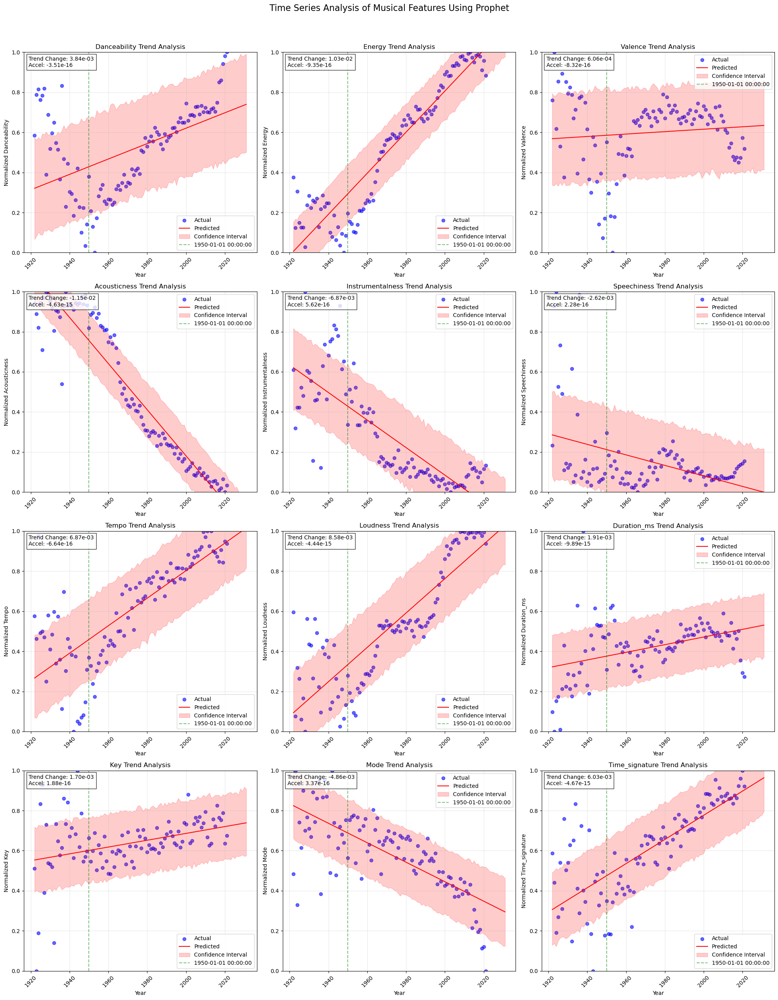

In [ ]:
# %%

def analyze_feature_trends_prophet(cluster_data, sample_size=0.1, seed=None):
    """
    Perform time series analysis on musical features by year using Facebook Prophet
    
    Args:
        cluster_data: Clustered data containing musical features
        sample_size: Fraction of data to sample (default: 0.1) 
        seed: Random seed for sampling (default: None)
    """
    from prophet import Prophet
    
    # Sample and prepare data
    _, _, df = exact_to_pd(cluster_data, sample_size=sample_size, seed=seed)
    
    # Features to analyze
    features = ['danceability', 'energy', 'valence', 'acousticness', 
                'instrumentalness', 'speechiness', 'tempo', 'loudness', 'duration_ms','key','mode','time_signature']
    
    # Create figure for subplots
    n_rows = 4
    n_cols = 3
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 25))
    axes = axes.flatten()
    # Analyze each feature
    for i, feature in enumerate(features):
        # Get feature values
        feature_idx = feature_cols.index(feature)
        df[feature] = df['raw_features'].apply(lambda x: x[feature_idx])
        
        # Calculate yearly means
        yearly_means = df.groupby('year')[feature].mean().reset_index()
        
        # Normalize the feature values to 0-1 scale
        min_val = yearly_means[feature].min()
        max_val = yearly_means[feature].max()
        yearly_means[feature] = (yearly_means[feature] - min_val) / (max_val - min_val)
        
        # Prepare data for Prophet
        prophet_df = pd.DataFrame({
            'ds': pd.to_datetime(yearly_means['year'].astype(str)),
            'y': yearly_means[feature]
        })
        
        # Create and fit Prophet model with changepoint at 1950
        changepoints_list = ['1950-01-01']
        model = Prophet(yearly_seasonality=False, 
                       weekly_seasonality=False, 
                       daily_seasonality=False,
                       changepoint_prior_scale=0.001,
                       changepoints=changepoints_list)
        model.fit(prophet_df)
        
        # Make future predictions
        future = model.make_future_dataframe(periods=10, freq='Y')
        forecast = model.predict(future)
        
        # Extract trend components
        trend = forecast['trend']
        trend_change = trend.diff().mean()  # Average trend change
        
        # Calculate trend acceleration
        trend_acceleration = trend.diff().diff().mean()
        
        # Get overall growth rate
        total_growth = (trend.iloc[-1] - trend.iloc[0]) / trend.iloc[0]
        
        # Print time series components analysis
        print(f"\nTime Series Analysis for {feature}:")
        print(f"Average Trend Change: {trend_change:.4f}")
        print(f"Trend Acceleration: {trend_acceleration:.4f}")
        print(f"Total Growth Rate: {total_growth:.2%}")
        
        # Plot results
        ax = axes[i]
        
        # Plot actual values
        ax.scatter(prophet_df['ds'], prophet_df['y'], 
                  color='blue', alpha=0.6, label='Actual')
        
        # Plot predicted values and confidence interval
        ax.plot(forecast['ds'], forecast['yhat'], 
                color='red', label='Predicted')
        ax.fill_between(forecast['ds'],
                       forecast['yhat_lower'],
                       forecast['yhat_upper'],
                       color='red', alpha=0.2,
                       label='Confidence Interval')
        
        # Add vertical line for changepoints
        for changepoint in model.changepoints:
            ax.axvline(x=changepoint, color='green', linestyle='--', alpha=0.5, label=changepoint)
        
        # Add trend analysis text
        ax.text(0.02, 0.98, 
                f'Trend Change: {trend_change:.2e}\nAccel: {trend_acceleration:.2e}',
                transform=ax.transAxes,
                verticalalignment='top',
                bbox=dict(facecolor='white', alpha=0.8))
        
        ax.set_xlabel('Year')
        ax.set_ylabel(f'Normalized {feature.capitalize()}')
        ax.set_title(f'{feature.capitalize()} Trend Analysis')
        ax.set_ylim(0, 1)  # Set y-axis limits to 0-1
        ax.grid(True, alpha=0.3)
        ax.legend()
        
        # Rotate x-axis labels
        ax.tick_params(axis='x', rotation=45)
    
    # Remove any empty subplots
    for j in range(i+1, len(axes)):
        fig.delaxes(axes[j])
    
    plt.suptitle('Time Series Analysis of Musical Features Using Prophet', 
                 y=1.02, fontsize=16)
    plt.tight_layout()
    plt.show()

# Example usage
analyze_feature_trends_prophet(cluster_results, sample_size=0.1)

In [ ]:
# %%

def analyze_yearly_song_counts(df, intervals=[(1950,1980), (1980,2000), (2000,2020)], sample_frac=0.1):
    """
    Analyze yearly song count trends for different time intervals using Prophet
    
    Args:
        df: Spark DataFrame with song data
        intervals: List of (start_year, end_year) tuples defining time periods
        sample_frac: Fraction of data to sample
    """
    from fbprophet import Prophet
    
    # Sample data
    df_sample = df.sample(withReplacement=False, fraction=sample_frac)
    
    # Convert to pandas and extract year from release_date
    pdf = df_sample.toPandas()
    pdf['year'] = pd.to_datetime(pdf['release_date']).dt.year
    
    # Count songs per year
    yearly_counts = pdf.groupby('year').size().reset_index()
    yearly_counts.columns = ['year', 'count']
    
    # Create figure
    n_intervals = len(intervals)
    fig, axes = plt.subplots(n_intervals, 1, figsize=(12, 5*n_intervals))
    if n_intervals == 1:
        axes = [axes]
    
    for i, (start_year, end_year) in enumerate(intervals):
        # Filter data for interval
        interval_data = yearly_counts[
            (yearly_counts['year'] >= start_year) & 
            (yearly_counts['year'] <= end_year)
        ]
        
        # Prepare data for Prophet
        prophet_df = interval_data.rename(columns={'year': 'ds', 'count': 'y'})
        prophet_df['ds'] = pd.to_datetime(prophet_df['ds'].astype(str))
        
        # Fit Prophet model
        model = Prophet(changepoint_prior_scale=0.05,
                       yearly_seasonality=False)
        model.fit(prophet_df)
        
        # Make future predictions
        future = model.make_future_dataframe(periods=5, freq='Y')
        forecast = model.predict(future)
        
        # Calculate trend metrics
        trend_change = (forecast['trend'].iloc[-1] - forecast['trend'].iloc[0]) / len(forecast)
        trend_acceleration = np.diff(forecast['trend']).mean()
        
        # Plot
        ax = axes[i]
        
        # Plot actual counts
        ax.scatter(prophet_df['ds'], prophet_df['y'], 
                  color='blue', alpha=0.6, label='Actual')
        
        # Plot predictions and confidence interval
        ax.plot(forecast['ds'], forecast['yhat'], 
                color='red', label='Predicted')
        ax.fill_between(forecast['ds'],
                       forecast['yhat_lower'],
                       forecast['yhat_upper'],
                       color='red', alpha=0.2,
                       label='Confidence Interval')
        
        # Add changepoint lines
        for changepoint in model.changepoints:
            ax.axvline(x=changepoint, color='green', linestyle='--', alpha=0.5)
        
        # Add trend analysis text
        ax.text(0.02, 0.98,
                f'Period: {start_year}-{end_year}\n'
                f'Trend Change: {trend_change:.2f} songs/year\n'
                f'Acceleration: {trend_acceleration:.2f} songs/year²',
                transform=ax.transAxes,
                verticalalignment='top',
                bbox=dict(facecolor='white', alpha=0.8))
        
        ax.set_xlabel('Year')
        ax.set_ylabel('Number of Songs')
        ax.set_title(f'Song Count Trend Analysis ({start_year}-{end_year})')
        ax.grid(True, alpha=0.3)
        ax.legend()
        
        # Rotate x-axis labels
        ax.tick_params(axis='x', rotation=45)
    
    plt.suptitle('Time Series Analysis of Yearly Song Counts Using Prophet',
                 y=1.02, fontsize=16)
    plt.tight_layout()
    plt.show()

# Example usage
intervals = [(1950,1980), (1980,2000), (2000,2020)]
analyze_yearly_song_counts(df, intervals=intervals, sample_frac=0.1)

ModuleNotFoundError: No module named 'fbprophet'

In [ ]:
# %%

def analyze_yearly_song_counts(df, intervals=[(1950,1980), (1980,2000), (2000,2020)], sample_frac=0.1):
    """
    Analyze yearly song count trends for different time intervals using Prophet
    
    Args:
        df: Spark DataFrame with song data
        intervals: List of (start_year, end_year) tuples defining time periods
        sample_frac: Fraction of data to sample
    """
    from prophet import Prophet
    
    # Sample data
    df_sample = df.sample(withReplacement=False, fraction=sample_frac)
    
    # Convert to pandas and extract year from release_date
    pdf = df_sample.toPandas()
    pdf['year'] = pd.to_datetime(pdf['release_date']).dt.year
    
    # Count songs per year
    yearly_counts = pdf.groupby('year').size().reset_index()
    yearly_counts.columns = ['year', 'count']
    
    # Create figure
    n_intervals = len(intervals)
    fig, axes = plt.subplots(n_intervals, 1, figsize=(12, 5*n_intervals))
    if n_intervals == 1:
        axes = [axes]
    
    for i, (start_year, end_year) in enumerate(intervals):
        # Filter data for interval
        interval_data = yearly_counts[
            (yearly_counts['year'] >= start_year) & 
            (yearly_counts['year'] <= end_year)
        ]
        
        # Prepare data for Prophet
        prophet_df = interval_data.rename(columns={'year': 'ds', 'count': 'y'})
        prophet_df['ds'] = pd.to_datetime(prophet_df['ds'].astype(str))
        
        # Fit Prophet model
        model = Prophet(changepoint_prior_scale=0.05,
                       yearly_seasonality=False)
        model.fit(prophet_df)
        
        # Make future predictions
        future = model.make_future_dataframe(periods=5, freq='Y')
        forecast = model.predict(future)
        
        # Calculate trend metrics
        trend_change = (forecast['trend'].iloc[-1] - forecast['trend'].iloc[0]) / len(forecast)
        trend_acceleration = np.diff(forecast['trend']).mean()
        
        # Plot
        ax = axes[i]
        
        # Plot actual counts
        ax.scatter(prophet_df['ds'], prophet_df['y'], 
                  color='blue', alpha=0.6, label='Actual')
        
        # Plot predictions and confidence interval
        ax.plot(forecast['ds'], forecast['yhat'], 
                color='red', label='Predicted')
        ax.fill_between(forecast['ds'],
                       forecast['yhat_lower'],
                       forecast['yhat_upper'],
                       color='red', alpha=0.2,
                       label='Confidence Interval')
        
        # Add changepoint lines
        for changepoint in model.changepoints:
            ax.axvline(x=changepoint, color='green', linestyle='--', alpha=0.5)
        
        # Add trend analysis text
        ax.text(0.02, 0.98,
                f'Period: {start_year}-{end_year}\n'
                f'Trend Change: {trend_change:.2f} songs/year\n'
                f'Acceleration: {trend_acceleration:.2f} songs/year²',
                transform=ax.transAxes,
                verticalalignment='top',
                bbox=dict(facecolor='white', alpha=0.8))
        
        ax.set_xlabel('Year')
        ax.set_ylabel('Number of Songs')
        ax.set_title(f'Song Count Trend Analysis ({start_year}-{end_year})')
        ax.grid(True, alpha=0.3)
        ax.legend()
        
        # Rotate x-axis labels
        ax.tick_params(axis='x', rotation=45)
    
    plt.suptitle('Time Series Analysis of Yearly Song Counts Using Prophet',
                 y=1.02, fontsize=16)
    plt.tight_layout()
    plt.show()

# Example usage
intervals = [(1950,1980), (1980,2000), (2000,2020)]
analyze_yearly_song_counts(df, intervals=intervals, sample_frac=0.1)

ParserError: Unknown string format: +70200-01-01

In [ ]:
# %%

def analyze_yearly_song_counts(df, intervals=[(1950,1980), (1980,2000), (2000,2020)], sample_frac=0.1):
    """
    Analyze yearly song count trends for different time intervals using Prophet
    
    Args:
        df: Spark DataFrame with song data
        intervals: List of (start_year, end_year) tuples defining time periods
        sample_frac: Fraction of data to sample
    """
    
    # Sample data
    df_sample = df.sample(withReplacement=False, fraction=sample_frac)
    
    # Convert to pandas and extract year from release_date
    pdf = df_sample.toPandas()
    pdf['year'] = pd.to_datetime(pdf['release_date']).dt.year
    
    # Count songs per year
    yearly_counts = pdf.groupby('year').size().reset_index()
    yearly_counts.columns = ['year', 'count']
    
    # Create figure
    n_intervals = len(intervals)
    fig, axes = plt.subplots(n_intervals, 1, figsize=(12, 5*n_intervals))
    if n_intervals == 1:
        axes = [axes]
    
    for i, (start_year, end_year) in enumerate(intervals):
        # Filter data for interval
        interval_data = yearly_counts[
            (yearly_counts['year'] >= start_year) & 
            (yearly_counts['year'] <= end_year)
        ].copy()  # Add .copy() to avoid SettingWithCopyWarning
        
        if len(interval_data) == 0:
            print(f"No data found for interval {start_year}-{end_year}")
            continue
            
        # Prepare data for Prophet
        prophet_df = interval_data.rename(columns={'year': 'ds', 'count': 'y'})
        prophet_df['ds'] = pd.to_datetime(prophet_df['ds'].astype(str))
        
        try:
            # Fit Prophet model
            model = Prophet(changepoint_prior_scale=0.05,
                          yearly_seasonality=False)
            model.fit(prophet_df)
            
            # Make future predictions
            future = model.make_future_dataframe(periods=5, freq='Y')
            forecast = model.predict(future)
            
            # Calculate trend metrics
            trend_change = (forecast['trend'].iloc[-1] - forecast['trend'].iloc[0]) / len(forecast)
            trend_acceleration = np.diff(forecast['trend']).mean()
            
            # Plot
            ax = axes[i]
            
            # Plot actual counts
            ax.scatter(prophet_df['ds'], prophet_df['y'], 
                      color='blue', alpha=0.6, label='Actual')
            
            # Plot predictions and confidence interval
            ax.plot(forecast['ds'], forecast['yhat'], 
                    color='red', label='Predicted')
            ax.fill_between(forecast['ds'],
                           forecast['yhat_lower'],
                           forecast['yhat_upper'],
                           color='red', alpha=0.2,
                           label='Confidence Interval')
            
            # Add changepoint lines
            for changepoint in model.changepoints:
                ax.axvline(x=changepoint, color='green', linestyle='--', alpha=0.5)
            
            # Add trend analysis text
            ax.text(0.02, 0.98,
                    f'Period: {start_year}-{end_year}\n'
                    f'Trend Change: {trend_change:.2f} songs/year\n'
                    f'Acceleration: {trend_acceleration:.2f} songs/year²',
                    transform=ax.transAxes,
                    verticalalignment='top',
                    bbox=dict(facecolor='white', alpha=0.8))
            
            ax.set_xlabel('Year')
            ax.set_ylabel('Number of Songs')
            ax.set_title(f'Song Count Trend Analysis ({start_year}-{end_year})')
            ax.grid(True, alpha=0.3)
            ax.legend()
            
            # Rotate x-axis labels
            ax.tick_params(axis='x', rotation=45)
            
        except Exception as e:
            print(f"Error analyzing interval {start_year}-{end_year}: {str(e)}")
            continue
    
    plt.suptitle('Time Series Analysis of Yearly Song Counts Using Prophet',
                 y=1.02, fontsize=16)
    plt.tight_layout()
    plt.show()

# Example usage
intervals = [(1950,1980), (1980,2000), (2000,2020)]
analyze_yearly_song_counts(df, intervals=intervals, sample_frac=0.1)

ParserError: Unknown string format: +70200-01-01

KeyError: 'innovation_level'

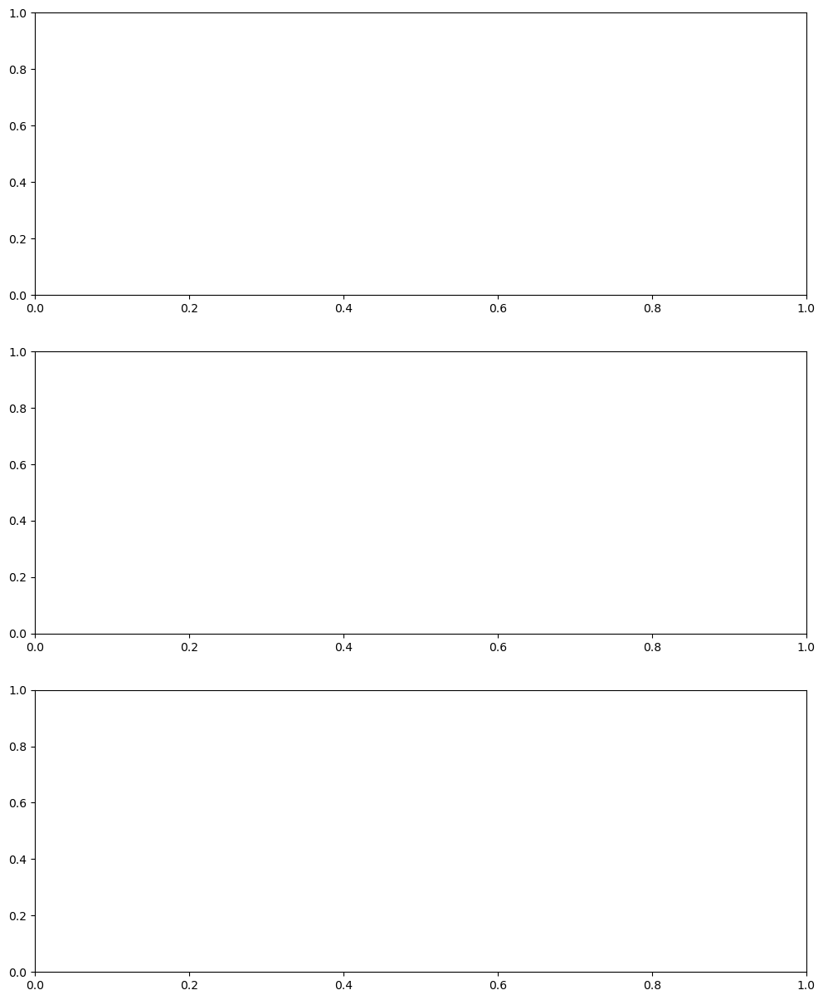

In [ ]:
# %%

def analyze_innovation_counts(df, intervals=[(0,0.33), (0.33,0.67), (0.67,1.0)], sample_frac=0.1):
    """
    Analyze song count trends for different innovation level intervals using Prophet
    
    Args:
        df: Spark DataFrame with song data
        intervals: List of (start_level, end_level) tuples defining innovation ranges
        sample_frac: Fraction of data to sample
    """
    
    # Sample data
    df_sample = df.sample(withReplacement=False, fraction=sample_frac)
    
    # Convert to pandas and get innovation level
    pdf = df_sample.toPandas()
    
    # Create figure
    n_intervals = len(intervals)
    fig, axes = plt.subplots(n_intervals, 1, figsize=(12, 5*n_intervals))
    if n_intervals == 1:
        axes = [axes]
    
    for i, (start_level, end_level) in enumerate(intervals):
        # Filter data for innovation interval
        interval_data = pdf[
            (pdf['innovation_level'] >= start_level) & 
            (pdf['innovation_level'] <= end_level)
        ].copy()
        
        if len(interval_data) == 0:
            print(f"No data found for innovation level {start_level}-{end_level}")
            continue
            
        # Count songs per year and prepare for Prophet
        yearly_counts = interval_data.groupby('release_date').size().reset_index()
        prophet_df = yearly_counts.rename(columns={'release_date': 'ds', 0: 'y'})
        prophet_df['ds'] = pd.to_datetime(prophet_df['ds'])
        
        try:
            # Fit Prophet model
            model = Prophet(changepoint_prior_scale=0.05,
                          yearly_seasonality=False)
            model.fit(prophet_df)
            
            # Make future predictions
            future = model.make_future_dataframe(periods=5, freq='Y')
            forecast = model.predict(future)
            
            # Calculate trend metrics
            trend_change = (forecast['trend'].iloc[-1] - forecast['trend'].iloc[0]) / len(forecast)
            trend_acceleration = np.diff(forecast['trend']).mean()
            
            # Plot
            ax = axes[i]
            
            # Plot actual counts
            ax.scatter(prophet_df['ds'], prophet_df['y'], 
                      color='blue', alpha=0.6, label='Actual')
            
            # Plot predictions and confidence interval
            ax.plot(forecast['ds'], forecast['yhat'], 
                    color='red', label='Predicted')
            ax.fill_between(forecast['ds'],
                           forecast['yhat_lower'],
                           forecast['yhat_upper'],
                           color='red', alpha=0.2,
                           label='Confidence Interval')
            
            # Add changepoint lines
            for changepoint in model.changepoints:
                ax.axvline(x=changepoint, color='green', linestyle='--', alpha=0.5)
            
            # Add trend analysis text
            ax.text(0.02, 0.98,
                    f'Innovation Level: {start_level:.2f}-{end_level:.2f}\n'
                    f'Trend Change: {trend_change:.2f} songs/year\n'
                    f'Acceleration: {trend_acceleration:.2f} songs/year²',
                    transform=ax.transAxes,
                    verticalalignment='top',
                    bbox=dict(facecolor='white', alpha=0.8))
            
            ax.set_xlabel('Year')
            ax.set_ylabel('Number of Songs')
            ax.set_title(f'Song Count Analysis (Innovation Level {start_level:.2f}-{end_level:.2f})')
            ax.grid(True, alpha=0.3)
            ax.legend()
            
            # Rotate x-axis labels
            ax.tick_params(axis='x', rotation=45)
            
        except Exception as e:
            print(f"Error analyzing innovation level {start_level}-{end_level}: {str(e)}")
            continue
    
    plt.suptitle('Time Series Analysis of Songs by Innovation Level Using Prophet',
                 y=1.02, fontsize=16)
    plt.tight_layout()
    plt.show()

# Example usage
intervals = [(0,0.33), (0.33,0.67), (0.67,1.0)]  # Low, medium, high innovation
analyze_innovation_counts(df, intervals=intervals, sample_frac=0.1)

In [ ]:
# %%

def analyze_innovation_counts(cluster_data, intervals=[(0,0.33), (0.33,0.67), (0.67,1.0)], sample_size=0.1, seed=None):
    """
    Analyze song count trends for different innovation level intervals using Prophet
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        intervals: List of (start_level, end_level) tuples defining innovation ranges
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
    """
    # Extract data and calculate innovation levels
    num_clusters, colors, df = exact_to_pd(cluster_data, sample_size=sample_size, seed=seed)
    
    # Calculate historical centroids and innovation levels
    df['year'] = pd.to_datetime(df['release_date']).dt.year
    df = df.sort_values('year')
    
    # Extract PCA coordinates
    df['pca_1'] = df['features'].apply(lambda x: float(x[0]))
    df['pca_2'] = df['features'].apply(lambda x: float(x[1]))
    
    # Calculate historical centroids and distances
    historical_distances = []
    for idx, row in df.iterrows():
        # Get all previous songs
        historical_data = df[df['year'] < row['year']]
        if len(historical_data) > 0:
            # Calculate historical centroid
            historical_centroid = historical_data[['pca_1', 'pca_2']].mean()
            # Calculate distance to historical centroid
            distance = np.sqrt((row['pca_1'] - historical_centroid['pca_1'])**2 + 
                             (row['pca_2'] - historical_centroid['pca_2'])**2)
        else:
            distance = 0
        historical_distances.append(distance)
    
    df['innovation_level'] = historical_distances
    
    # Normalize innovation levels to 0-1 scale
    max_distance = df['innovation_level'].max()
    if max_distance > 0:
        df['innovation_level'] = df['innovation_level'] / max_distance
    
    # Create figure
    n_intervals = len(intervals)
    fig, axes = plt.subplots(n_intervals, 1, figsize=(12, 5*n_intervals))
    if n_intervals == 1:
        axes = [axes]
    
    for i, (start_level, end_level) in enumerate(intervals):
        # Filter data for innovation interval
        interval_data = df[
            (df['innovation_level'] >= start_level) & 
            (df['innovation_level'] <= end_level)
        ].copy()
        
        if len(interval_data) == 0:
            print(f"No data found for innovation level {start_level}-{end_level}")
            continue
            
        # Count songs per year and prepare for Prophet
        yearly_counts = interval_data.groupby('year').size().reset_index()
        prophet_df = pd.DataFrame({
            'ds': pd.to_datetime(yearly_counts['year'].astype(str)),
            'y': yearly_counts[0]
        })
        
        try:
            # Fit Prophet model
            model = Prophet(changepoint_prior_scale=0.05,
                          yearly_seasonality=False)
            model.fit(prophet_df)
            
            # Make future predictions
            future = model.make_future_dataframe(periods=5, freq='Y')
            forecast = model.predict(future)
            
            # Calculate trend metrics
            trend_change = (forecast['trend'].iloc[-1] - forecast['trend'].iloc[0]) / len(forecast)
            trend_acceleration = np.diff(forecast['trend']).mean()
            
            # Plot
            ax = axes[i]
            
            # Plot actual counts
            ax.scatter(prophet_df['ds'], prophet_df['y'], 
                      color='blue', alpha=0.6, label='Actual')
            
            # Plot predictions and confidence interval
            ax.plot(forecast['ds'], forecast['yhat'], 
                    color='red', label='Predicted')
            ax.fill_between(forecast['ds'],
                           forecast['yhat_lower'],
                           forecast['yhat_upper'],
                           color='red', alpha=0.2,
                           label='Confidence Interval')
            
            # Add changepoint lines
            for changepoint in model.changepoints:
                ax.axvline(x=changepoint, color='green', linestyle='--', alpha=0.5)
            
            # Add trend analysis text
            ax.text(0.02, 0.98,
                    f'Innovation Level: {start_level:.2f}-{end_level:.2f}\n'
                    f'Trend Change: {trend_change:.2f} songs/year\n'
                    f'Acceleration: {trend_acceleration:.2f} songs/year²',
                    transform=ax.transAxes,
                    verticalalignment='top',
                    bbox=dict(facecolor='white', alpha=0.8))
            
            ax.set_xlabel('Year')
            ax.set_ylabel('Number of Songs')
            ax.set_title(f'Song Count Analysis (Innovation Level {start_level:.2f}-{end_level:.2f})')
            ax.grid(True, alpha=0.3)
            ax.legend()
            
            # Rotate x-axis labels
            ax.tick_params(axis='x', rotation=45)
            
        except Exception as e:
            print(f"Error analyzing innovation level {start_level}-{end_level}: {str(e)}")
            continue
    
    plt.suptitle('Time Series Analysis of Songs by Innovation Level Using Prophet',
                 y=1.02, fontsize=16)
    plt.tight_layout()
    plt.show()

# Example usage
intervals = [(0,0.33), (0.33,0.67), (0.67,1.0)]  # Low, medium, high innovation
analyze_innovation_counts(cluster_results, intervals=intervals, sample_size=0.1)

KeyboardInterrupt: 

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_periods=10):
    """
    Analyze seasonality in innovation levels using Prophet
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_periods: Number of years to forecast
        
    Returns:
        Dictionary containing Prophet models and forecasts for each innovation range
    """
    from fbprophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    # Prepare data for Prophet analysis
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index, format='%Y'),
            'y': results_df[range_name]
        })
        
        # Initialize and fit Prophet model
        model = Prophet(
            yearly_seasonality=True,
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative'
        )
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(periods=forecast_periods, freq='Y')
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast
        }
        
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        plt.figure(figsize=(12, 6))
        model.plot(forecast)
        plt.title(f'Innovation Level Forecast for Range {range_name}')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
# prophet_results = analyze_innovation_seasonality(
#     cluster_results, 
#     distance_type='historical',
#     sample_size=0.1,
#     bins=[0, 1, 1.5, 2, 2.5, 100]
# )

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_periods=10):
    """
    Analyze seasonality in innovation levels using Prophet
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_periods: Number of years to forecast
        
    Returns:
        Dictionary containing Prophet models and forecasts for each innovation range
    """
    from fbprophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    # Prepare data for Prophet analysis
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index, format='%Y'),
            'y': results_df[range_name]
        })
        
        # Initialize and fit Prophet model
        model = Prophet(
            yearly_seasonality=True,
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative'
        )
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(periods=forecast_periods, freq='Y')
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast
        }
        
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        plt.figure(figsize=(12, 6))
        model.plot(forecast)
        plt.title(f'Innovation Level Forecast for Range {range_name}')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 1, 1.5, 2, 2.5, 100]
)

ModuleNotFoundError: No module named 'fbprophet'

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_periods=10):
    """
    Analyze seasonality in innovation levels using Prophet
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_periods: Number of years to forecast
        
    Returns:
        Dictionary containing Prophet models and forecasts for each innovation range
    """
    from fprophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    # Prepare data for Prophet analysis
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index, format='%Y'),
            'y': results_df[range_name]
        })
        
        # Initialize and fit Prophet model
        model = Prophet(
            yearly_seasonality=True,
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative'
        )
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(periods=forecast_periods, freq='Y')
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast
        }
        
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        plt.figure(figsize=(12, 6))
        model.plot(forecast)
        plt.title(f'Innovation Level Forecast for Range {range_name}')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 1, 1.5, 2, 2.5, 100]
)

ModuleNotFoundError: No module named 'fprophet'

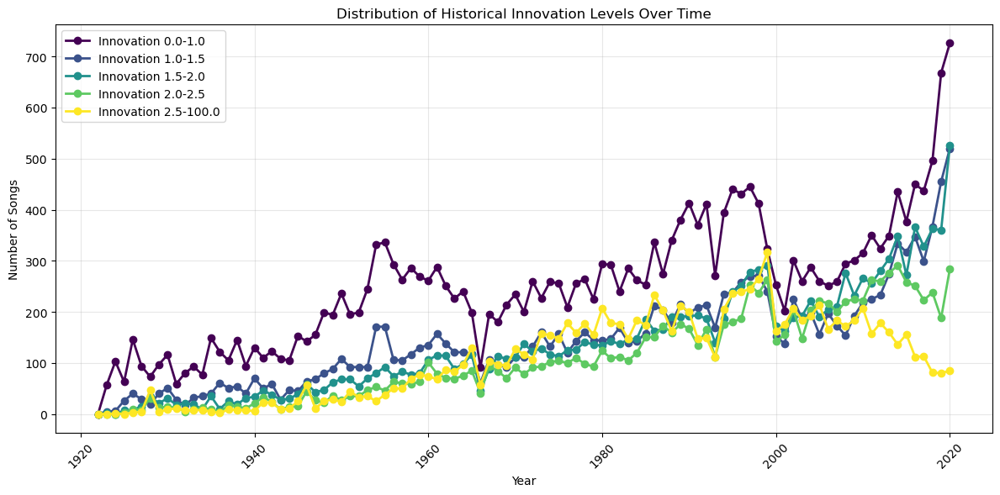

21:25:09 - cmdstanpy - INFO - Chain [1] start processing
21:25:09 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

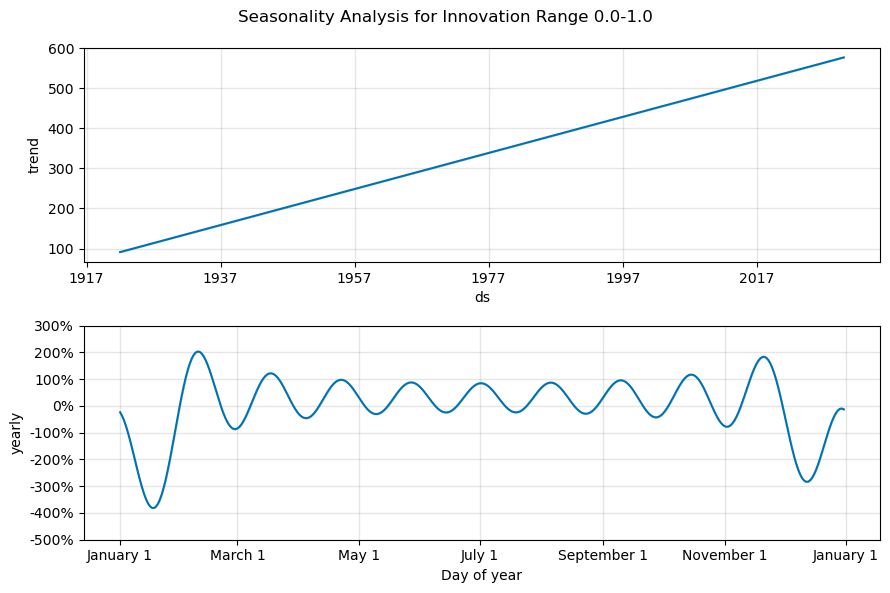

<Figure size 1200x600 with 0 Axes>

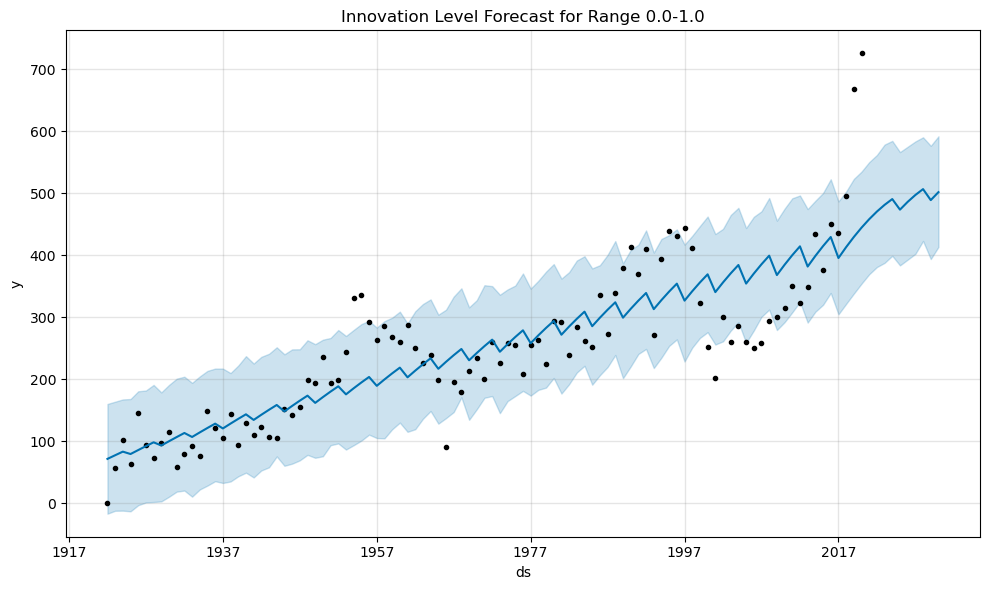

21:25:10 - cmdstanpy - INFO - Chain [1] start processing
21:25:10 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

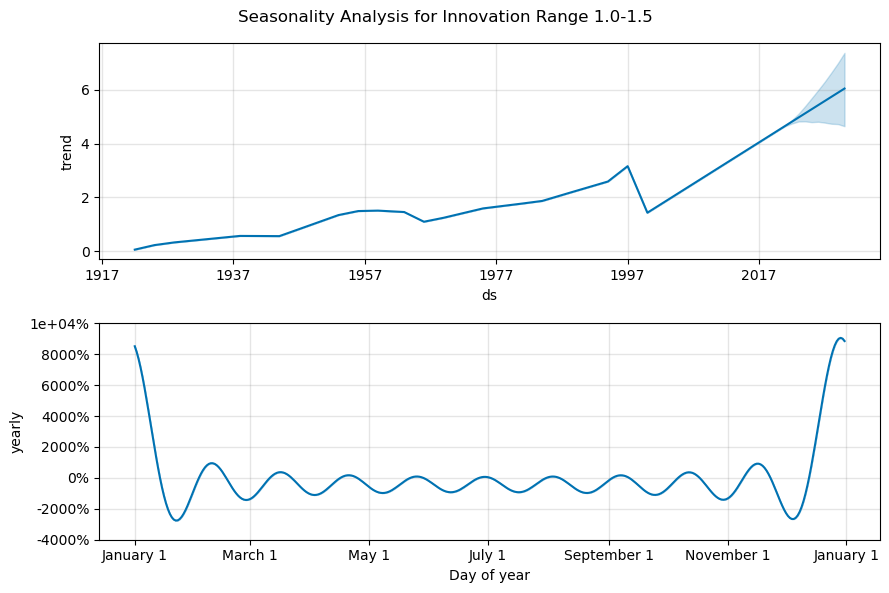

<Figure size 1200x600 with 0 Axes>

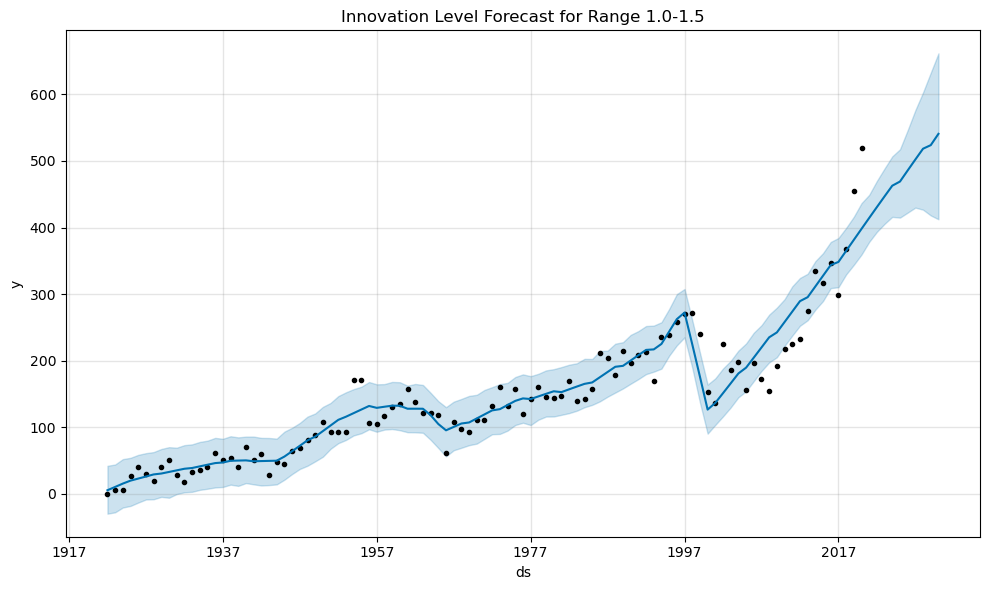

21:25:11 - cmdstanpy - INFO - Chain [1] start processing
21:25:12 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

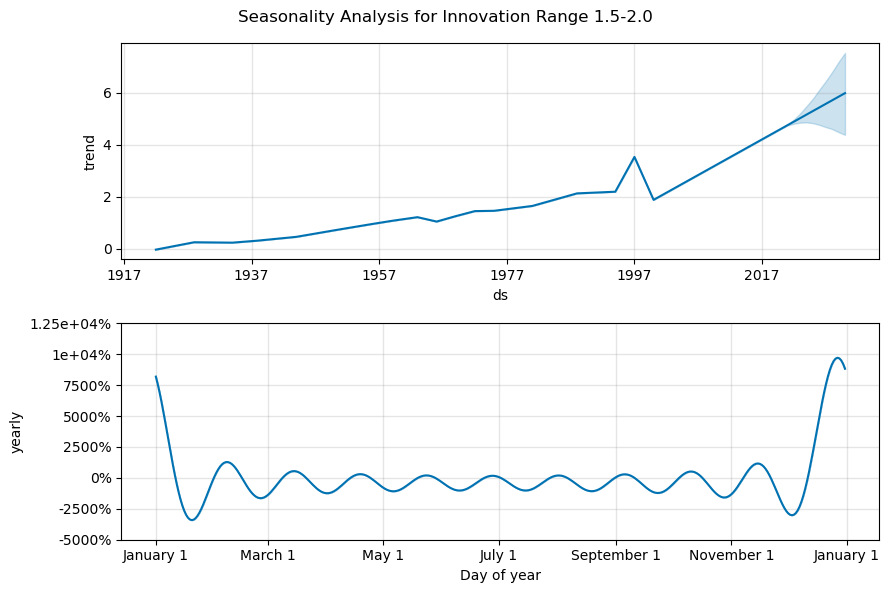

<Figure size 1200x600 with 0 Axes>

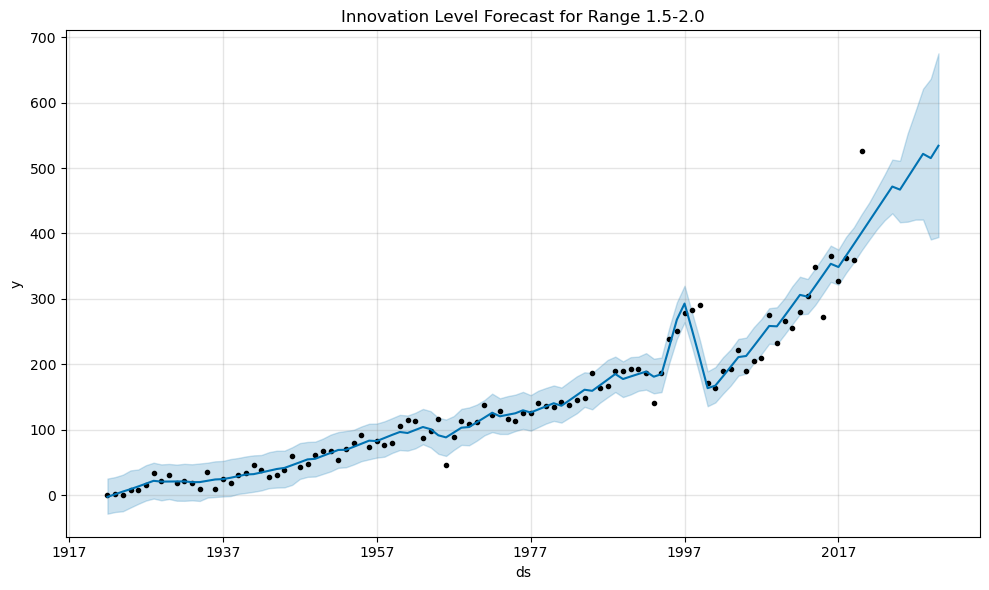

21:25:12 - cmdstanpy - INFO - Chain [1] start processing
21:25:13 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

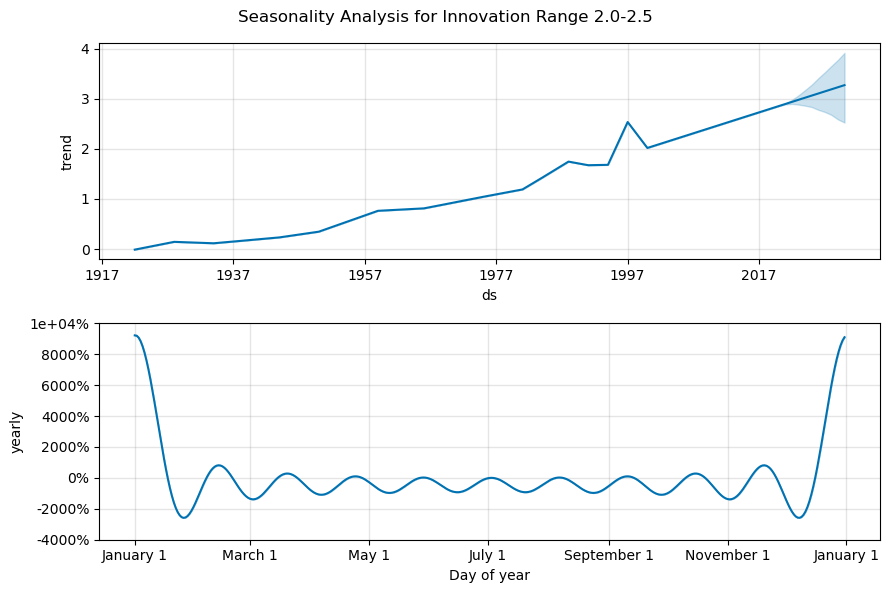

<Figure size 1200x600 with 0 Axes>

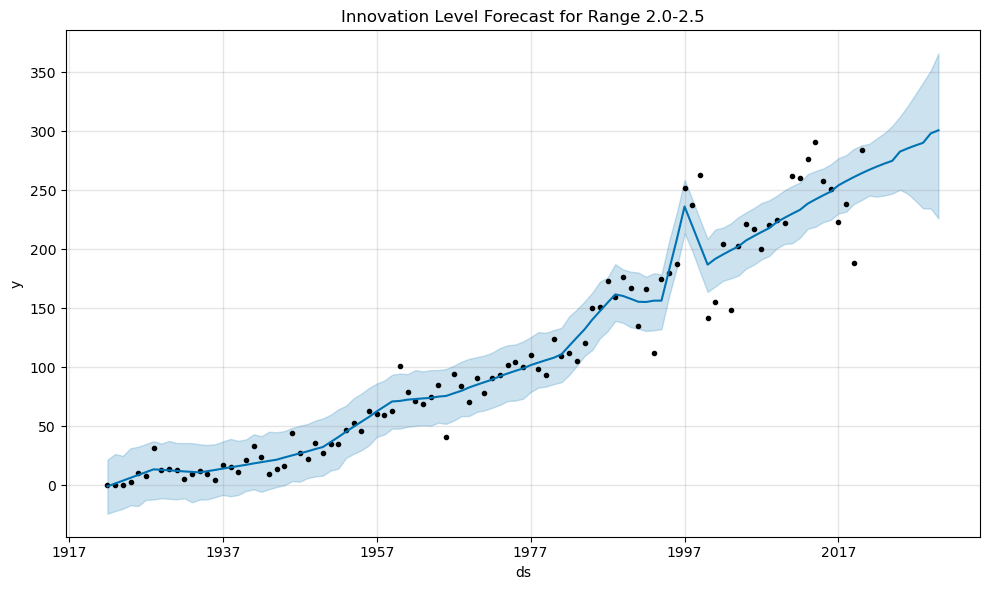

21:25:14 - cmdstanpy - INFO - Chain [1] start processing
21:25:15 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

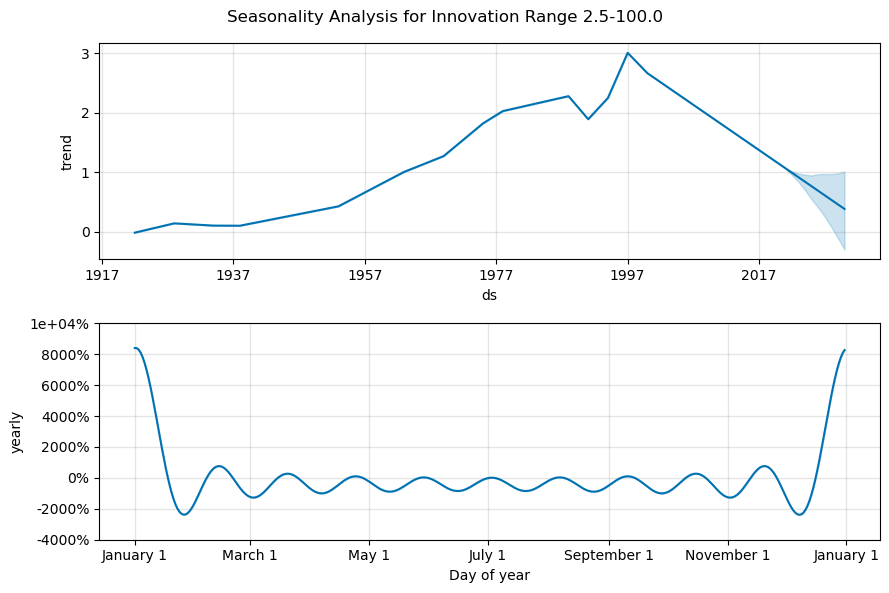

<Figure size 1200x600 with 0 Axes>

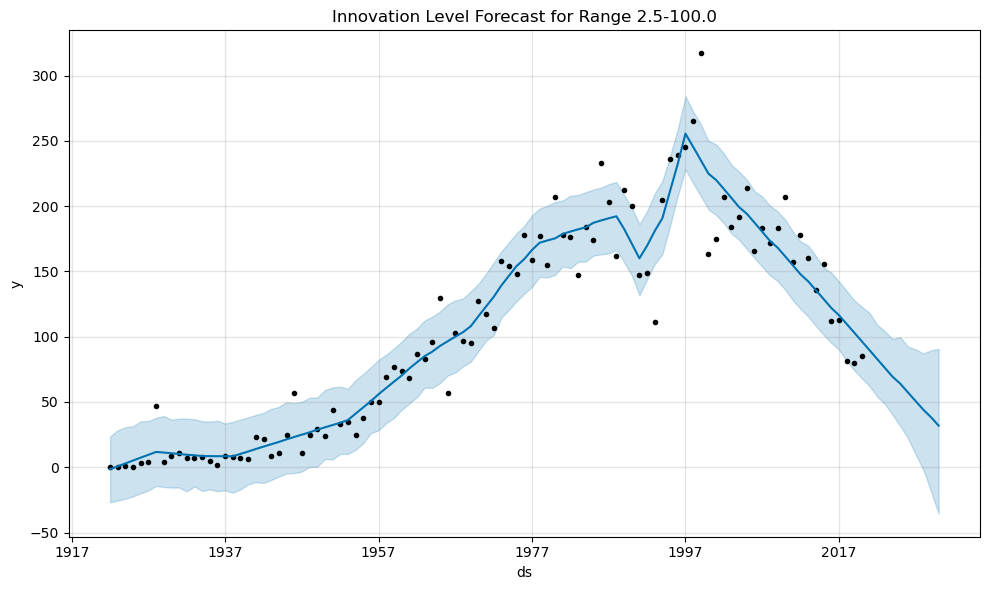

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_periods=10):
    """
    Analyze seasonality in innovation levels using Prophet
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_periods: Number of years to forecast
        
    Returns:
        Dictionary containing Prophet models and forecasts for each innovation range
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    # Prepare data for Prophet analysis
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index, format='%Y'),
            'y': results_df[range_name]
        })
        
        # Initialize and fit Prophet model
        model = Prophet(
            yearly_seasonality=True,
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative'
        )
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(periods=forecast_periods, freq='Y')
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast
        }
        
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        plt.figure(figsize=(12, 6))
        model.plot(forecast)
        plt.title(f'Innovation Level Forecast for Range {range_name}')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 1, 1.5, 2, 2.5, 100]
)

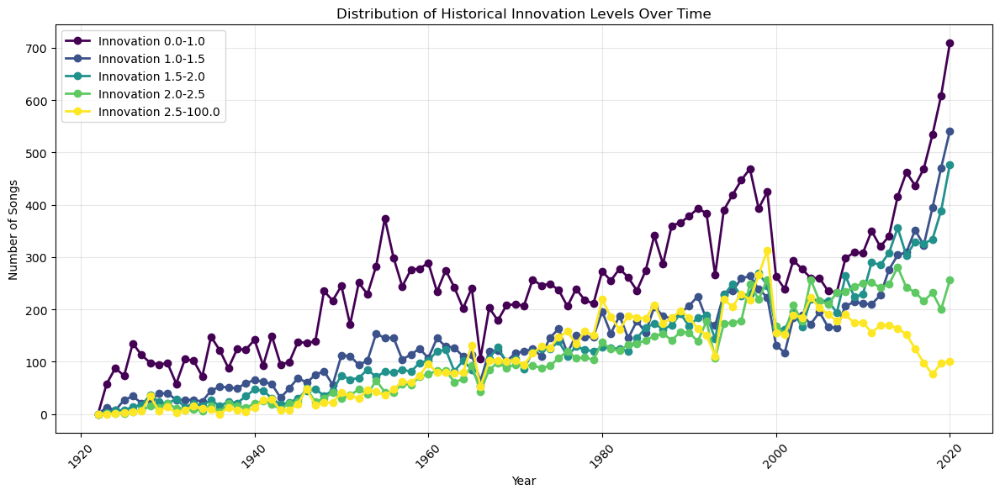

21:29:46 - cmdstanpy - INFO - Chain [1] start processing
21:29:46 - cmdstanpy - INFO - Chain [1] done processing


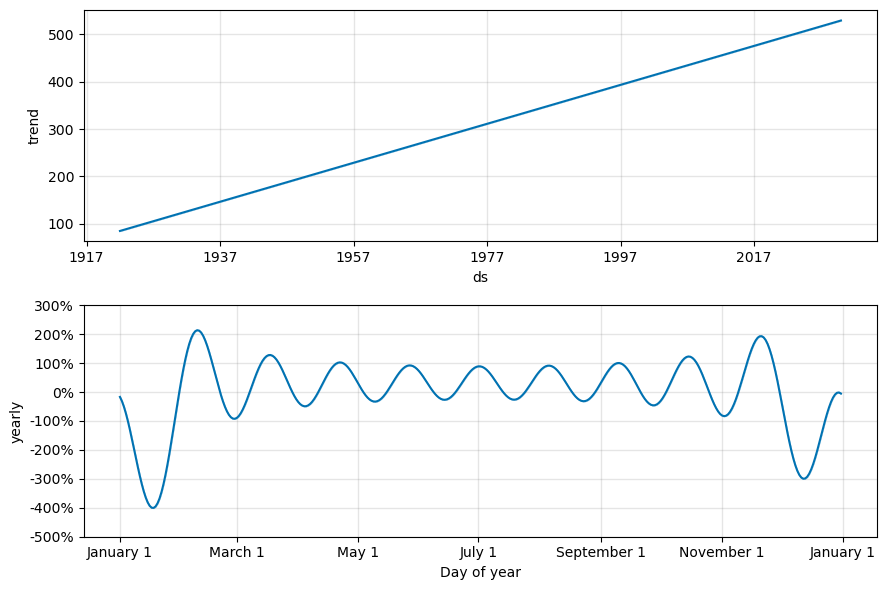

<Figure size 1500x1000 with 0 Axes>

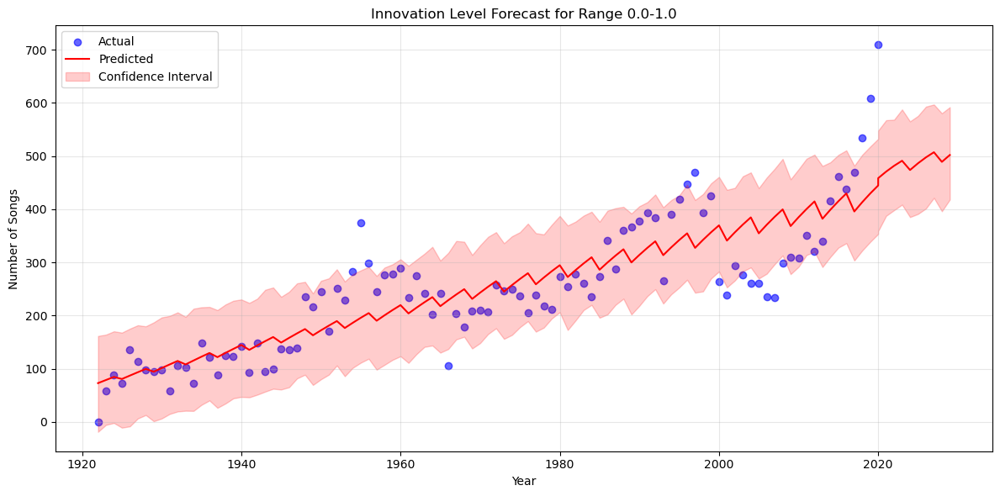

21:29:47 - cmdstanpy - INFO - Chain [1] start processing
21:29:48 - cmdstanpy - INFO - Chain [1] done processing


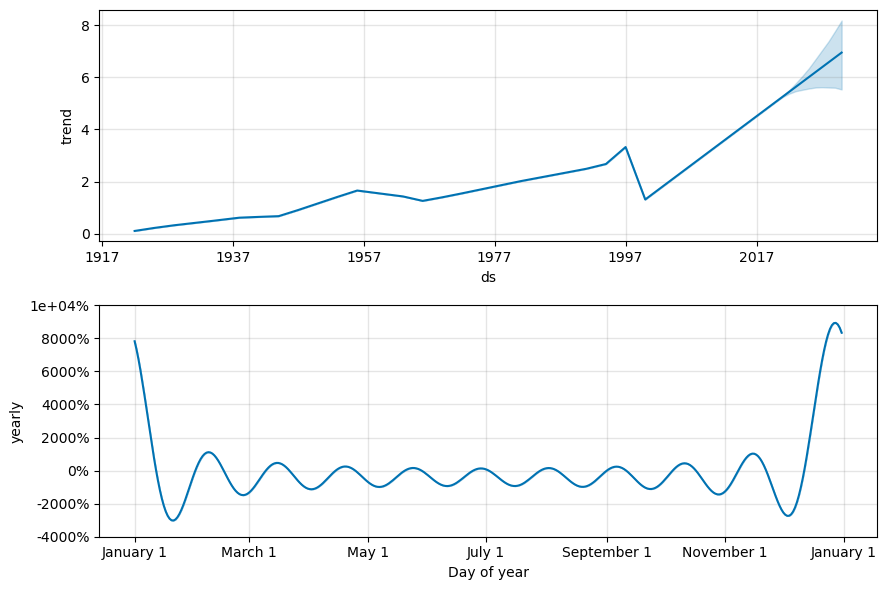

<Figure size 1500x1000 with 0 Axes>

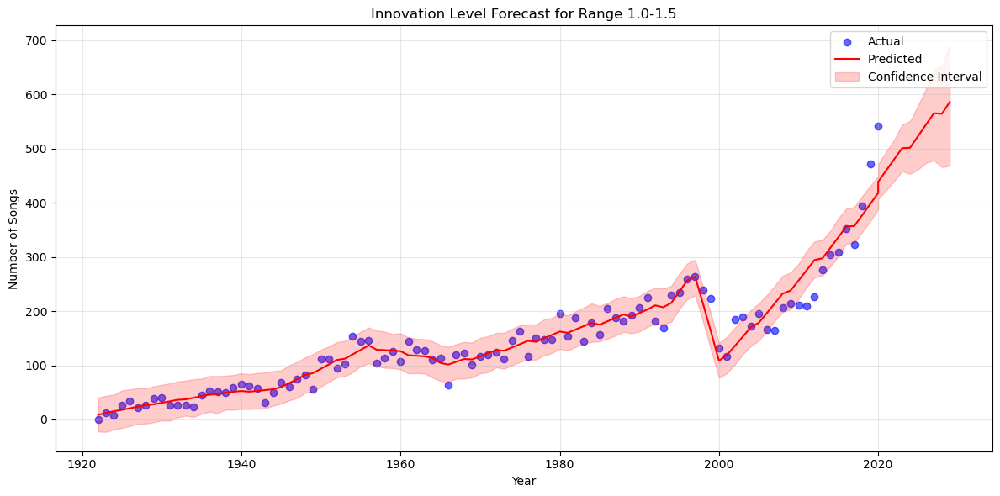

21:29:48 - cmdstanpy - INFO - Chain [1] start processing
21:29:49 - cmdstanpy - INFO - Chain [1] done processing


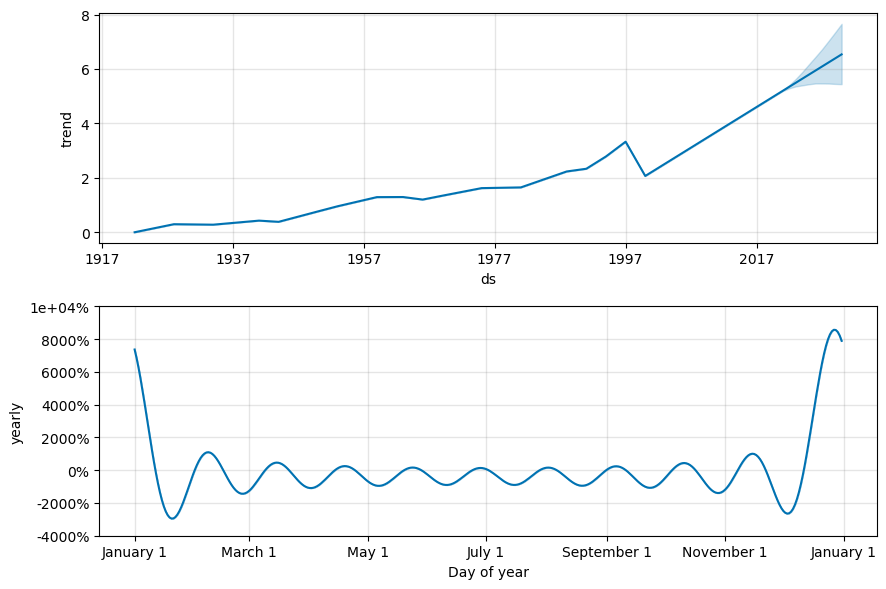

<Figure size 1500x1000 with 0 Axes>

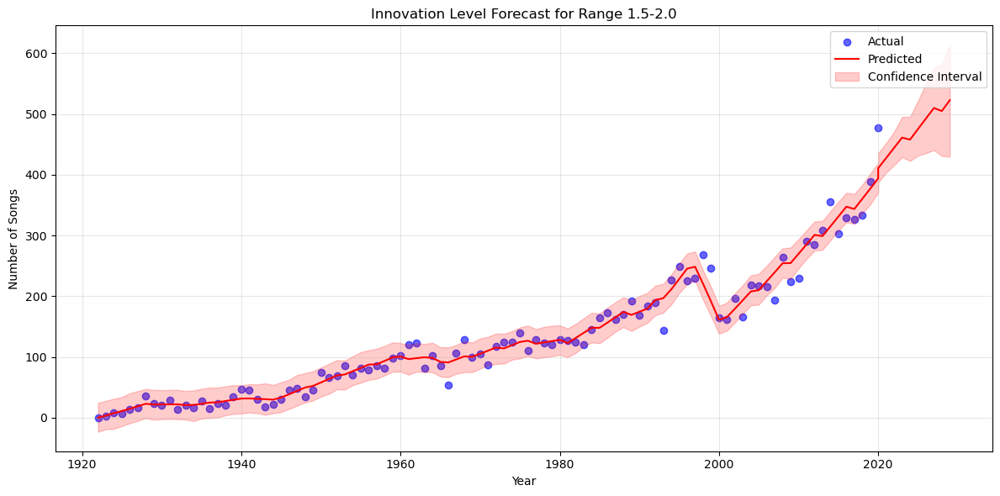

21:29:49 - cmdstanpy - INFO - Chain [1] start processing
21:29:50 - cmdstanpy - INFO - Chain [1] done processing


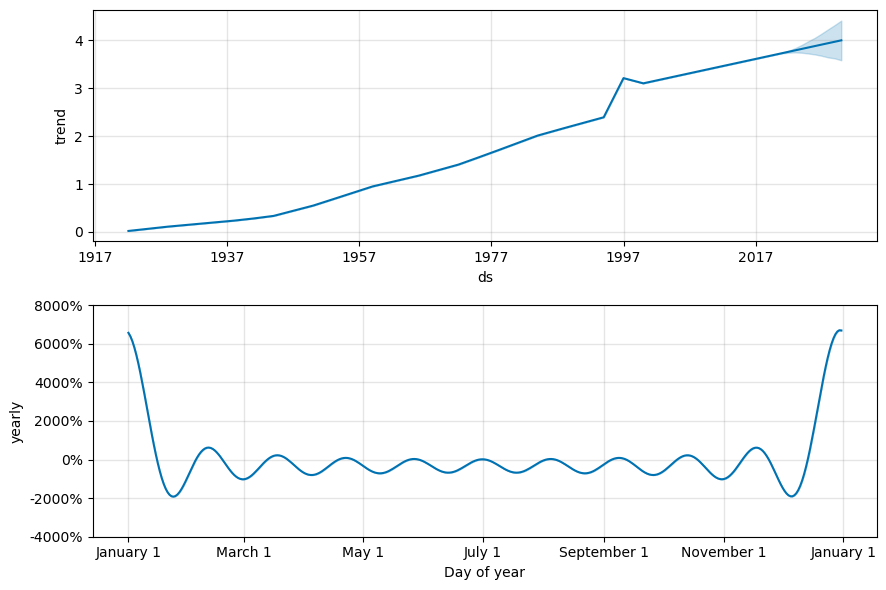

<Figure size 1500x1000 with 0 Axes>

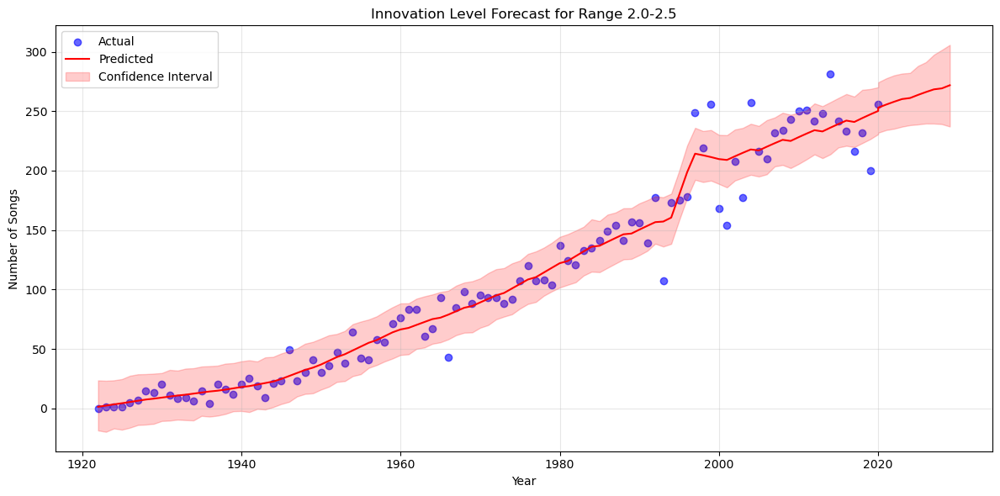

21:29:51 - cmdstanpy - INFO - Chain [1] start processing
21:29:52 - cmdstanpy - INFO - Chain [1] done processing


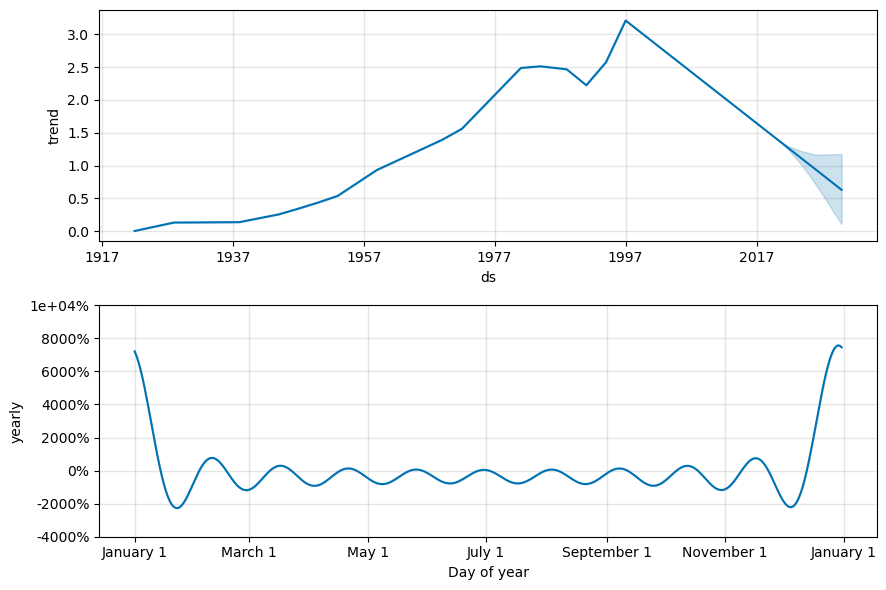

<Figure size 1500x1000 with 0 Axes>

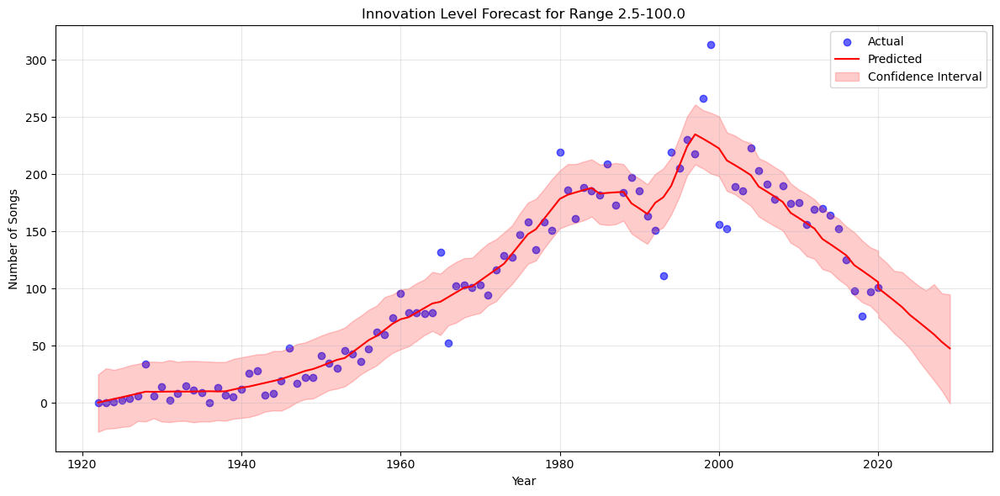

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.05,  # Adjust flexibility of the trend
            seasonality_prior_scale=10.0   # Increase weight of seasonality
        )
        
        # Add custom yearly seasonality
        model.add_seasonality(
            name='yearly',
            period=365.25,
            fourier_order=5  # Adjust complexity of the seasonality
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',  # Use yearly frequency
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast
        }
        
        # Plot components
        fig_comp = model.plot_components(forecast)
        plt.figure(figsize=(15, 10))
        plt.suptitle(f'Trend and Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        fig_forecast = plt.figure(figsize=(12, 6))
        ax = fig_forecast.add_subplot(111)
        
        # Plot actual values
        ax.scatter(df['ds'].dt.year, df['y'], 
                  color='blue', alpha=0.6, label='Actual')
        
        # Plot predicted values
        ax.plot(pd.to_datetime(forecast['ds']).dt.year, 
                forecast['yhat'], 'r-', label='Predicted')
        
        # Add confidence interval
        ax.fill_between(pd.to_datetime(forecast['ds']).dt.year,
                       forecast['yhat_lower'],
                       forecast['yhat_upper'],
                       color='red', alpha=0.2,
                       label='Confidence Interval')
        
        ax.set_xlabel('Year')
        ax.set_ylabel('Number of Songs')
        ax.set_title(f'Innovation Level Forecast for Range {range_name}')
        ax.legend()
        ax.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 1, 1.5, 2, 2.5, 100],
    forecast_years=10
)

In [ ]:
# %%

def analyze_innovation_cycles(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                            bins=[0, 1, 2, 3, 4], distance_type='historical',
                            forecast_years=10, cycle_periods=[5, 10, 20]):
    """
    Analyze cycles in innovation levels using Prophet
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate
        forecast_years: Number of years to forecast
        cycle_periods: List of cycle periods (in years) to test
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str)),
            'y': results_df[range_name]
        })
        
        # Test different cycle periods
        models = {}
        metrics = {}
        
        for period in cycle_periods:
            # Initialize Prophet model
            model = Prophet(
                yearly_seasonality=False,  # Disable default yearly seasonality
                weekly_seasonality=False,
                daily_seasonality=False,
                changepoint_prior_scale=0.05
            )
            
            # Add custom cycle
            model.add_seasonality(
                name=f'cycle_{period}',
                period=period * 365.25,  # Convert years to days for Prophet
                fourier_order=3
            )
            
            model.fit(df)
            
            # Make predictions for the training period
            train_forecast = model.predict(df)
            
            # Calculate error metrics
            mse = np.mean((df['y'] - train_forecast['yhat'])**2)
            metrics[period] = mse
            models[period] = model
        
        # Select best period based on MSE
        best_period = min(metrics, key=metrics.get)
        best_model = models[best_period]
        
        # Make future predictions with best model
        future = best_model.make_future_dataframe(
            periods=forecast_years,
            freq='Y'
        )
        forecast = best_model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': best_model,
            'forecast': forecast,
            'best_period': best_period,
            'metrics': metrics
        }
        
        # Plot results
        plt.figure(figsize=(15, 10))
        
        # Create subplots
        fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 12))
        
        # Plot 1: Actual vs Predicted with Forecast
        ax1.scatter(df['ds'].dt.year, df['y'], 
                   color='blue', alpha=0.6, label='Actual')
        ax1.plot(pd.to_datetime(forecast['ds']).dt.year, 
                 forecast['yhat'], 'r-', label='Predicted/Forecast')
        ax1.fill_between(pd.to_datetime(forecast['ds']).dt.year,
                        forecast['yhat_lower'],
                        forecast['yhat_upper'],
                        color='red', alpha=0.2,
                        label='Confidence Interval')
        
        ax1.set_xlabel('Year')
        ax1.set_ylabel('Number of Songs')
        ax1.set_title(f'Innovation Level Forecast for Range {range_name}\n'
                     f'Best Cycle Period: {best_period} years')
        ax1.legend()
        ax1.grid(True, alpha=0.3)
        
        # Plot 2: Cycle Component
        cycle_component = forecast[f'cycle_{best_period}']
        years = pd.to_datetime(forecast['ds']).dt.year
        ax2.plot(years, cycle_component, 'g-', label=f'{best_period}-Year Cycle')
        ax2.set_xlabel('Year')
        ax2.set_ylabel('Cycle Effect')
        ax2.set_title(f'Identified {best_period}-Year Cycle Component')
        ax2.grid(True, alpha=0.3)
        ax2.legend()
        
        # Add MSE comparison text
        mse_text = "MSE for different periods:\n" + \
                   "\n".join([f"{p} years: {m:.4f}" for p, m in metrics.items())
        ax2.text(0.02, 0.98, mse_text,
                transform=ax2.transAxes,
                verticalalignment='top',
                bbox=dict(facecolor='white', alpha=0.8))
        
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_cycles(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 1, 1.5, 2, 2.5, 100],
    forecast_years=10,
    cycle_periods=[5, 10, 15, 20]  # Test different cycle periods
)

SyntaxError: closing parenthesis ')' does not match opening parenthesis '[' (1772150676.py, line 121)

In [ ]:
# %% plot yearly centroids movement vectors

def plot_yearly_movement_vectors(cluster_data, artist_name=None, sample_size=0.1, seed=None):
    """
    Plot yearly movement vectors with tails at origin to compare directions and magnitudes
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
    """
    # Extract data
    num_clusters, colors, cluster_data = exact_to_pd(cluster_data, artist_name, sample_size, seed)
    
    # Process data year by year to get centroids
    years = sorted(cluster_data['year'].unique())
    centroids = []
    
    for year in years:
        year_data = cluster_data[cluster_data['year'] == year]
        if not year_data.empty:
            current_points = np.array([
                [float(features[0]), float(features[1])] 
                for features in year_data['features']
            ])
            current_centroid = current_points.mean(axis=0)
            centroids.append((year, current_centroid))
    
    # Calculate yearly movement vectors
    movement_vectors = []
    movement_years = []
    
    for i in range(1, len(centroids)):
        prev_year, prev_centroid = centroids[i-1]
        curr_year, curr_centroid = centroids[i]
        
        # Calculate yearly movement vector
        yearly_vector = curr_centroid - prev_centroid
        movement_vectors.append(yearly_vector)
        movement_years.append(curr_year)
    
    # Create figure
    plt.figure(figsize=(12, 12))
    
    # Create color gradient based on years
    num_years = len(movement_years)
    colors = plt.cm.viridis(np.linspace(0, 1, num_years))
    
    # Plot movement vectors from origin
    for i, vector in enumerate(movement_vectors):
        plt.quiver(0, 0, vector[0], vector[1], 
                  angles='xy', scale_units='xy', scale=1,
                  color=colors[i], alpha=0.7)
        # Add year label at vector tip
        plt.annotate(str(movement_years[i]), 
                    (vector[0], vector[1]),
                    xytext=(5, 5), textcoords='offset points')
    
    # Add colorbar to show year progression
    sm = plt.cm.ScalarMappable(cmap=plt.cm.viridis, 
                              norm=plt.Normalize(vmin=min(movement_years), 
                                               vmax=max(movement_years)))
    plt.colorbar(sm, label='Year')
    
    plt.xlabel('First Principal Component Change')
    plt.ylabel('Second Principal Component Change')
    title = "Yearly Movement Vectors in Music Style Space"
    if artist_name:
        title = f"{artist_name}: {title}"
    plt.title(title)
    plt.grid(True, alpha=0.3)
    plt.axhline(y=0, color='k', linestyle='-', alpha=0.3)
    plt.axvline(x=0, color='k', linestyle='-', alpha=0.3)
    
    plt.xlim(-0.5, 0.5)
    plt.ylim(-0.5, 0.5)
    
    plt.tight_layout()
    plt.show()

# Example usage
plot_yearly_movement_vectors(cluster_results, sample_size=0.1)

plot_yearly_movement_vectors(cluster_results, artist_name="Taylor Swift",sample_size=0.1)

KeyboardInterrupt: 

In [ ]:
# %%

def analyze_innovation_cycles(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                            bins=[0, 1, 2, 3, 4], distance_type='historical',
                            forecast_years=10, cycle_periods=[5, 10, 20]):
    """
    Analyze cycles in innovation levels using Prophet
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate
        forecast_years: Number of years to forecast
        cycle_periods: List of cycle periods (in years) to test
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str)),
            'y': results_df[range_name]
        })
        
        # Test different cycle periods
        models = {}
        metrics = {}
        
        for period in cycle_periods:
            # Initialize Prophet model
            model = Prophet(
                yearly_seasonality=False,  # Disable default yearly seasonality
                weekly_seasonality=False,
                daily_seasonality=False,
                changepoint_prior_scale=0.05
            )
            
            # Add custom cycle
            model.add_seasonality(
                name=f'cycle_{period}',
                period=period * 365.25,  # Convert years to days for Prophet
                fourier_order=3
            )
            
            model.fit(df)
            
            # Make predictions for the training period
            train_forecast = model.predict(df)
            
            # Calculate error metrics
            mse = np.mean((df['y'] - train_forecast['yhat'])**2)
            metrics[period] = mse
            models[period] = model
        
        # Select best period based on MSE
        best_period = min(metrics, key=metrics.get)
        best_model = models[best_period]
        
        # Make future predictions with best model
        future = best_model.make_future_dataframe(
            periods=forecast_years,
            freq='Y'
        )
        forecast = best_model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': best_model,
            'forecast': forecast,
            'best_period': best_period,
            'metrics': metrics
        }
        
        # Plot results
        plt.figure(figsize=(15, 10))
        
        # Create subplots
        fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 12))
        
        # Plot 1: Actual vs Predicted with Forecast
        ax1.scatter(df['ds'].dt.year, df['y'], 
                   color='blue', alpha=0.6, label='Actual')
        ax1.plot(pd.to_datetime(forecast['ds']).dt.year, 
                 forecast['yhat'], 'r-', label='Predicted/Forecast')
        ax1.fill_between(pd.to_datetime(forecast['ds']).dt.year,
                        forecast['yhat_lower'],
                        forecast['yhat_upper'],
                        color='red', alpha=0.2,
                        label='Confidence Interval')
        
        ax1.set_xlabel('Year')
        ax1.set_ylabel('Number of Songs')
        ax1.set_title(f'Innovation Level Forecast for Range {range_name}\n'
                     f'Best Cycle Period: {best_period} years')
        ax1.legend()
        ax1.grid(True, alpha=0.3)
        
        # Plot 2: Cycle Component
        cycle_component = forecast[f'cycle_{best_period}']
        years = pd.to_datetime(forecast['ds']).dt.year
        ax2.plot(years, cycle_component, 'g-', label=f'{best_period}-Year Cycle')
        ax2.set_xlabel('Year')
        ax2.set_ylabel('Cycle Effect')
        ax2.set_title(f'Identified {best_period}-Year Cycle Component')
        ax2.grid(True, alpha=0.3)
        ax2.legend()
        
        # Add MSE comparison text
        mse_text = "MSE for different periods:\n" + \
                   "\n".join([f"{p} years: {m:.4f}" for p, m in metrics.items())
        ax2.text(0.02, 0.98, mse_text,
                transform=ax2.transAxes,
                verticalalignment='top',
                bbox=dict(facecolor='white', alpha=0.8))
        
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_cycles(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 1, 1.5, 2, 2.5, 100],
    forecast_years=10,
    cycle_periods=[5, 10, 15, 20]  # Test different cycle periods
)

: 

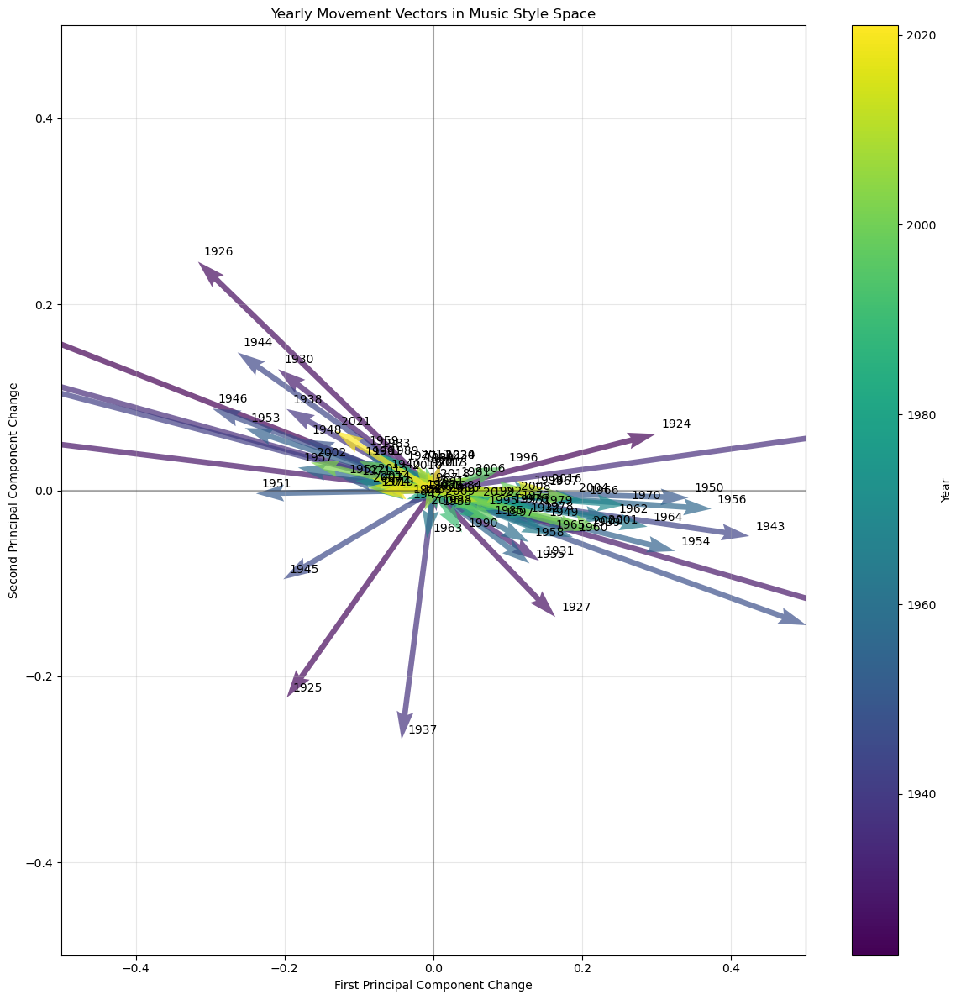

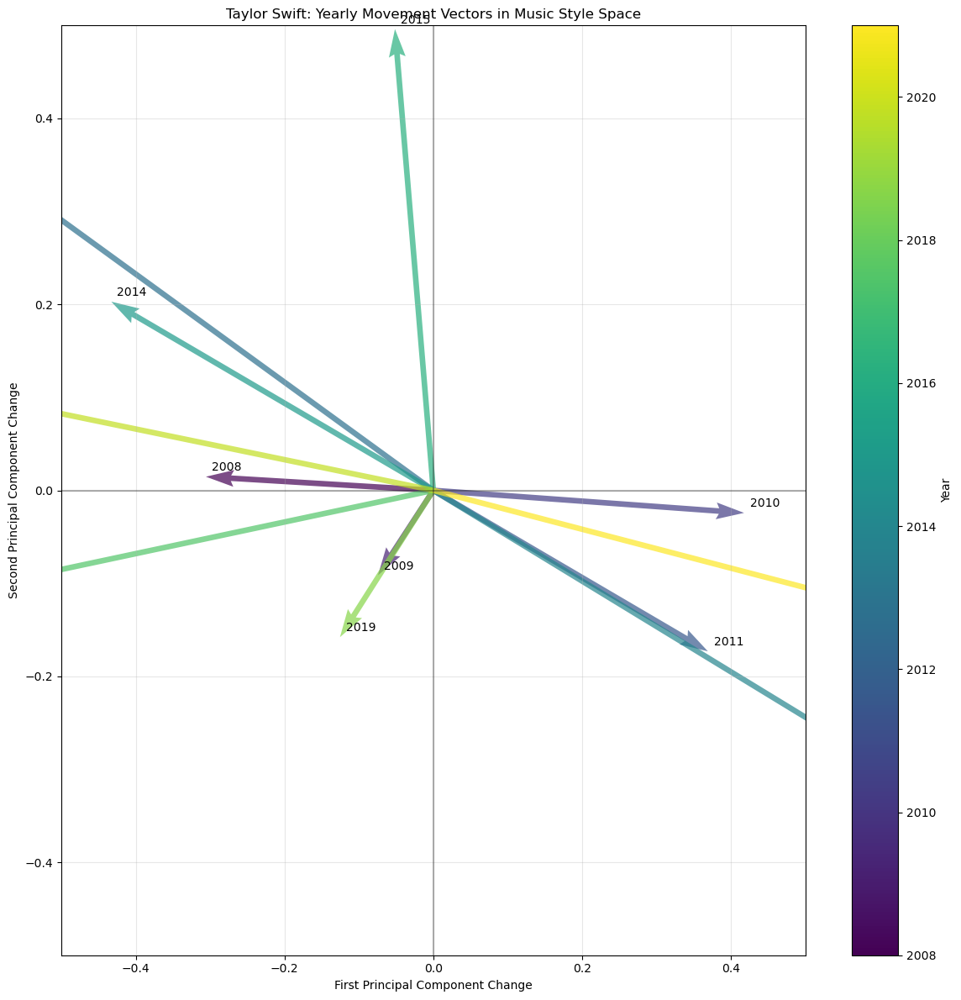

In [ ]:
# %% plot yearly centroids movement vectors

def plot_yearly_movement_vectors(cluster_data, artist_name=None, sample_size=0.1, seed=None):
    """
    Plot yearly movement vectors with tails at origin to compare directions and magnitudes
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
    """
    # Extract data
    num_clusters, colors, cluster_data = exact_to_pd(cluster_data, artist_name, sample_size, seed)
    
    # Process data year by year to get centroids
    years = sorted(cluster_data['year'].unique())
    centroids = []
    
    for year in years:
        year_data = cluster_data[cluster_data['year'] == year]
        if not year_data.empty:
            current_points = np.array([
                [float(features[0]), float(features[1])] 
                for features in year_data['features']
            ])
            current_centroid = current_points.mean(axis=0)
            centroids.append((year, current_centroid))
    
    # Calculate yearly movement vectors
    movement_vectors = []
    movement_years = []
    
    for i in range(1, len(centroids)):
        prev_year, prev_centroid = centroids[i-1]
        curr_year, curr_centroid = centroids[i]
        
        # Calculate yearly movement vector
        yearly_vector = curr_centroid - prev_centroid
        movement_vectors.append(yearly_vector)
        movement_years.append(curr_year)
    
    # Create figure
    plt.figure(figsize=(12, 12))
    
    # Create color gradient based on years
    num_years = len(movement_years)
    colors = plt.cm.viridis(np.linspace(0, 1, num_years))
    
    # Plot movement vectors from origin
    for i, vector in enumerate(movement_vectors):
        plt.quiver(0, 0, vector[0], vector[1], 
                  angles='xy', scale_units='xy', scale=1,
                  color=colors[i], alpha=0.7)
        # Add year label at vector tip
        plt.annotate(str(movement_years[i]), 
                    (vector[0], vector[1]),
                    xytext=(5, 5), textcoords='offset points')
    
    # Add colorbar to show year progression
    sm = plt.cm.ScalarMappable(cmap=plt.cm.viridis, 
                              norm=plt.Normalize(vmin=min(movement_years), 
                                               vmax=max(movement_years)))
    plt.colorbar(sm, label='Year')
    
    plt.xlabel('First Principal Component Change')
    plt.ylabel('Second Principal Component Change')
    title = "Yearly Movement Vectors in Music Style Space"
    if artist_name:
        title = f"{artist_name}: {title}"
    plt.title(title)
    plt.grid(True, alpha=0.3)
    plt.axhline(y=0, color='k', linestyle='-', alpha=0.3)
    plt.axvline(x=0, color='k', linestyle='-', alpha=0.3)
    
    plt.xlim(-0.5, 0.5)
    plt.ylim(-0.5, 0.5)
    
    plt.tight_layout()
    plt.show()

# Example usage
plot_yearly_movement_vectors(cluster_results, sample_size=0.1)

plot_yearly_movement_vectors(cluster_results, artist_name="Taylor Swift",sample_size=0.1)

In [ ]:
# %%

def analyze_innovation_cycles(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                            bins=[0, 1, 2, 3, 4], distance_type='historical',
                            forecast_years=10, cycle_periods=[5, 10, 20]):
    """
    Analyze cycles in innovation levels using Prophet
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate
        forecast_years: Number of years to forecast
        cycle_periods: List of cycle periods (in years) to test
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str)),
            'y': results_df[range_name]
        })
        
        # Test different cycle periods
        models = {}
        metrics = {}
        
        for period in cycle_periods:
            # Initialize Prophet model
            model = Prophet(
                yearly_seasonality=False,  # Disable default yearly seasonality
                weekly_seasonality=False,
                daily_seasonality=False,
                changepoint_prior_scale=0.05
            )
            
            # Add custom cycle
            model.add_seasonality(
                name=f'cycle_{period}',
                period=period * 365.25,  # Convert years to days for Prophet
                fourier_order=3
            )
            
            model.fit(df)
            
            # Make predictions for the training period
            train_forecast = model.predict(df)
            
            # Calculate error metrics
            mse = np.mean((df['y'] - train_forecast['yhat'])**2)
            metrics[period] = mse
            models[period] = model
        
        # Select best period based on MSE
        best_period = min(metrics, key=metrics.get)
        best_model = models[best_period]
        
        # Make future predictions with best model
        future = best_model.make_future_dataframe(
            periods=forecast_years,
            freq='Y'
        )
        forecast = best_model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': best_model,
            'forecast': forecast,
            'best_period': best_period,
            'metrics': metrics
        }
        
        # Plot results
        plt.figure(figsize=(15, 10))
        
        # Create subplots
        fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 12))
        
        # Plot 1: Actual vs Predicted with Forecast
        ax1.scatter(df['ds'].dt.year, df['y'], 
                   color='blue', alpha=0.6, label='Actual')
        ax1.plot(pd.to_datetime(forecast['ds']).dt.year, 
                 forecast['yhat'], 'r-', label='Predicted/Forecast')
        ax1.fill_between(pd.to_datetime(forecast['ds']).dt.year,
                        forecast['yhat_lower'],
                        forecast['yhat_upper'],
                        color='red', alpha=0.2,
                        label='Confidence Interval')
        
        ax1.set_xlabel('Year')
        ax1.set_ylabel('Number of Songs')
        ax1.set_title(f'Innovation Level Forecast for Range {range_name}\n'
                     f'Best Cycle Period: {best_period} years')
        ax1.legend()
        ax1.grid(True, alpha=0.3)
        
        # Plot 2: Cycle Component
        cycle_component = forecast[f'cycle_{best_period}']
        years = pd.to_datetime(forecast['ds']).dt.year
        ax2.plot(years, cycle_component, 'g-', label=f'{best_period}-Year Cycle')
        ax2.set_xlabel('Year')
        ax2.set_ylabel('Cycle Effect')
        ax2.set_title(f'Identified {best_period}-Year Cycle Component')
        ax2.grid(True, alpha=0.3)
        ax2.legend()
        
        # Add MSE comparison text
        mse_text = "MSE for different periods:\n" + \
                   "\n".join([f"{p} years: {m:.4f}" for p, m in metrics.items())
        ax2.text(0.02, 0.98, mse_text,
                transform=ax2.transAxes,
                verticalalignment='top',
                bbox=dict(facecolor='white', alpha=0.8))
        
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_cycles(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 1, 1.5, 2, 2.5, 100],
    forecast_years=10,
    cycle_periods=[5, 10, 15, 20]  # Test different cycle periods
)

SyntaxError: closing parenthesis ')' does not match opening parenthesis '[' (1772150676.py, line 121)

21:36:23 - cmdstanpy - INFO - Chain [1] start processing
21:36:24 - cmdstanpy - INFO - Chain [1] done processing
21:36:24 - cmdstanpy - INFO - Chain [1] start processing
21:36:24 - cmdstanpy - INFO - Chain [1] done processing
21:36:24 - cmdstanpy - INFO - Chain [1] start processing
21:36:24 - cmdstanpy - INFO - Chain [1] done processing
21:36:24 - cmdstanpy - INFO - Chain [1] start processing
21:36:25 - cmdstanpy - INFO - Chain [1] done processing


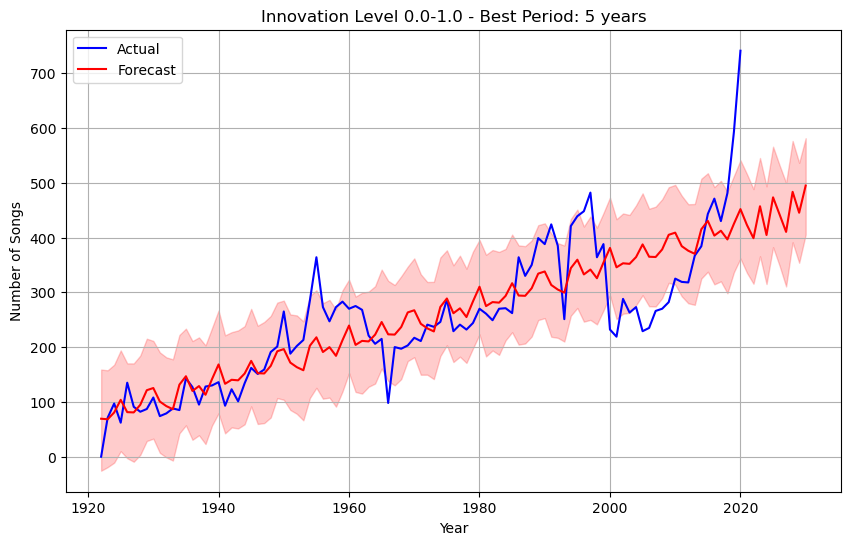

21:36:25 - cmdstanpy - INFO - Chain [1] start processing
21:36:25 - cmdstanpy - INFO - Chain [1] done processing
21:36:25 - cmdstanpy - INFO - Chain [1] start processing
21:36:26 - cmdstanpy - INFO - Chain [1] done processing
21:36:26 - cmdstanpy - INFO - Chain [1] start processing
21:36:26 - cmdstanpy - INFO - Chain [1] done processing
21:36:26 - cmdstanpy - INFO - Chain [1] start processing
21:36:26 - cmdstanpy - INFO - Chain [1] done processing


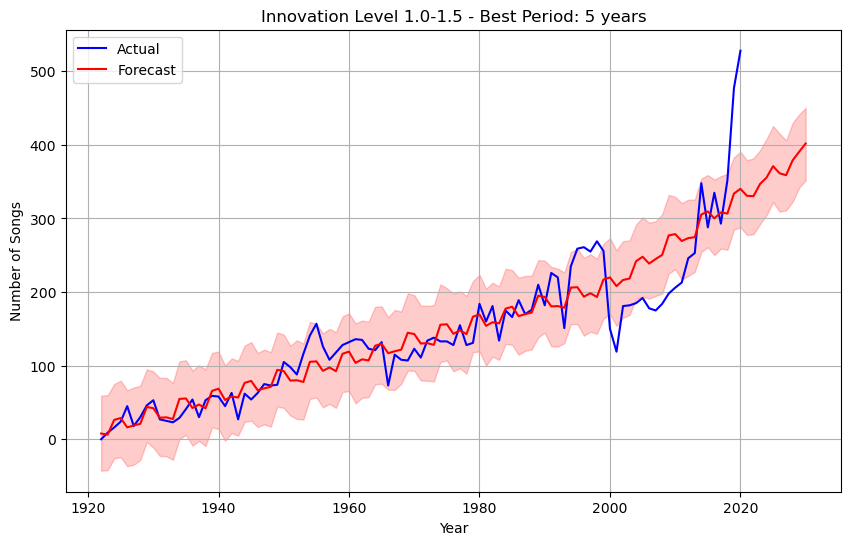

21:36:27 - cmdstanpy - INFO - Chain [1] start processing
21:36:27 - cmdstanpy - INFO - Chain [1] done processing
21:36:27 - cmdstanpy - INFO - Chain [1] start processing
21:36:28 - cmdstanpy - INFO - Chain [1] done processing
21:36:28 - cmdstanpy - INFO - Chain [1] start processing
21:36:29 - cmdstanpy - INFO - Chain [1] done processing
21:36:29 - cmdstanpy - INFO - Chain [1] start processing
21:36:29 - cmdstanpy - INFO - Chain [1] done processing


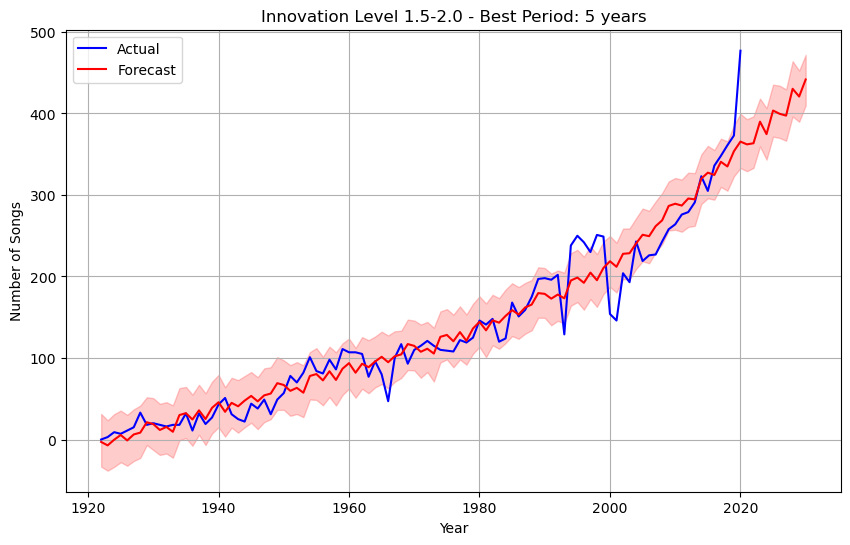

21:36:29 - cmdstanpy - INFO - Chain [1] start processing
21:36:30 - cmdstanpy - INFO - Chain [1] done processing
21:36:30 - cmdstanpy - INFO - Chain [1] start processing
21:36:30 - cmdstanpy - INFO - Chain [1] done processing
21:36:30 - cmdstanpy - INFO - Chain [1] start processing
21:36:31 - cmdstanpy - INFO - Chain [1] done processing
21:36:31 - cmdstanpy - INFO - Chain [1] start processing
21:36:31 - cmdstanpy - INFO - Chain [1] done processing


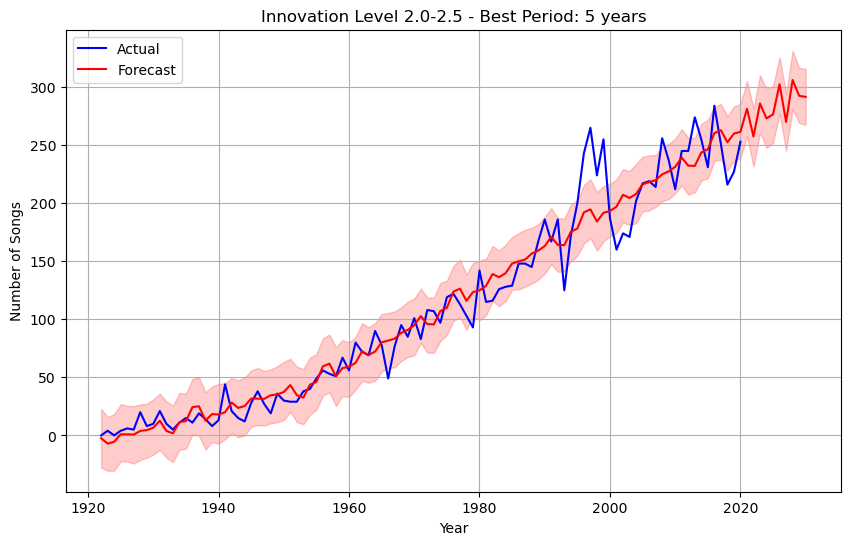

21:36:31 - cmdstanpy - INFO - Chain [1] start processing
21:36:32 - cmdstanpy - INFO - Chain [1] done processing
21:36:32 - cmdstanpy - INFO - Chain [1] start processing
21:36:32 - cmdstanpy - INFO - Chain [1] done processing
21:36:32 - cmdstanpy - INFO - Chain [1] start processing
21:36:33 - cmdstanpy - INFO - Chain [1] done processing
21:36:33 - cmdstanpy - INFO - Chain [1] start processing
21:36:33 - cmdstanpy - INFO - Chain [1] done processing


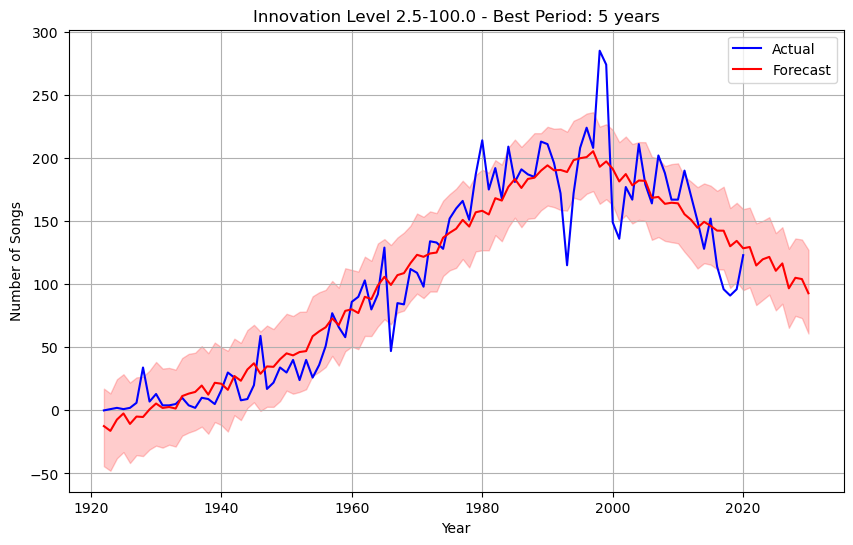

In [ ]:
# %%

from prophet import Prophet
import pandas as pd
import matplotlib.pyplot as plt

# 假设 results_df 包含时间序列数据，每列是一个创新水平区间
bin_ranges = ["0.0-1.0", "1.0-1.5", "1.5-2.0", "2.0-2.5", "2.5-100.0"]

prophet_results = {}

for range_name in bin_ranges:
    # 数据准备
    df = pd.DataFrame({
        'ds': pd.to_datetime(results_df.index.astype(str)),
        'y': results_df[range_name]
    })

    # 测试不同周期长度
    cycle_periods = [5, 10, 15, 20]
    metrics = {}
    models = {}

    for period in cycle_periods:
        model = Prophet(
            yearly_seasonality=False,  # 禁用默认年季节性
            weekly_seasonality=False,
            daily_seasonality=False,
            changepoint_prior_scale=0.1  # 调整 changepoint 灵敏度
        )
        model.add_seasonality(name=f'cycle_{period}', period=period * 365.25, fourier_order=3)
        model.fit(df)

        # 训练集预测
        train_forecast = model.predict(df)
        mse = ((df['y'] - train_forecast['yhat'])**2).mean()
        metrics[period] = mse
        models[period] = model

    # 选择最佳周期长度
    best_period = min(metrics, key=metrics.get)
    best_model = models[best_period]

    # 长期预测
    future = best_model.make_future_dataframe(periods=10, freq='Y')
    forecast = best_model.predict(future)

    # 存储结果
    prophet_results[range_name] = {
        'model': best_model,
        'forecast': forecast,
        'best_period': best_period,
        'metrics': metrics
    }

    # 可视化
    plt.figure(figsize=(10, 6))
    plt.plot(df['ds'], df['y'], label='Actual', color='blue')
    plt.plot(forecast['ds'], forecast['yhat'], label='Forecast', color='red')
    plt.fill_between(forecast['ds'], forecast['yhat_lower'], forecast['yhat_upper'], alpha=0.2, color='red')
    plt.title(f"Innovation Level {range_name} - Best Period: {best_period} years")
    plt.xlabel("Year")
    plt.ylabel("Number of Songs")
    plt.legend()
    plt.grid(True)
    plt.show()

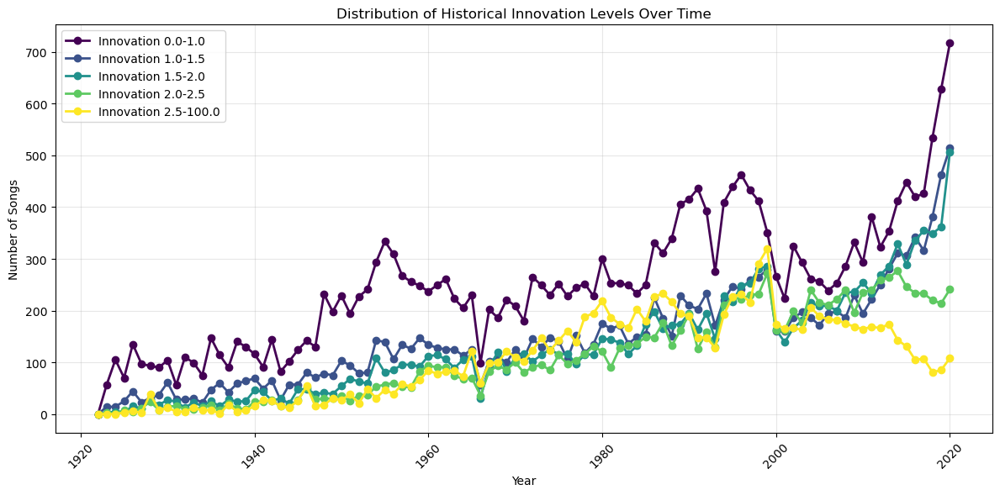

21:37:16 - cmdstanpy - INFO - Chain [1] start processing
21:37:17 - cmdstanpy - INFO - Chain [1] done processing


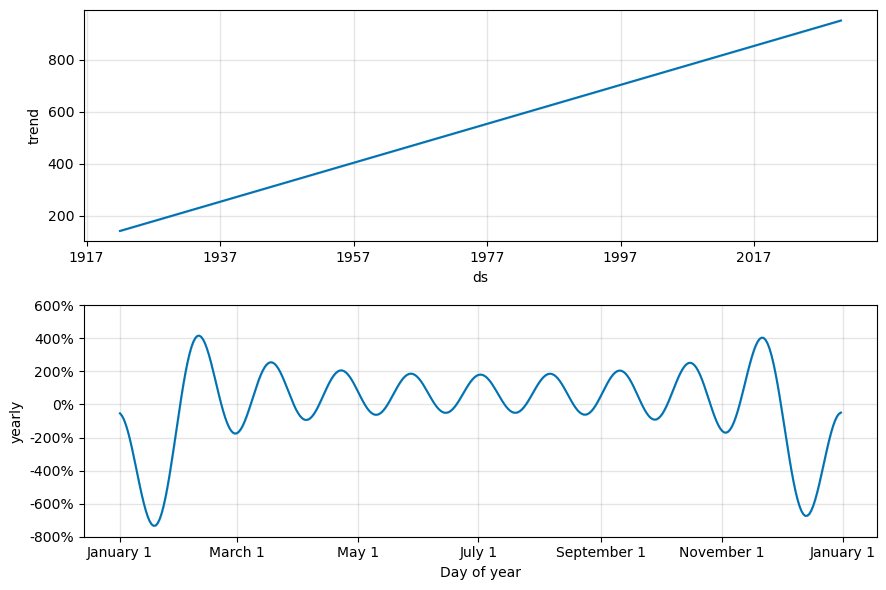

<Figure size 1500x1000 with 0 Axes>

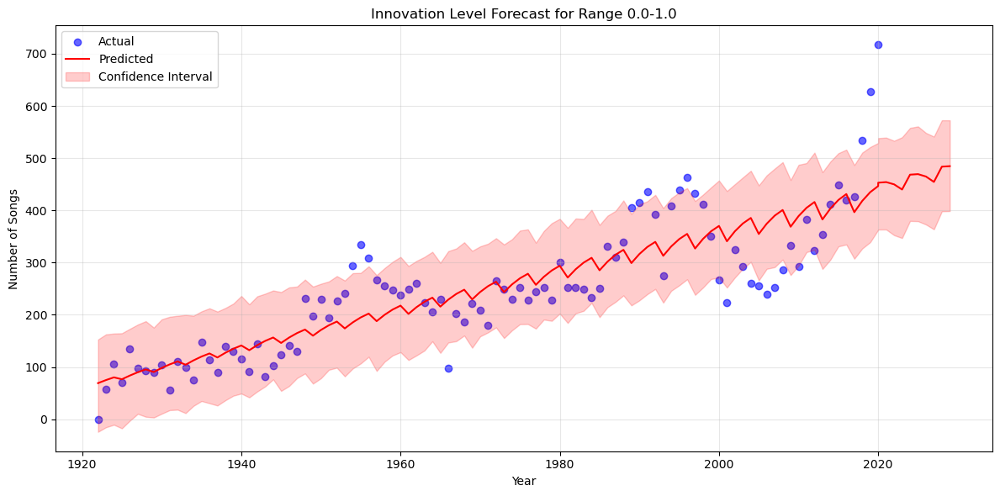

21:37:17 - cmdstanpy - INFO - Chain [1] start processing
21:37:18 - cmdstanpy - INFO - Chain [1] done processing


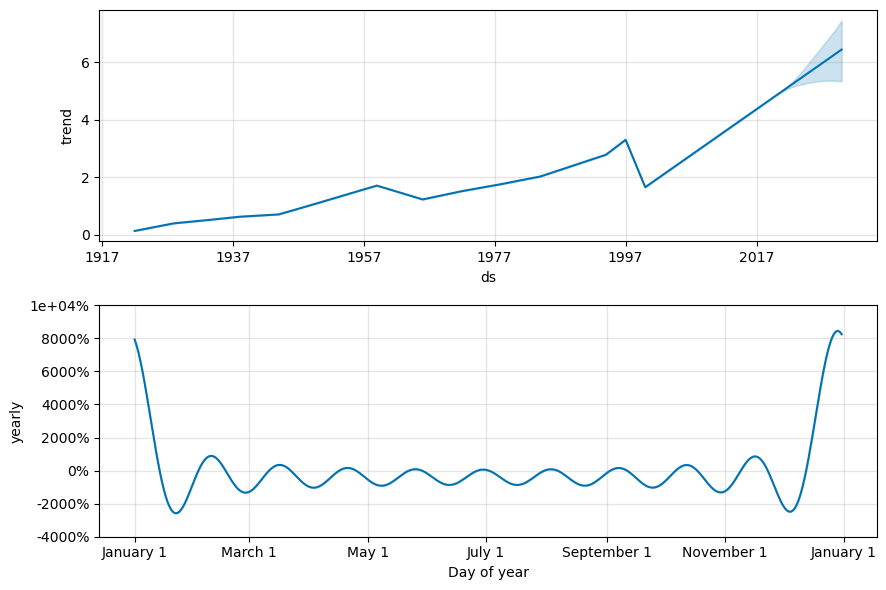

<Figure size 1500x1000 with 0 Axes>

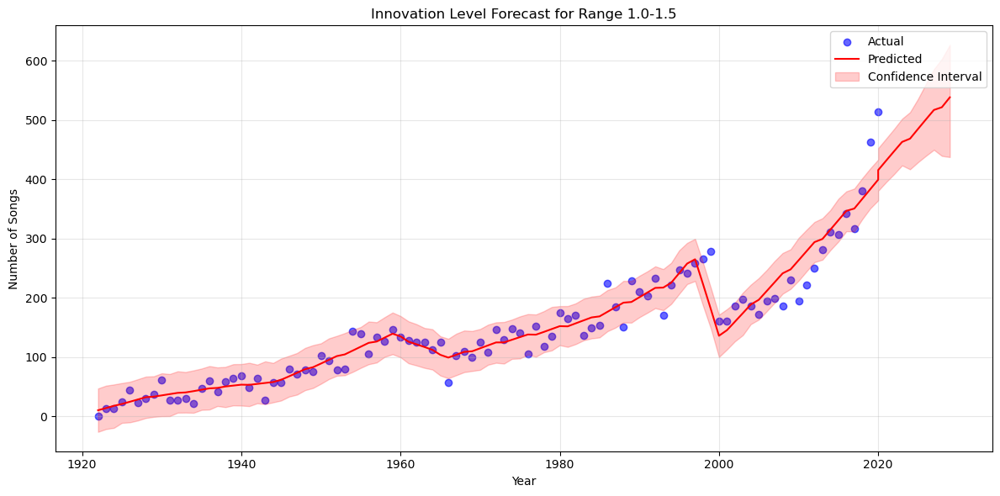

21:37:18 - cmdstanpy - INFO - Chain [1] start processing
21:37:19 - cmdstanpy - INFO - Chain [1] done processing


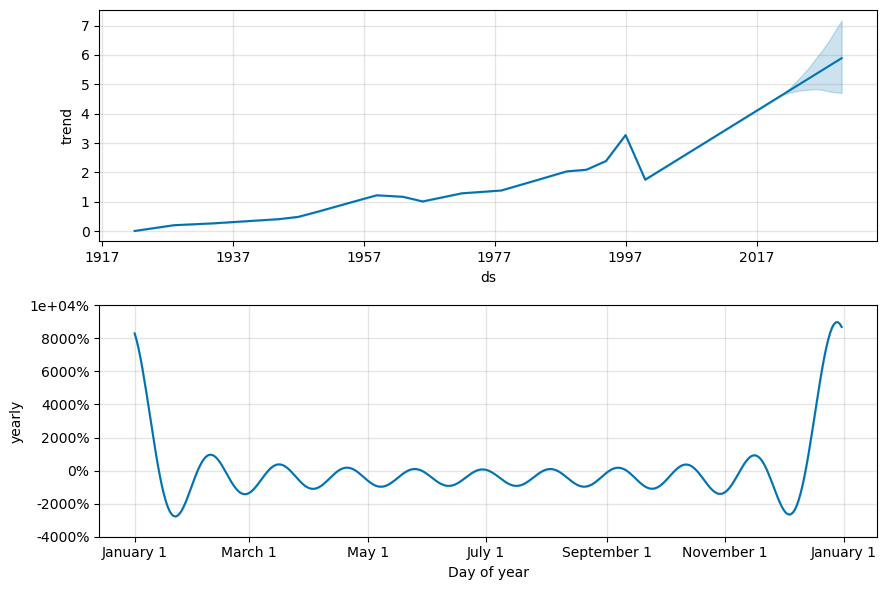

<Figure size 1500x1000 with 0 Axes>

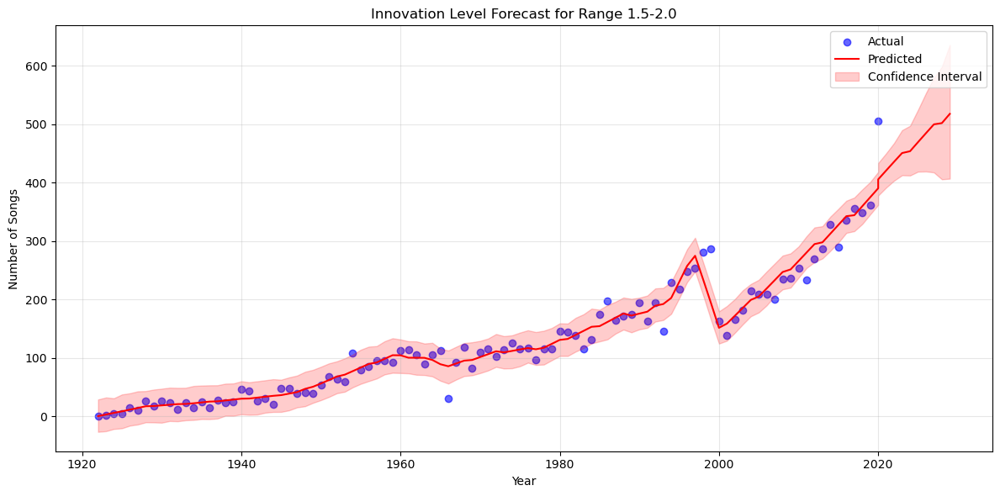

21:37:20 - cmdstanpy - INFO - Chain [1] start processing
21:37:21 - cmdstanpy - INFO - Chain [1] done processing


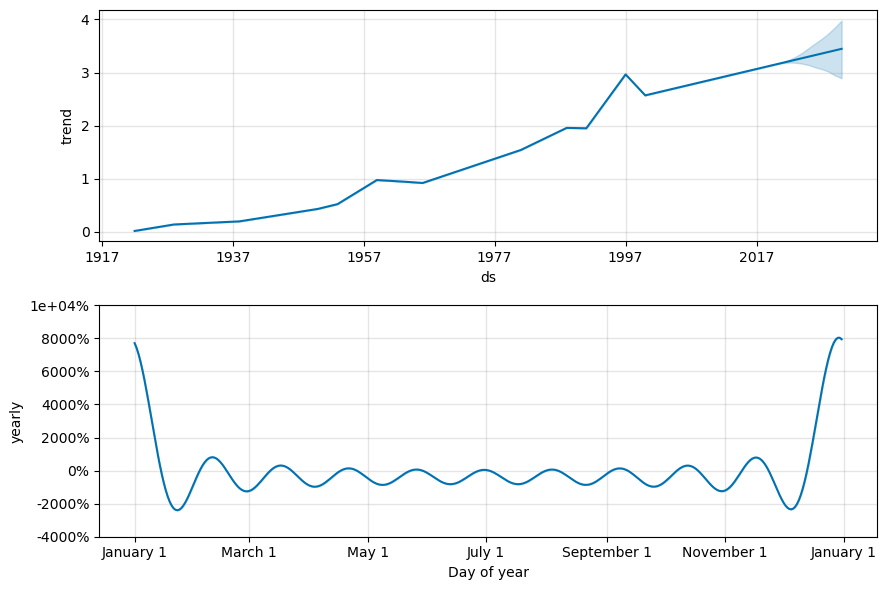

<Figure size 1500x1000 with 0 Axes>

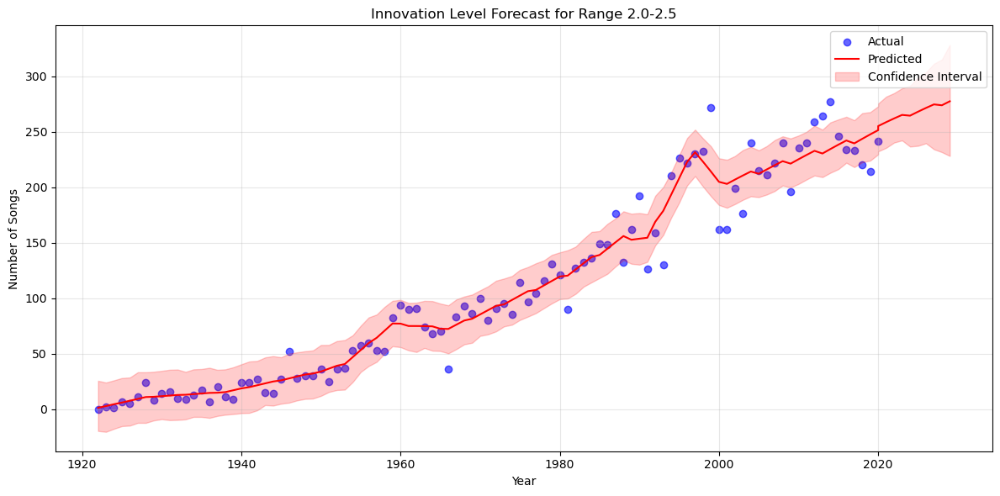

21:37:21 - cmdstanpy - INFO - Chain [1] start processing
21:37:22 - cmdstanpy - INFO - Chain [1] done processing


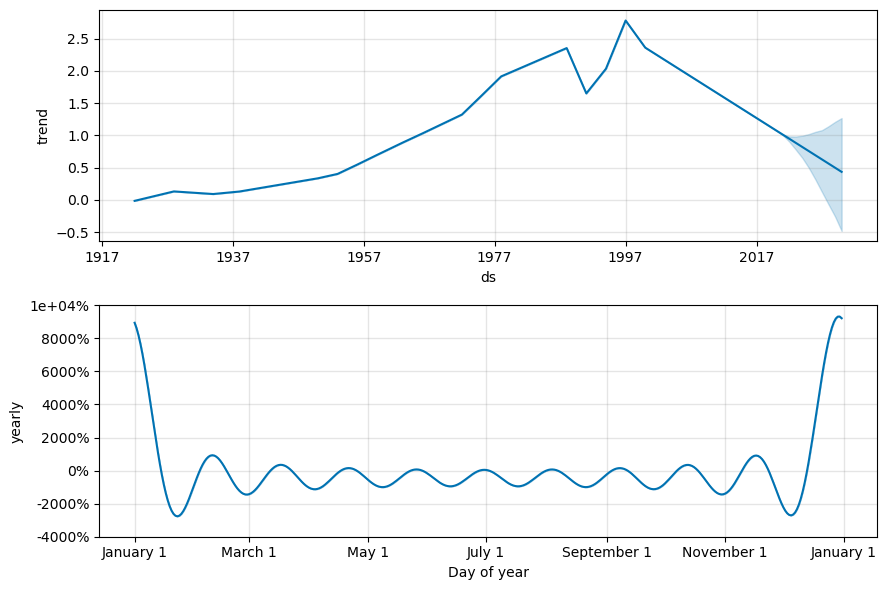

<Figure size 1500x1000 with 0 Axes>

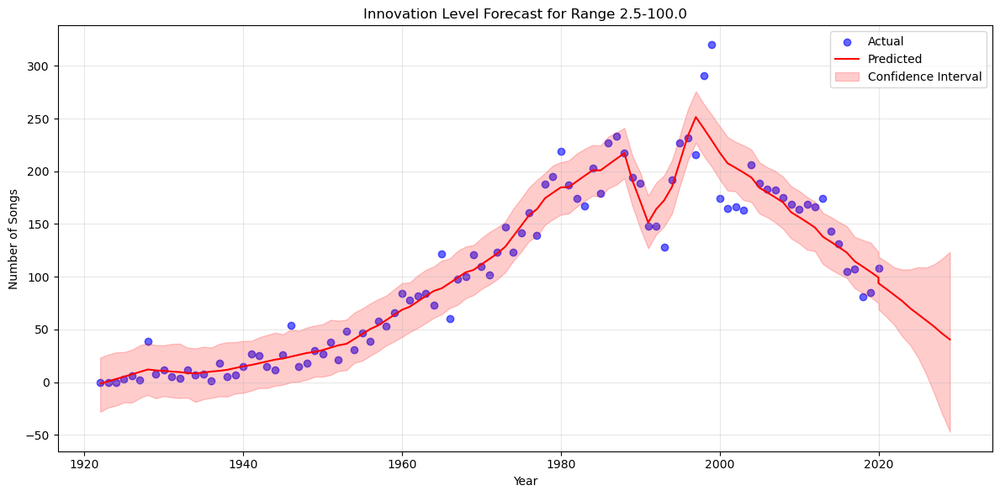

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.05,  # Adjust flexibility of the trend
            seasonality_prior_scale=10.0   # Increase weight of seasonality
        )
        
        # Add custom yearly seasonality
        model.add_seasonality(
            name='yearly',
            period=365.25,
            fourier_order=5  # Adjust complexity of the seasonality
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',  # Use yearly frequency
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast
        }
        
        # Plot components
        fig_comp = model.plot_components(forecast)
        plt.figure(figsize=(15, 10))
        plt.suptitle(f'Trend and Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        fig_forecast = plt.figure(figsize=(12, 6))
        ax = fig_forecast.add_subplot(111)
        
        # Plot actual values
        ax.scatter(df['ds'].dt.year, df['y'], 
                  color='blue', alpha=0.6, label='Actual')
        
        # Plot predicted values
        ax.plot(pd.to_datetime(forecast['ds']).dt.year, 
                forecast['yhat'], 'r-', label='Predicted')
        
        # Add confidence interval
        ax.fill_between(pd.to_datetime(forecast['ds']).dt.year,
                       forecast['yhat_lower'],
                       forecast['yhat_upper'],
                       color='red', alpha=0.2,
                       label='Confidence Interval')
        
        ax.set_xlabel('Year')
        ax.set_ylabel('Number of Songs')
        ax.set_title(f'Innovation Level Forecast for Range {range_name}')
        ax.legend()
        ax.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 1, 1.5, 2, 2.5, 100],
    forecast_years=10
)

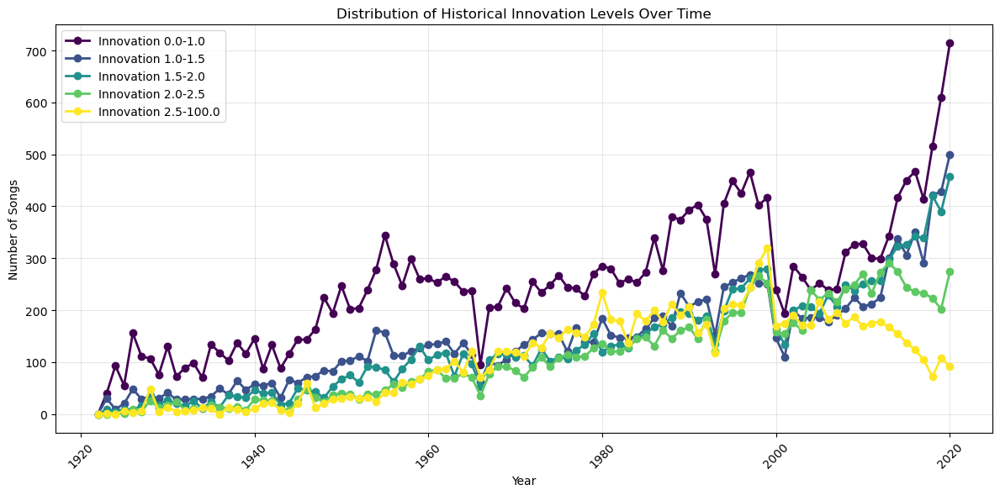

21:37:50 - cmdstanpy - INFO - Chain [1] start processing


             ds    y
Year                
1922 1922-01-01    0
1923 1923-01-01   40
1924 1924-01-01   93
1925 1925-01-01   55
1926 1926-01-01  156
...         ...  ...
2016 2016-01-01  467
2017 2017-01-01  413
2018 2018-01-01  515
2019 2019-01-01  610
2020 2020-01-01  714

[99 rows x 2 columns]


21:37:50 - cmdstanpy - INFO - Chain [1] done processing


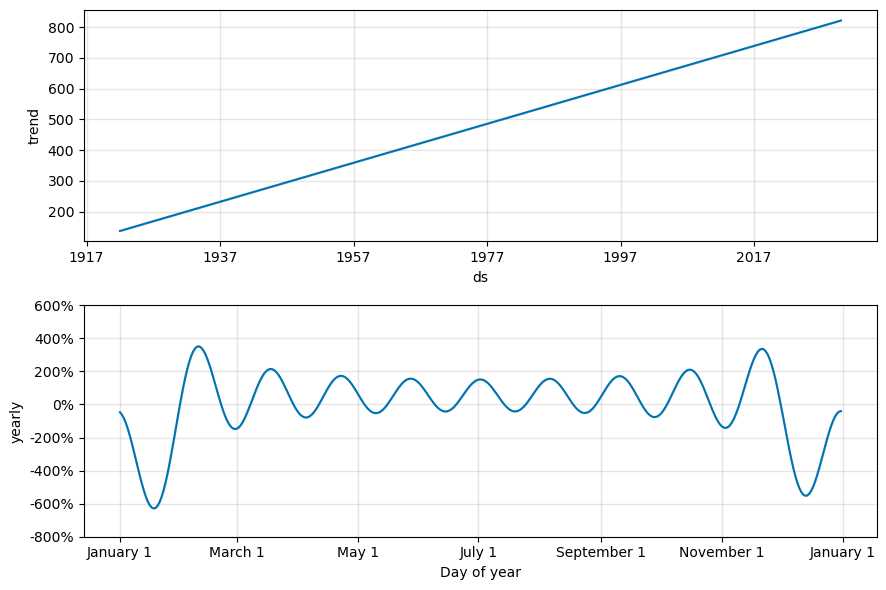

<Figure size 1500x1000 with 0 Axes>

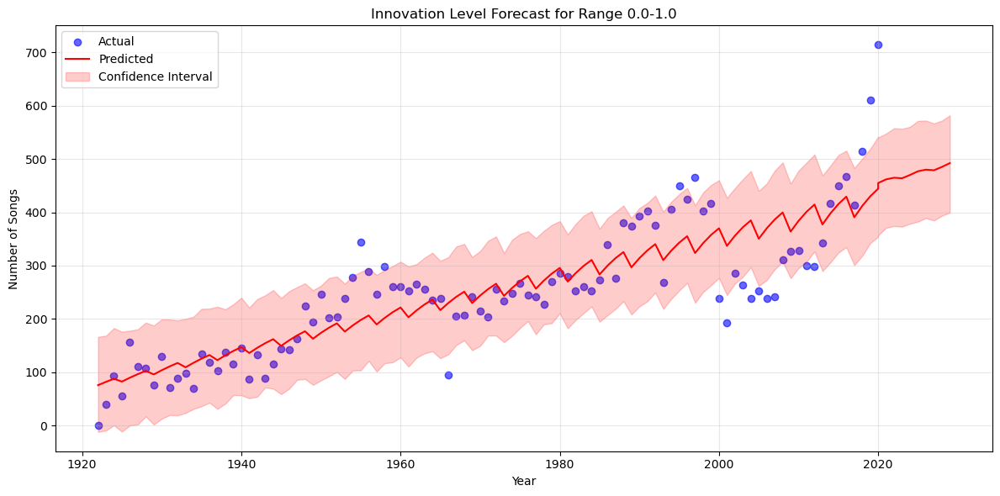

21:37:51 - cmdstanpy - INFO - Chain [1] start processing


             ds    y
Year                
1922 1922-01-01    0
1923 1923-01-01   30
1924 1924-01-01    9
1925 1925-01-01   20
1926 1926-01-01   48
...         ...  ...
2016 2016-01-01  350
2017 2017-01-01  290
2018 2018-01-01  422
2019 2019-01-01  428
2020 2020-01-01  500

[99 rows x 2 columns]


21:37:52 - cmdstanpy - INFO - Chain [1] done processing


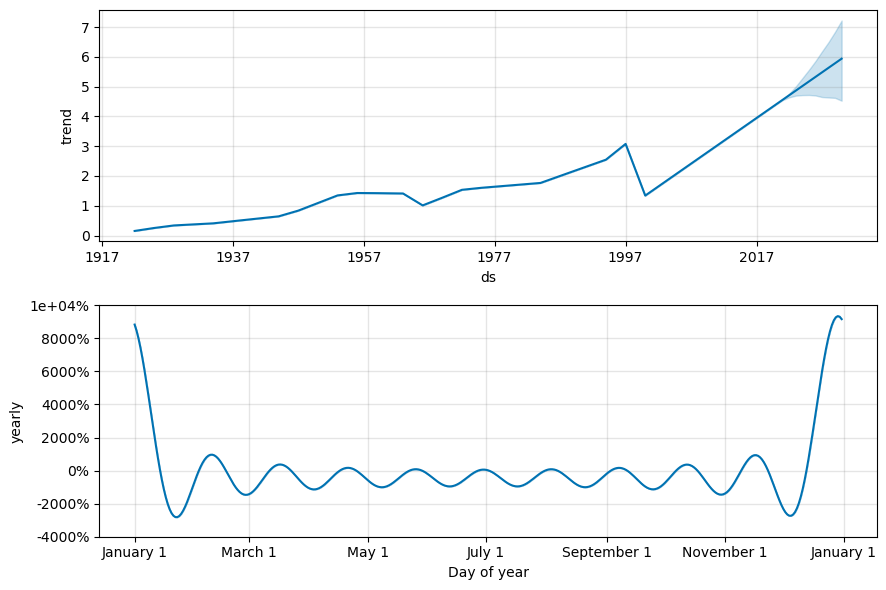

<Figure size 1500x1000 with 0 Axes>

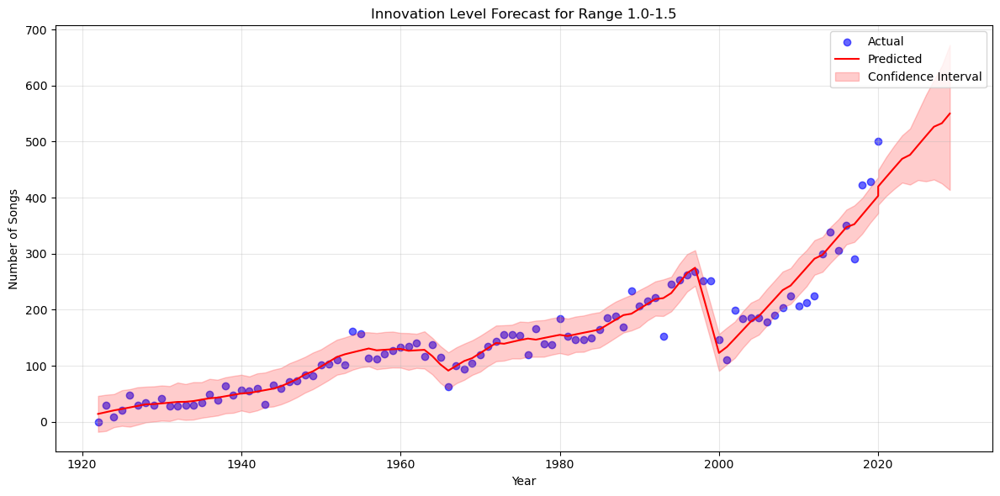

21:37:52 - cmdstanpy - INFO - Chain [1] start processing


             ds    y
Year                
1922 1922-01-01    0
1923 1923-01-01    9
1924 1924-01-01    5
1925 1925-01-01    9
1926 1926-01-01    8
...         ...  ...
2016 2016-01-01  342
2017 2017-01-01  339
2018 2018-01-01  420
2019 2019-01-01  390
2020 2020-01-01  458

[99 rows x 2 columns]


21:37:53 - cmdstanpy - INFO - Chain [1] done processing


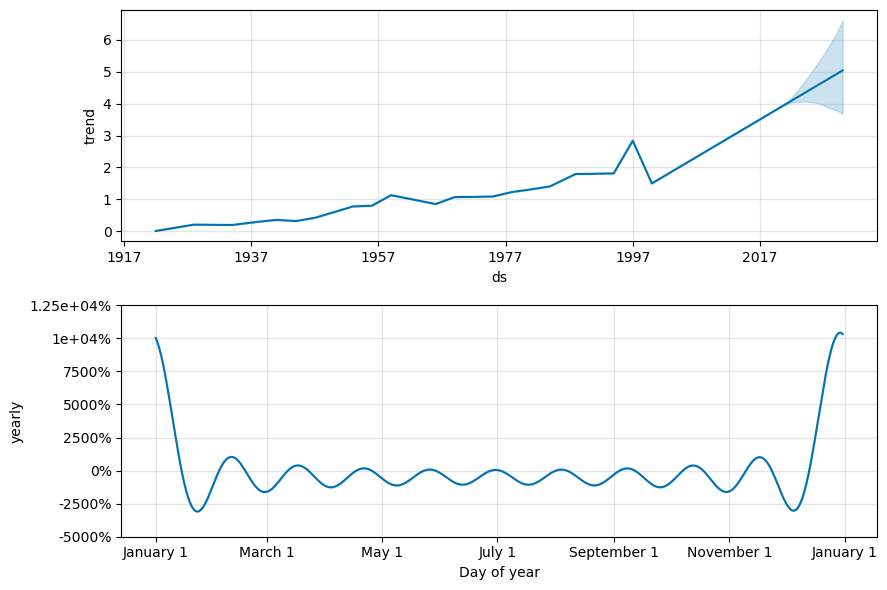

<Figure size 1500x1000 with 0 Axes>

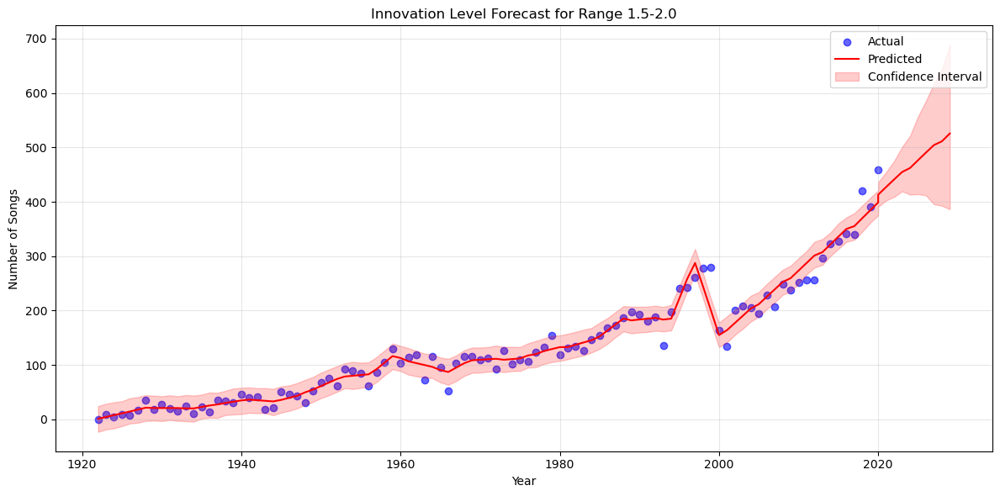

21:37:54 - cmdstanpy - INFO - Chain [1] start processing


             ds    y
Year                
1922 1922-01-01    0
1923 1923-01-01    0
1924 1924-01-01    1
1925 1925-01-01    1
1926 1926-01-01    9
...         ...  ...
2016 2016-01-01  235
2017 2017-01-01  233
2018 2018-01-01  223
2019 2019-01-01  202
2020 2020-01-01  274

[99 rows x 2 columns]


21:37:54 - cmdstanpy - INFO - Chain [1] done processing


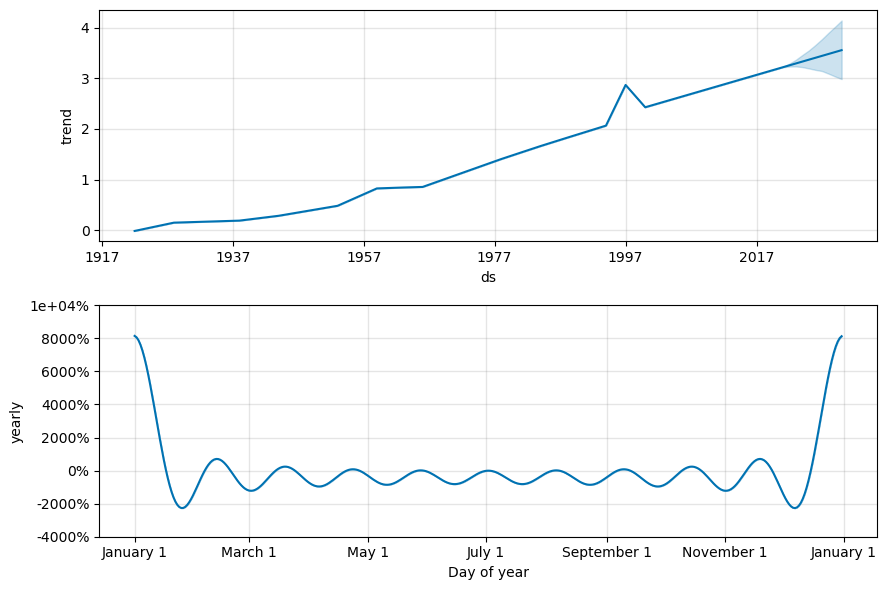

<Figure size 1500x1000 with 0 Axes>

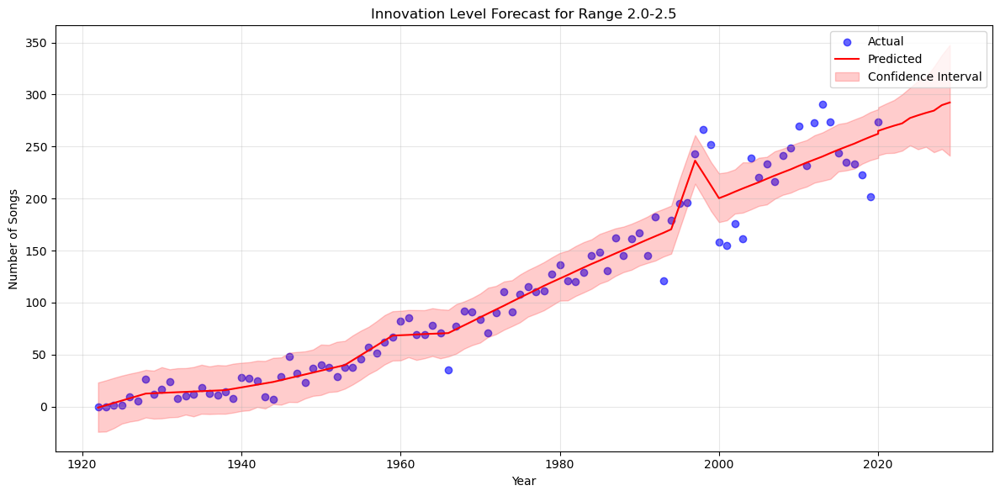

21:37:55 - cmdstanpy - INFO - Chain [1] start processing


             ds    y
Year                
1922 1922-01-01    0
1923 1923-01-01    1
1924 1924-01-01    0
1925 1925-01-01    6
1926 1926-01-01    2
...         ...  ...
2016 2016-01-01  124
2017 2017-01-01  104
2018 2018-01-01   72
2019 2019-01-01  108
2020 2020-01-01   92

[99 rows x 2 columns]


21:37:56 - cmdstanpy - INFO - Chain [1] done processing


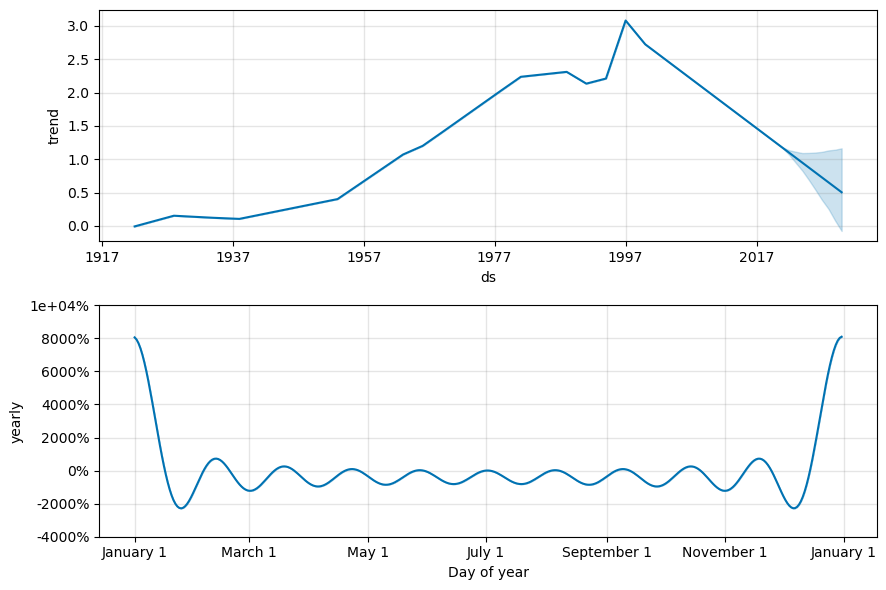

<Figure size 1500x1000 with 0 Axes>

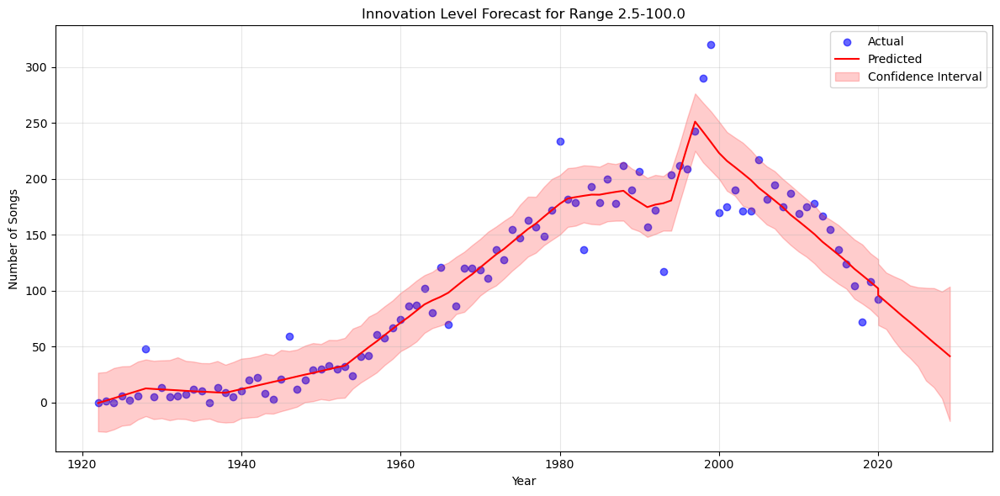

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        print(df)
        breakpoint()
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.05,  # Adjust flexibility of the trend
            seasonality_prior_scale=10.0   # Increase weight of seasonality
        )
        
        # Add custom yearly seasonality
        model.add_seasonality(
            name='yearly',
            period=365.25,
            fourier_order=5  # Adjust complexity of the seasonality
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',  # Use yearly frequency
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast
        }
        
        # Plot components
        fig_comp = model.plot_components(forecast)
        plt.figure(figsize=(15, 10))
        plt.suptitle(f'Trend and Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        fig_forecast = plt.figure(figsize=(12, 6))
        ax = fig_forecast.add_subplot(111)
        
        # Plot actual values
        ax.scatter(df['ds'].dt.year, df['y'], 
                  color='blue', alpha=0.6, label='Actual')
        
        # Plot predicted values
        ax.plot(pd.to_datetime(forecast['ds']).dt.year, 
                forecast['yhat'], 'r-', label='Predicted')
        
        # Add confidence interval
        ax.fill_between(pd.to_datetime(forecast['ds']).dt.year,
                       forecast['yhat_lower'],
                       forecast['yhat_upper'],
                       color='red', alpha=0.2,
                       label='Confidence Interval')
        
        ax.set_xlabel('Year')
        ax.set_ylabel('Number of Songs')
        ax.set_title(f'Innovation Level Forecast for Range {range_name}')
        ax.legend()
        ax.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 1, 1.5, 2, 2.5, 100],
    forecast_years=10
)

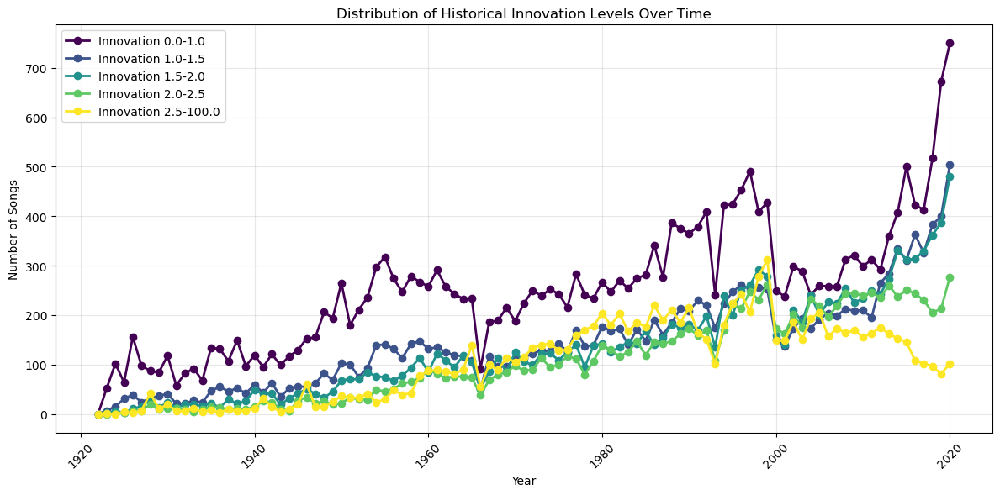

21:47:03 - cmdstanpy - INFO - Chain [1] start processing


             ds    y
Year                
1922 1922-01-01    0
1923 1923-01-01   52
1924 1924-01-01  102
1925 1925-01-01   64
1926 1926-01-01  156
...         ...  ...
2016 2016-01-01  423
2017 2017-01-01  413
2018 2018-01-01  517
2019 2019-01-01  672
2020 2020-01-01  750

[99 rows x 2 columns]


21:47:03 - cmdstanpy - INFO - Chain [1] done processing


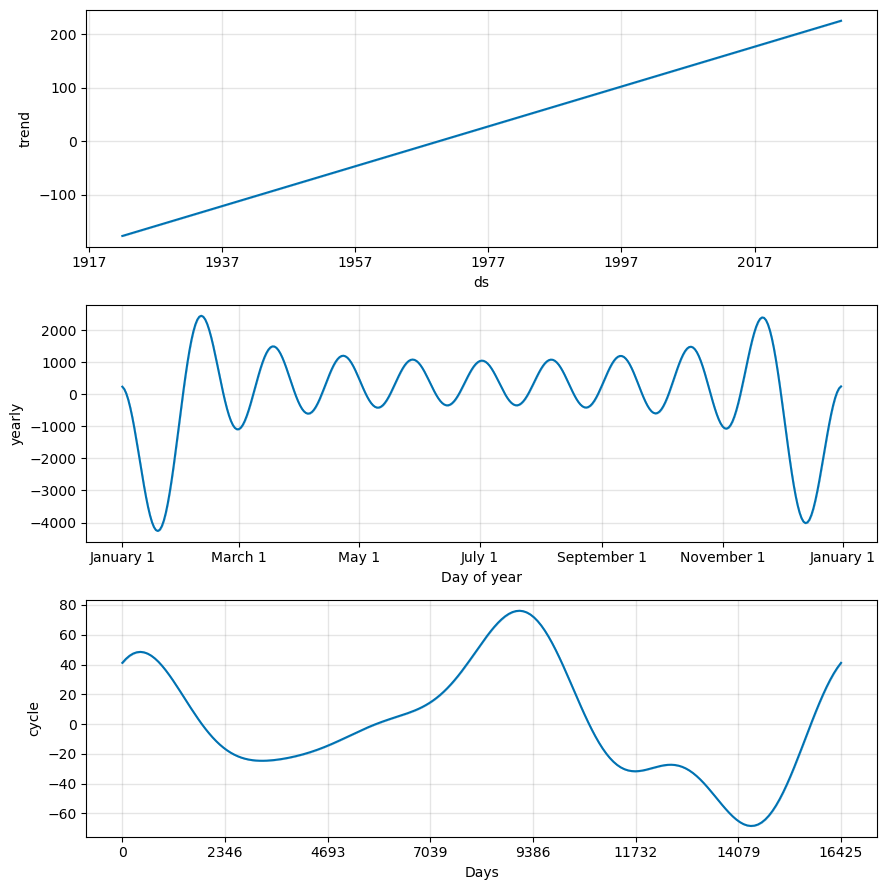

<Figure size 1500x1000 with 0 Axes>

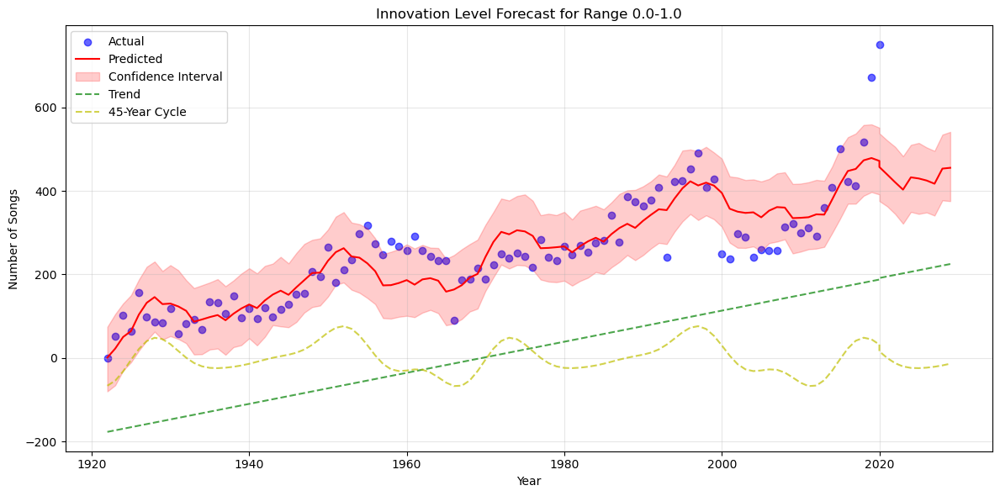

21:47:04 - cmdstanpy - INFO - Chain [1] start processing


             ds    y
Year                
1922 1922-01-01    0
1923 1923-01-01    7
1924 1924-01-01   15
1925 1925-01-01   31
1926 1926-01-01   39
...         ...  ...
2016 2016-01-01  363
2017 2017-01-01  326
2018 2018-01-01  383
2019 2019-01-01  400
2020 2020-01-01  504

[99 rows x 2 columns]


21:47:04 - cmdstanpy - INFO - Chain [1] done processing


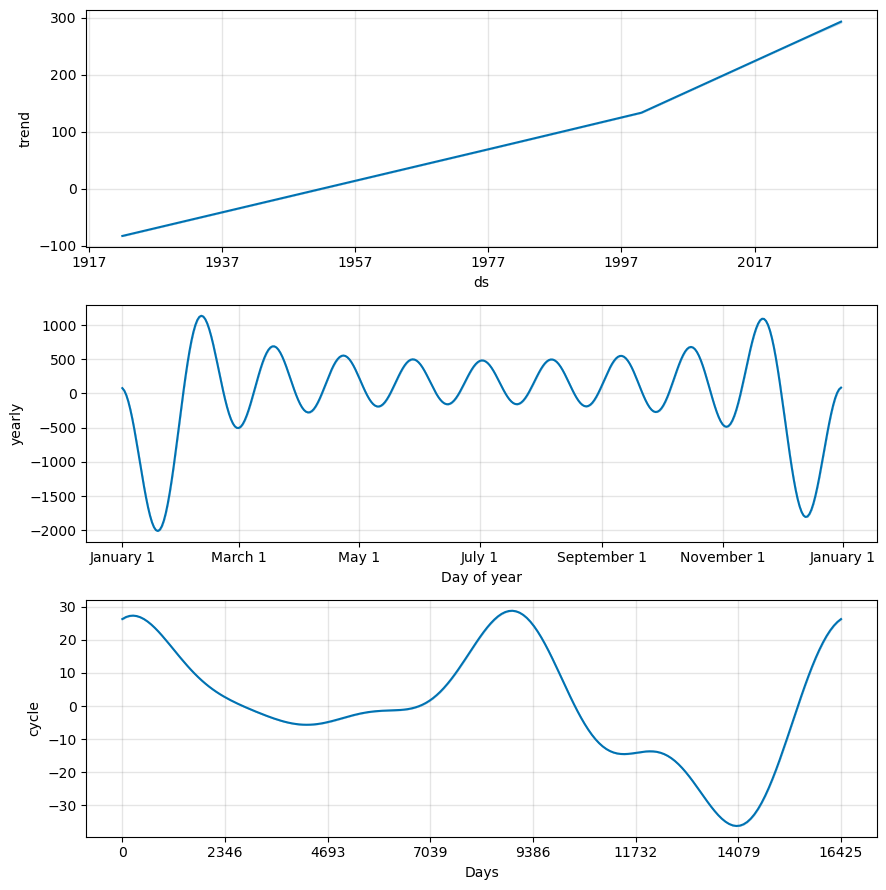

<Figure size 1500x1000 with 0 Axes>

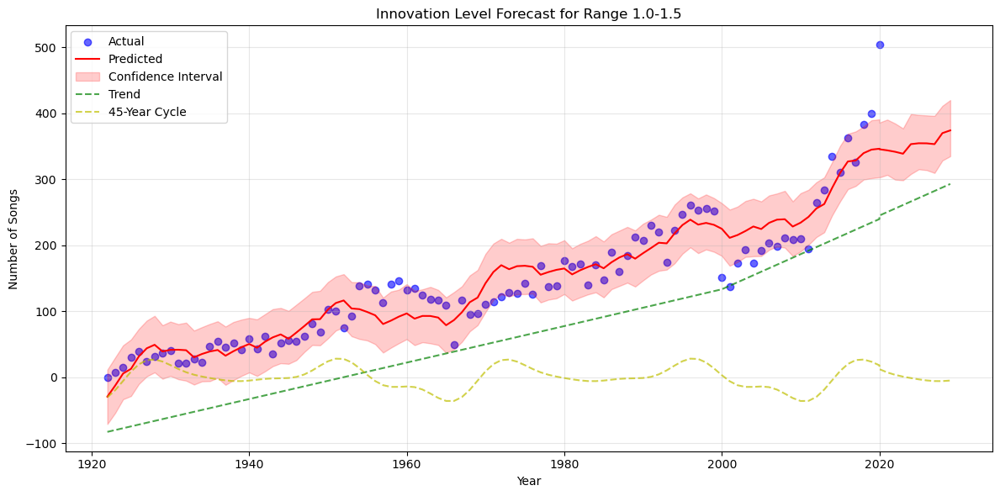

21:47:05 - cmdstanpy - INFO - Chain [1] start processing


             ds    y
Year                
1922 1922-01-01    0
1923 1923-01-01    2
1924 1924-01-01    6
1925 1925-01-01    2
1926 1926-01-01   11
...         ...  ...
2016 2016-01-01  314
2017 2017-01-01  330
2018 2018-01-01  362
2019 2019-01-01  387
2020 2020-01-01  481

[99 rows x 2 columns]


21:47:06 - cmdstanpy - INFO - Chain [1] done processing


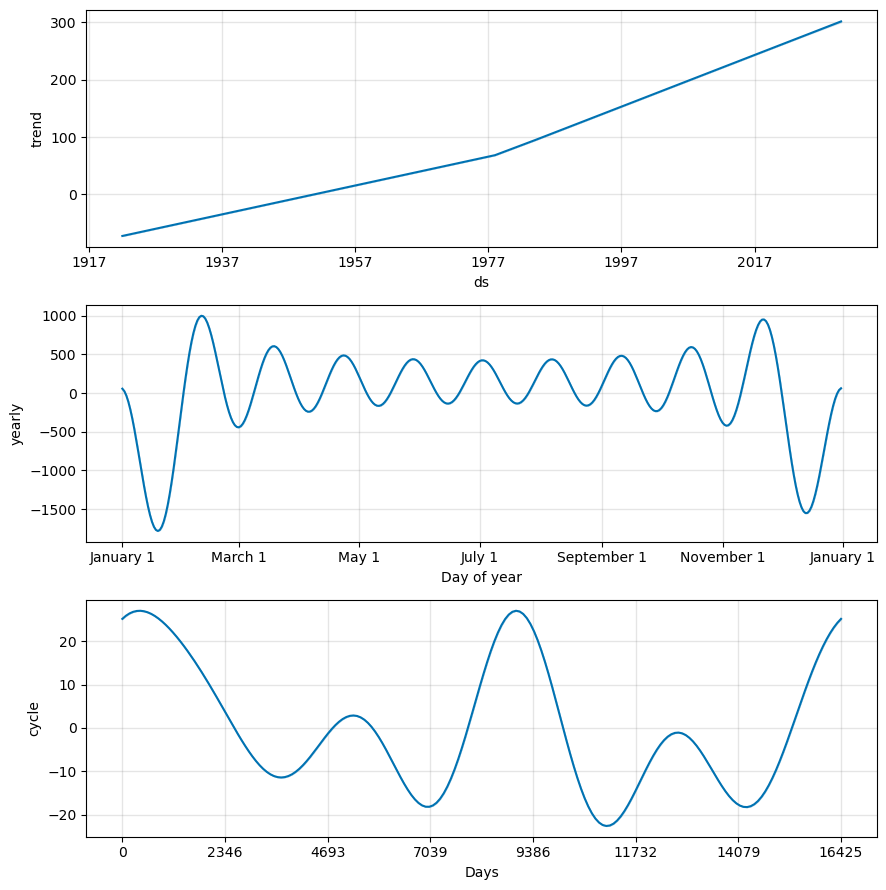

<Figure size 1500x1000 with 0 Axes>

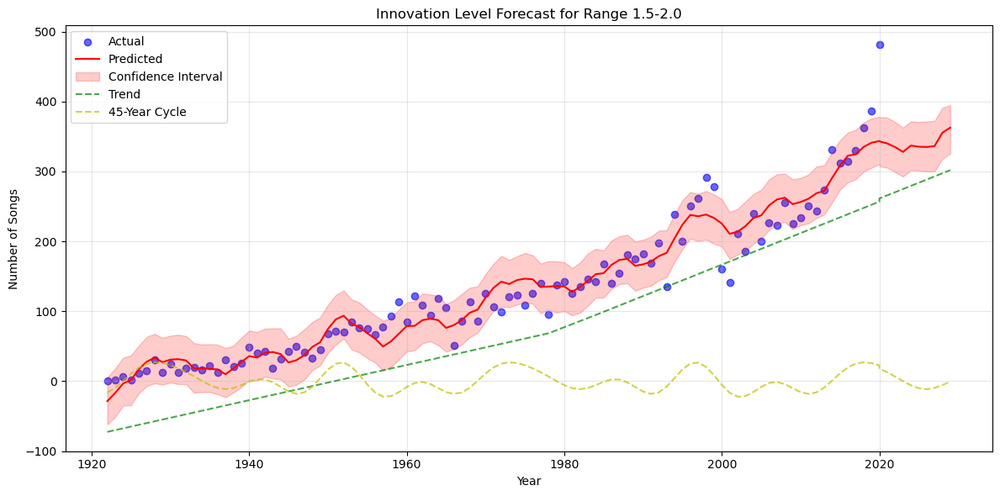

21:47:07 - cmdstanpy - INFO - Chain [1] start processing


             ds    y
Year                
1922 1922-01-01    0
1923 1923-01-01    0
1924 1924-01-01    1
1925 1925-01-01    2
1926 1926-01-01    7
...         ...  ...
2016 2016-01-01  244
2017 2017-01-01  230
2018 2018-01-01  205
2019 2019-01-01  213
2020 2020-01-01  277

[99 rows x 2 columns]


21:47:07 - cmdstanpy - INFO - Chain [1] done processing


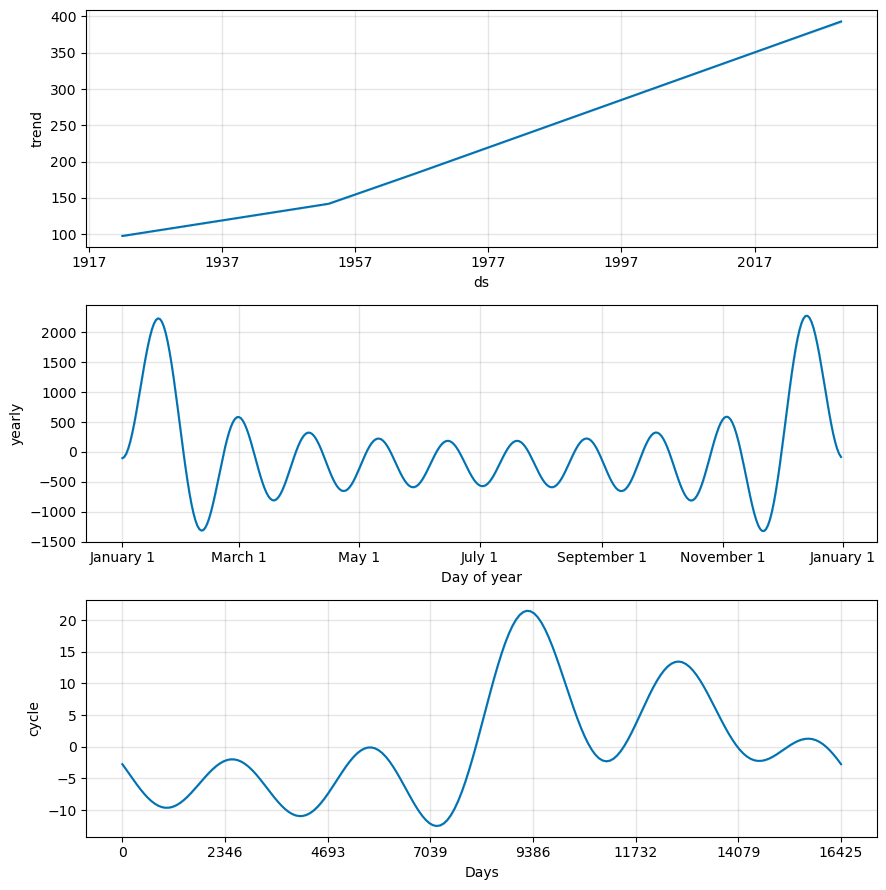

<Figure size 1500x1000 with 0 Axes>

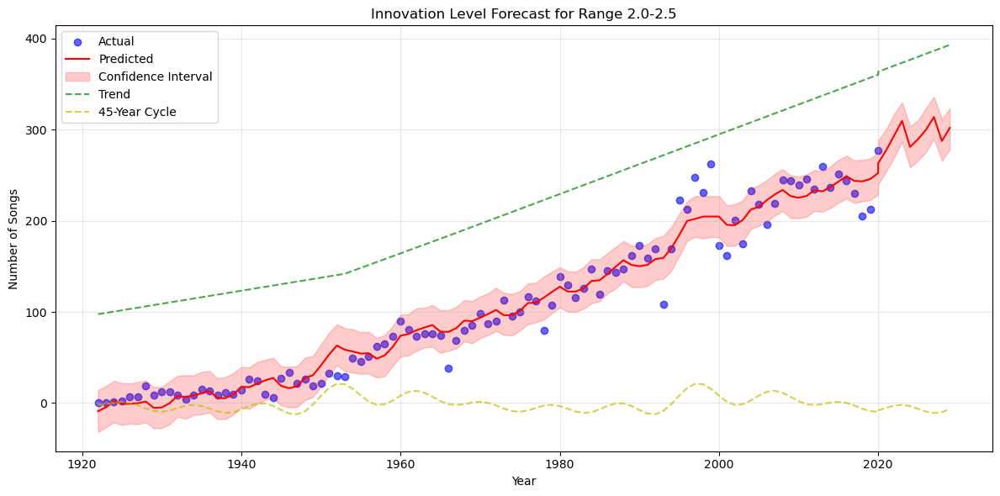

21:47:08 - cmdstanpy - INFO - Chain [1] start processing


             ds    y
Year                
1922 1922-01-01    0
1923 1923-01-01    1
1924 1924-01-01    0
1925 1925-01-01    4
1926 1926-01-01    2
...         ...  ...
2016 2016-01-01  108
2017 2017-01-01  102
2018 2018-01-01   97
2019 2019-01-01   81
2020 2020-01-01  102

[99 rows x 2 columns]


21:47:08 - cmdstanpy - INFO - Chain [1] done processing


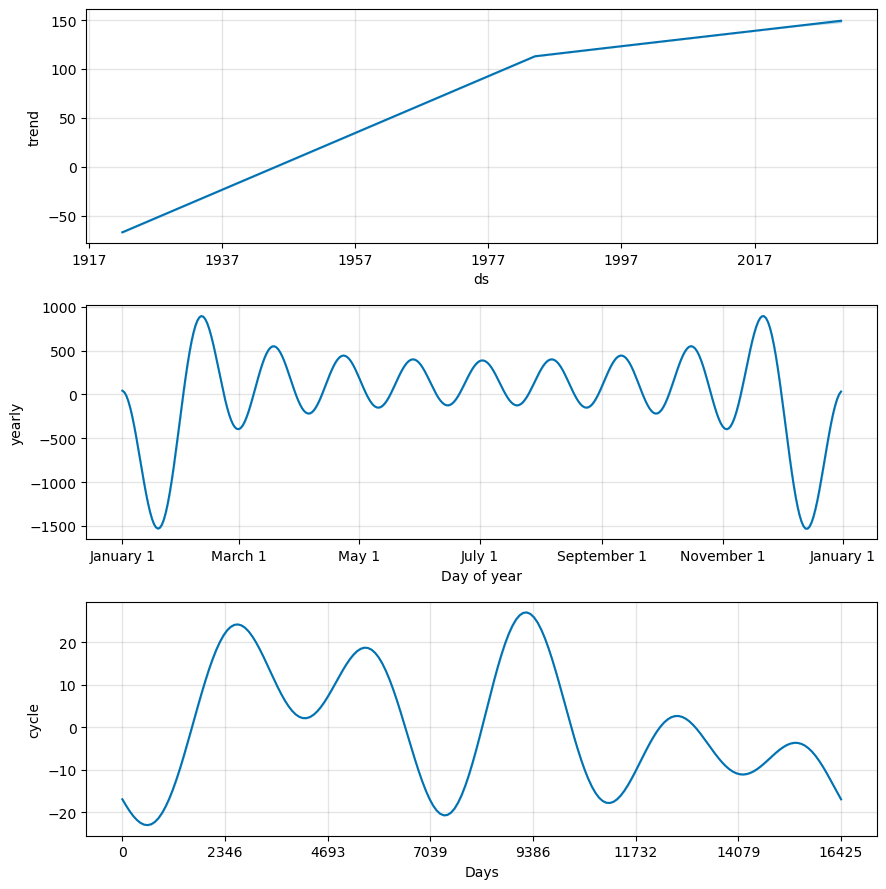

<Figure size 1500x1000 with 0 Axes>

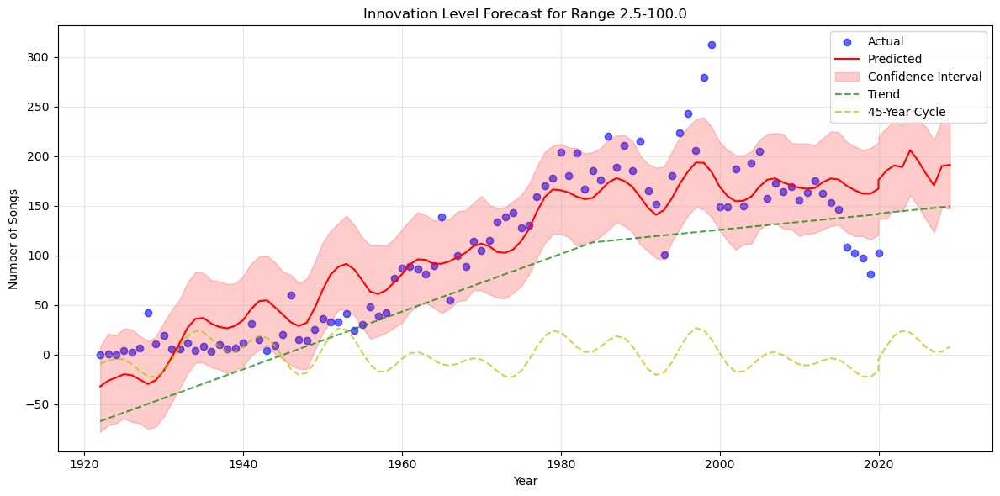

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        print(df)
        breakpoint()
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='additive',
            changepoint_prior_scale=0.05,  # Adjust flexibility of the trend
            seasonality_prior_scale=10.0   # Increase weight of seasonality
        )
        
        # Add custom yearly seasonality
        model.add_seasonality(
            name='cycle',
            period=45*365,
            fourier_order=5  # Adjust complexity of the seasonality
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',  # Use yearly frequency
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast
        }
        
        # Plot components
        fig_comp = model.plot_components(forecast)
        plt.figure(figsize=(15, 10))
        plt.suptitle(f'Trend and Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        fig_forecast = plt.figure(figsize=(12, 6))
        ax = fig_forecast.add_subplot(111)
        
        # Plot actual values
        ax.scatter(df['ds'].dt.year, df['y'], 
                  color='blue', alpha=0.6, label='Actual')
        
        # Plot predicted values
        ax.plot(pd.to_datetime(forecast['ds']).dt.year, 
                forecast['yhat'], 'r-', label='Predicted')
        
        # Add confidence interval
        ax.fill_between(pd.to_datetime(forecast['ds']).dt.year,
                       forecast['yhat_lower'],
                       forecast['yhat_upper'],
                       color='red', alpha=0.2,
                       label='Confidence Interval')
        
        # Add trend and seasonality components
        ax.plot(pd.to_datetime(forecast['ds']).dt.year,
               forecast['trend'], 'g--', alpha=0.7, label='Trend')
        ax.plot(pd.to_datetime(forecast['ds']).dt.year,
               forecast['cycle'], 'y--', alpha=0.7, label='45-Year Cycle')
        
        ax.set_xlabel('Year')
        ax.set_ylabel('Number of Songs')
        ax.set_title(f'Innovation Level Forecast for Range {range_name}')
        ax.legend()
        ax.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 1, 1.5, 2, 2.5, 100],
    forecast_years=10
)

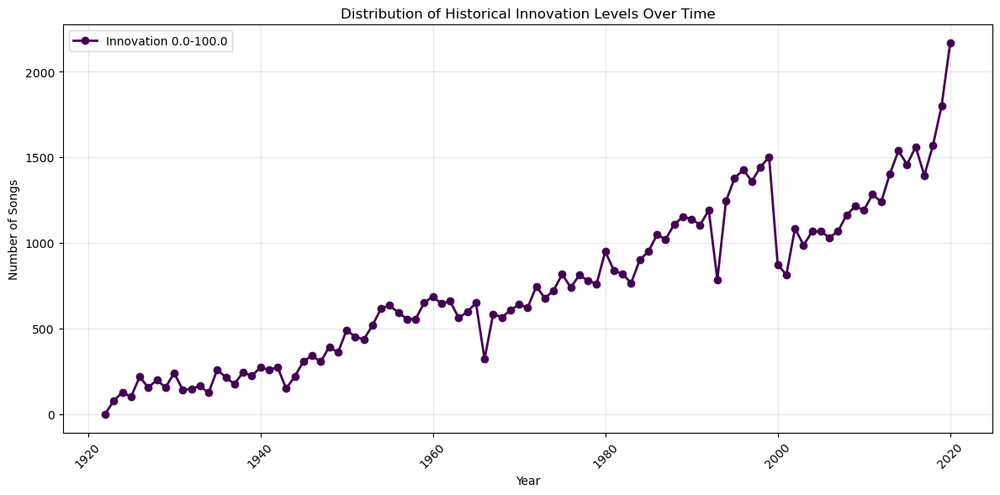

21:49:21 - cmdstanpy - INFO - Chain [1] start processing
21:49:23 - cmdstanpy - INFO - Chain [1] done processing


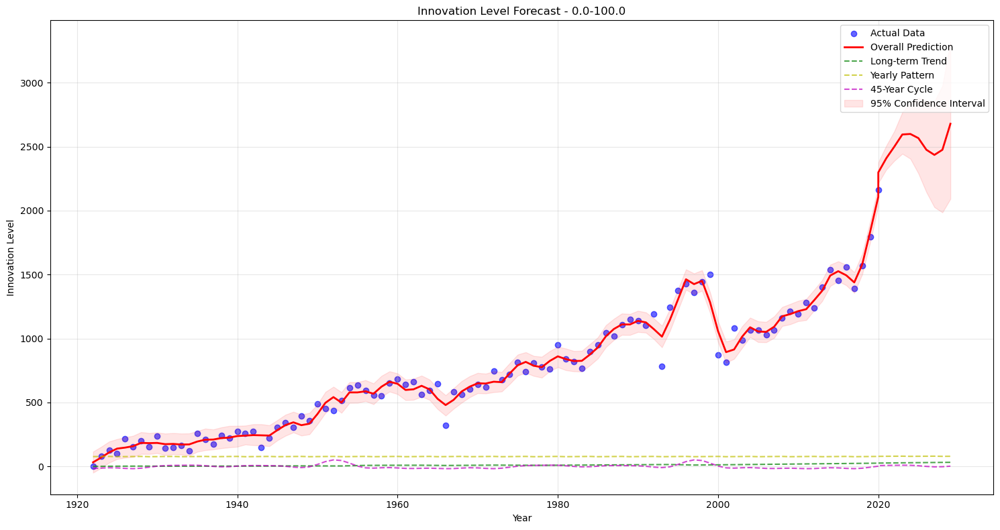

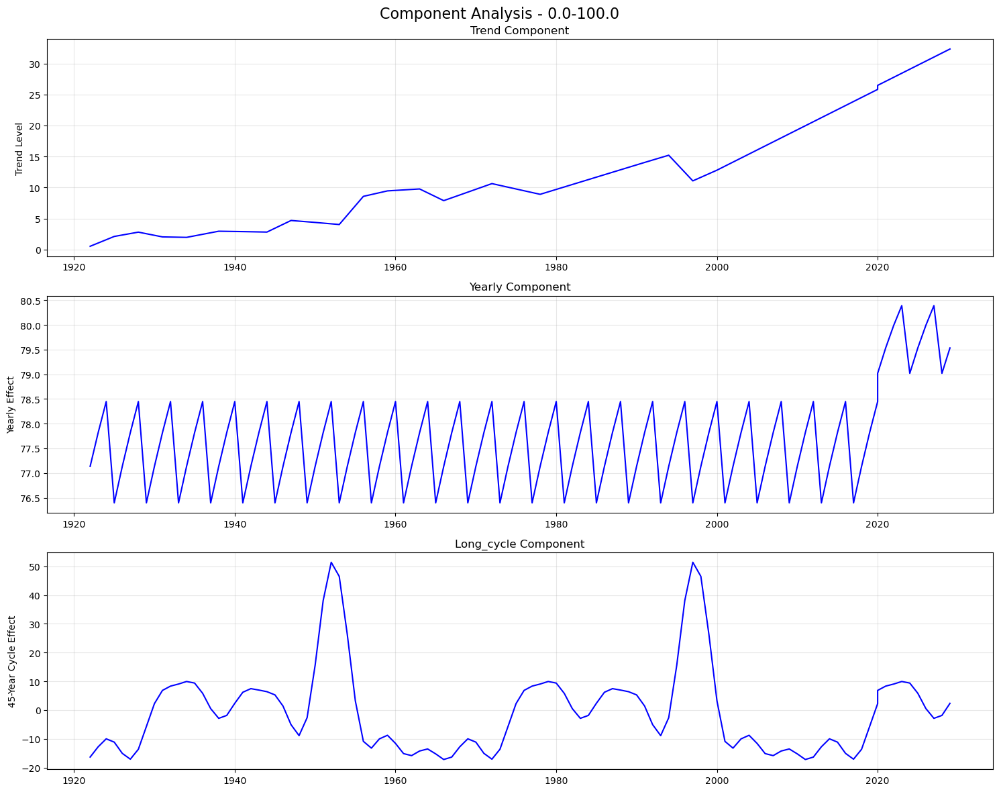

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0    # Emphasize seasonal patterns
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=45*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        
        # Plot 1: Forecast with all components
        plt.figure(figsize=(15, 8))
        
        # Plot actual values
        plt.scatter(df['ds'].dt.year, df['y'], 
                   color='blue', alpha=0.6, label='Actual Data')
        
        # Plot predictions and components
        years = pd.to_datetime(forecast['ds']).dt.year
        plt.plot(years, forecast['yhat'], 'r-', linewidth=2, label='Overall Prediction')
        plt.plot(years, forecast['trend'], 'g--', alpha=0.7, label='Long-term Trend')
        plt.plot(years, forecast['yearly'], 'y--', alpha=0.7, label='Yearly Pattern')
        plt.plot(years, forecast['long_cycle'], 'm--', alpha=0.7, label='45-Year Cycle')
        
        # Add confidence interval
        plt.fill_between(years,
                        forecast['yhat_lower'],
                        forecast['yhat_upper'],
                        color='red', alpha=0.1,
                        label='95% Confidence Interval')
        
        plt.title(f'Innovation Level Forecast - {range_name}')
        plt.xlabel('Year')
        plt.ylabel('Innovation Level')
        plt.legend()
        plt.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.show()
        
        # Plot 2: Component patterns
        components = ['trend', 'yearly', 'long_cycle']
        fig, axes = plt.subplots(len(components), 1, figsize=(15, 12))
        fig.suptitle(f'Component Analysis - {range_name}', fontsize=16)
        
        for ax, comp in zip(axes, components):
            ax.plot(years, forecast[comp], 'b-')
            ax.set_title(f'{comp.capitalize()} Component')
            ax.grid(True, alpha=0.3)
            if comp == 'trend':
                ax.set_ylabel('Trend Level')
            elif comp == 'yearly':
                ax.set_ylabel('Yearly Effect')
            else:
                ax.set_ylabel('45-Year Cycle Effect')
        
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 100],
    forecast_years=10
)

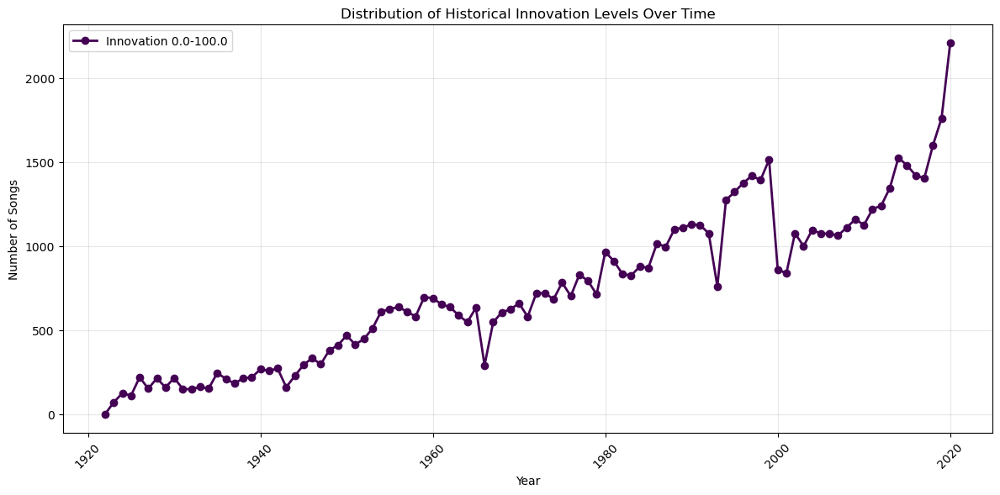

21:52:01 - cmdstanpy - INFO - Chain [1] start processing
21:52:03 - cmdstanpy - INFO - Chain [1] done processing


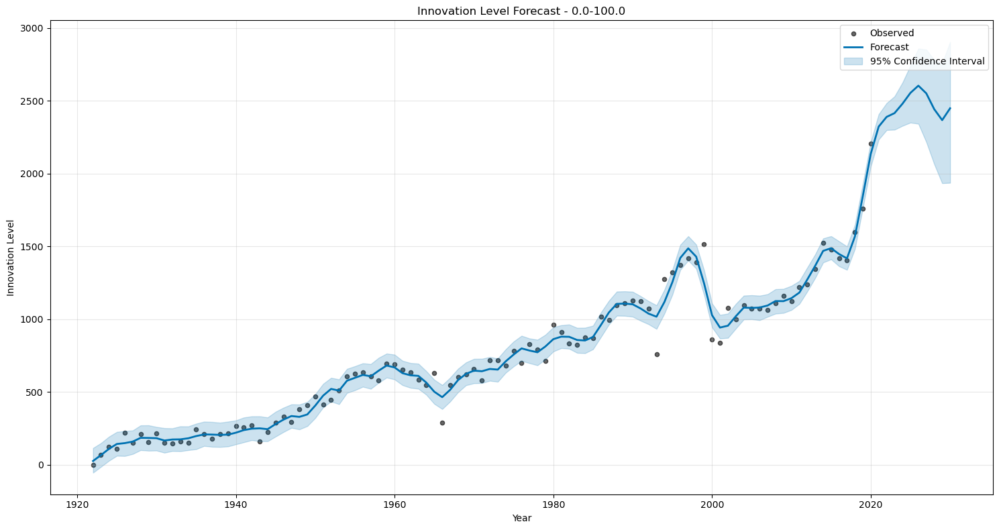

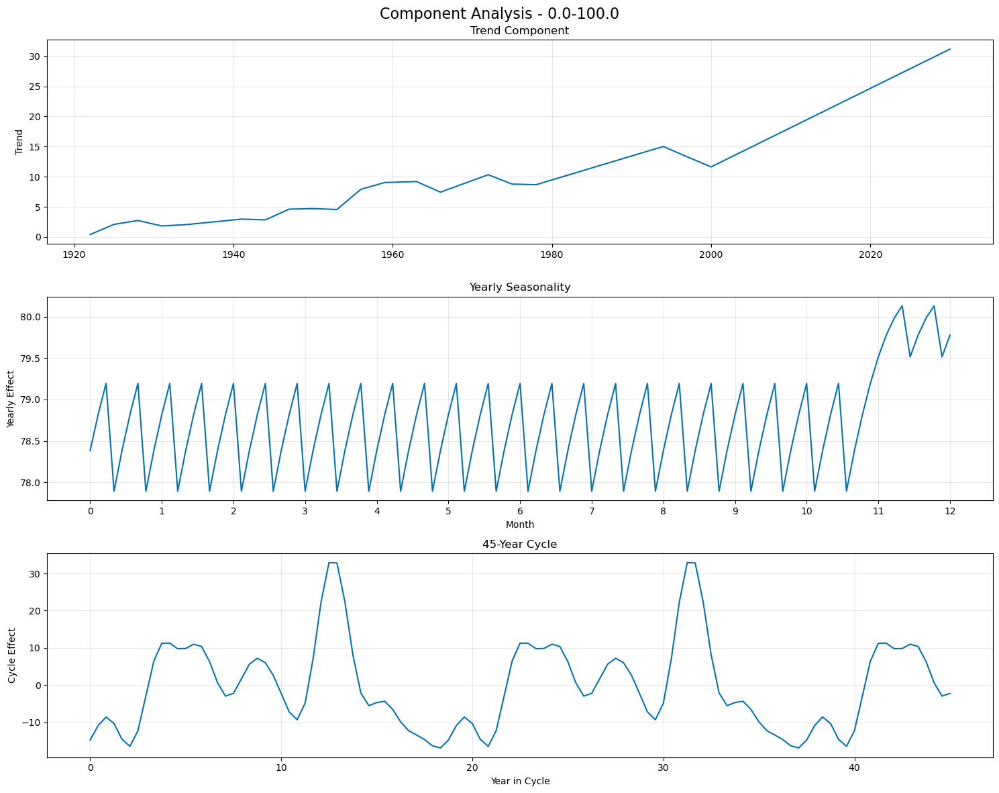

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0    # Emphasize seasonal patterns
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=45*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        
        # Plot 1: Forecast with confidence interval
        plt.figure(figsize=(15, 8))
        
        # Plot actual values and forecast
        plt.scatter(df['ds'], df['y'], 
                   color='black', alpha=0.6, s=20, label='Observed')
        plt.plot(forecast['ds'], forecast['yhat'], 
                color='#0072B2', linewidth=2, label='Forecast')
        plt.fill_between(forecast['ds'],
                        forecast['yhat_lower'],
                        forecast['yhat_upper'],
                        color='#0072B2', alpha=0.2,
                        label='95% Confidence Interval')
        
        plt.title(f'Innovation Level Forecast - {range_name}')
        plt.xlabel('Year')
        plt.ylabel('Innovation Level')
        plt.legend()
        plt.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.show()
        
        # Plot 2: Component patterns
        components = ['trend', 'yearly', 'long_cycle']
        fig, axes = plt.subplots(len(components), 1, figsize=(15, 12))
        fig.suptitle(f'Component Analysis - {range_name}', fontsize=16)
        
        # Plot trend
        axes[0].plot(forecast['ds'], forecast['trend'], color='#0072B2')
        axes[0].set_title('Trend Component')
        axes[0].grid(True, alpha=0.3)
        axes[0].set_ylabel('Trend')
        
        # Plot yearly seasonality (one cycle)
        yearly_seasonality = model.predict_seasonal_components(future)['yearly']
        one_year = yearly_seasonality[:365]  # Get one year of data
        days = np.linspace(0, 12, len(one_year))
        axes[1].plot(days, one_year, color='#0072B2')
        axes[1].set_title('Yearly Seasonality')
        axes[1].grid(True, alpha=0.3)
        axes[1].set_ylabel('Yearly Effect')
        axes[1].set_xlabel('Month')
        axes[1].set_xticks(np.arange(0, 13, 1))
        
        # Plot long cycle (one cycle)
        long_cycle = model.predict_seasonal_components(future)['long_cycle']
        one_cycle = long_cycle[:int(45*365.25)]  # Get one 45-year cycle
        years = np.linspace(0, 45, len(one_cycle))
        axes[2].plot(years, one_cycle, color='#0072B2')
        axes[2].set_title('45-Year Cycle')
        axes[2].grid(True, alpha=0.3)
        axes[2].set_ylabel('Cycle Effect')
        axes[2].set_xlabel('Year in Cycle')
        
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 100],
    forecast_years=10
)

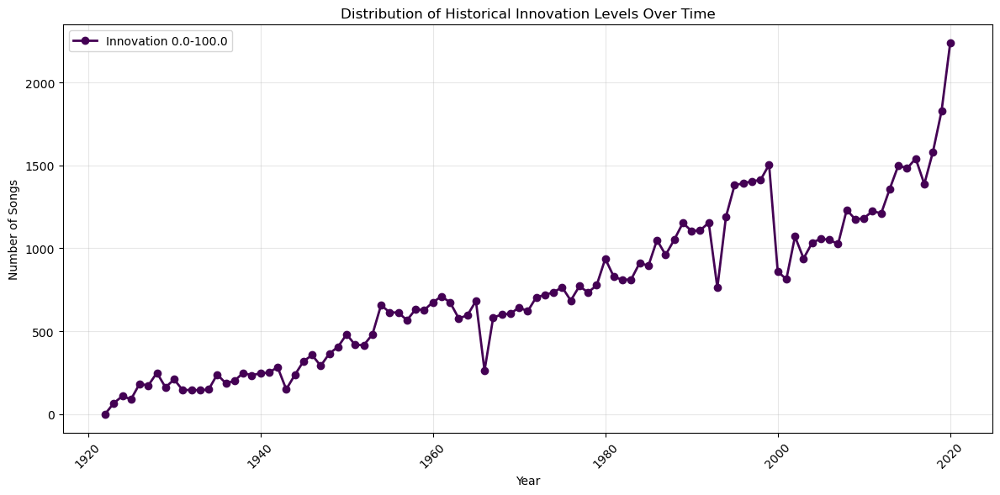

21:54:46 - cmdstanpy - INFO - Chain [1] start processing
21:54:48 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

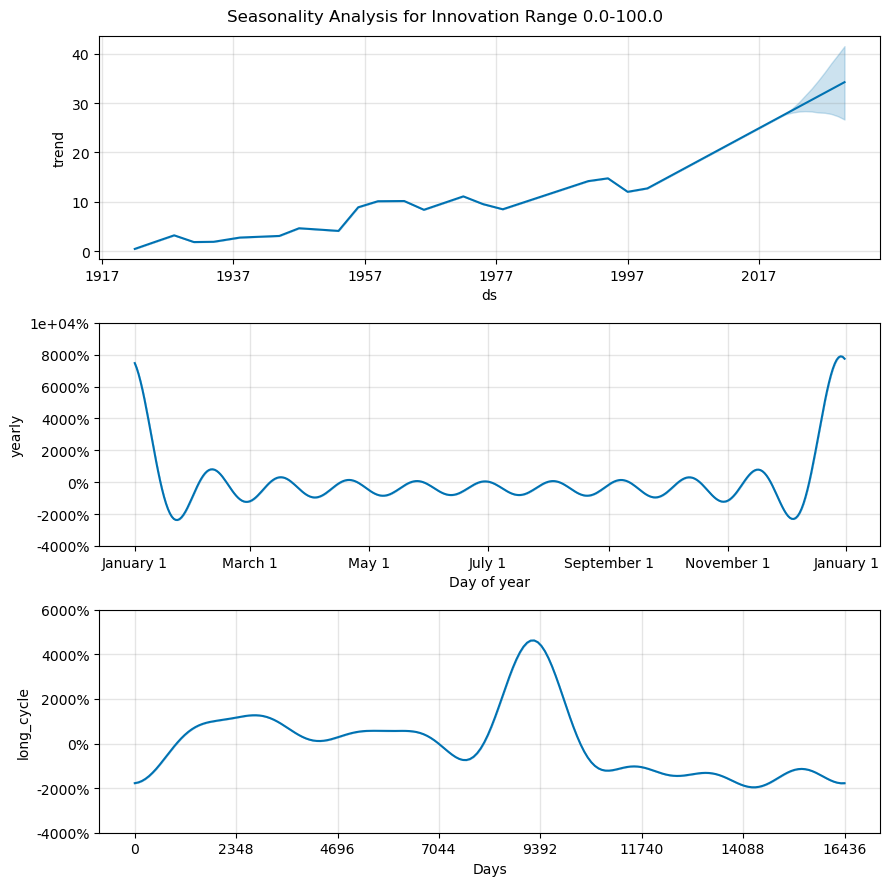

<Figure size 1200x600 with 0 Axes>

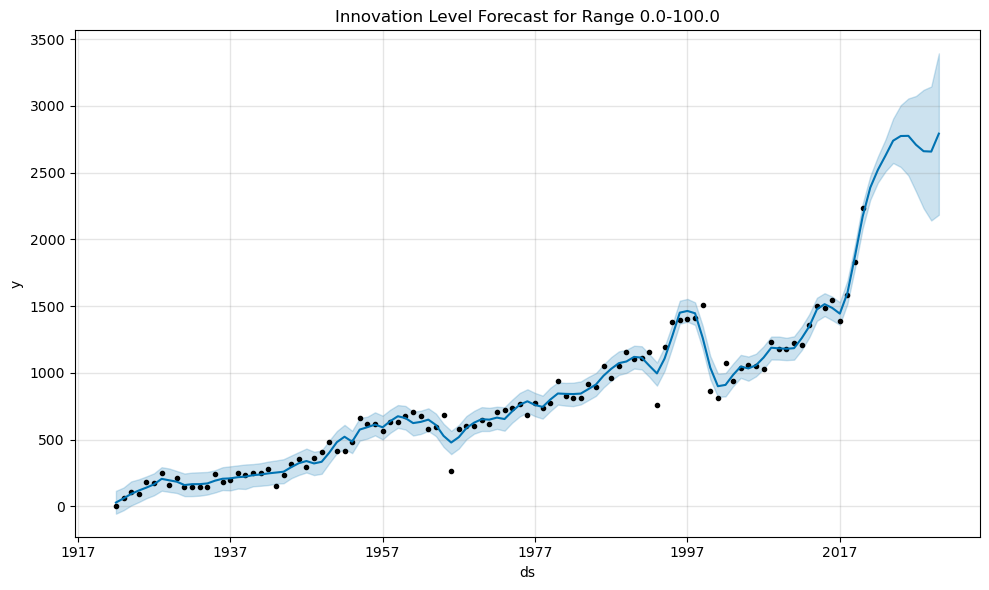

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0    # Emphasize seasonal patterns
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=45*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        plt.figure(figsize=(12, 6))
        model.plot(forecast)
        plt.title(f'Innovation Level Forecast for Range {range_name}')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 100],
    forecast_years=10
)

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    # Extract data
    num_clusters, colors, df = exact_to_pd(cluster_data, artist_name, sample_size, seed)
    
    # Convert release_date to datetime
    df['release_date'] = pd.to_datetime(df['release_date'])
    
    # Calculate distances based on type
    if distance_type == 'historical':
        # Calculate historical mean up to each point
        df = df.sort_values('release_date')
        features_array = np.vstack(df['features'].values)
        historical_means = np.array([features_array[:i+1].mean(axis=0) 
                                   for i in range(len(features_array))])
        distances = np.linalg.norm(features_array - historical_means, axis=1)
    else:  # internal
        # Calculate distance to cluster center
        distances = df['distance']
    
    # Create daily summary
    daily_data = pd.DataFrame({
        'date': df['release_date'],
        'distance': distances
    }).set_index('date')
    
    # Bin the distances
    bins = np.array(bins)
    labels = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    binned = pd.cut(daily_data['distance'], bins=bins, labels=labels)
    
    # Calculate daily distribution
    results_df = pd.get_dummies(binned).resample('D').mean()
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0    # Emphasize seasonal patterns
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=45*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        plt.figure(figsize=(12, 6))
        model.plot(forecast)
        plt.title(f'Innovation Level Forecast for Range {range_name}')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 100],
    forecast_years=10
)

ValueError: Column ds has timezone specified, which is not supported. Remove timezone.

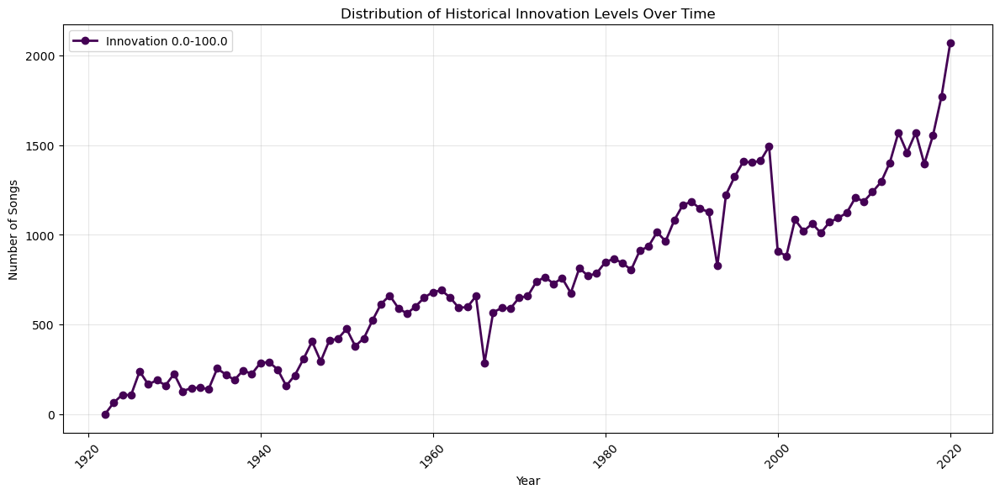

21:59:10 - cmdstanpy - INFO - Chain [1] start processing
21:59:11 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

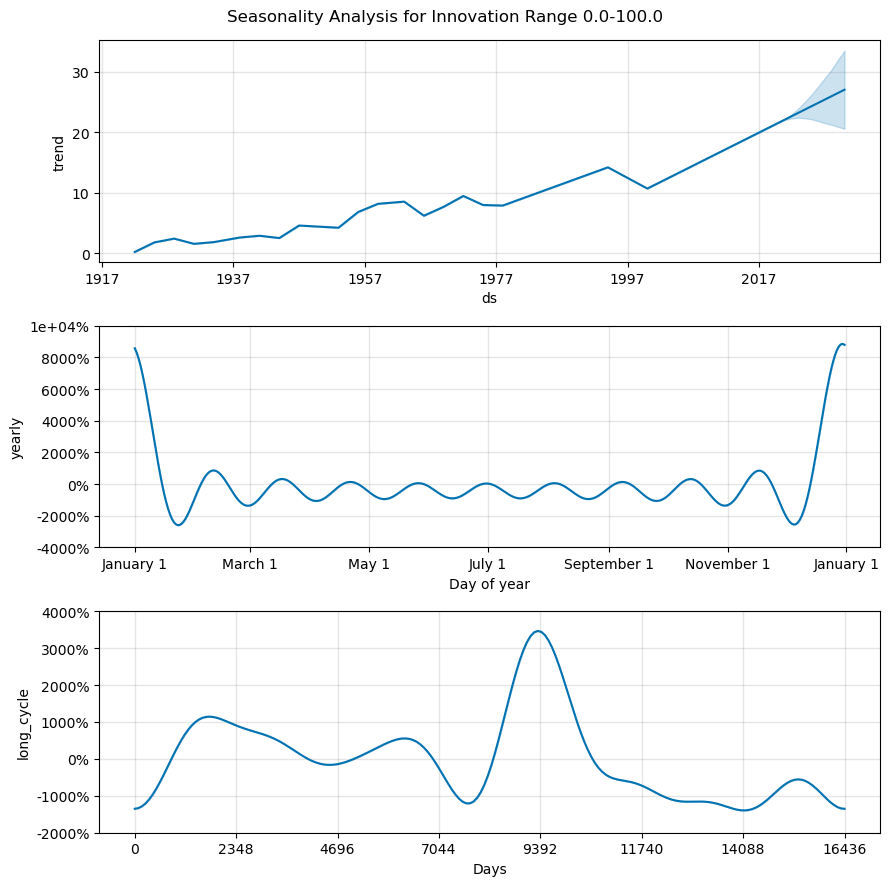

<Figure size 1200x600 with 0 Axes>

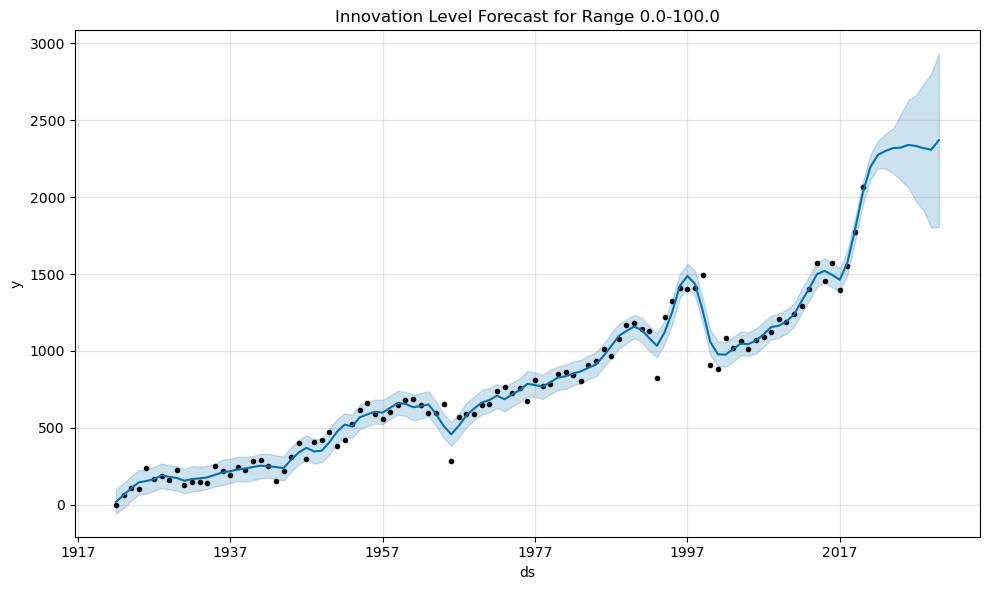

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0    # Emphasize seasonal patterns
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=45*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        plt.figure(figsize=(12, 6))
        model.plot(forecast)
        plt.title(f'Innovation Level Forecast for Range {range_name}')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 100],
    forecast_years=10
)

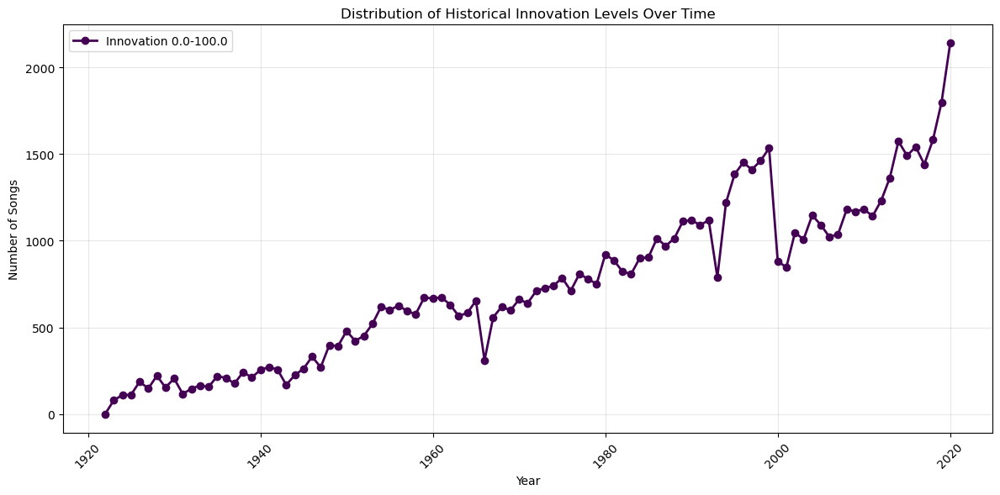

21:59:58 - cmdstanpy - INFO - Chain [1] start processing
21:59:58 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

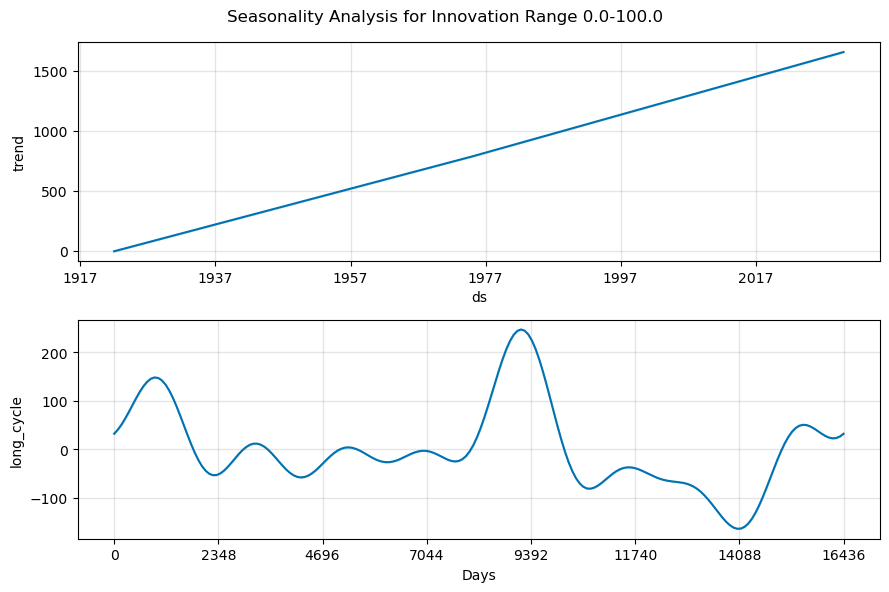

<Figure size 1200x600 with 0 Axes>

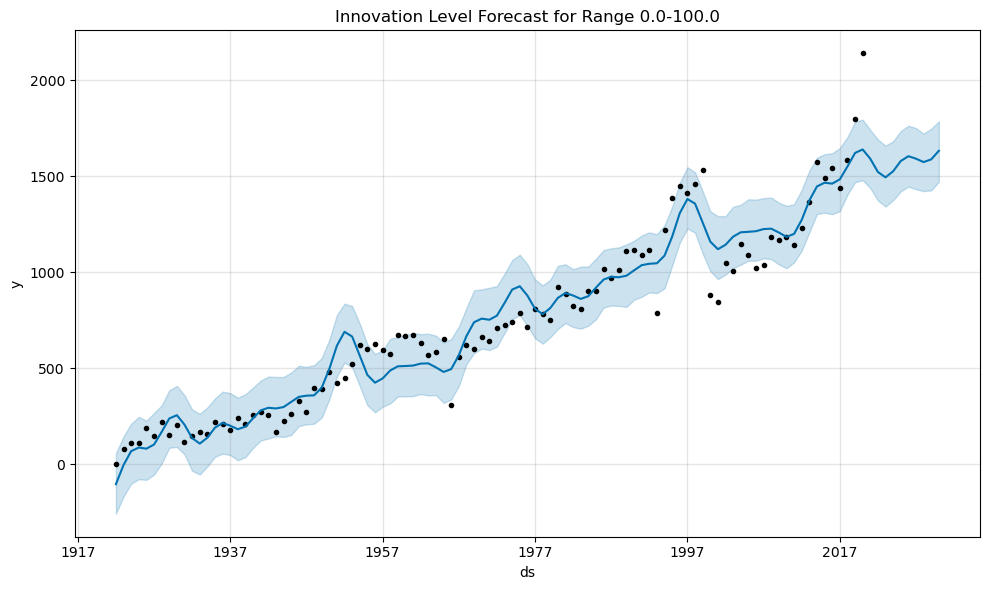

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=False,  
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='additive', 
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0    # Emphasize seasonal patterns
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=45*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        plt.figure(figsize=(12, 6))
        model.plot(forecast)
        plt.title(f'Innovation Level Forecast for Range {range_name}')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 100],
    forecast_years=10
)

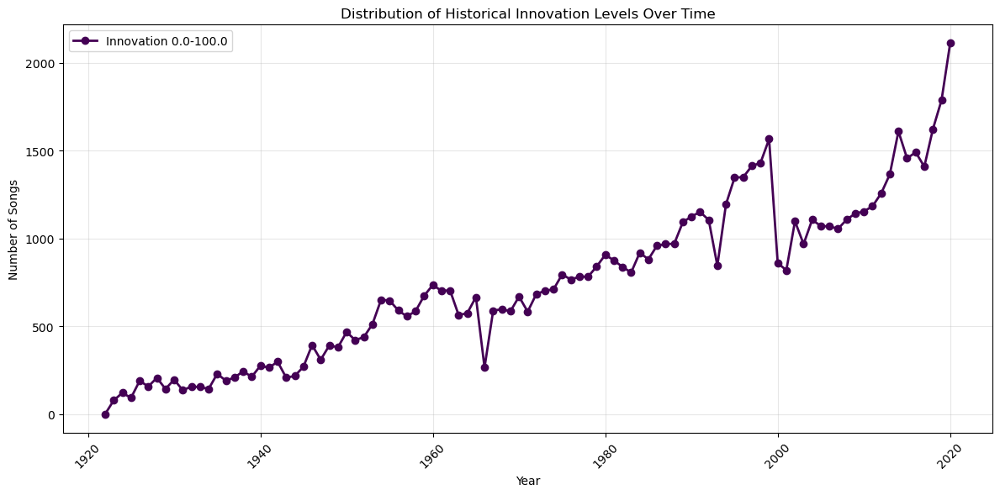

22:00:34 - cmdstanpy - INFO - Chain [1] start processing
22:00:35 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

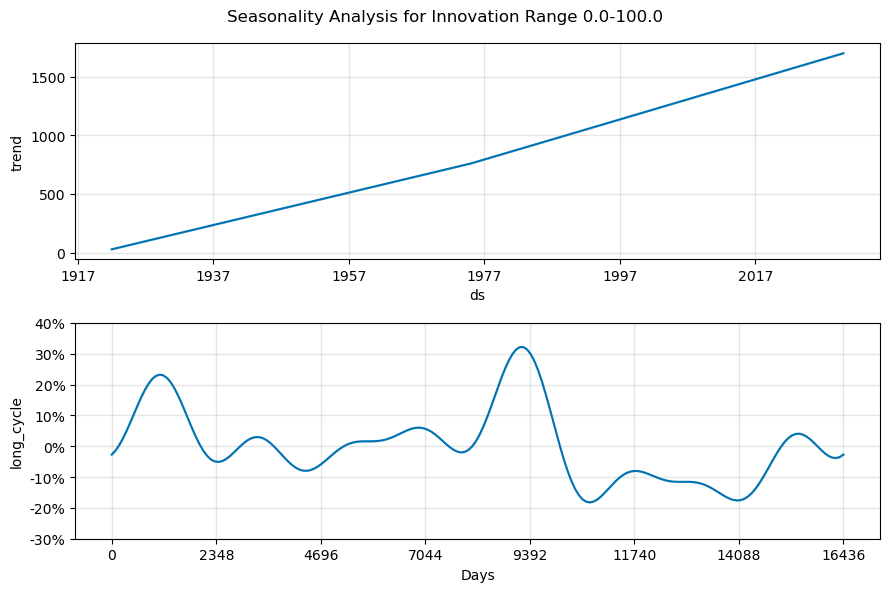

<Figure size 1200x600 with 0 Axes>

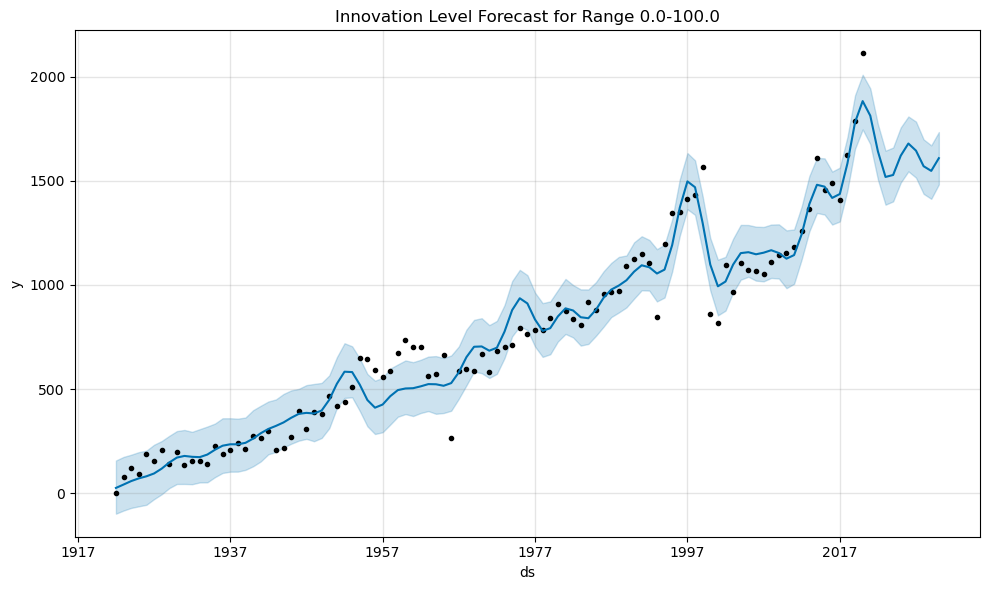

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=False,  
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0    # Emphasize seasonal patterns
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=45*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        plt.figure(figsize=(12, 6))
        model.plot(forecast)
        plt.title(f'Innovation Level Forecast for Range {range_name}')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 100],
    forecast_years=10
)

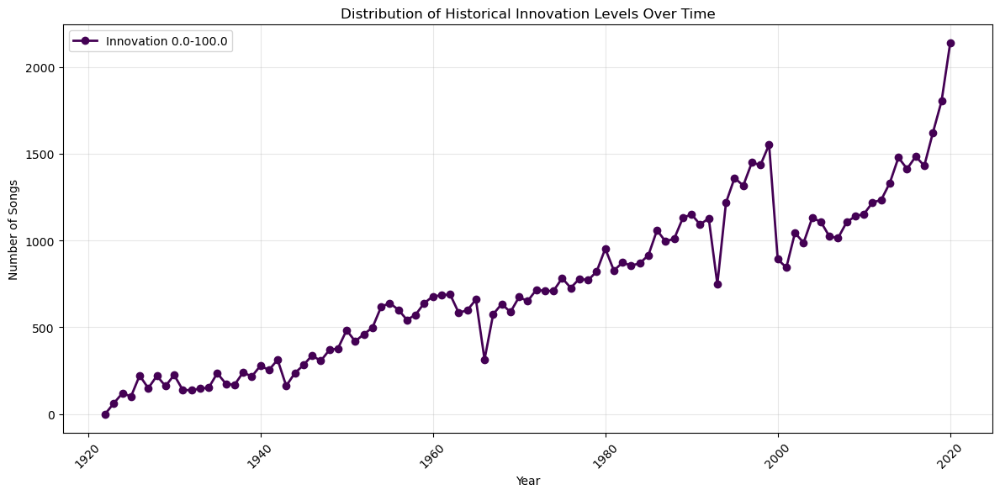

22:01:17 - cmdstanpy - INFO - Chain [1] start processing
22:01:19 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

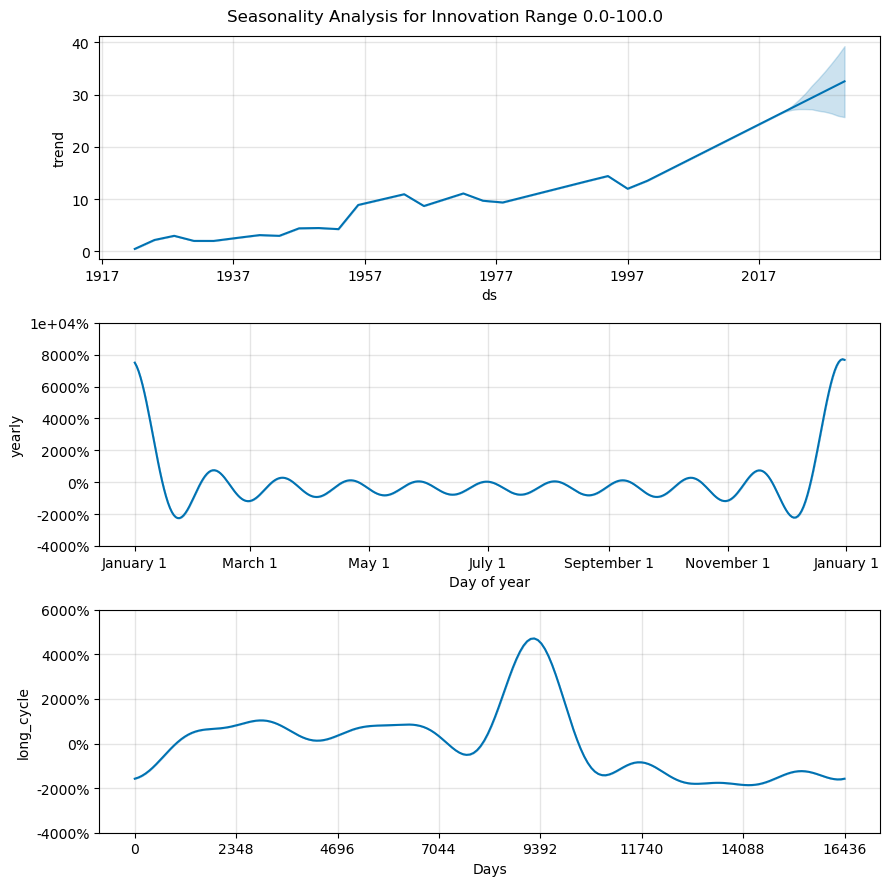

<Figure size 1200x600 with 0 Axes>

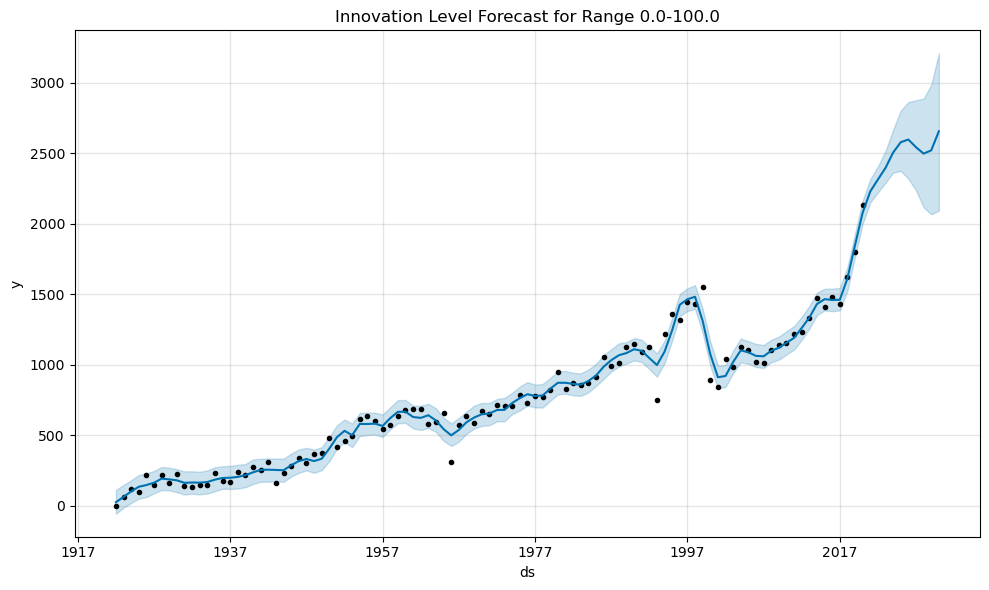

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0    # Emphasize seasonal patterns
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=45*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        plt.figure(figsize=(12, 6))
        model.plot(forecast)
        plt.title(f'Innovation Level Forecast for Range {range_name}')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 100],
    forecast_years=10
)

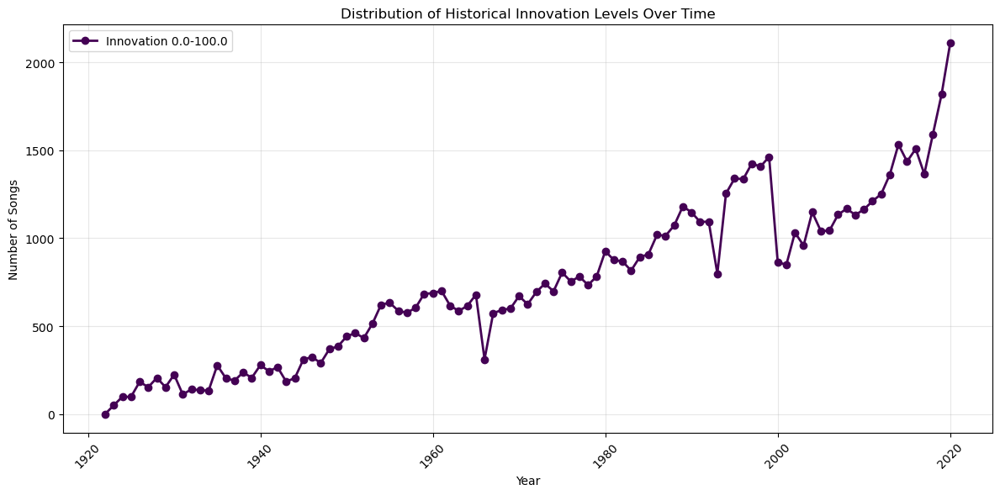

22:06:04 - cmdstanpy - INFO - Chain [1] start processing
22:06:06 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

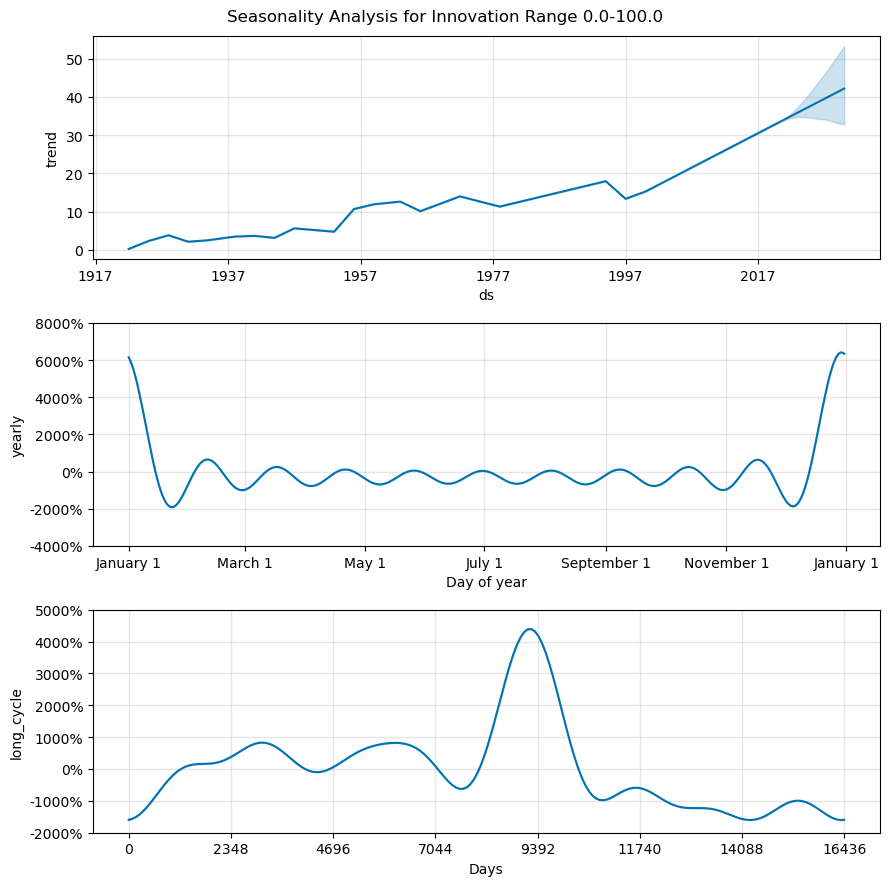

<Figure size 1200x600 with 0 Axes>

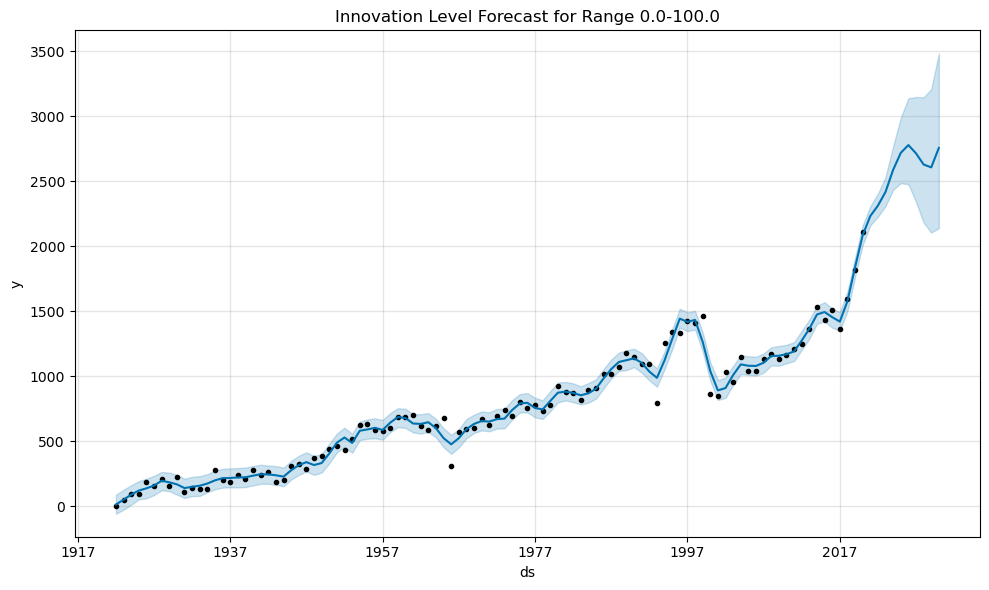

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10,cycle_years=45):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.1,  # Control overall trend flexibility
            seasonality_prior_scale=10.0    # Emphasize seasonal patterns
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=cycle_years*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        plt.figure(figsize=(12, 6))
        model.plot(forecast)
        plt.title(f'Innovation Level Forecast for Range {range_name}')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 100],
    forecast_years=10
)

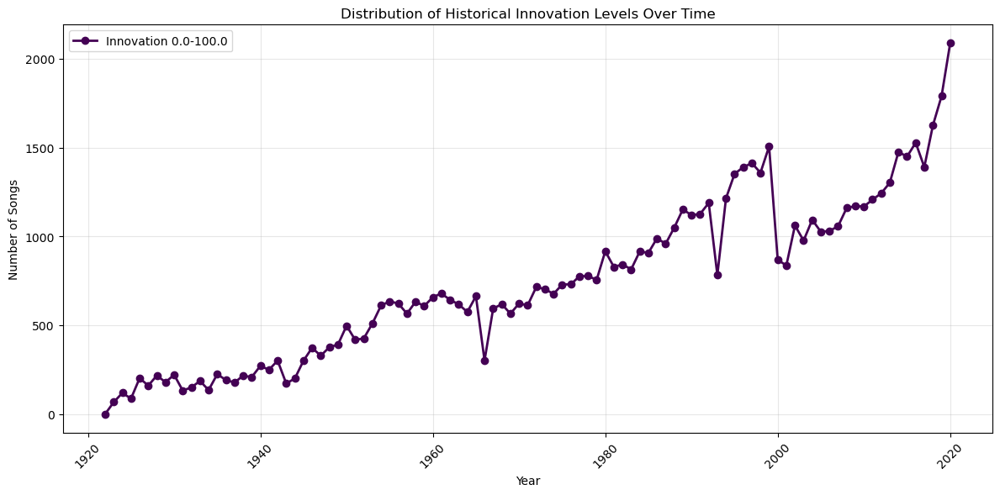

22:07:32 - cmdstanpy - INFO - Chain [1] start processing
22:07:33 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

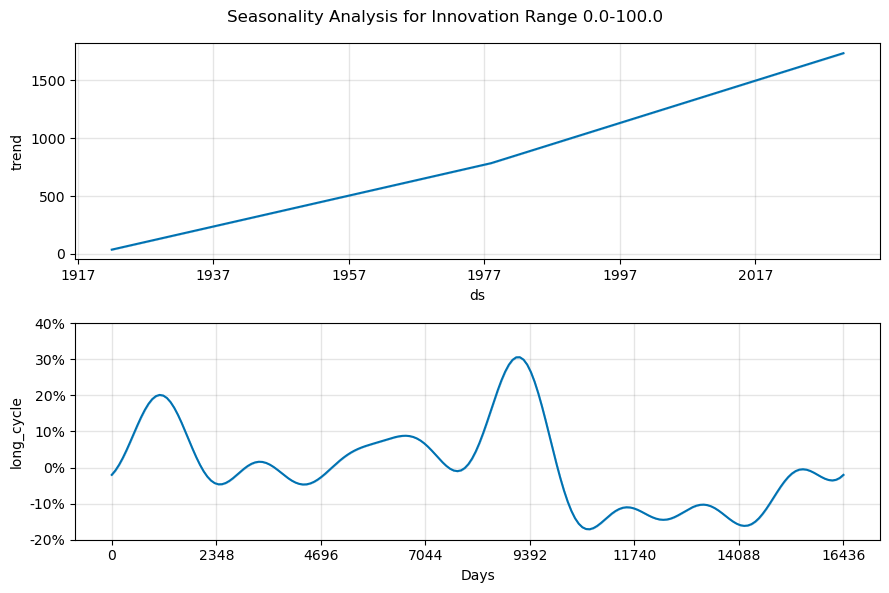

<Figure size 1200x600 with 0 Axes>

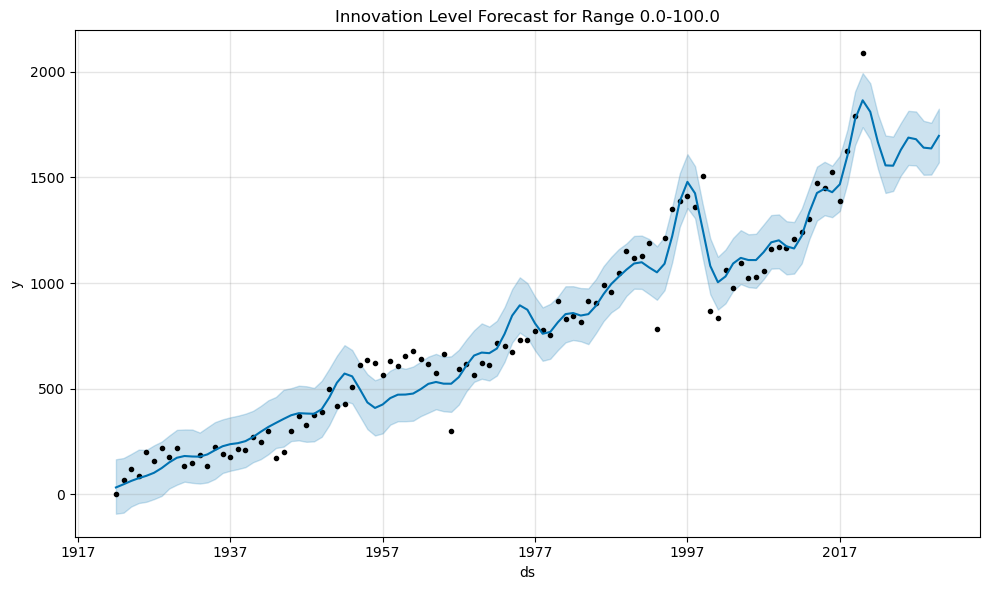

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10,cycle_years=45):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=False,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.1,  # Control overall trend flexibility
            seasonality_prior_scale=10.0    # Emphasize seasonal patterns
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=cycle_years*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        plt.figure(figsize=(12, 6))
        model.plot(forecast)
        plt.title(f'Innovation Level Forecast for Range {range_name}')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 100],
    forecast_years=10
)

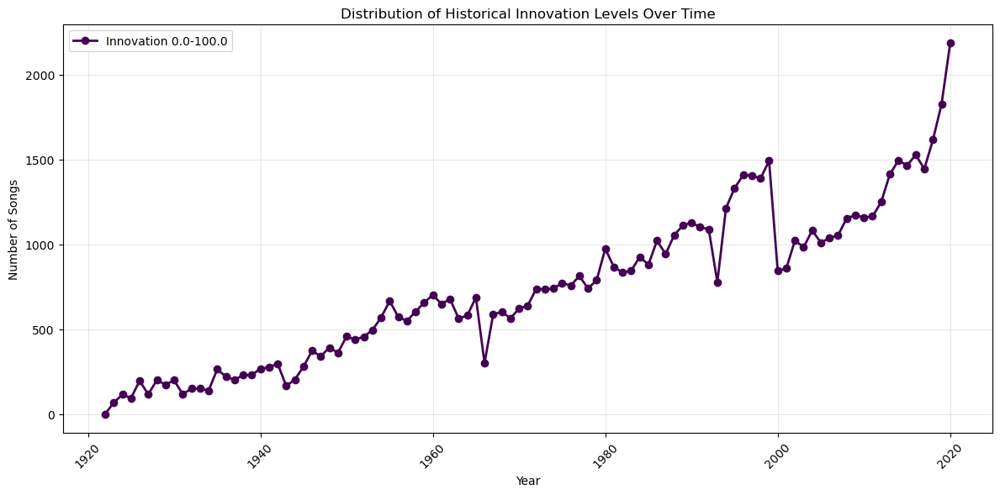

22:09:48 - cmdstanpy - INFO - Chain [1] start processing
22:09:50 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

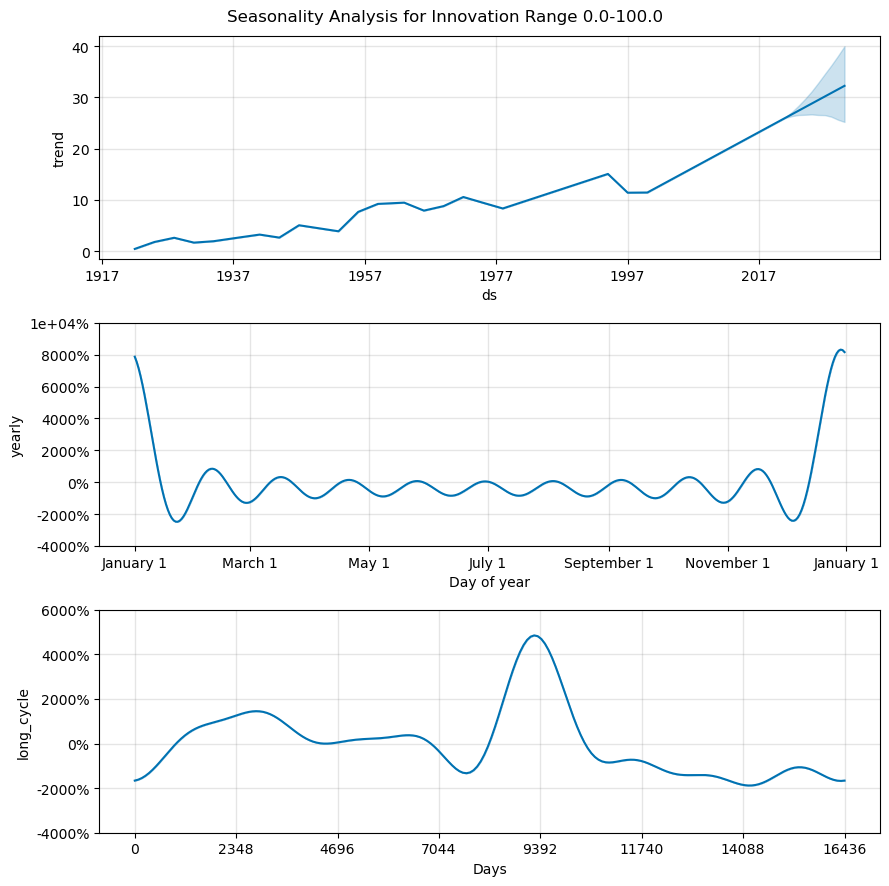

<Figure size 1200x600 with 0 Axes>

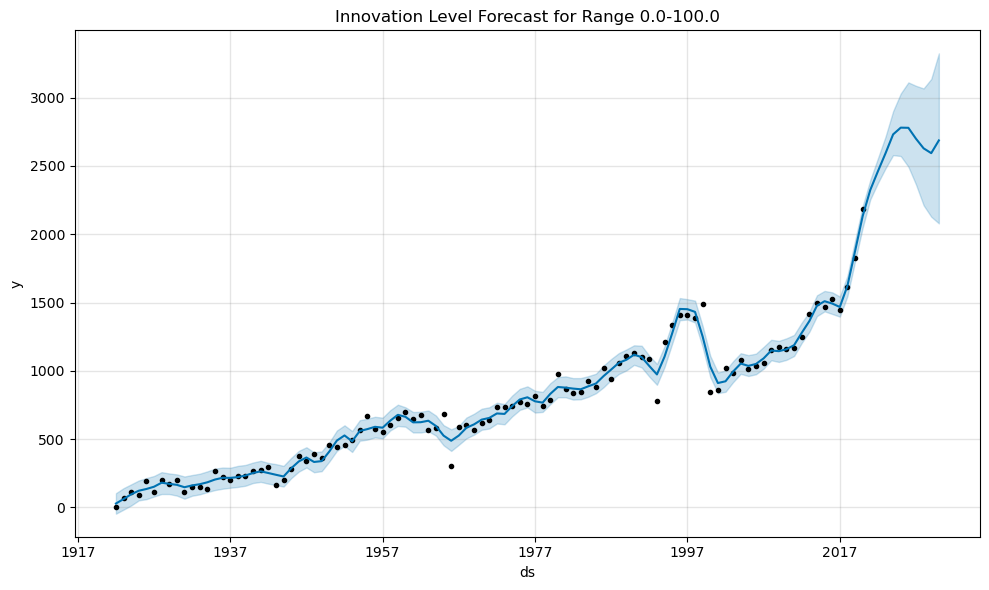

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10,cycle_years=45):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0    # Emphasize seasonal patterns
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=cycle_years*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        plt.figure(figsize=(12, 6))
        model.plot(forecast)
        plt.title(f'Innovation Level Forecast for Range {range_name}')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 100],
    forecast_years=10
)

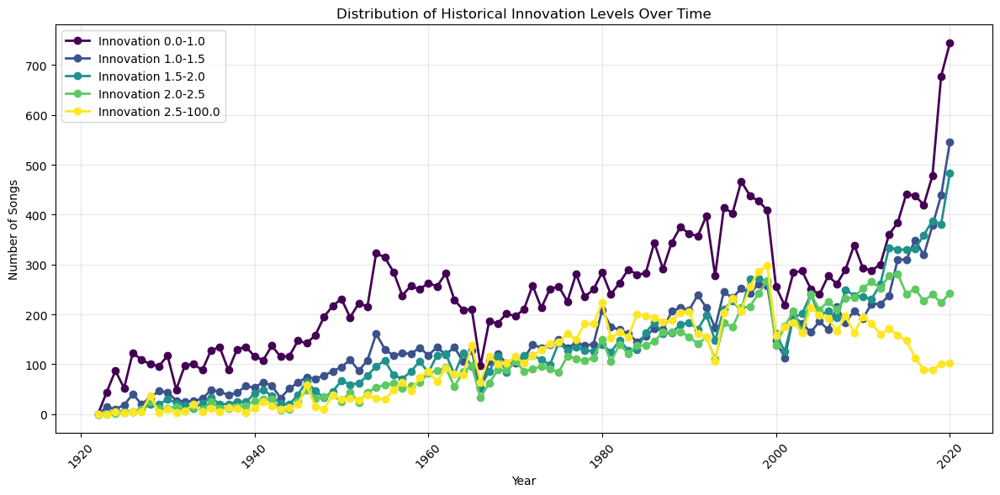

22:10:20 - cmdstanpy - INFO - Chain [1] start processing
22:10:21 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

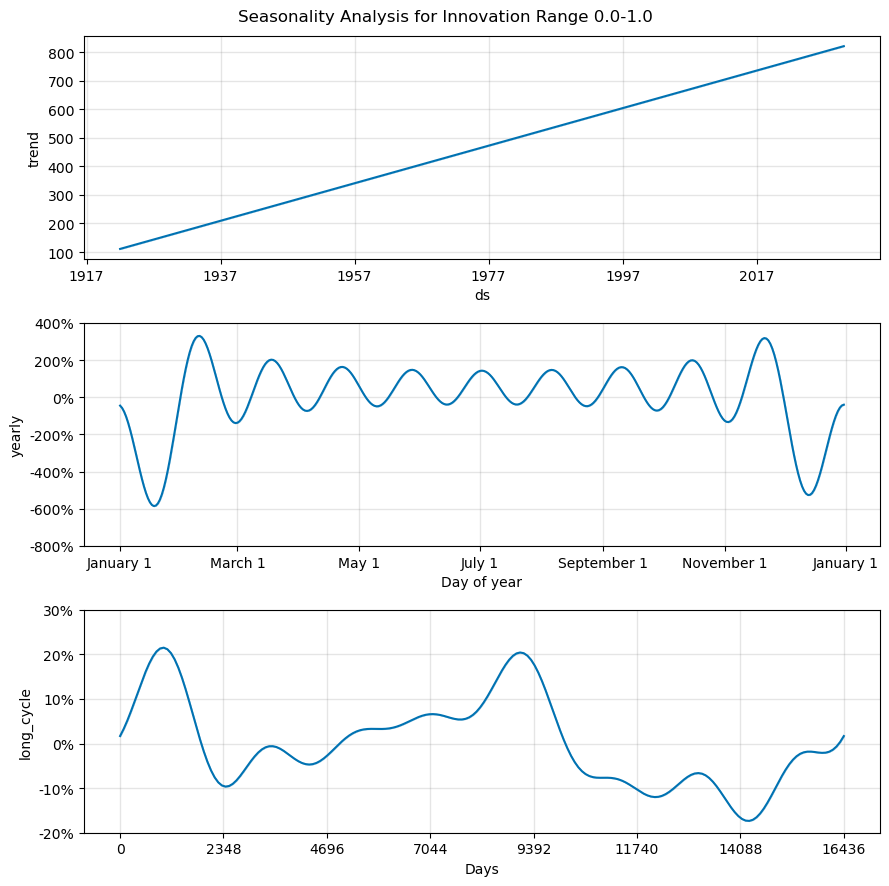

<Figure size 1200x600 with 0 Axes>

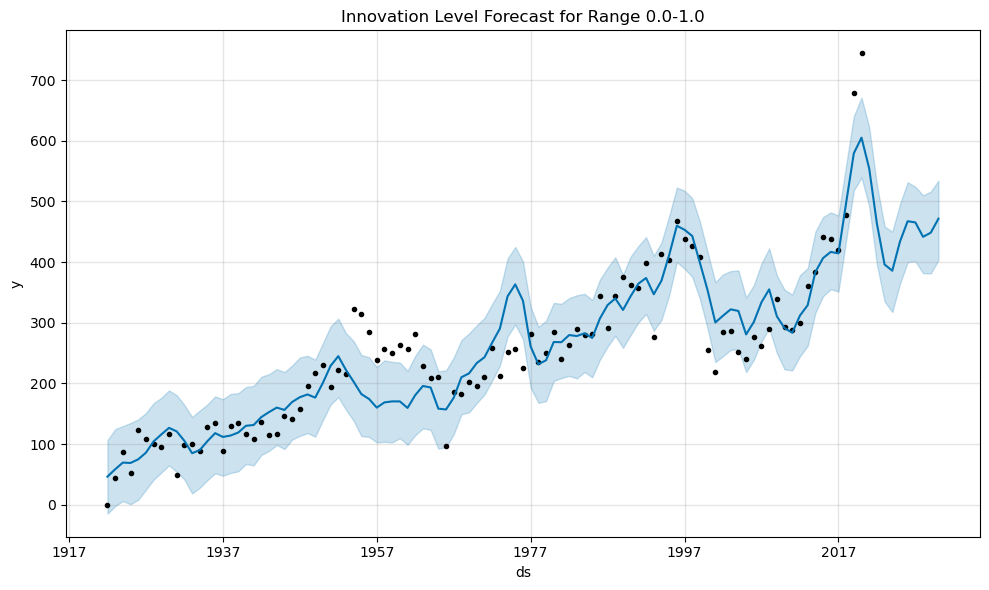

22:10:22 - cmdstanpy - INFO - Chain [1] start processing
22:10:23 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

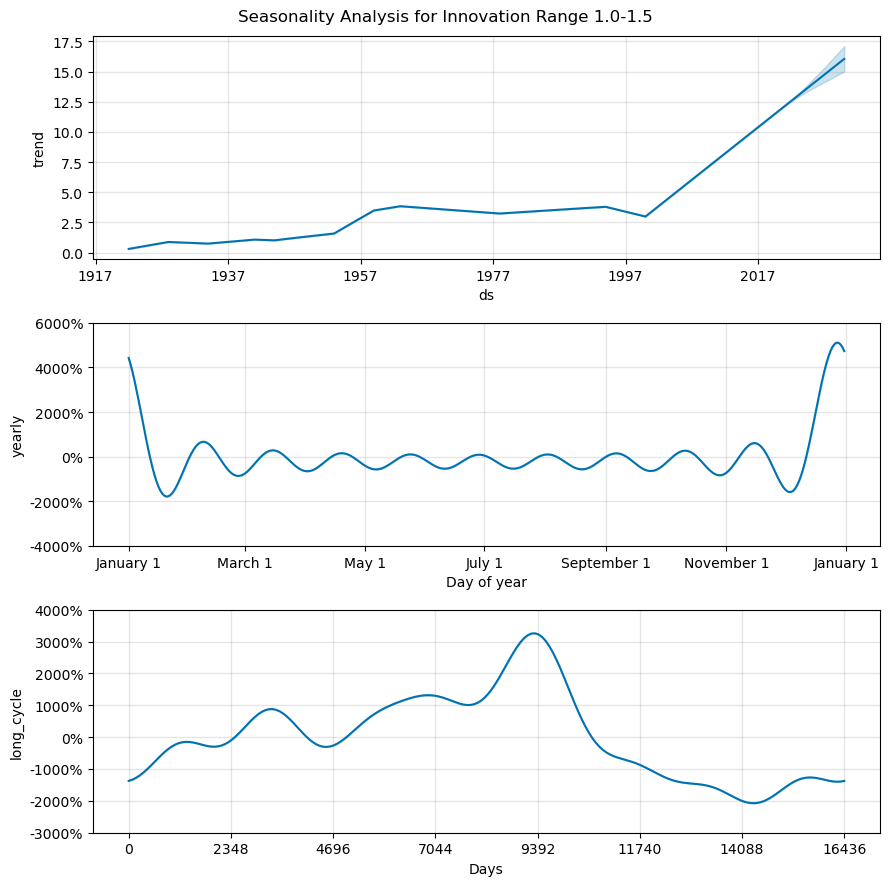

<Figure size 1200x600 with 0 Axes>

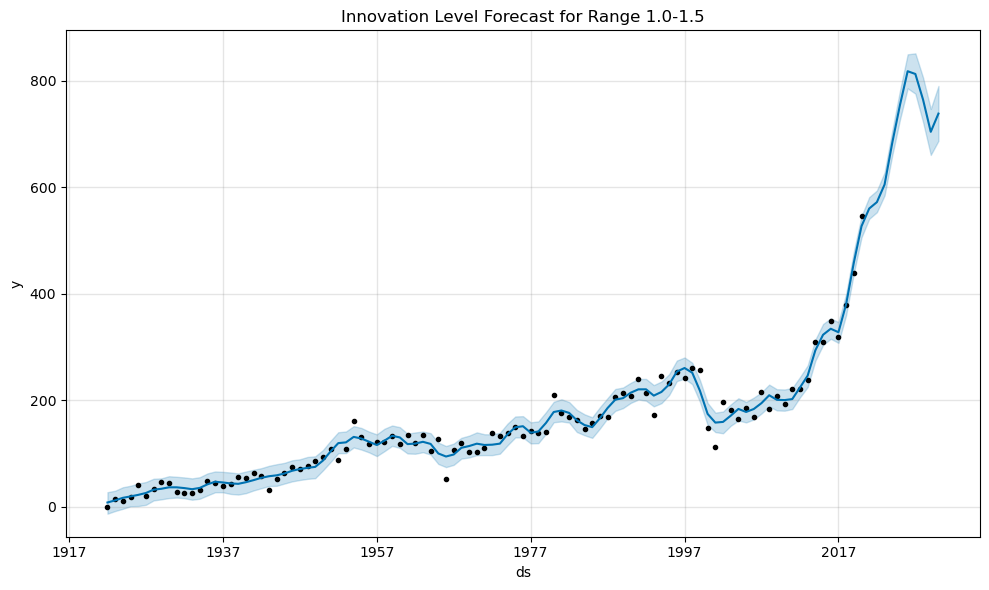

22:10:24 - cmdstanpy - INFO - Chain [1] start processing
22:10:26 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

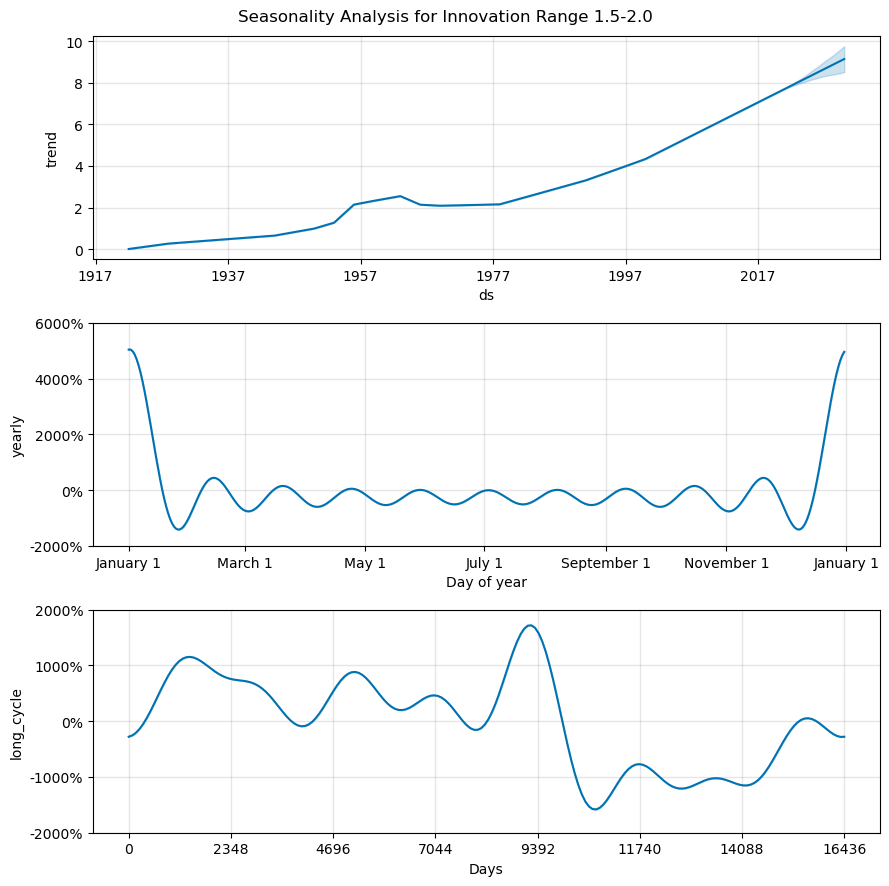

<Figure size 1200x600 with 0 Axes>

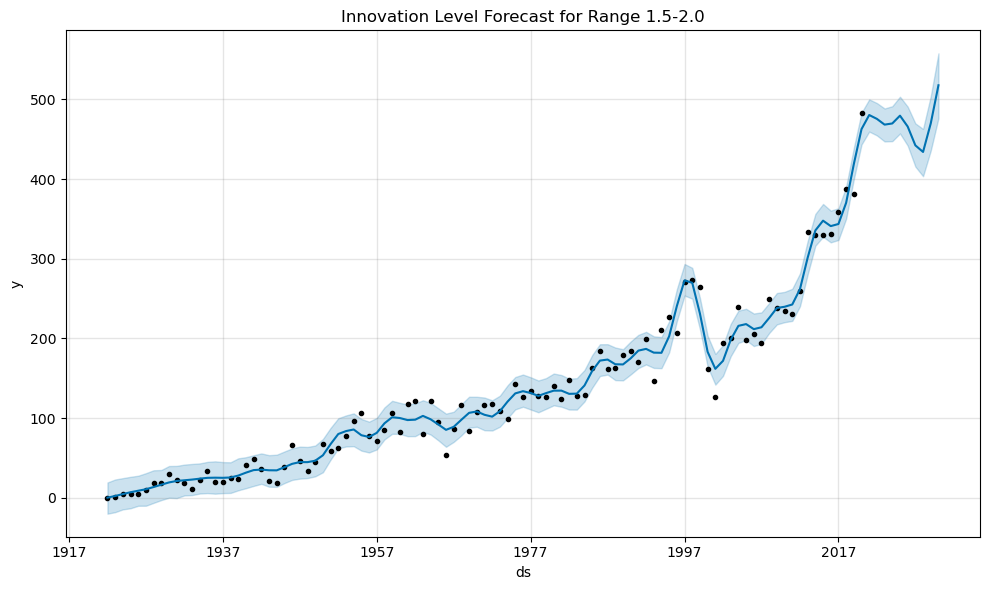

22:10:26 - cmdstanpy - INFO - Chain [1] start processing
22:10:28 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

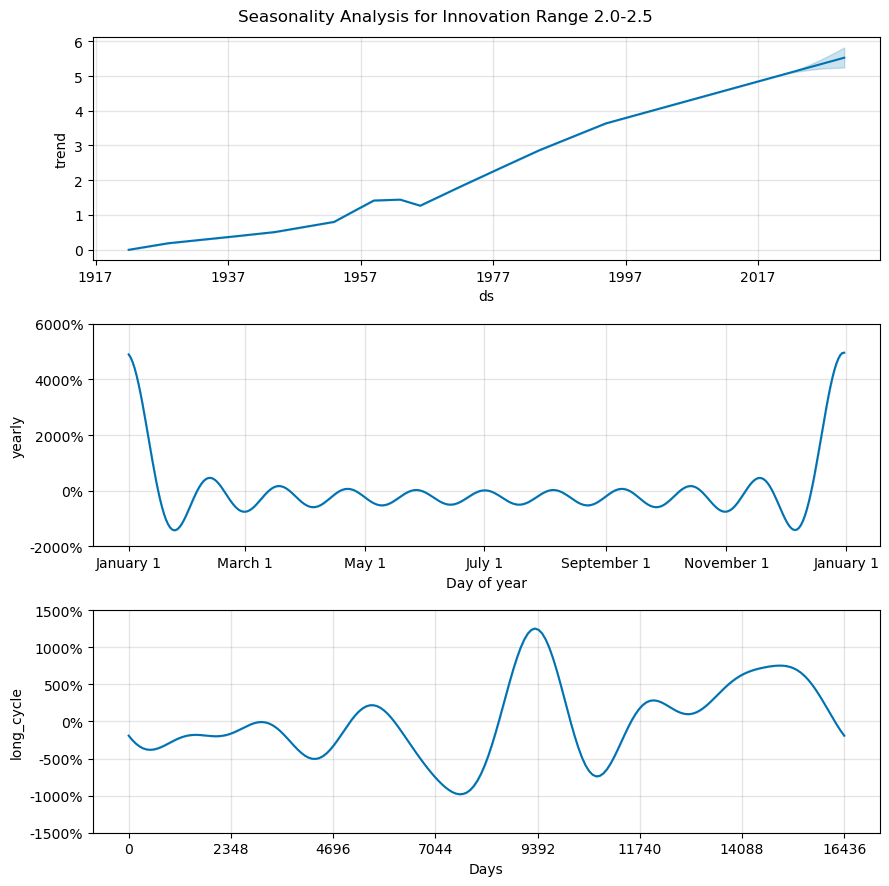

<Figure size 1200x600 with 0 Axes>

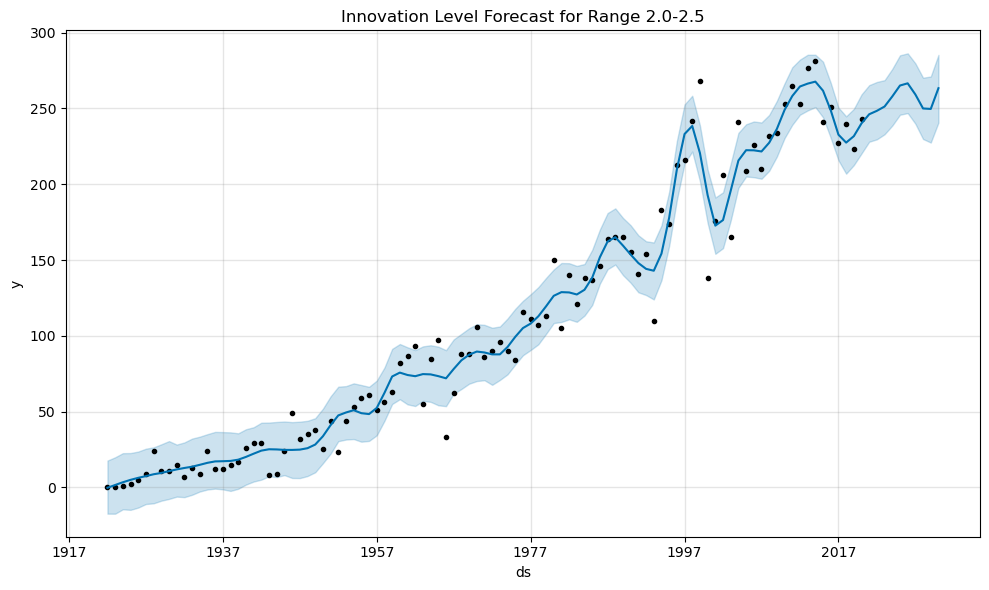

22:10:29 - cmdstanpy - INFO - Chain [1] start processing
22:10:30 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

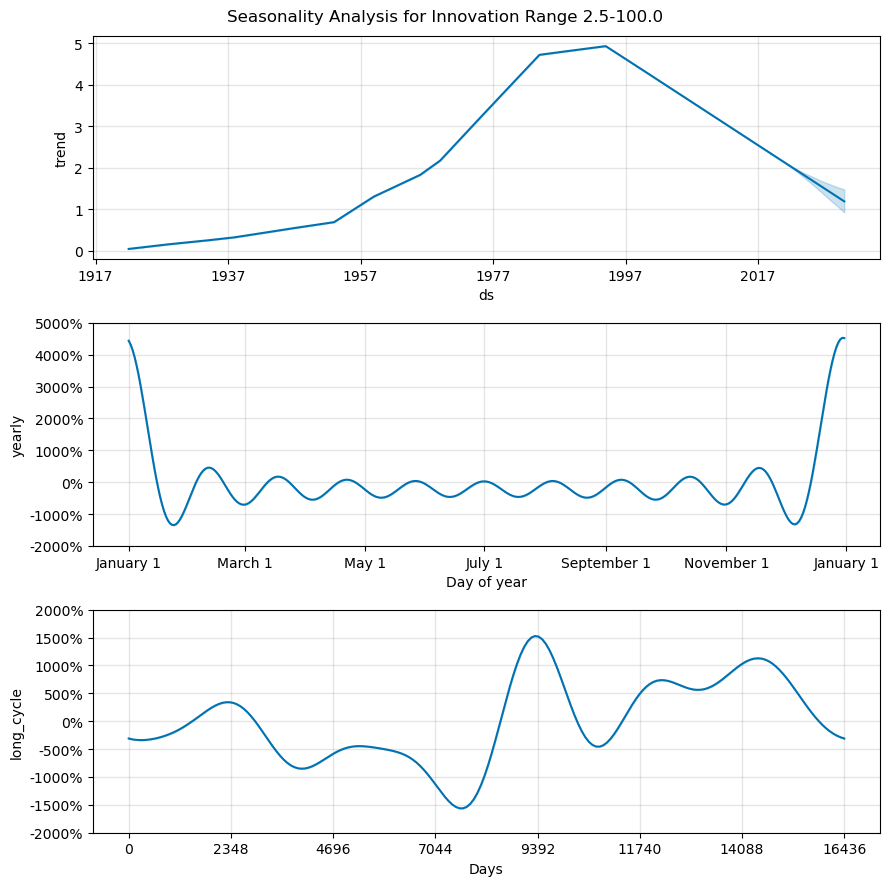

<Figure size 1200x600 with 0 Axes>

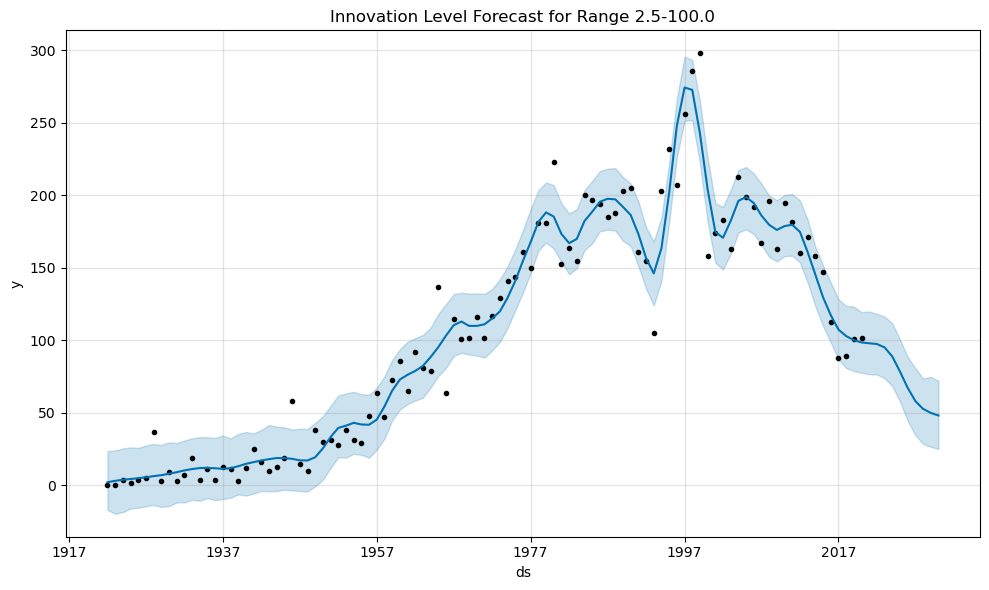

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10,cycle_years=45):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0    # Emphasize seasonal patterns
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=cycle_years*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        plt.figure(figsize=(12, 6))
        model.plot(forecast)
        plt.title(f'Innovation Level Forecast for Range {range_name}')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0,1,1.5,2,2.5,100],
    forecast_years=10
)

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10, min_cycle=20, max_cycle=60):
    """
    Analyze seasonality in innovation levels using Prophet with adaptive cycle detection
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
        min_cycle: Minimum cycle length to consider (years)
        max_cycle: Maximum cycle length to consider (years)
    """
    from prophet import Prophet
    from scipy import signal, stats
    import numpy as np
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    def detect_cycle_length(time_series):
        """Detect dominant cycle length using spectral analysis"""
        # Detrend the data
        detrended = signal.detrend(time_series)
        
        # Compute periodogram
        freqs, psd = signal.periodogram(detrended)
        
        # Convert frequencies to periods (in years)
        periods = 1 / freqs[1:]  # Skip first element (0 frequency)
        psd = psd[1:]
        
        # Filter periods within desired range
        mask = (periods >= min_cycle) & (periods <= max_cycle)
        valid_periods = periods[mask]
        valid_psd = psd[mask]
        
        if len(valid_periods) == 0:
            return None
            
        # Find dominant period
        dominant_idx = np.argmax(valid_psd)
        return valid_periods[dominant_idx]
    
    def detect_trend_changepoints(time_series, dates):
        """Detect significant changes in trend using piecewise regression"""
        from sklearn.linear_model import LinearRegression
        from sklearn.preprocessing import PolynomialFeatures
        
        # Convert dates to numeric values
        x = np.arange(len(dates)).reshape(-1, 1)
        y = time_series.values
        
        # Fit polynomial regression
        poly = PolynomialFeatures(degree=3)
        x_poly = poly.fit_transform(x)
        model = LinearRegression()
        model.fit(x_poly, y)
        
        # Calculate residuals
        residuals = y - model.predict(x_poly)
        
        # Use CUSUM to detect changepoints
        cusum = np.cumsum(residuals)
        changepoint_idx = np.argmax(np.abs(cusum))
        
        return dates[changepoint_idx]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),
            'y': results_df[range_name]
        })
        
        # Detect cycle length
        detected_cycle = detect_cycle_length(df['y'])
        print(f"Detected cycle length for {range_name}: {detected_cycle:.1f} years")
        
        # Detect trend changepoints
        changepoint = detect_trend_changepoints(df['y'], df['ds'])
        print(f"Detected major trend changepoint for {range_name}: {changepoint.year}")
        
        # Initialize Prophet model with detected parameters
        model = Prophet(
            yearly_seasonality=True,
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',
            changepoint_prior_scale=0.05,
            seasonality_prior_scale=10.0,
            changepoints=[changepoint]  # Add detected changepoint
        )
        
        # Add detected cycle if found
        if detected_cycle is not None:
            model.add_seasonality(
                name='long_cycle',
                period=detected_cycle*365.25,
                fourier_order=8
            )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df,
            'cycle_length': detected_cycle,
            'changepoint': changepoint
        }
        
        # Plot results with additional information
        fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 12))
        
        # Plot forecast
        model.plot(forecast, ax=ax1)
        ax1.axvline(x=changepoint, color='r', linestyle='--', 
                   label=f'Trend Changepoint ({changepoint.year})')
        ax1.set_title(f'Innovation Level Forecast for Range {range_name}')
        ax1.legend()
        
        # Plot components
        model.plot_components(forecast, ax=ax2)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}\n' +
                    f'Detected Cycle: {detected_cycle:.1f} years')
        plt.tight_layout()
        plt.show()
        
        # Additional trend analysis plot
        plt.figure(figsize=(12, 6))
        plt.plot(df['ds'], forecast['trend'], label='Trend')
        plt.axvline(x=changepoint, color='r', linestyle='--', 
                   label=f'Changepoint ({changepoint.year})')
        
        # Calculate and display trend slopes
        def get_slope(x, y):
            return np.polyfit(x, y, 1)[0]
        
        before_mask = df['ds'] < changepoint
        after_mask = df['ds'] >= changepoint
        
        before_slope = get_slope(range(sum(before_mask)), 
                               forecast['trend'][:sum(before_mask)])
        after_slope = get_slope(range(sum(after_mask)), 
                              forecast['trend'][sum(before_mask):])
        
        plt.text(0.02, 0.98, 
                f'Slope before: {before_slope:.2e}\nSlope after: {after_slope:.2e}',
                transform=plt.gca().transAxes,
                verticalalignment='top',
                bbox=dict(facecolor='white', alpha=0.8))
        
        plt.title(f'Trend Analysis for Range {range_name}')
        plt.legend()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0,1,1.5,2,2.5,100],
    forecast_years=10
)

ImportError: libmkl_rt.so.1: cannot open shared object file: No such file or directory

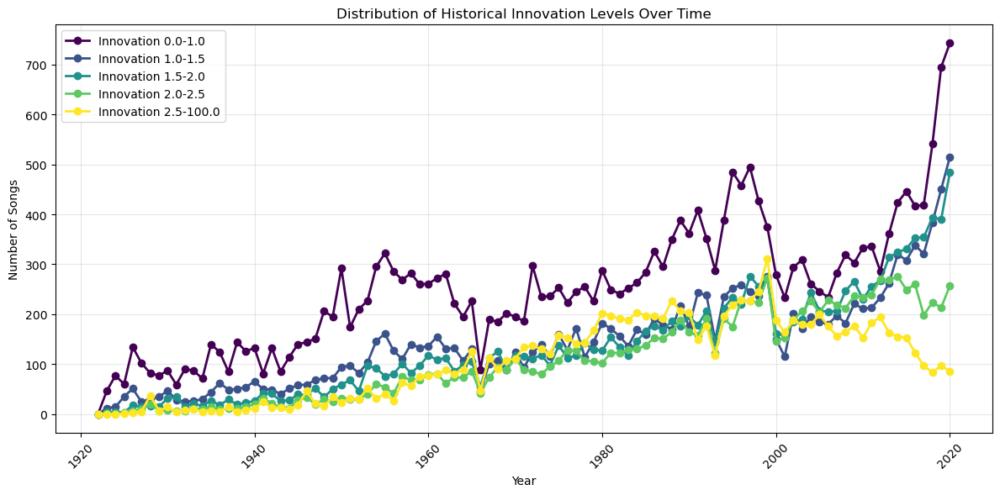

22:15:57 - cmdstanpy - INFO - Chain [1] start processing
22:15:57 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

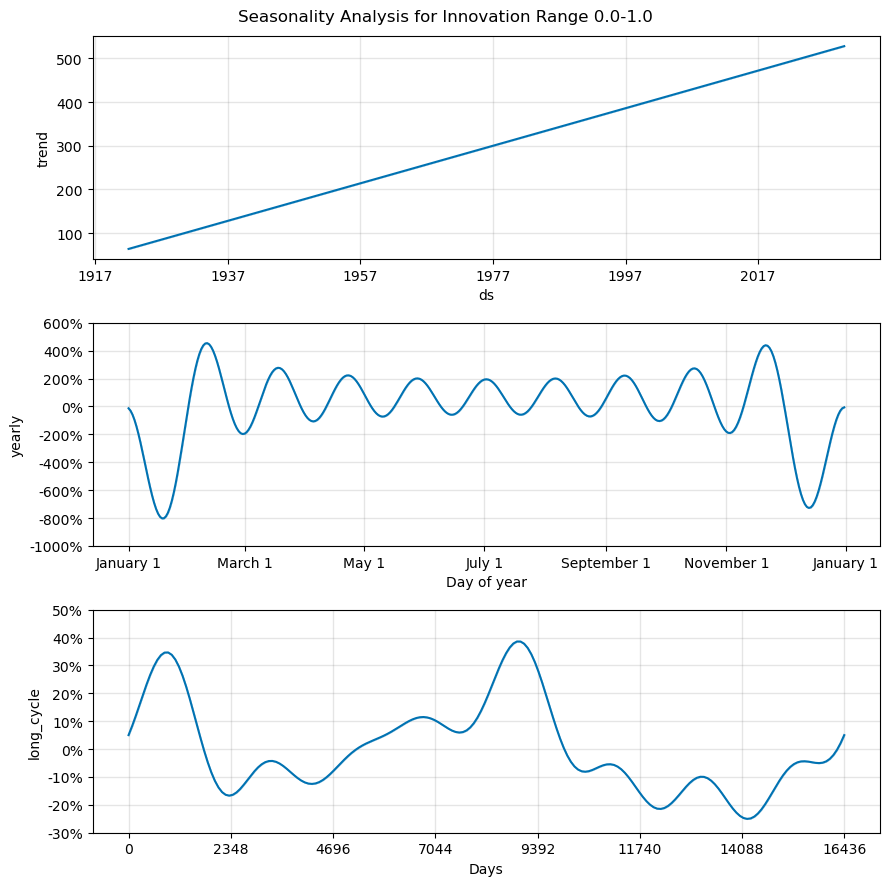

<Figure size 1200x600 with 0 Axes>

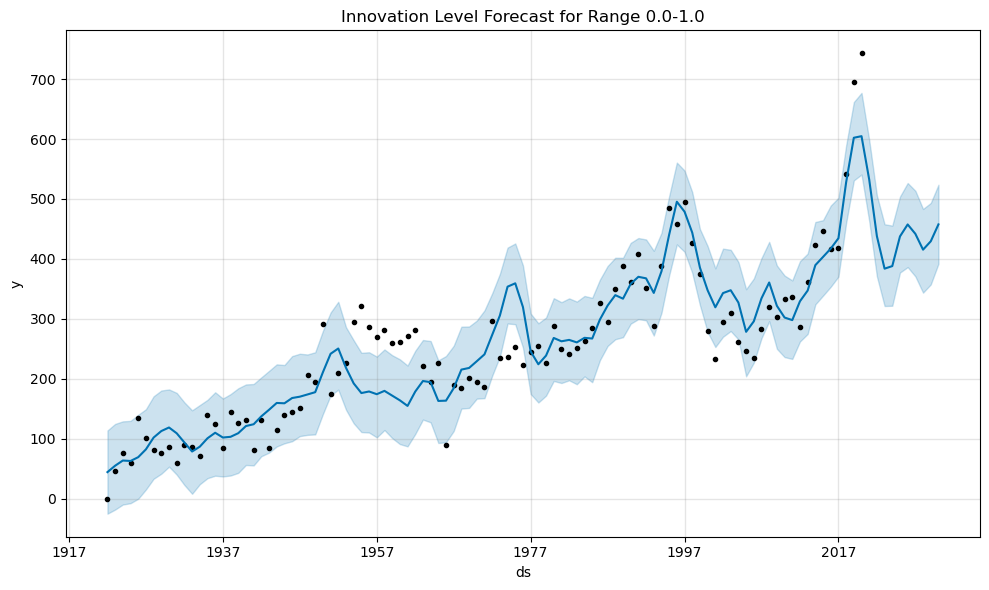

22:15:58 - cmdstanpy - INFO - Chain [1] start processing
22:15:59 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

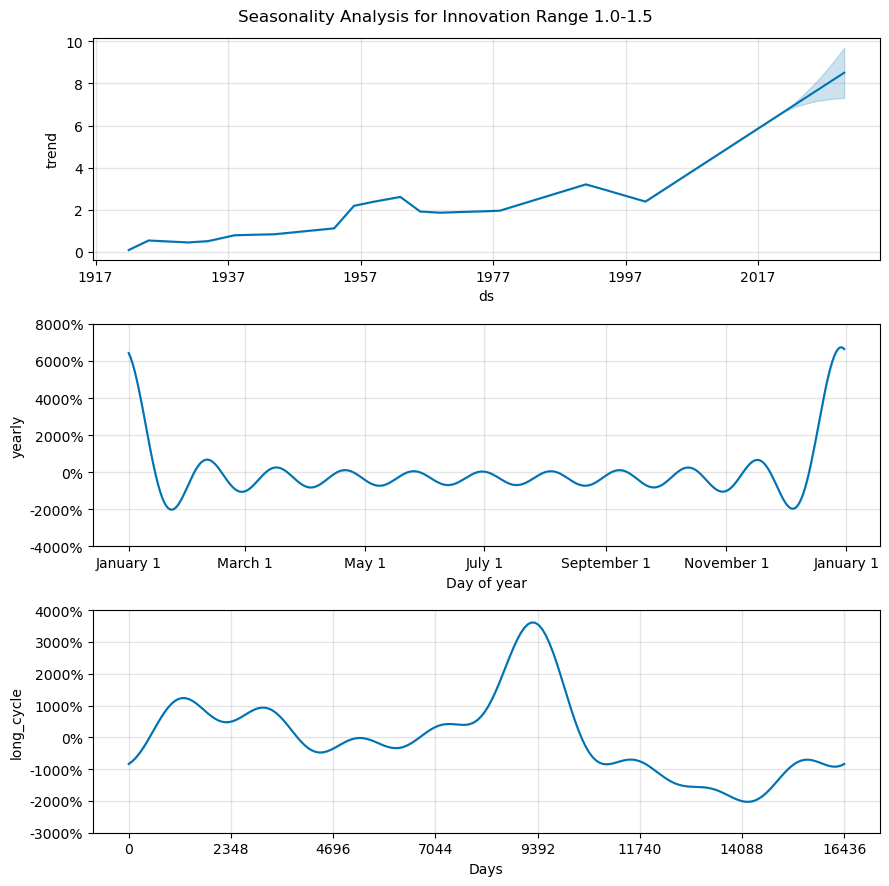

<Figure size 1200x600 with 0 Axes>

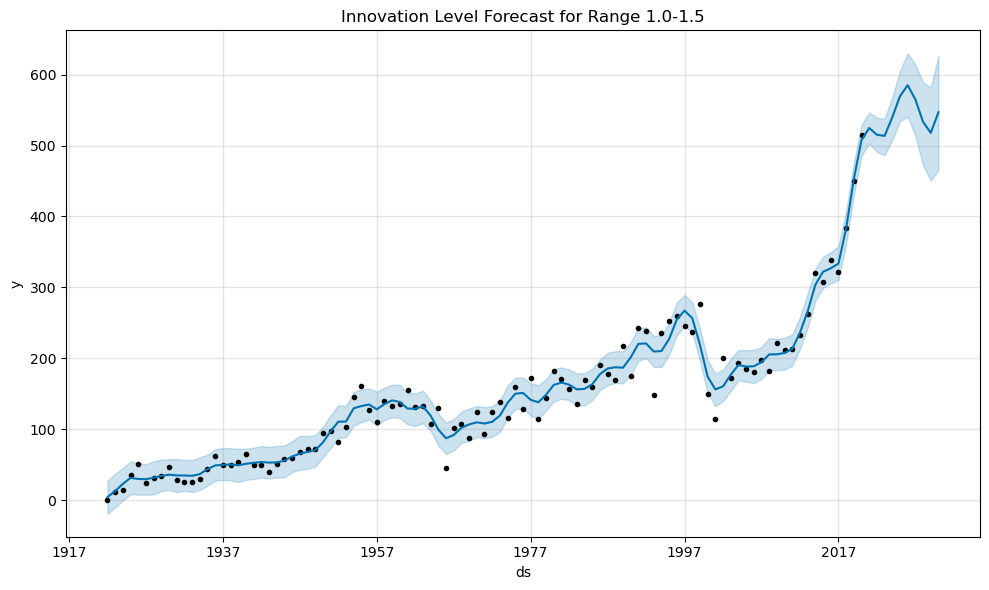

22:16:00 - cmdstanpy - INFO - Chain [1] start processing
22:16:01 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

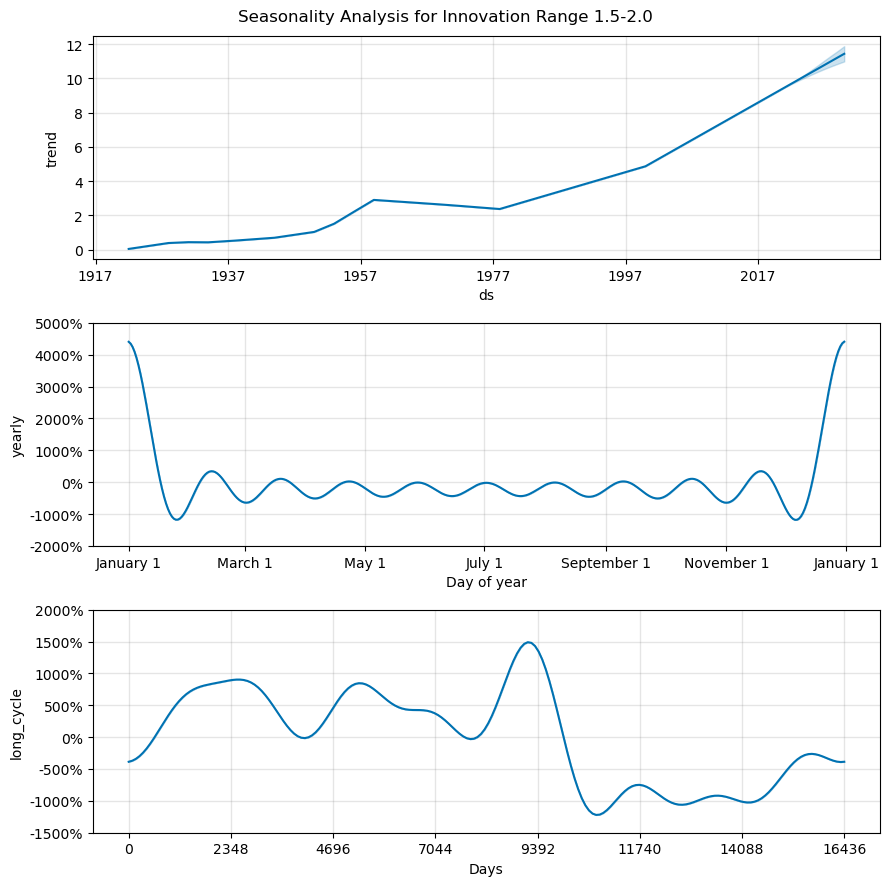

<Figure size 1200x600 with 0 Axes>

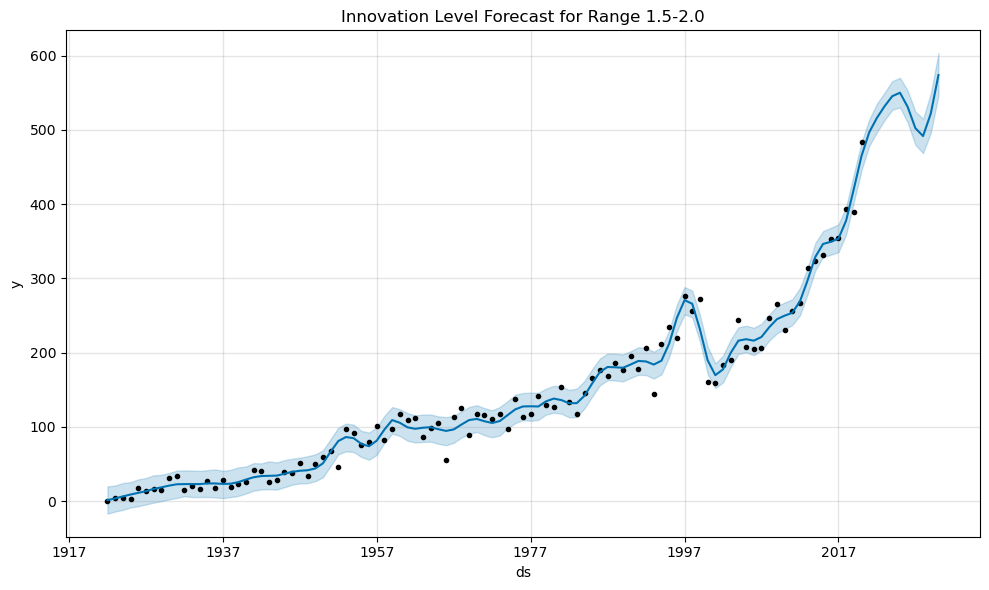

22:16:02 - cmdstanpy - INFO - Chain [1] start processing
22:16:04 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

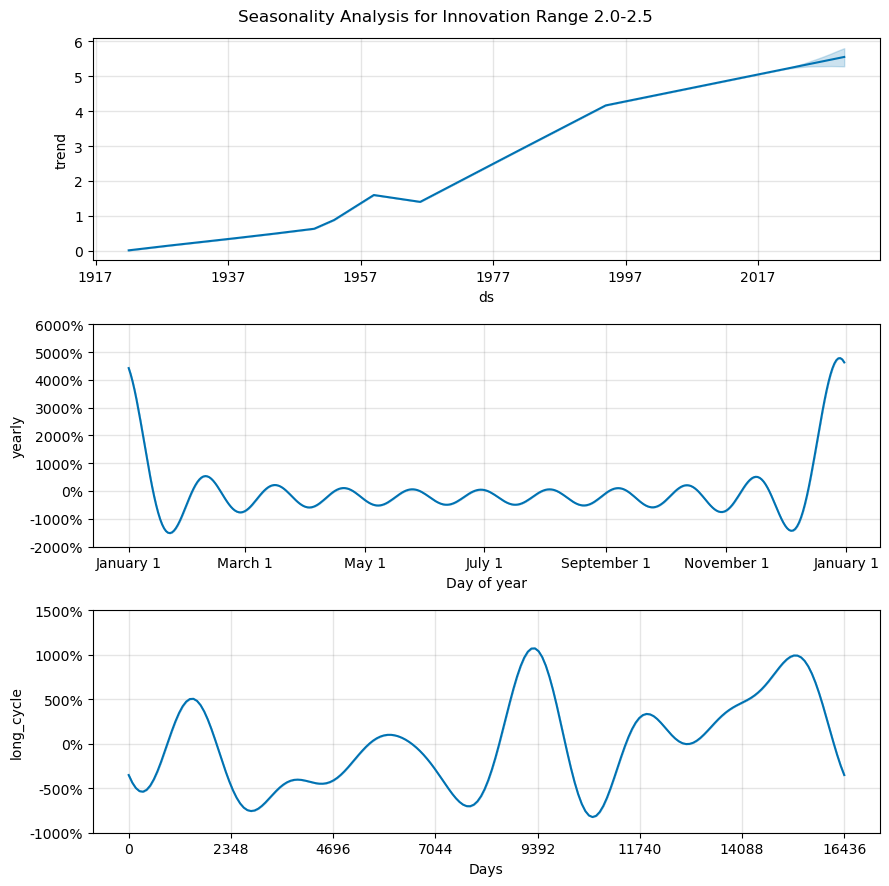

<Figure size 1200x600 with 0 Axes>

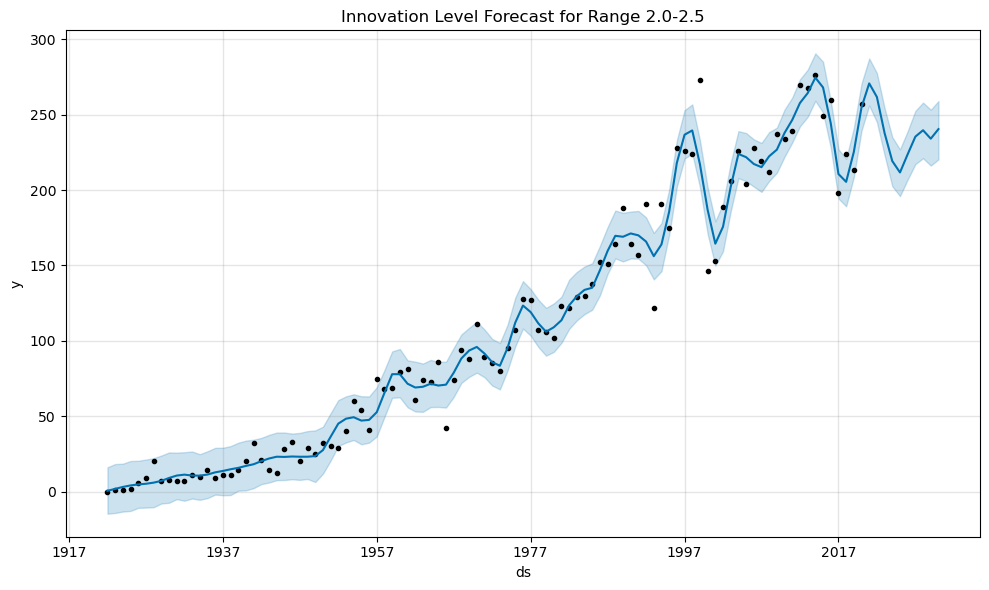

22:16:04 - cmdstanpy - INFO - Chain [1] start processing
22:16:06 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

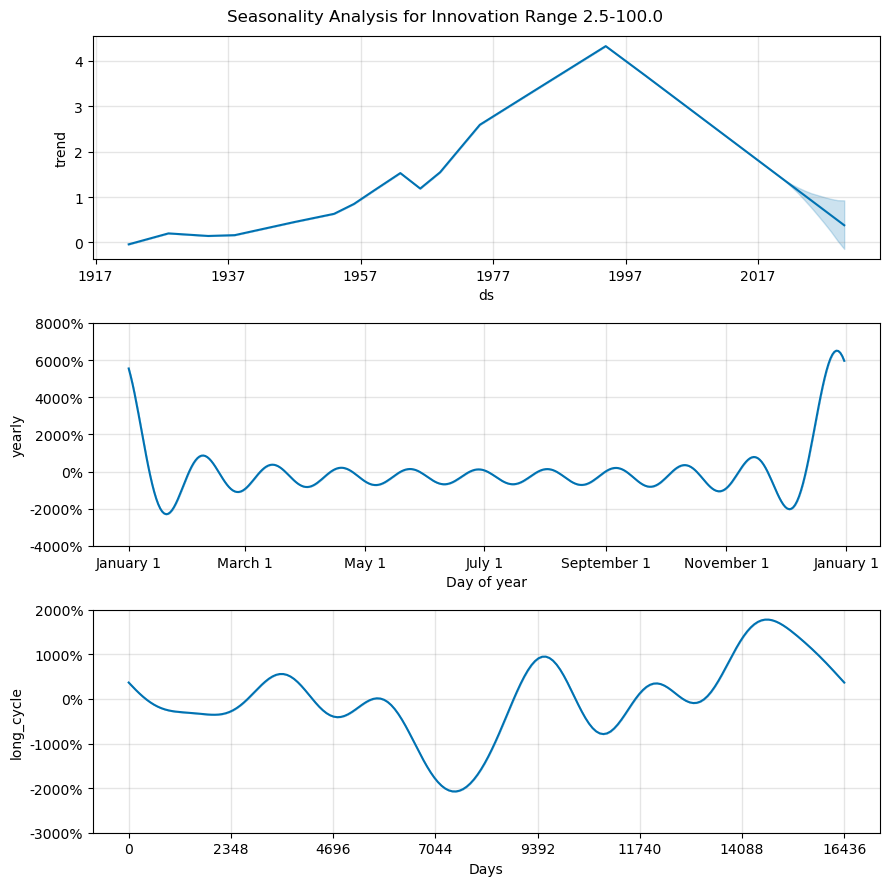

<Figure size 1200x600 with 0 Axes>

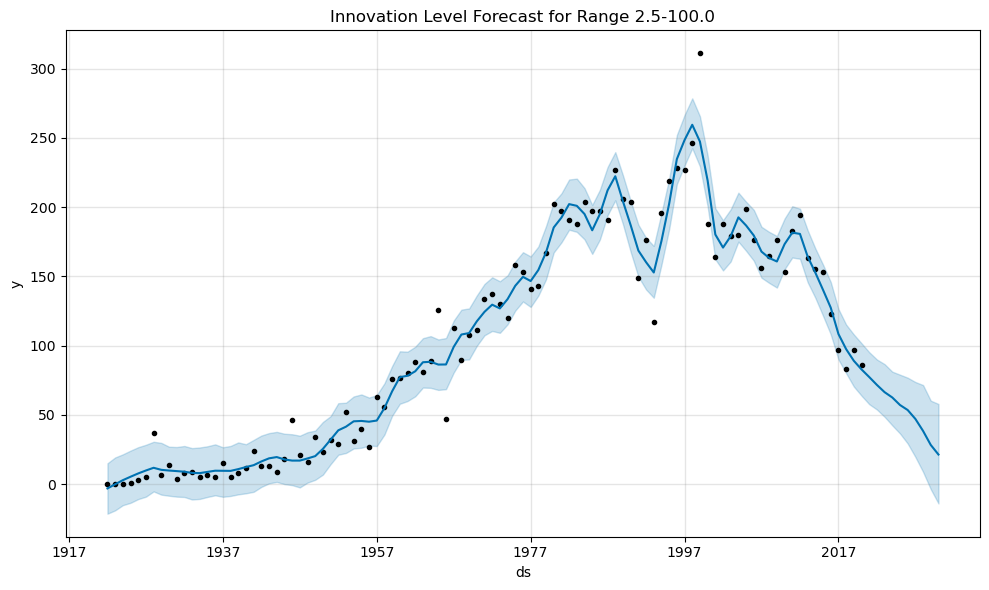

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10,cycle_years=45):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0    # Emphasize seasonal patterns
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=cycle_years*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast
        plt.figure(figsize=(12, 6))
        model.plot(forecast)
        plt.title(f'Innovation Level Forecast for Range {range_name}')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0,1,1.5,2,2.5,100],
    forecast_years=10
)

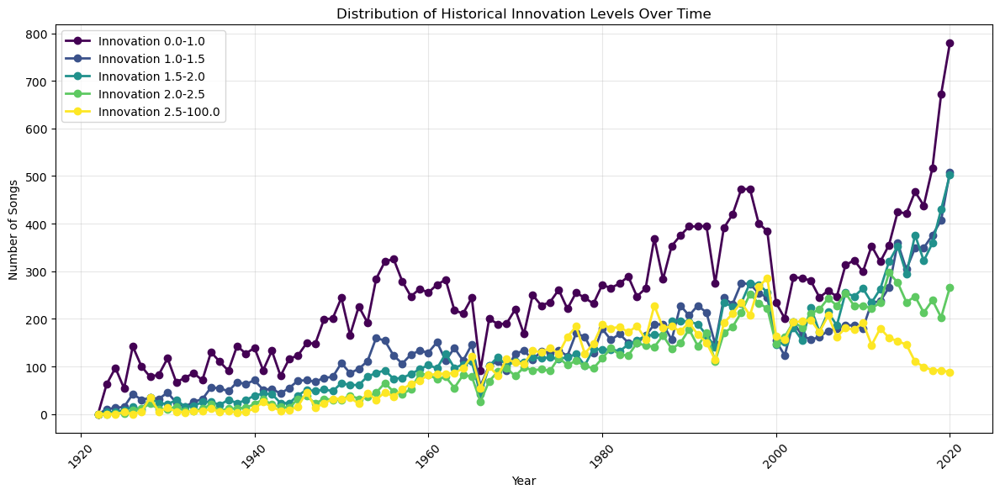

22:16:34 - cmdstanpy - INFO - Chain [1] start processing
22:16:35 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

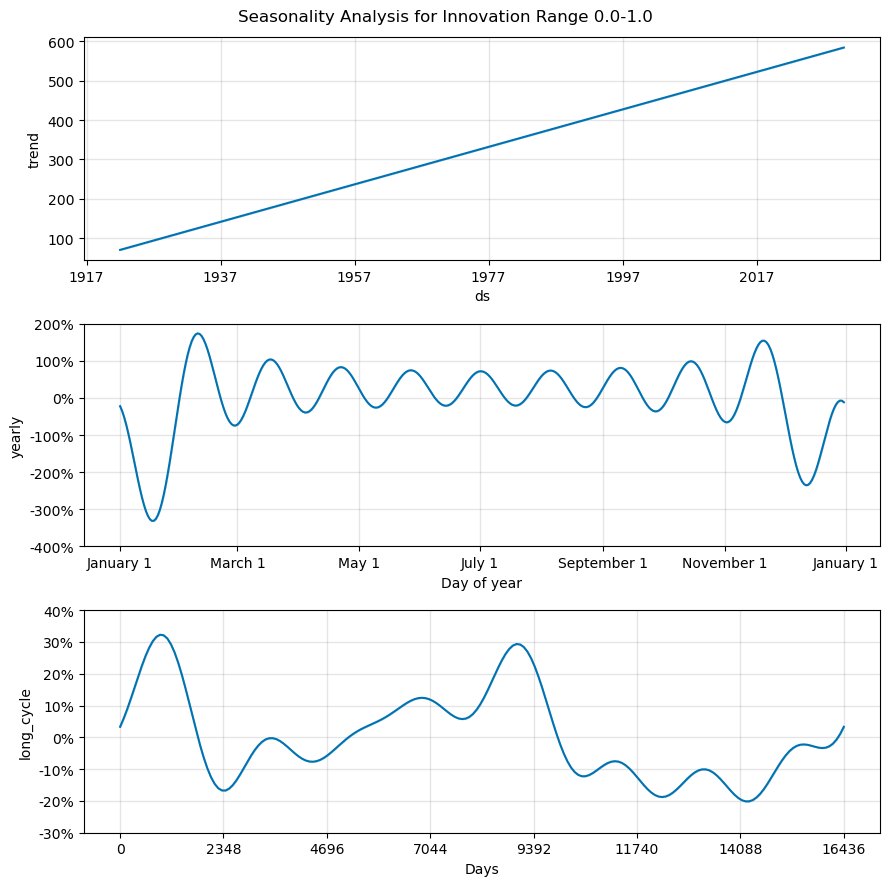

<Figure size 1200x600 with 0 Axes>

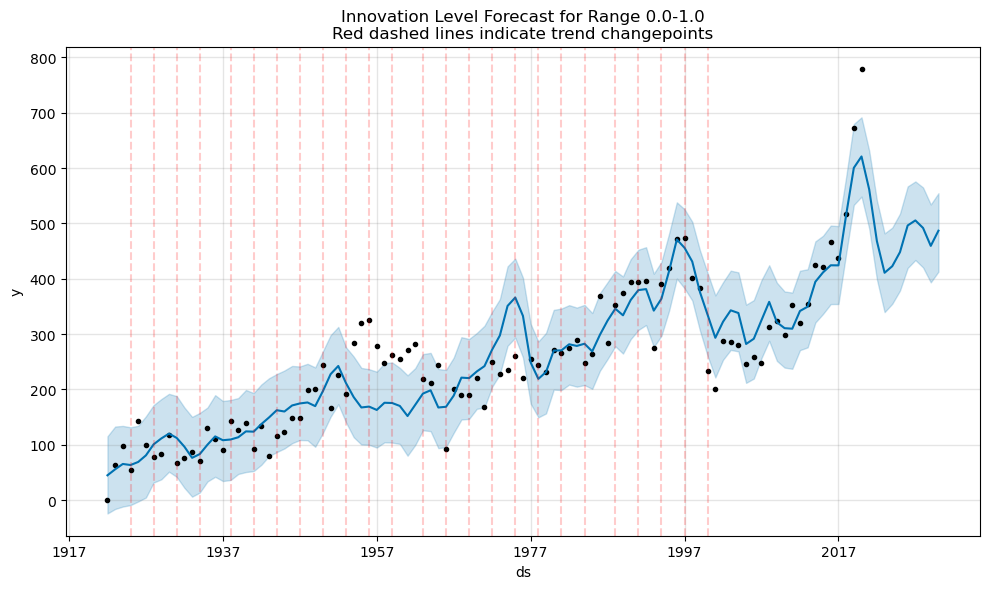

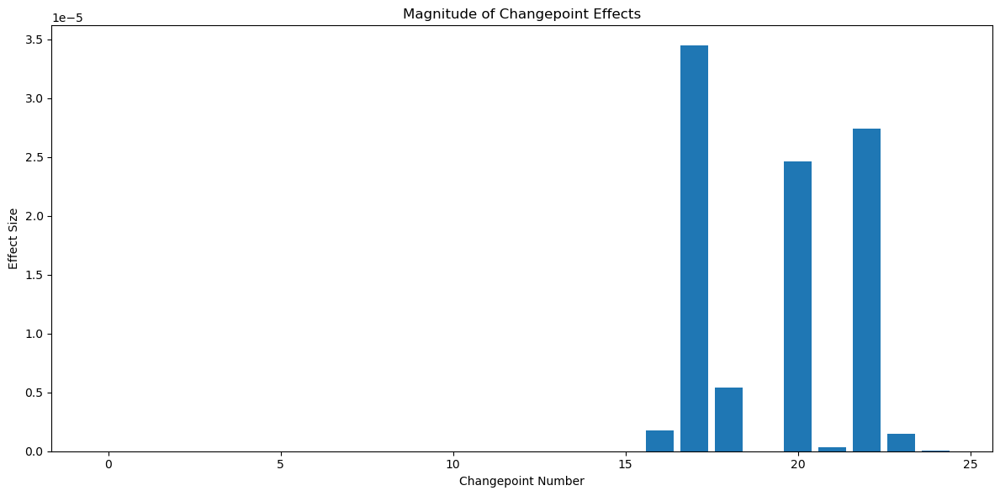

22:16:36 - cmdstanpy - INFO - Chain [1] start processing
22:16:37 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

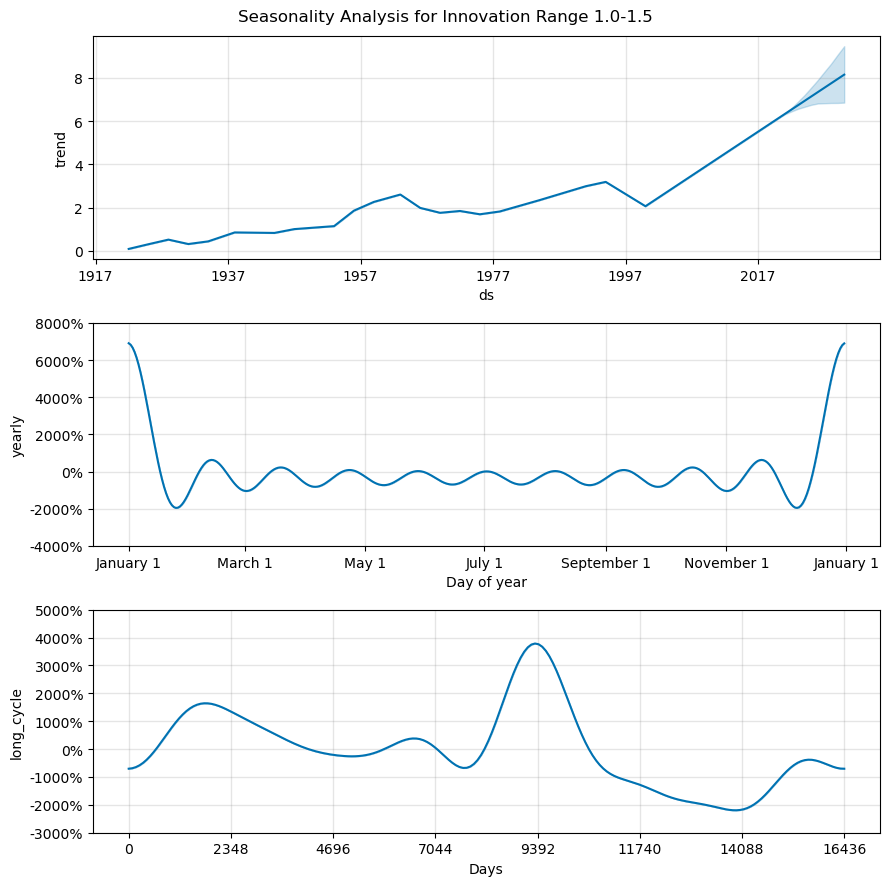

<Figure size 1200x600 with 0 Axes>

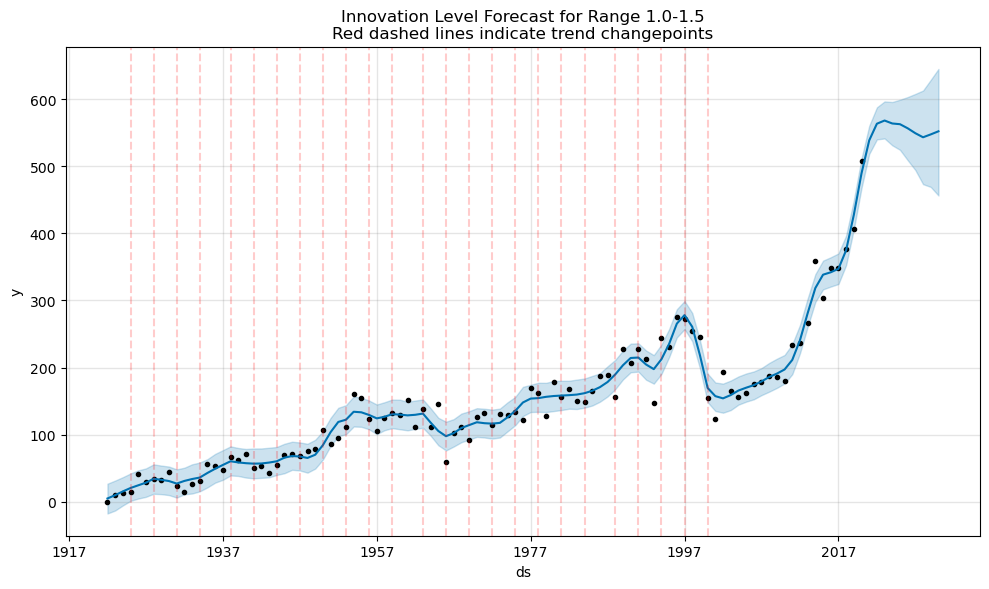

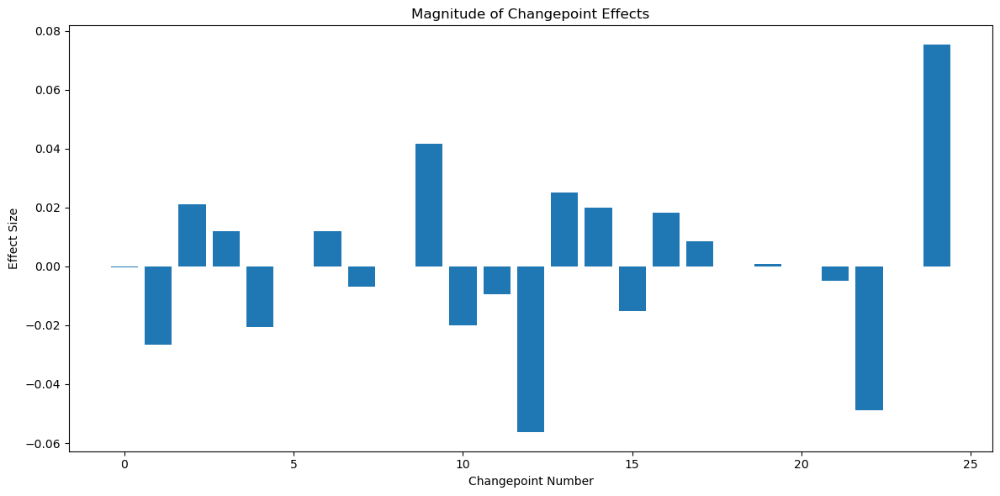

22:16:38 - cmdstanpy - INFO - Chain [1] start processing
22:16:40 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

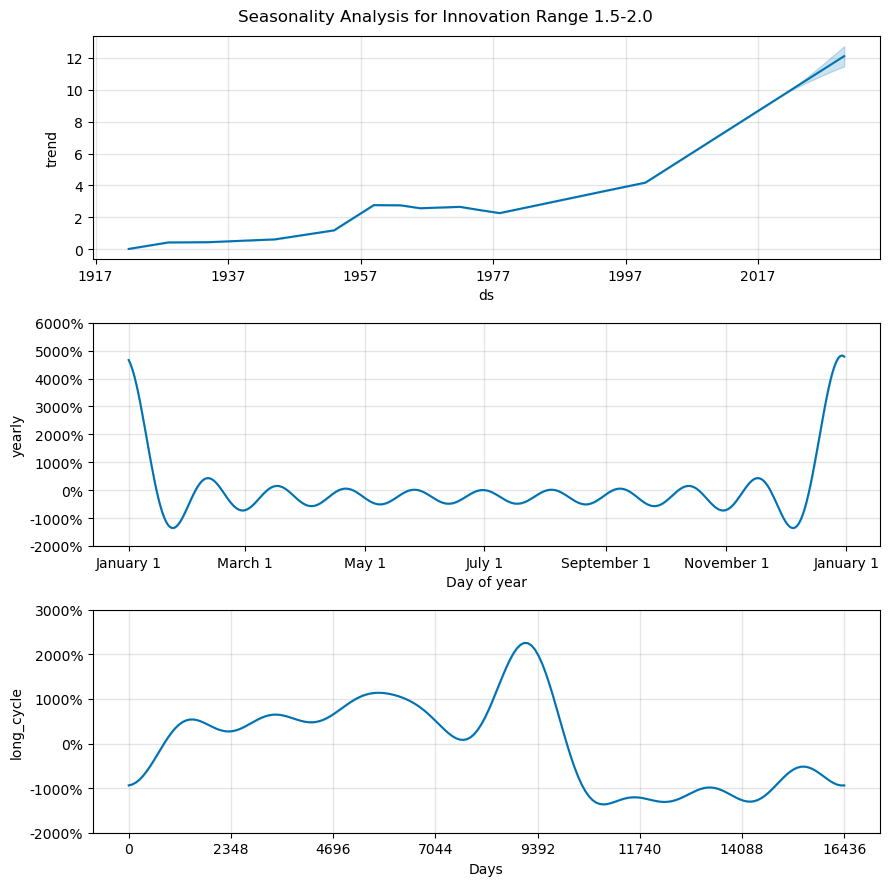

<Figure size 1200x600 with 0 Axes>

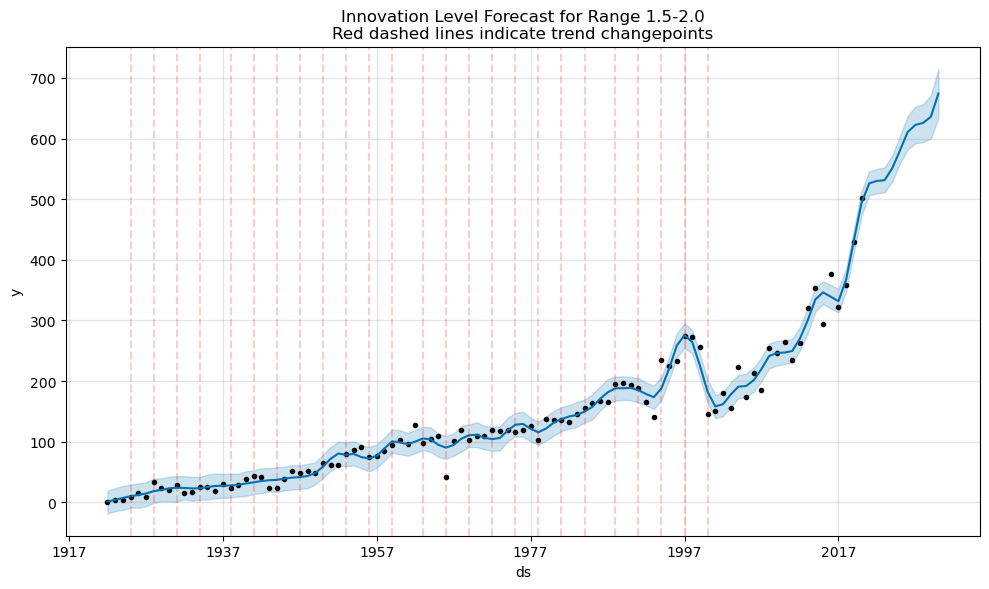

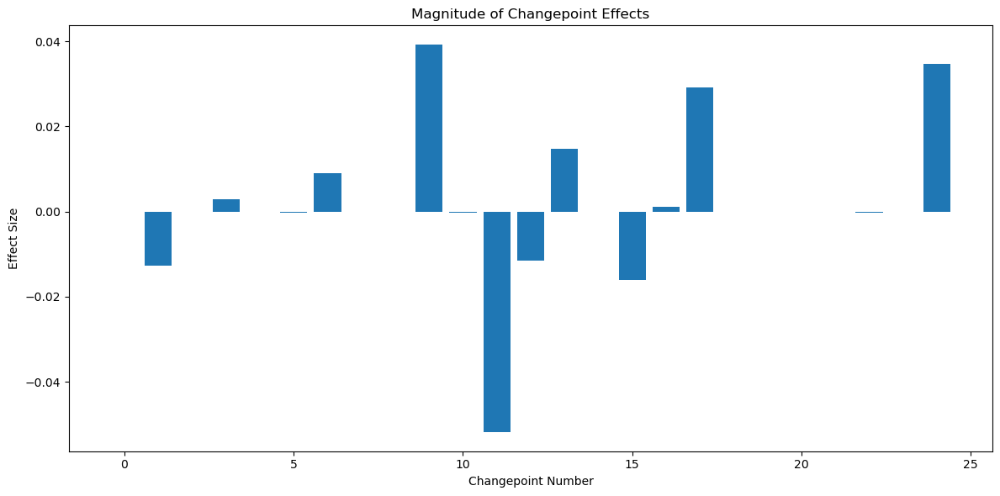

22:16:41 - cmdstanpy - INFO - Chain [1] start processing
22:16:43 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

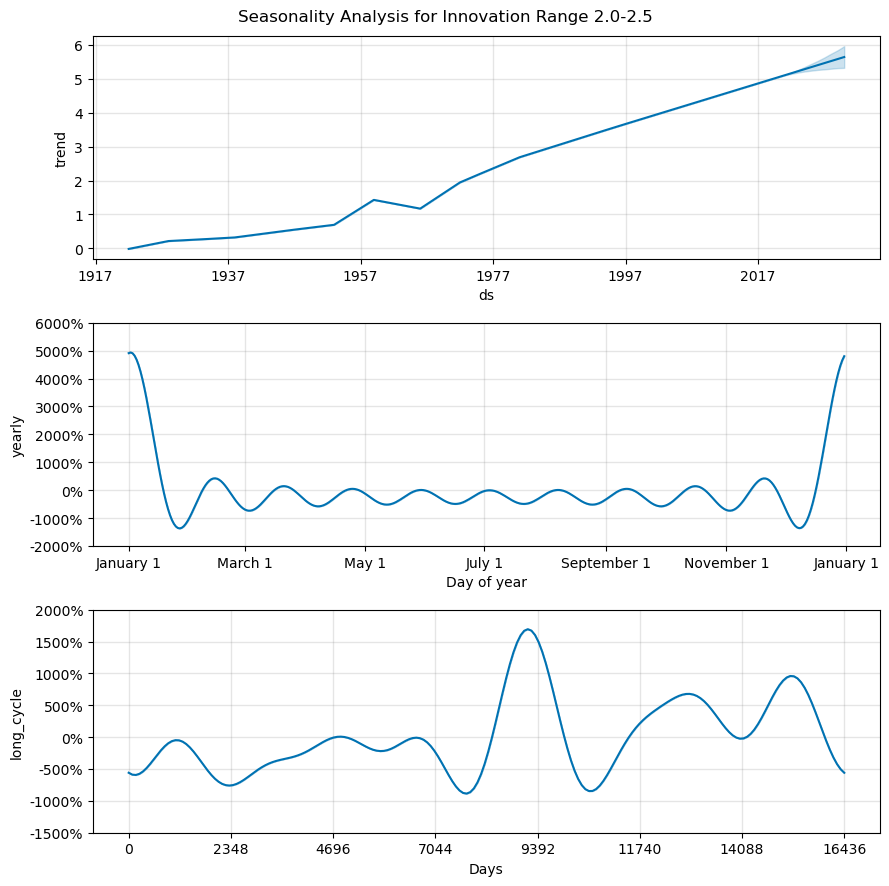

<Figure size 1200x600 with 0 Axes>

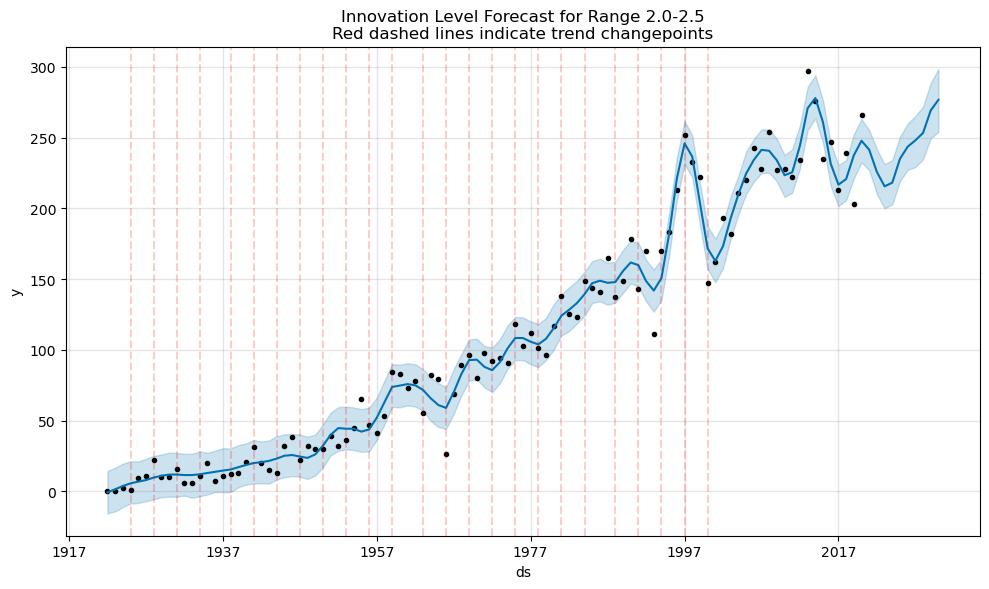

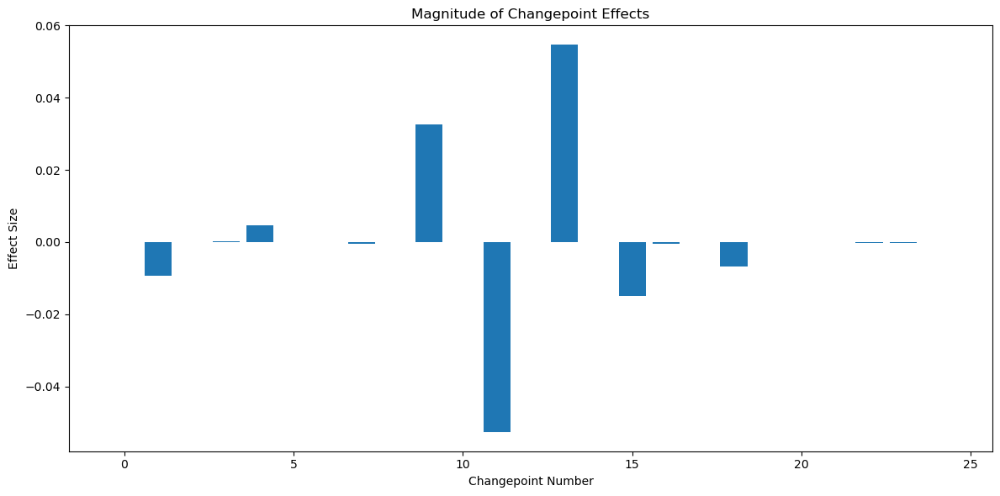

22:16:44 - cmdstanpy - INFO - Chain [1] start processing
22:16:45 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

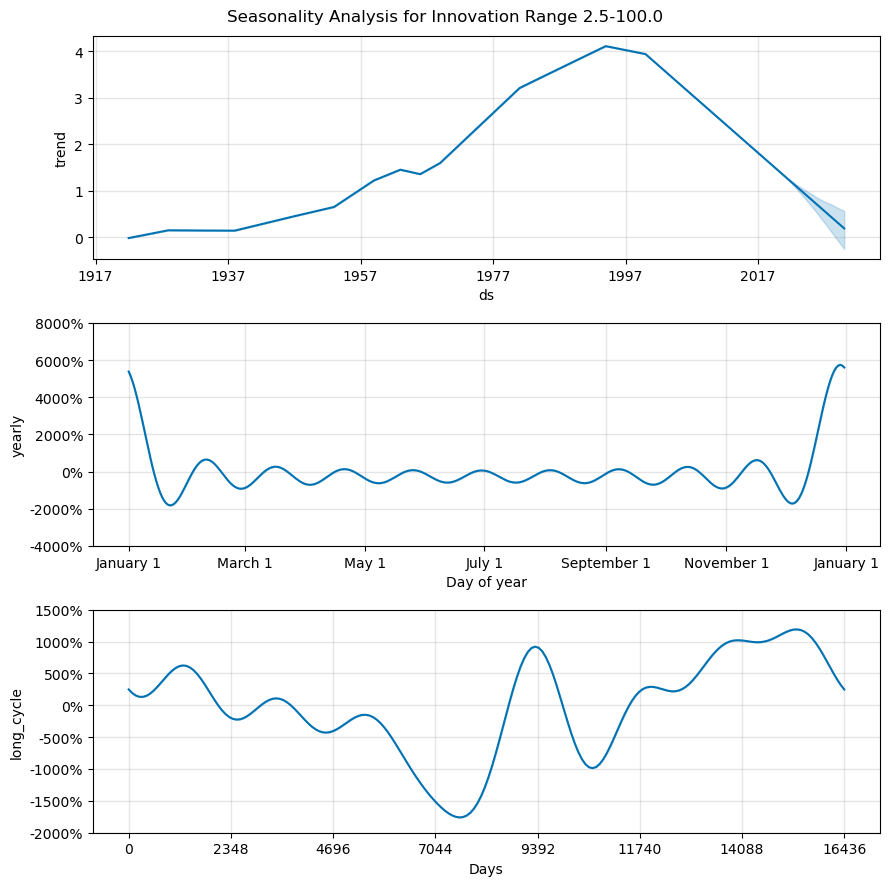

<Figure size 1200x600 with 0 Axes>

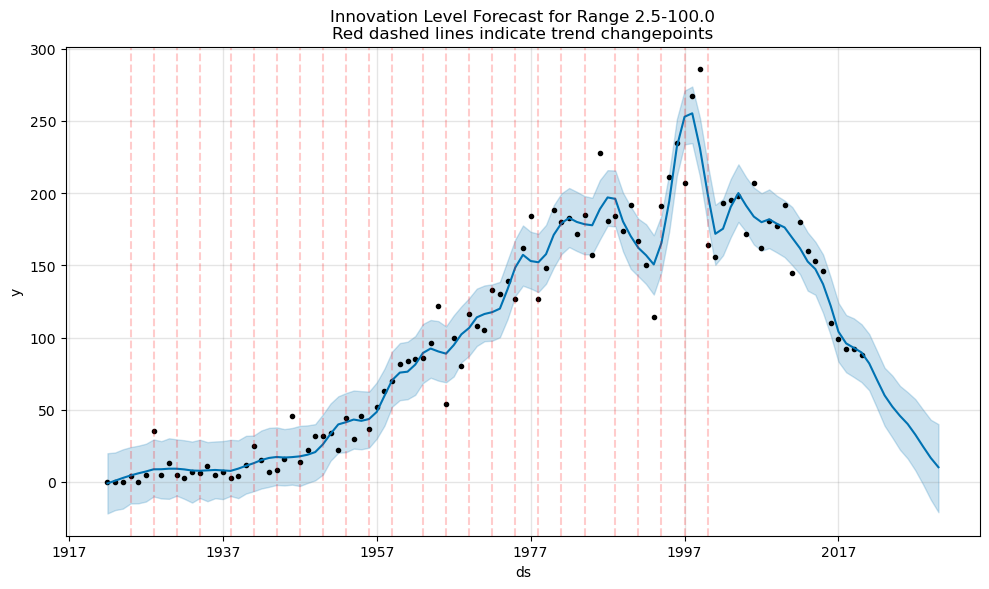

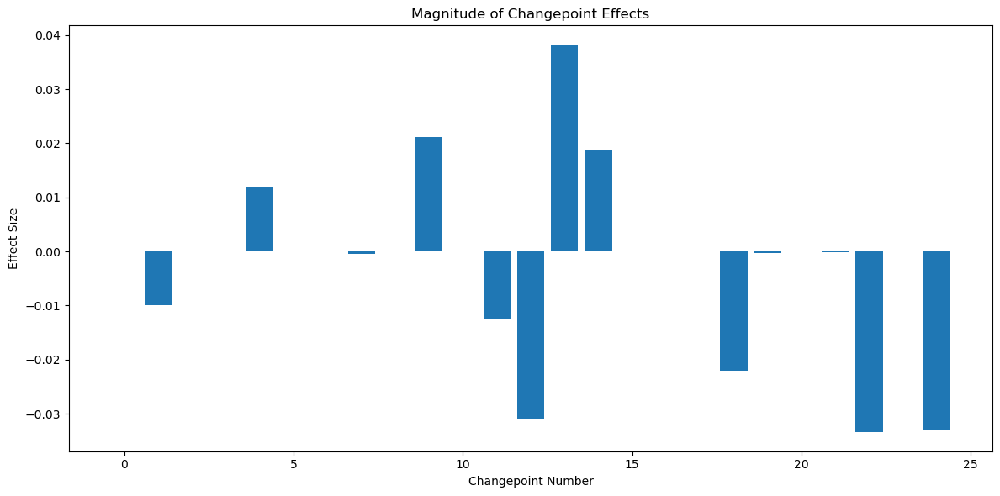

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10,cycle_years=45):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0,    # Emphasize seasonal patterns
            n_changepoints=25  # Increase number of changepoints
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=cycle_years*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast with changepoints
        plt.figure(figsize=(12, 6))
        fig = model.plot(forecast)
        
        # Add vertical lines for changepoints
        ax = fig.gca()
        for cp in model.changepoints:
            ax.axvline(x=cp, color='r', alpha=0.2, linestyle='--')
            
        plt.title(f'Innovation Level Forecast for Range {range_name}\nRed dashed lines indicate trend changepoints')
        plt.tight_layout()
        plt.show()
        
        # Plot changepoint effects
        deltas = model.params['delta'].mean(0)
        fig = plt.figure(figsize=(12, 6))
        ax = fig.add_subplot(111)
        ax.bar(range(len(deltas)), deltas)
        ax.set_title('Magnitude of Changepoint Effects')
        ax.set_xlabel('Changepoint Number')
        ax.set_ylabel('Effect Size')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0,1,1.5,2,2.5,100],
    forecast_years=10
)

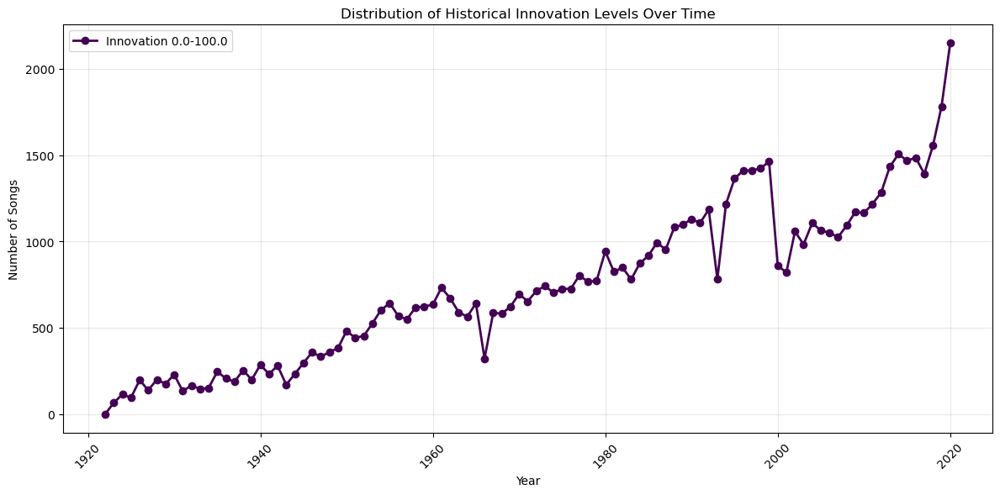

22:19:56 - cmdstanpy - INFO - Chain [1] start processing
22:19:57 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

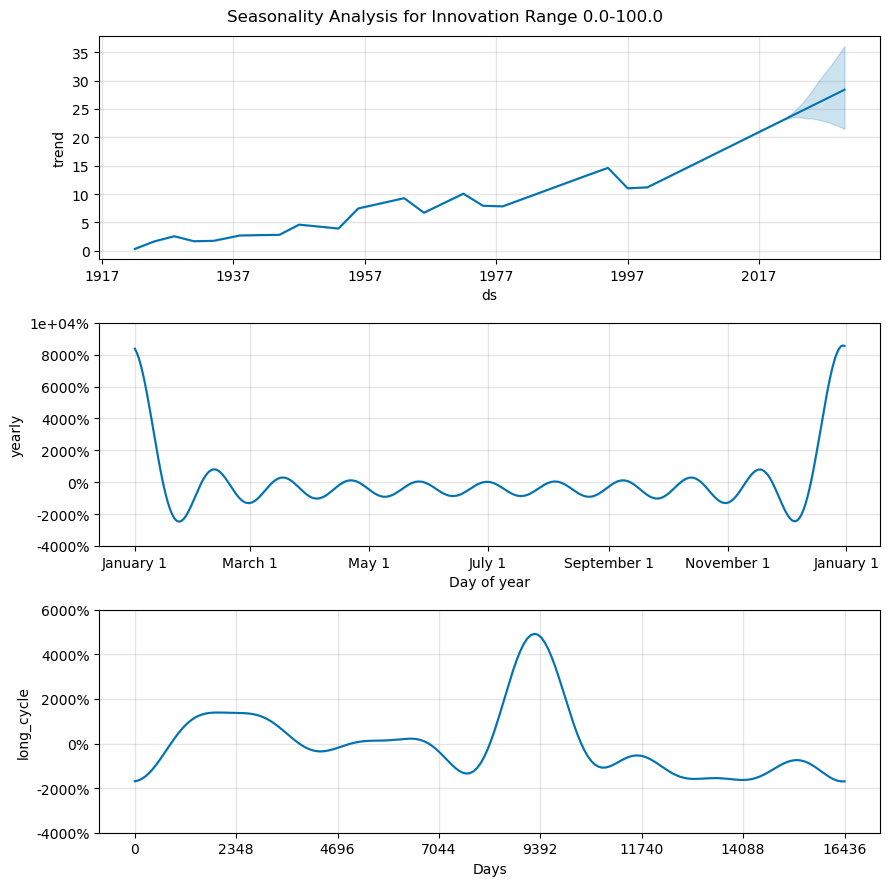

<Figure size 1200x600 with 0 Axes>

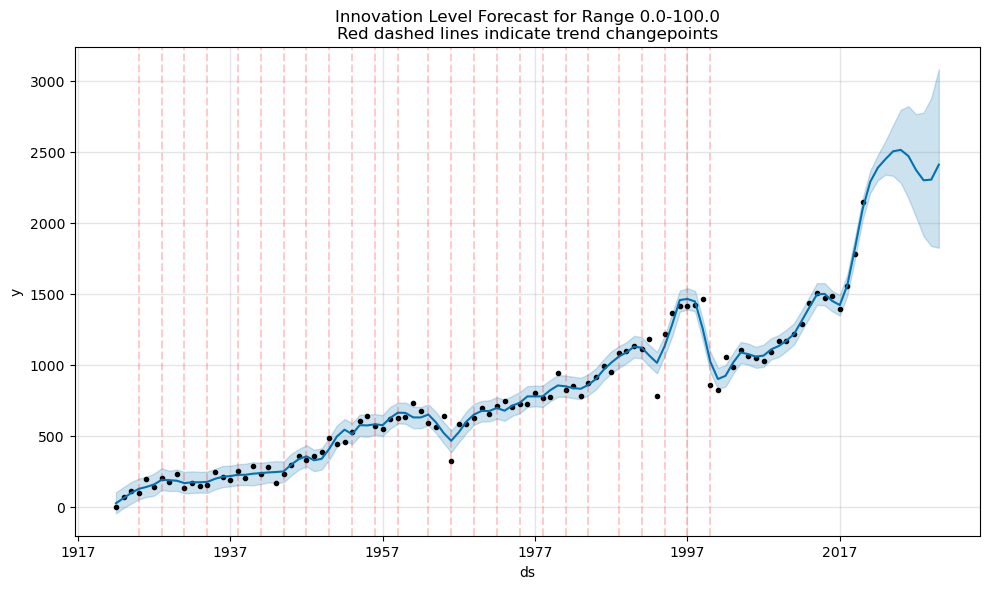

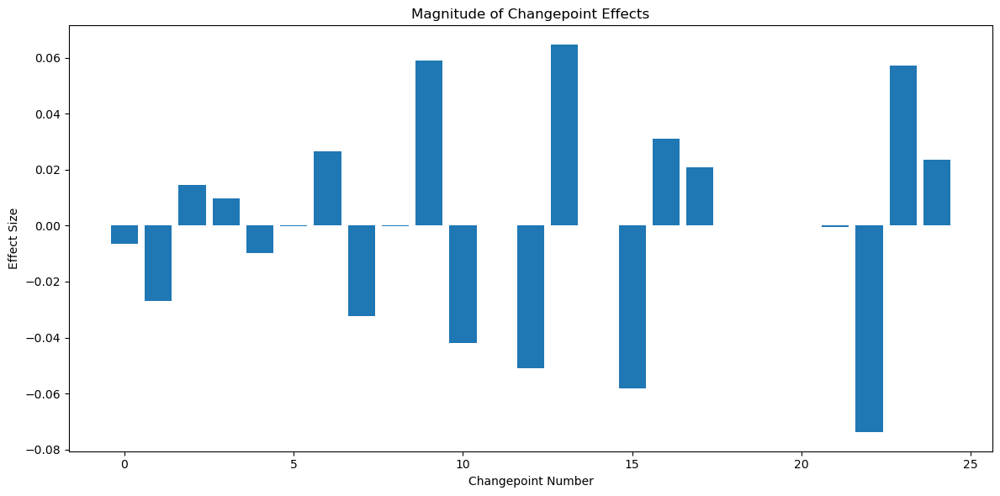

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10,cycle_years=45):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    # Save the time series data
    filename = f'innovation_timeseries_{distance_type}.csv'
    if artist_name:
        filename = f'innovation_timeseries_{artist_name}_{distance_type}.csv'
    results_df.to_csv(filename)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0,    # Emphasize seasonal patterns
            n_changepoints=25  # Increase number of changepoints
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=cycle_years*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast with changepoints
        plt.figure(figsize=(12, 6))
        fig = model.plot(forecast)
        
        # Add vertical lines for changepoints
        ax = fig.gca()
        for cp in model.changepoints:
            ax.axvline(x=cp, color='r', alpha=0.2, linestyle='--')
            
        plt.title(f'Innovation Level Forecast for Range {range_name}\nRed dashed lines indicate trend changepoints')
        plt.tight_layout()
        plt.show()
        
        # Plot changepoint effects
        deltas = model.params['delta'].mean(0)
        fig = plt.figure(figsize=(12, 6))
        ax = fig.add_subplot(111)
        ax.bar(range(len(deltas)), deltas)
        ax.set_title('Magnitude of Changepoint Effects')
        ax.set_xlabel('Changepoint Number')
        ax.set_ylabel('Effect Size')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0,100],
    forecast_years=10
)

In [ ]:
#%% innovation level, date、

def plot_innovation_levels_over_time(cluster_data, artist_name=None, sample_size=0.1, seed=None, 
                                   bins=[0, 1, 2, 3, 4], distance_type='historical'):
    """
    Plot the number of songs in different innovation level ranges over time with daily granularity
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges (default: [0, 1, 2, 3, 4])
        distance_type: Type of distance to calculate ('historical' or 'internal')
        
    Returns:
        DataFrame containing innovation counts by date and range
    """
    # Extract data
    num_clusters, colors, cluster_data = exact_to_pd(cluster_data, artist_name, sample_size, seed)
    
    # Convert release_date to datetime and filter date range
    cluster_data['date'] = pd.to_datetime(cluster_data['release_date'])
    cluster_data = cluster_data[
        (cluster_data['date'].dt.year >= 1920) & 
        (cluster_data['date'].dt.year <= 2020)
    ]
    
    # Process data day by day
    dates = sorted(cluster_data['date'].unique())
    historical_centroid = None
    
    # Store innovation levels for each date
    innovation_by_date = {date: [] for date in dates}
    
    for date in dates:
        date_data = cluster_data[cluster_data['date'] == date]
        if not date_data.empty:
            current_points = np.array([
                [float(features[0]), float(features[1])] 
                for features in date_data['features']
            ])
            current_centroid = current_points.mean(axis=0)
            
            if distance_type == 'historical':
                if historical_centroid is not None:
                    distances = np.sqrt(
                        np.sum((current_points - historical_centroid) ** 2, axis=1)
                    )
                    innovation_by_date[date].extend(distances)
                
                # Update historical centroid using all data up to current date
                if historical_centroid is None:
                    historical_centroid = current_centroid
                else:
                    historical_data = cluster_data[cluster_data['date'] <= date]
                    historical_points = np.array([
                        [float(features[0]), float(features[1])] 
                        for features in historical_data['features']
                    ])
                    historical_centroid = historical_points.mean(axis=0)
            
            else:  # internal distance
                distances = np.sqrt(
                    np.sum((current_points - current_centroid) ** 2, axis=1)
                )
                innovation_by_date[date].extend(distances)
    
    # Create figure
    plt.figure(figsize=(15, 8))
    
    # Calculate counts for each bin range
    bin_ranges = list(zip(bins[:-1], bins[1:]))
    counts_by_range = {f"{low:.1f}-{high:.1f}": [] for low, high in bin_ranges}
    
    for date in dates:
        date_innovations = innovation_by_date[date]
        if date_innovations:
            for (low, high) in bin_ranges:
                count = sum((low <= x < high) for x in date_innovations)
                counts_by_range[f"{low:.1f}-{high:.1f}"].append(count)
        else:
            for range_key in counts_by_range:
                counts_by_range[range_key].append(0)
    
    # Plot lines for each range with daily data
    colors = plt.cm.viridis(np.linspace(0, 1, len(bin_ranges)))
    for (range_key, counts), color in zip(counts_by_range.items(), colors):
        # Use scatter for daily points and line for trend
        plt.scatter(dates, counts, s=20, alpha=0.3, color=color)
        
        # Add trend line using rolling average
        df_temp = pd.DataFrame({'date': dates, 'count': counts})
        df_temp.set_index('date', inplace=True)
        rolling_mean = df_temp['count'].rolling(window='30D').mean()
        plt.plot(dates, rolling_mean, '-', 
                label=f'Innovation {range_key} (30-day avg)', 
                color=color, linewidth=2)
    
    plt.xlabel('Date')
    plt.ylabel('Number of Songs')
    title = f"Distribution of {'Historical' if distance_type == 'historical' else 'Internal'} Innovation Levels Over Time"
    if artist_name:
        title = f"{artist_name}: {title}"
    plt.title(title)
    plt.legend()
    plt.grid(True, alpha=0.3)
    
    # Format x-axis to show dates nicely
    plt.gcf().autofmt_xdate()
    
    plt.tight_layout()
    plt.show()
    
    # Create and return DataFrame with results
    results_df = pd.DataFrame(counts_by_range, index=dates)
    results_df.index.name = 'Date'
    results_df['raw_innovation_values'] = [innovation_by_date[date] for date in dates]
    
    return results_df

# Example usage:
# Historical distance with daily granularity
results_df = plot_innovation_levels_over_time(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0, 1, 1.5, 2, 2.5, 100]
)

# Internal distance with daily granularity
plot_innovation_levels_over_time(
    cluster_results, 
    distance_type='internal',
    sample_size=0.3,
    bins=[0, 1, 1.5, 2, 2.5, 100]
)

KeyboardInterrupt: 

In [ ]:
# %% Load data and packages

from pyspark import SparkContext, SparkConf
from pyspark.sql import SparkSession, Row
from pyspark.ml.linalg import Vectors
from pyspark.ml.feature import StandardScaler, PCA
from pyspark.ml.clustering import KMeans
from pyspark.ml.evaluation import ClusteringEvaluator
from pyspark.mllib.feature import StandardScaler as StandardScalerRDD
from pyspark.mllib.linalg.distributed import RowMatrix
import pyspark.sql.functions as F
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.animation as animation
from prophet import Prophet


spark = SparkSession \
        .builder \
        .appName("dr_cluster") \
        .getOrCreate()

# Read Spotify data
df = spark.read.csv('/home/mikezhu/music/data/spotify_dataset.csv', header=True)


# Note potentially relevant features like danceability, energy, acousticness, etc.
df.columns

24/11/23 22:27:40 WARN SparkSession: Using an existing Spark session; only runtime SQL configurations will take effect.


['id',
 'name',
 'popularity',
 'duration_ms',
 'explicit',
 'release_date',
 'danceability',
 'energy',
 'key',
 'loudness',
 'mode',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',
 'valence',
 'tempo',
 'time_signature',
 'artist']

In [ ]:
# %% column names

'''
['id',
 'name',
 'popularity',
 'duration_ms',
 'explicit', #ignore
 'release_date',
 'danceability',
 'energy',
 'key',
 'loudness',
 'mode',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',#ignore
 'valence',
 'tempo',
 'time_signature',
 'artist']
 '''

"\n['id',\n 'name',\n 'popularity',\n 'duration_ms',\n 'explicit', #ignore\n 'release_date',\n 'danceability',\n 'energy',\n 'key',\n 'loudness',\n 'mode',\n 'speechiness',\n 'acousticness',\n 'instrumentalness',\n 'liveness',#ignore\n 'valence',\n 'tempo',\n 'time_signature',\n 'artist']\n "

In [ ]:
# %% Data preprocessing

# identify potentially relevant features and add to a feature dataframe
feature_cols = [
    #'explicit',
    #'liveness',
    'duration_ms',
    'loudness',
    'key',
    'tempo', 
    'time_signature',
    'mode',
    'acousticness', 
    'instrumentalness',  
    'speechiness',
    'danceability', 
    'energy',
    'valence'
    ]

# select feature columns and numeric data as floats
df_features = df.select(*(F.col(c).cast("float").alias(c) for c in feature_cols),'id','name', 'artist') \
                         .dropna()
df_features = df_features.withColumn('features', F.array(*[F.col(c) for c in feature_cols])) \
                         .select('id','name', 'artist', 'features')

# convert features to dense vector format (expected by K-Means, PCA)
vectors = df_features.rdd.map(lambda row: Vectors.dense(row.features))
features = spark.createDataFrame(vectors.map(Row), ["features_unscaled"])

# scale features (some values like duration_ms are much larger than others)
standardizer = StandardScaler(inputCol="features_unscaled", outputCol="features")
model = standardizer.fit(features)
features = model.transform(features) \
                .select('features')

# persist in memory before fit model
features.persist()
features.printSchema()

root
 |-- features: vector (nullable = true)



In [ ]:
# %% K-means and PCA visualization functions

# try different numbers of clusters to find optimal k
def find_optimal_kmeans(features, k_values=range(3, 5)):
    """
    Find optimal k for KMeans clustering using silhouette scores
    
    Args:
        features: DataFrame with feature vectors
        k_values: Range of k values to try
        
    Returns:
        optimal_k: Optimal number of clusters
        kmeans_predictions: Predictions using optimal k
        silhouettes: List of silhouette scores for each k
    """
    silhouettes = []
    
    for k in k_values:
        # train model
        kmeans = KMeans(k=k, seed=1)
        model = kmeans.fit(features)
        
        # make predictions
        predictions = model.transform(features)
        
        # evaluate clustering
        evaluator = ClusteringEvaluator()
        silhouette = evaluator.evaluate(predictions)
        silhouettes.append(silhouette)
        print(f"Silhouette score for k={k}: {silhouette}")

    # Plot silhouette scores
    plt.figure(figsize=(10, 6))
    plt.plot(k_values, silhouettes, 'bo-')
    plt.xlabel('Number of Clusters (k)')
    plt.ylabel('Silhouette Score')
    plt.title('Silhouette Score vs Number of Clusters')
    plt.grid(True)
    
    # Add value labels on the points
    for k, silhouette in zip(k_values, silhouettes):
        plt.annotate(f'{silhouette:.3f}', 
                    (k, silhouette), 
                    textcoords="offset points", 
                    xytext=(0,10),
                    ha='center')
    
    plt.show()

    # find optimal k
    optimal_k = k_values[silhouettes.index(max(silhouettes))]
    print(f"\nOptimal number of clusters (k) = {optimal_k}")
    print(f"Best silhouette score = {max(silhouettes)}")
    
    # train final model with optimal k
    kmeans = KMeans(k=optimal_k, seed=1)
    kmeans_model = kmeans.fit(features)
    optimal_predictions = kmeans_model.transform(features)
    
    return optimal_k, optimal_predictions, silhouettes

def analyze_pca_composition(model_pca, feature_cols):
    """
    Analyze and visualize the composition of a trained PCA model using heatmap
    
    Args:
        model_pca: Trained PCA model
        feature_cols: List of original feature names
    """
    # Get principal components matrix
    pc_matrix = model_pca.pc.toArray()
    n_components = pc_matrix.shape[1]
    
    # Create DataFrame with component compositions
    components_df = pd.DataFrame(
        pc_matrix,
        columns=[f'PC{i}' for i in range(n_components)],
        index=feature_cols
    )
    
    # Plot heatmap
    plt.figure(figsize=(6, 8))
    im = plt.imshow(components_df, cmap='RdBu', aspect='auto')
    plt.colorbar(im, label='Component Weight')
    
    # Add value annotations
    for i in range(len(feature_cols)):
        for j in range(n_components):
            plt.text(j, i, f'{components_df.iloc[i, j]:.2f}',
                    ha='center', va='center')
    
    # Customize plot
    plt.xticks(range(n_components), components_df.columns)
    plt.yticks(range(len(feature_cols)), feature_cols)
    plt.title('PCA Components Composition')
    plt.xlabel('Principal Components')
    plt.ylabel('Original Features')
    
    plt.tight_layout()
    plt.show()
    
    return components_df

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


24/11/23 22:27:57 WARN LAPACK: Failed to load implementation from: com.github.fommil.netlib.NativeSystemLAPACK
24/11/23 22:27:57 WARN LAPACK: Failed to load implementation from: com.github.fommil.netlib.NativeRefLAPACK
Component 1 explained variance: 0.2370
Cumulative explained variance: 0.2370
Component 2 explained variance: 0.2246
Cumulative explained variance: 0.4616
Component 3 explained variance: 0.1010
Cumulative explained variance: 0.5626
Component 4 explained variance: 0.0838
Cumulative explained variance: 0.6463
Component 5 explained variance: 0.0818
Cumulative explained variance: 0.7281
Component 6 explained variance: 0.0715
Cumulative explained variance: 0.7996
Component 7 explained variance: 0.0641
Cumulative explained variance: 0.8637
Component 8 explained variance: 0.0599
Cumulative explained variance: 0.9236
Component 9 explained variance: 0.0337
Cumulative explained variance: 0.9572
Component 10 explained variance: 0.0269
Cumulative explained variance: 0.9841
Component 

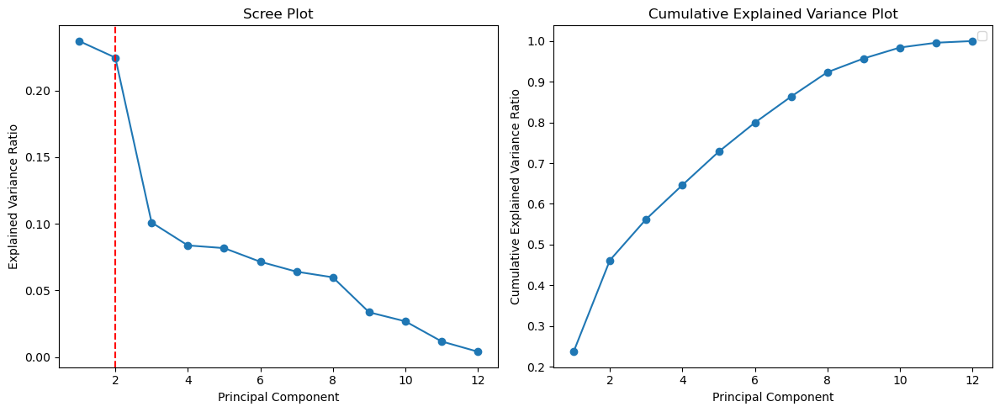

Optimal number of components: 2


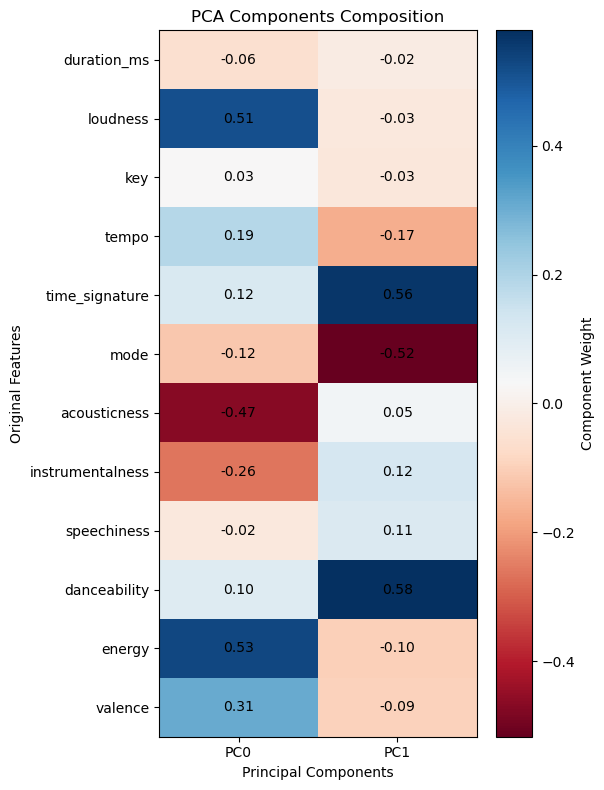

Silhouette score for k=3: 0.3628514767537176


Silhouette score for k=4: 0.6732810708951354


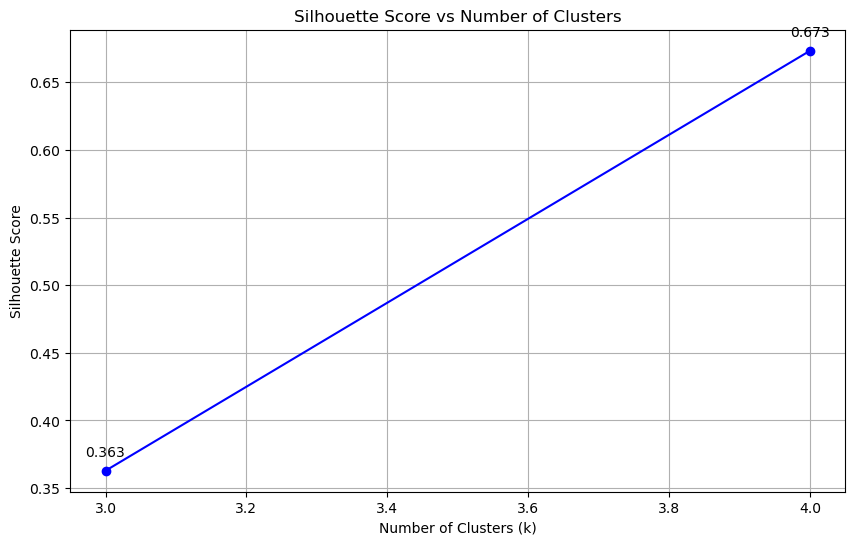


Optimal number of clusters (k) = 4
Best silhouette score = 0.6732810708951354


In [ ]:
# %% PCA-KMeans

def find_optimal_pca_components(features,threshold=0.9,k=None):
    """
    Find optimal number of PCA components by analyzing explained variance
    
    Args:
        features: DataFrame with feature vectors
        feature_cols: List of feature column names
        
    Returns:
        explained_variances: Array of explained variance ratios
        cumulative_variance: Array of cumulative explained variance ratios
    """
    n_features = features.first()["features"].size
    pca = PCA(k=n_features, inputCol="features", outputCol="pcaFeatures") 
    model = pca.fit(features)

    explained_variances = model.explainedVariance
    cumulative_variance = [sum(explained_variances[:i+1]) for i in range(len(explained_variances))]

    # Print variance explained by each component
    for i, var in enumerate(explained_variances):
        print(f"Component {i+1} explained variance: {var:.4f}")
        print(f"Cumulative explained variance: {cumulative_variance[i]:.4f}")

    # Find optimal number of components
    if k is None:
        optimal_n = next((i for i, cum_var in enumerate(cumulative_variance) if cum_var >= threshold), len(cumulative_variance))
    else:
        optimal_n = k

    # Plot explained variance analysis
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # Plot scree plot
    ax1.plot(range(1, len(explained_variances) + 1), explained_variances, marker='o')
    ax1.set_xlabel('Principal Component')
    ax1.set_ylabel('Explained Variance Ratio')
    ax1.set_title('Scree Plot')
    ax1.axvline(x=optimal_n, color='r', linestyle='--', label=f'Optimal number of components ({optimal_n})')

    # Plot cumulative variance
    ax2.plot(range(1, len(cumulative_variance) + 1), cumulative_variance, marker='o')
    # Add threshold line at 0.8
    if k is None:
        ax2.axhline(y=threshold, color='r', linestyle='--', label=f'Threshold ({threshold})')
    ax2.legend()
    ax2.set_xlabel('Principal Component')
    ax2.set_ylabel('Cumulative Explained Variance Ratio')
    ax2.set_title('Cumulative Explained Variance Plot')

    plt.tight_layout()
    plt.show()

    if k is None:
        print(f"Optimal number of components: {optimal_n}, threshold: {threshold}")
    else:
        print(f"Optimal number of components: {optimal_n}")

    # transform features according to optimal number of components
    pca = PCA(k=optimal_n, inputCol="features", outputCol="pcaFeatures") 
    model = pca.fit(features)

    pca_results = model.transform(features) \
                        .select('pcaFeatures')
    
    pca_features = pca_results.rdd.map(lambda row: Vectors.dense(row.pcaFeatures))
    pca_features = spark.createDataFrame(pca_features.map(Row), ["features"])

    return optimal_n, pca_features, explained_variances, cumulative_variance, model
# 1. PCA: find optimal number of components
optimal_n, features_pca, explained_variances, cumulative_variance, model_pca = find_optimal_pca_components(features,k=2)
components_df = analyze_pca_composition(model_pca, feature_cols)
# 2. KMeans: find optimal k, based on PCA-transformed features
features_pca.persist()
optimal_k_pca, kmeans_predictions_pca, silhouettes_pca = find_optimal_kmeans(features_pca)

In [ ]:
#%% merge cluster results

# merge to get cluster results
merged_results = kmeans_predictions_pca.withColumn("tmp_id", F.monotonically_increasing_id()) \
            .join(df_features.withColumn("tmp_id", F.monotonically_increasing_id()).withColumnRenamed("features", "raw_features"), on="tmp_id", how="inner").drop("tmp_id") \
            .join(df,on=["id","name","artist"],how="inner")
merged_results.show()
merged_results.count()
#examine cluster distribution
merged_results.groupby('prediction') \
               .count() \
               .show()
cluster_results=merged_results.filter(F.col("prediction") != 3)
cluster_results.groupby('prediction') \
               .count() \
               .show()

+--------------------+---------------------+--------------------+--------------------+----------+--------------------+----------+-----------+--------+------------+------------+------+---+--------+----+-----------+------------+----------------+--------+-------+-------+--------------+
|                  id|                 name|              artist|            features|prediction|        raw_features|popularity|duration_ms|explicit|release_date|danceability|energy|key|loudness|mode|speechiness|acousticness|instrumentalness|liveness|valence|  tempo|time_signature|
+--------------------+---------------------+--------------------+--------------------+----------+--------------------+----------+-----------+--------+------------+------------+------+---+--------+----+-----------+------------+----------------+--------+-------+-------+--------------+
|000KblXP5csWFFFsD...|               Podrás|       Tamara Castro|[0.83646507234205...|         2|[240013.0, -5.0, ...|        35|     240013|   fals

+----------+------+
|prediction| count|
+----------+------+
|         1|141078|
|         3|   969|
|         2|269051|
|         0|331126|
+----------+------+



+----------+------+
|prediction| count|
+----------+------+
|         1|141078|
|         2|269051|
|         0|331126|
+----------+------+



In [ ]:
#%% visualization functions

def exact_to_pd(cluster_full_data,artist_name=None,sample_size=0.1,seed=None):
    '''extract a subset of data, for visualization'''
    num_clusters = cluster_full_data.select('prediction').distinct().count()
    colors = plt.cm.Dark2(np.linspace(0, 1, num_clusters))
    if artist_name is None:
        if seed is None:
            cluster_data = cluster_full_data.sample(False, sample_size)  
        else:
            cluster_data = cluster_full_data.sample(False, sample_size, seed=seed)  
    else:
        cluster_data = cluster_full_data.filter(F.col("artist") == artist_name)
    cluster_data = cluster_data.toPandas()
    cluster_data['year'] = pd.to_datetime(cluster_data['release_date']).dt.year
    return num_clusters,colors,cluster_data

def plot_cluster_distribution(cluster_data,artist_name=None,sample_size=0.1,seed=None):
    """Plot distribution of songs across clusters"""
    num_clusters,colors,cluster_data=exact_to_pd(cluster_data,artist_name,sample_size,seed)
 
    all_clusters = pd.Series(0, index=range(num_clusters))
    cluster_counts = cluster_data['prediction'].value_counts()
    cluster_counts = cluster_counts.combine_first(all_clusters)
    cluster_counts = cluster_counts.sort_index()
    
    plt.figure(figsize=(10, 6))
    bars = plt.bar(cluster_counts.index, cluster_counts.values)
    for i, bar in enumerate(bars):
        bar.set_color(colors[i])
        
    plt.xlabel('Cluster')
    plt.ylabel('Number of Songs')
    plt.title(f'Distribution of Songs Across Clusters')
    plt.show()
    
    return cluster_counts

def plot_cluster_evolution(cluster_data, artist_name=None, sample_size=0.1, seed=None):
    """Plot evolution of clusters over time"""
    num_clusters, colors, cluster_data = exact_to_pd(cluster_data, artist_name, sample_size, seed)
    
    # Calculate proportion of each cluster per year
    yearly_proportions = cluster_data.pivot_table(
        index='year',
        columns='prediction',
        aggfunc='size',
        fill_value=0
    )
    yearly_proportions = yearly_proportions.div(yearly_proportions.sum(axis=1), axis=0)
    
    fig, ax = plt.subplots(figsize=(10, 6))
    
    # Plot each cluster separately to ensure correct color mapping
    bottom = np.zeros(len(yearly_proportions))
    for cluster in range(num_clusters):
        if cluster in yearly_proportions.columns:
            values = yearly_proportions[cluster].values
            ax.fill_between(yearly_proportions.index, bottom, bottom + values, 
                          alpha=0.7, label=f'Cluster {cluster}',
                          color=colors[cluster])
            bottom += values
    
    plt.xlabel('Year')
    plt.ylabel('Proportion of Songs')
    plt.title('Evolution of Song Clusters Over Time')
    plt.legend()
    plt.show()

def plot_cluster_scatter(cluster_data, artist_name=None, dim_1=0, dim_2=1,sample_size=0.1,seed=None):
    """Plot scatter of clusters in PCA space"""
    num_clusters, colors,cluster_data=exact_to_pd(cluster_data, artist_name,sample_size,seed)
    markers = ['o', 's', '^', 'v', 'D', 'p', 'h']
    plt.figure(figsize=(10, 8))
    for cluster in range(num_clusters):
        plot_data = cluster_data[cluster_data["prediction"] == cluster]
        plt.scatter(plot_data["features"].apply(lambda x: float(x[dim_1])),
                   plot_data["features"].apply(lambda x: float(x[dim_2])),
                   c=[colors[cluster]], 
                   marker=markers[cluster % len(markers)],
                   label=f'Cluster {cluster}',
                   s=100)
        for _, row in plot_data.iterrows():
            plt.annotate(row["name"], 
                        (float(row["features"][dim_1]), float(row["features"][dim_2])),
                    xytext=(5, 5),
                        textcoords='offset points',
                        bbox=dict(facecolor='white', edgecolor='none', alpha=0.7),
                        fontsize=8)
    plt.xlabel(f"Component {dim_1}")
    plt.ylabel(f"Component {dim_2}")
    plt.title("Songs Clustered in Dimensionally Reduced Space")
    plt.legend()
    plt.show()

def plot_cluster_radar(cluster_data, artist_name=None,sample_size=0.1,seed=None):
    """
    Create a radar plot to compare cluster centroids with standardized features
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
    """
    # Extract data and get number of clusters
    num_clusters, colors, cluster_data = exact_to_pd(cluster_data, artist_name,sample_size,seed)
    
    # Get feature values from the features column
    feature_values = pd.DataFrame(cluster_data['raw_features'].tolist(), 
                                columns=feature_cols)
    
    # Calculate global means and standard deviations for standardization
    global_means = feature_values[feature_cols].mean()
    global_stds = feature_values[feature_cols].std()
    
    # Standardize features
    standardized_values = feature_values.copy()
    for col in feature_cols:
        if global_stds[col] > 0:  # Avoid division by zero
            standardized_values[col] = (feature_values[col] - global_means[col]) / global_stds[col]
        else:
            standardized_values[col] = N
    
    # Add prediction column
    standardized_values['prediction'] = cluster_data['prediction']
    
    # Calculate mean values for each cluster using standardized features
    cluster_means = standardized_values.groupby('prediction')[feature_cols].mean()
    
    # Set up the angles for radar plot
    angles = np.linspace(0, 2*np.pi, len(feature_cols), endpoint=False)
    angles = np.concatenate((angles, [angles[0]]))  # Close the circle
    
    # Set up the plot
    fig, ax = plt.subplots(figsize=(10, 10), subplot_kw=dict(projection='polar'))
    
    # Plot data for each cluster
    for cluster in range(num_clusters):
        if cluster in cluster_means.index:
            values = cluster_means.loc[cluster].values
            values = np.concatenate((values, [values[0]]))  # Close the polygon
            
            ax.plot(angles, values, 'o-', linewidth=2, 
                   label=f'Cluster {cluster}', 
                   color=colors[cluster])
            ax.fill(angles, values, alpha=0.25, color=colors[cluster])

    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(feature_cols, size=15)
    plt.legend(loc='upper right', bbox_to_anchor=(0.1, 0.1), fontsize=12)
    title = "Cluster Characteristics"
    if artist_name:
        title += f" for {artist_name}"
    plt.title(title, fontsize=17)
    plt.tight_layout()
    plt.show()
    
    return cluster_means

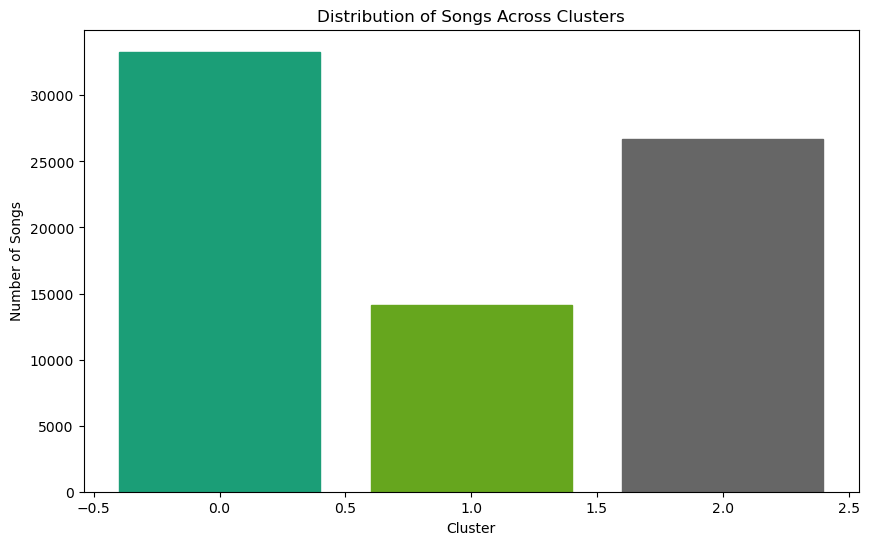

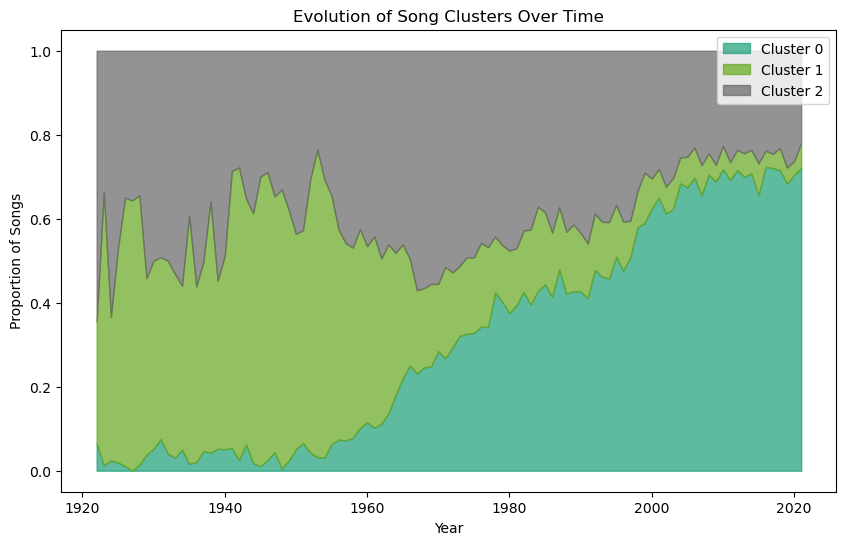

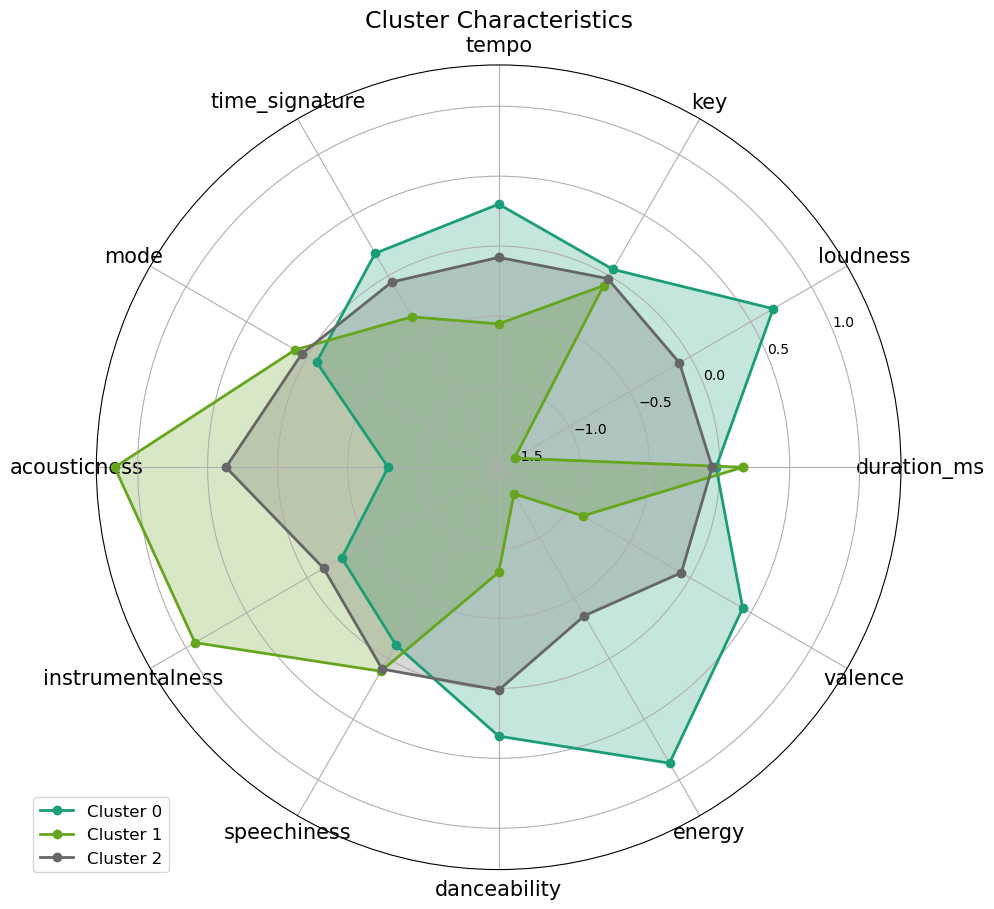

'\n#plot_cluster_scatter(cluster_results) # too many points\n#individual\nplot_cluster_distribution(cluster_results,"Coldplay")\nplot_cluster_evolution(cluster_results,"Coldplay")\nplot_cluster_scatter(cluster_results,"Coldplay")\nplot_cluster_radar(cluster_results,"Coldplay")\n\nplot_cluster_distribution(cluster_results,"Taylor Swift")\nplot_cluster_evolution(cluster_results,"Taylor Swift")\nplot_cluster_scatter(cluster_results,"Taylor Swift")\nplot_cluster_radar(cluster_results,"Taylor Swift")\n\n'

In [ ]:
#%% visualization

#global
plot_cluster_distribution(cluster_results)
plot_cluster_evolution(cluster_results)
plot_cluster_radar(cluster_results)
'''
#plot_cluster_scatter(cluster_results) # too many points
#individual
plot_cluster_distribution(cluster_results,"Coldplay")
plot_cluster_evolution(cluster_results,"Coldplay")
plot_cluster_scatter(cluster_results,"Coldplay")
plot_cluster_radar(cluster_results,"Coldplay")

plot_cluster_distribution(cluster_results,"Taylor Swift")
plot_cluster_evolution(cluster_results,"Taylor Swift")
plot_cluster_scatter(cluster_results,"Taylor Swift")
plot_cluster_radar(cluster_results,"Taylor Swift")

'''

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10,cycle_years=45):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    # Save the time series data
    filename = f'innovation_timeseries_{distance_type}.csv'
    if artist_name:
        filename = f'innovation_timeseries_{artist_name}_{distance_type}.csv'
    results_df.to_csv(filename)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0,    # Emphasize seasonal patterns
            n_changepoints=25  # Increase number of changepoints
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=cycle_years*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast with changepoints
        plt.figure(figsize=(12, 6))
        fig = model.plot(forecast)
        
        # Add vertical lines for changepoints
        ax = fig.gca()
        for cp in model.changepoints:
            ax.axvline(x=cp, color='r', alpha=0.2, linestyle='--')
            
        plt.title(f'Innovation Level Forecast for Range {range_name}\nRed dashed lines indicate trend changepoints')
        plt.tight_layout()
        plt.show()
        
        # Plot changepoint effects
        deltas = model.params['delta'].mean(0)
        fig = plt.figure(figsize=(12, 6))
        ax = fig.add_subplot(111)
        ax.bar(range(len(deltas)), deltas)
        ax.set_title('Magnitude of Changepoint Effects')
        ax.set_xlabel('Changepoint Number')
        ax.set_ylabel('Effect Size')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0,100],
    forecast_years=10
)

NameError: name 'plot_innovation_levels_over_time' is not defined

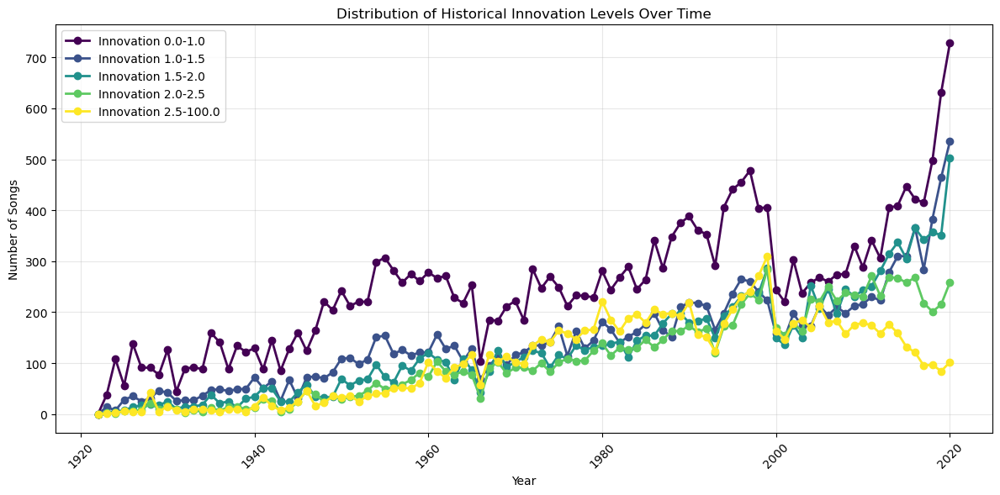

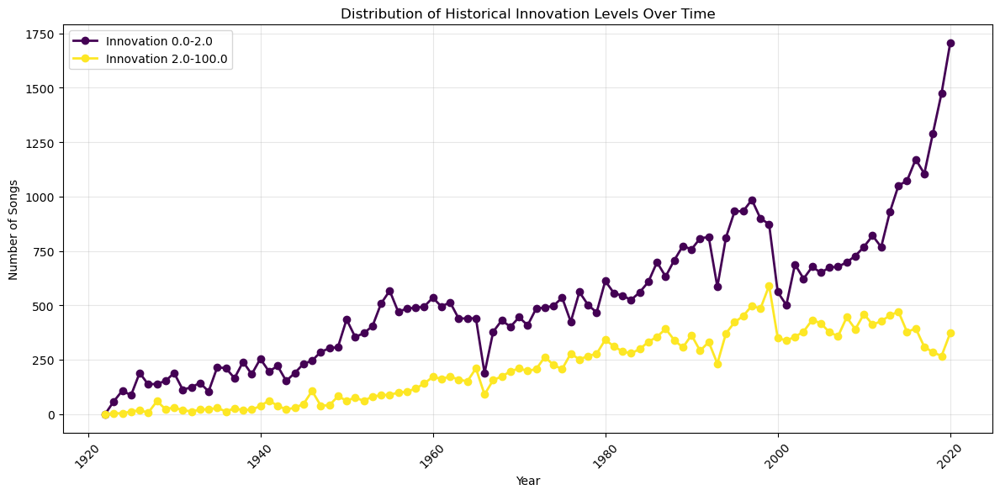

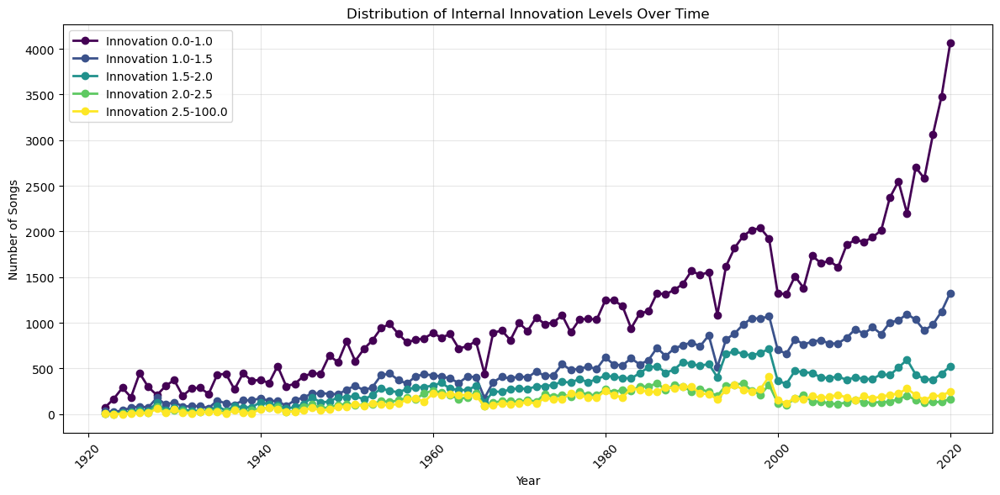

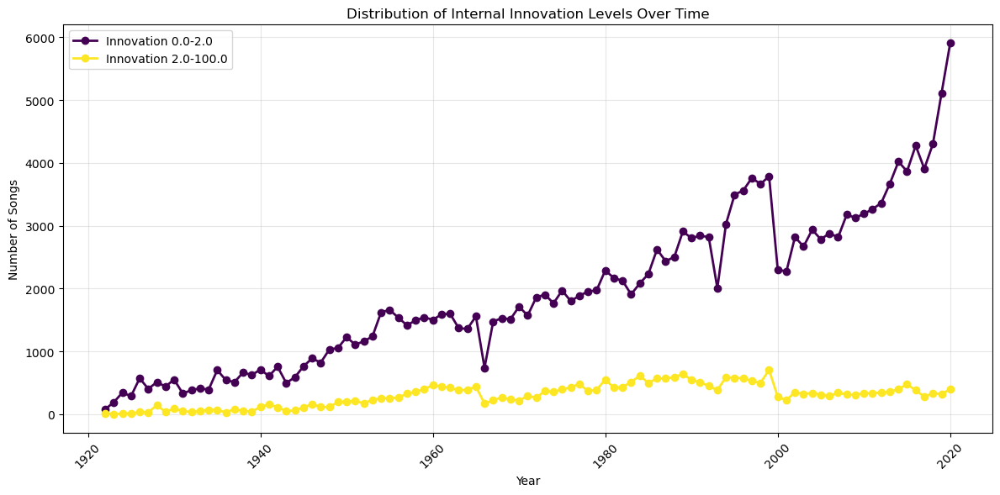

,0.0-2.0,2.0-100.0,raw_innovation_values
Year,,,
1922,80,15,"[0.7032697157683989, 2.0068665098618106, 3.090..."
1923,191,4,"[0.5084632462630222, 1.304491552349525, 0.3929..."
1924,345,8,"[1.20007044427454, 0.7057622258879166, 2.33039..."
1925,288,15,"[0.8062170948413386, 0.8301621739473609, 3.179..."
1926,573,36,"[0.7837518905237977, 0.8618207567500255, 1.275..."
...,...,...,...
2016,4277,381,"[3.0738448420049025, 0.886670650457405, 0.9952..."
2017,3909,282,"[0.4080046338387868, 1.209298469289082, 0.7287..."
2018,4305,331,"[0.32117858808060834, 0.35205352217012775, 0.9..."


In [ ]:
# %% innovation levels over time

def plot_innovation_levels_over_time(cluster_data, artist_name=None, sample_size=0.1, seed=None, 
                                   bins=[0, 1, 2, 3, 4], distance_type='historical'):
    """
    Plot the number of songs in different innovation level ranges over time and return the data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges (default: [0, 1, 2, 3, 4])
        distance_type: Type of distance to calculate ('historical' or 'internal')
        
    Returns:
        DataFrame containing innovation counts by year and range
    """
    # Extract data
    num_clusters, colors, cluster_data = exact_to_pd(cluster_data, artist_name, sample_size, seed)
    
    # Filter data for 1920-2020
    cluster_data = cluster_data[
        (cluster_data['year'] >= 1920) & 
        (cluster_data['year'] <= 2020)
    ]
    
    # Process data year by year
    years = sorted(cluster_data['year'].unique())
    historical_centroid = None
    
    # Store innovation levels for each year
    innovation_by_year = {year: [] for year in years}
    
    for year in years:
        year_data = cluster_data[cluster_data['year'] == year]
        if not year_data.empty:
            current_points = np.array([
                [float(features[0]), float(features[1])] 
                for features in year_data['features']
            ])
            current_centroid = current_points.mean(axis=0)
            
            if distance_type == 'historical':
                if historical_centroid is not None:
                    # Calculate distances to historical centroid
                    distances = np.sqrt(
                        np.sum((current_points - historical_centroid) ** 2, axis=1)
                    )
                    innovation_by_year[year].extend(distances)
                
                # Update historical centroid
                if historical_centroid is None:
                    historical_centroid = current_centroid
                else:
                    historical_data = cluster_data[cluster_data['year'] <= year]
                    historical_points = np.array([
                        [float(features[0]), float(features[1])] 
                        for features in historical_data['features']
                    ])
                    historical_centroid = historical_points.mean(axis=0)
            
            else:  # internal distance
                # Calculate distances to current year's centroid
                distances = np.sqrt(
                    np.sum((current_points - current_centroid) ** 2, axis=1)
                )
                innovation_by_year[year].extend(distances)
    
    # Create figure
    plt.figure(figsize=(12, 6))
    
    # Calculate counts for each bin range
    bin_ranges = list(zip(bins[:-1], bins[1:]))
    counts_by_range = {f"{low:.1f}-{high:.1f}": [] for low, high in bin_ranges}
    
    for year in years:
        year_innovations = innovation_by_year[year]
        if year_innovations:
            # Count songs in each range
            for (low, high) in bin_ranges:
                count = sum((low <= x < high) for x in year_innovations)
                counts_by_range[f"{low:.1f}-{high:.1f}"].append(count)
        else:
            # Add 0 if no songs in this year
            for range_key in counts_by_range:
                counts_by_range[range_key].append(0)
    
    # Plot lines for each range
    colors = plt.cm.viridis(np.linspace(0, 1, len(bin_ranges)))
    for (range_key, counts), color in zip(counts_by_range.items(), colors):
        plt.plot(years, counts, '-o', label=f'Innovation {range_key}', 
                color=color, linewidth=2, markersize=6)
    
    plt.xlabel('Year')
    plt.ylabel('Number of Songs')
    title = f"Distribution of {'Historical' if distance_type == 'historical' else 'Internal'} Innovation Levels Over Time"
    if artist_name:
        title = f"{artist_name}: {title}"
    plt.title(title)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tick_params(axis='x', rotation=45)
    
    plt.tight_layout()
    plt.show()
    
    # Create and return DataFrame with results
    results_df = pd.DataFrame(counts_by_range, index=years)
    results_df.index.name = 'Year'
    
    # Add raw innovation values
    results_df['raw_innovation_values'] = [innovation_by_year[year] for year in years]
    
    return results_df

# 使用历史距离
results_df = plot_innovation_levels_over_time(cluster_results, distance_type='historical',sample_size=0.1,bins=[0,1,1.5,2,2.5,100])
plot_innovation_levels_over_time(cluster_results, distance_type='historical',sample_size=0.1,bins=[0,2,100])

# 使用年距离
plot_innovation_levels_over_time(cluster_results, distance_type='internal',sample_size=0.3,bins=[0,1,1.5,2,2.5,100])
plot_innovation_levels_over_time(cluster_results, distance_type='internal',sample_size=0.3,bins=[0,2,100])

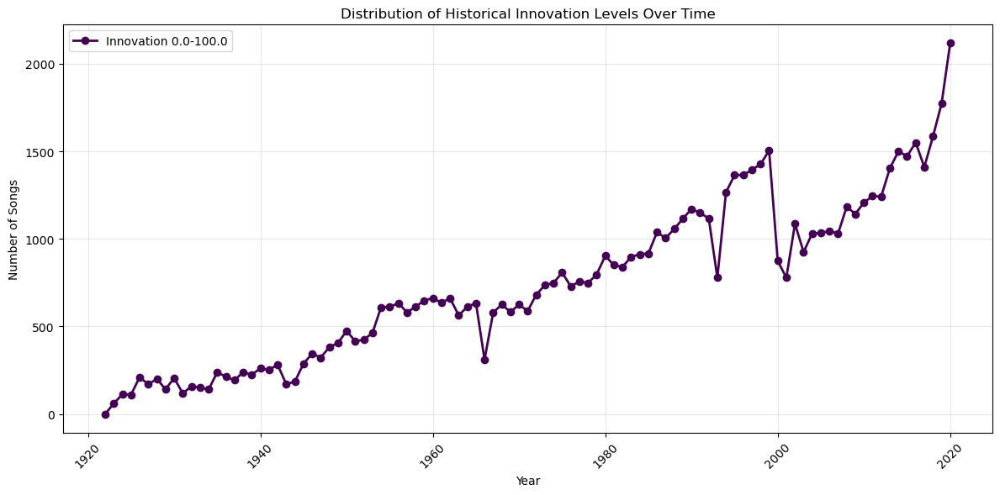

22:31:23 - cmdstanpy - INFO - Chain [1] start processing
22:31:25 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

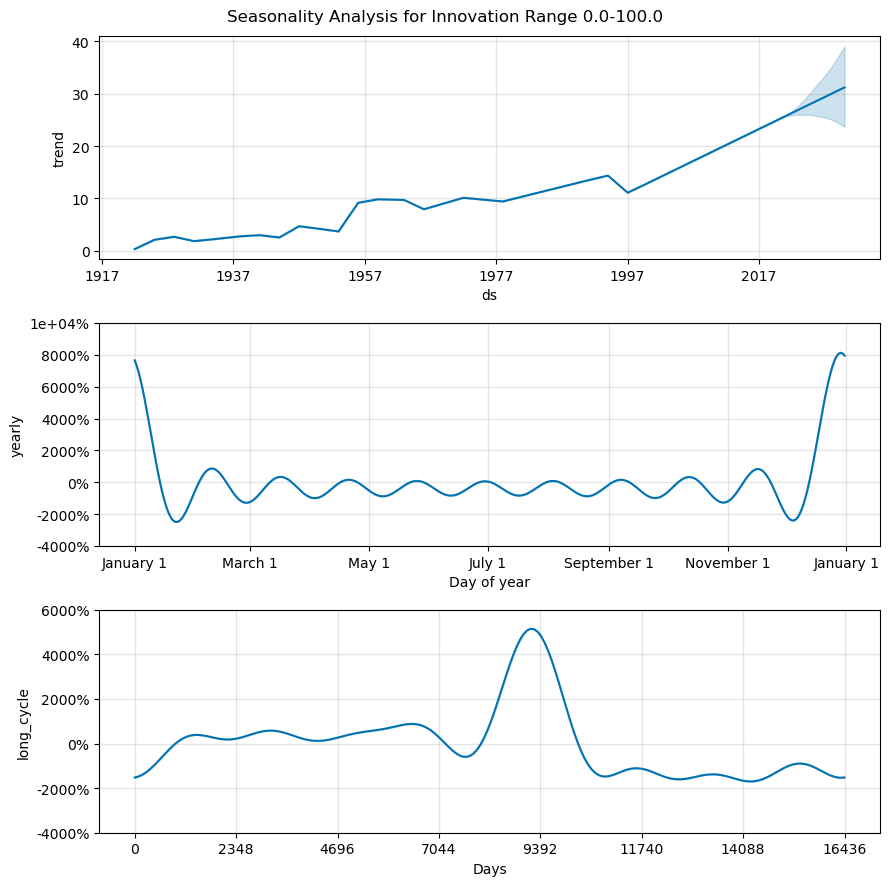

<Figure size 1200x600 with 0 Axes>

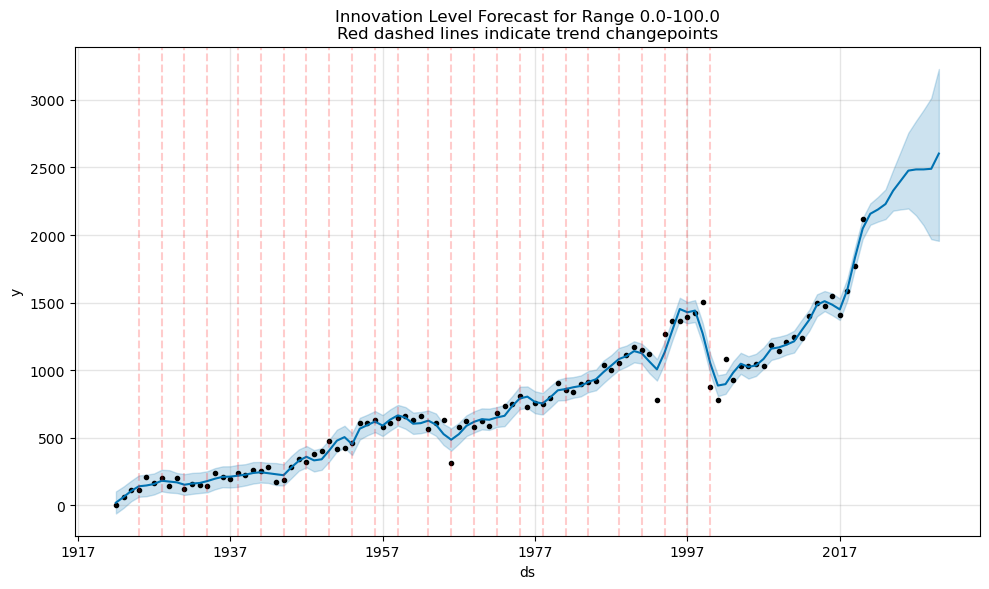

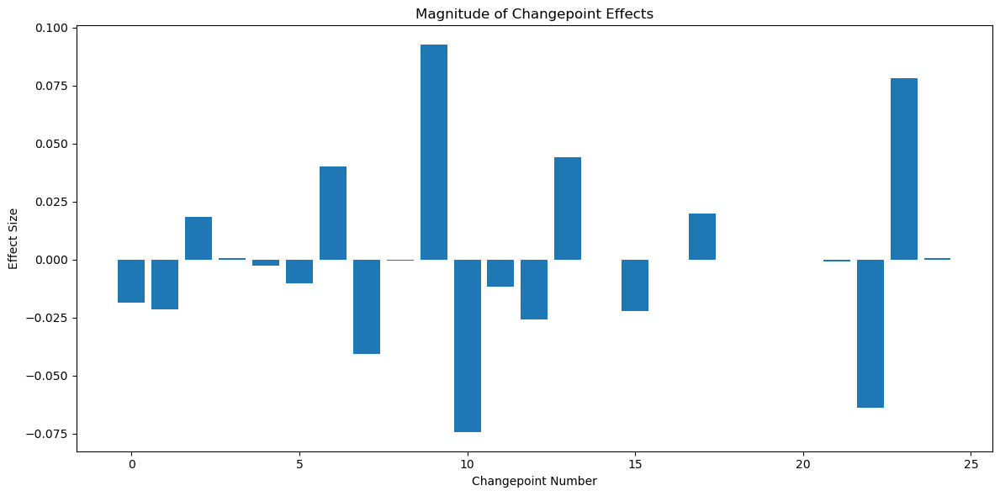

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10,cycle_years=45):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    # Save the time series data
    filename = f'innovation_timeseries_{distance_type}.csv'
    if artist_name:
        filename = f'innovation_timeseries_{artist_name}_{distance_type}.csv'
    results_df.to_csv(filename)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0,    # Emphasize seasonal patterns
            n_changepoints=25  # Increase number of changepoints
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=cycle_years*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast with changepoints
        plt.figure(figsize=(12, 6))
        fig = model.plot(forecast)
        
        # Add vertical lines for changepoints
        ax = fig.gca()
        for cp in model.changepoints:
            ax.axvline(x=cp, color='r', alpha=0.2, linestyle='--')
            
        plt.title(f'Innovation Level Forecast for Range {range_name}\nRed dashed lines indicate trend changepoints')
        plt.tight_layout()
        plt.show()
        
        # Plot changepoint effects
        deltas = model.params['delta'].mean(0)
        fig = plt.figure(figsize=(12, 6))
        ax = fig.add_subplot(111)
        ax.bar(range(len(deltas)), deltas)
        ax.set_title('Magnitude of Changepoint Effects')
        ax.set_xlabel('Changepoint Number')
        ax.set_ylabel('Effect Size')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0,100],
    forecast_years=10
)

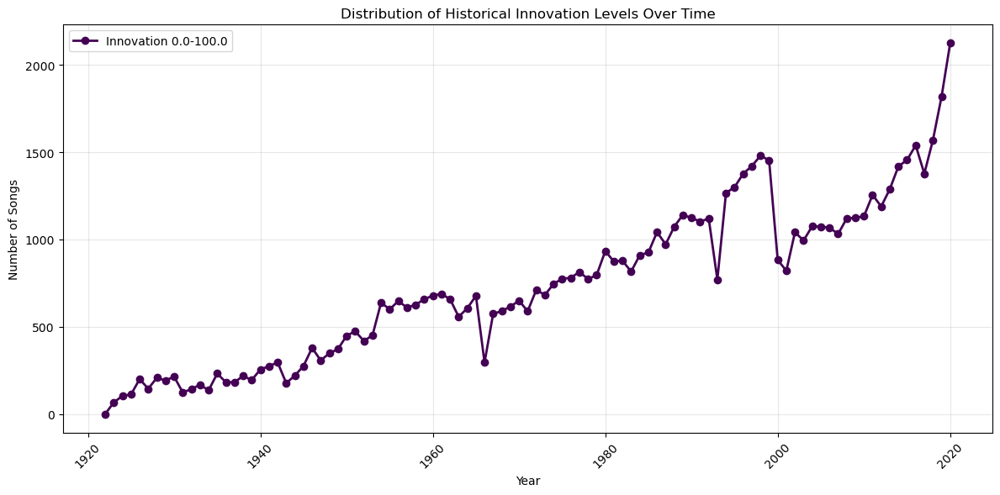

22:50:43 - cmdstanpy - INFO - Chain [1] start processing
22:50:45 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

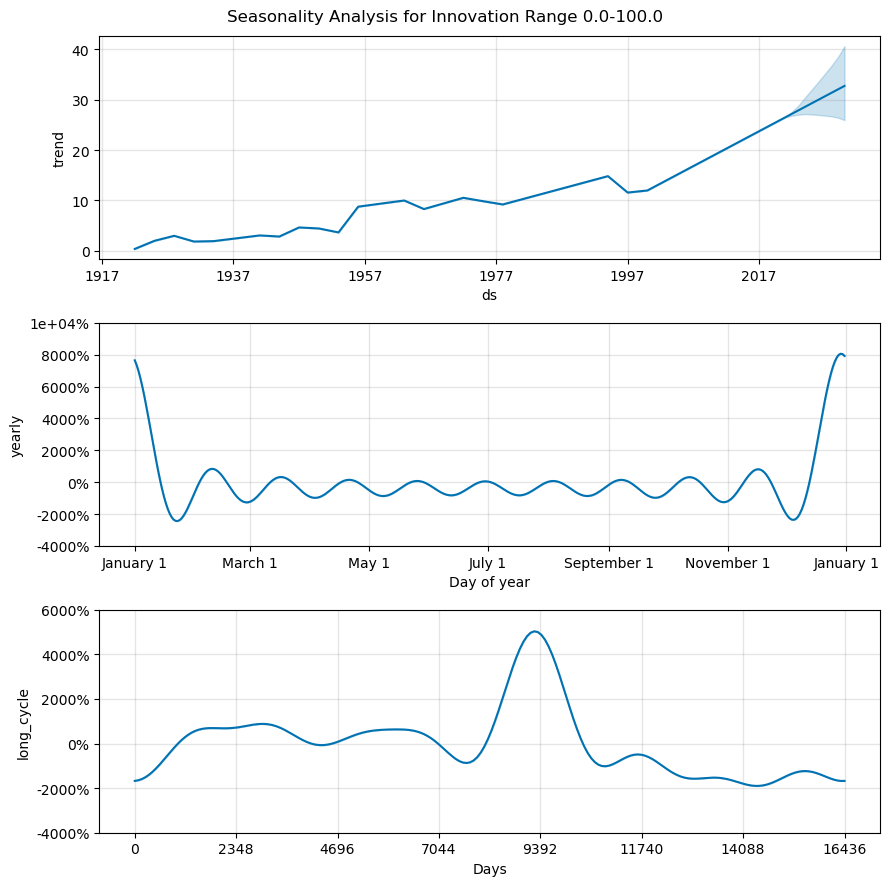

<Figure size 1200x600 with 0 Axes>

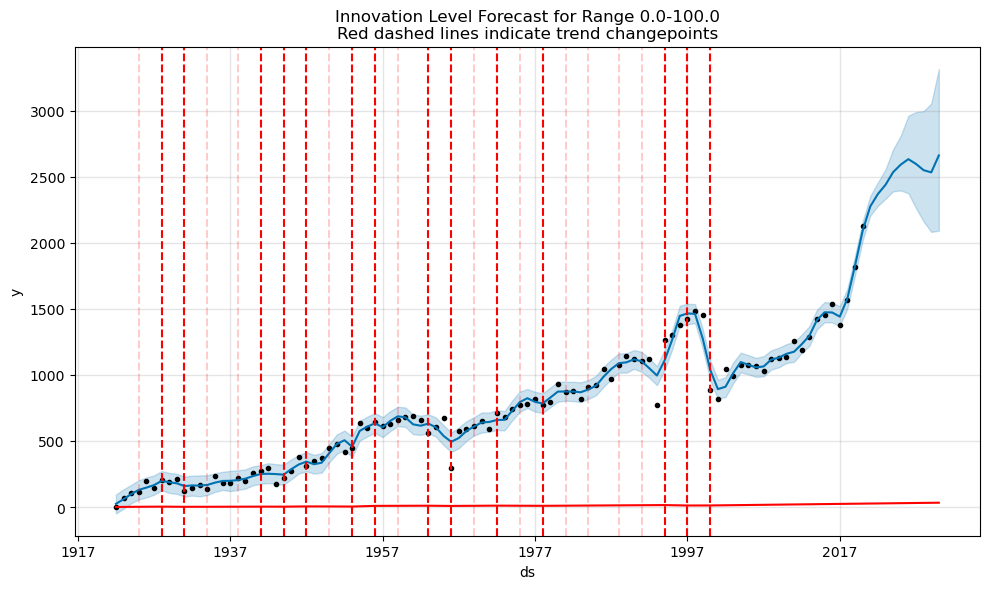

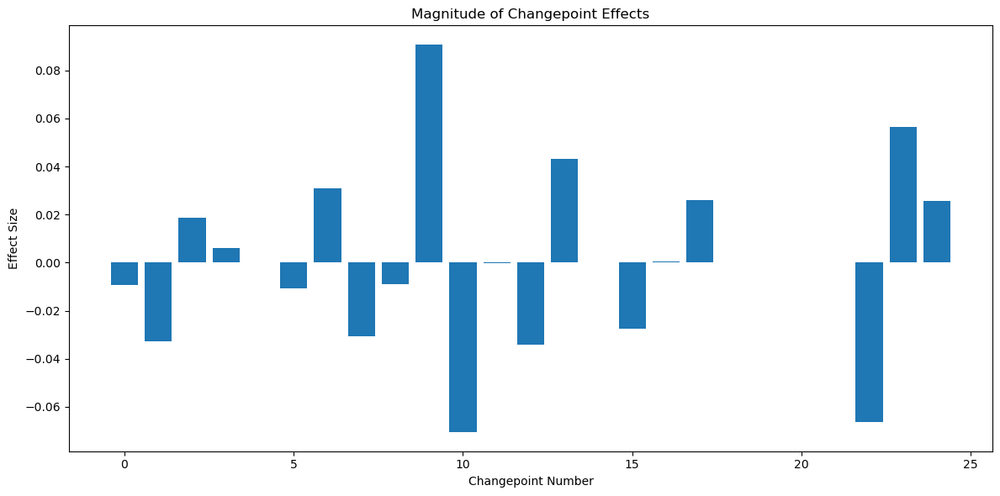

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10,cycle_years=45):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    # Save the time series data
    filename = f'innovation_timeseries_{distance_type}.csv'
    if artist_name:
        filename = f'innovation_timeseries_{artist_name}_{distance_type}.csv'
    results_df.to_csv(filename)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0,    # Emphasize seasonal patterns
            n_changepoints=25  # Increase number of changepoints
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=cycle_years*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast with changepoints
        plt.figure(figsize=(12, 6))
        fig = model.plot(forecast)
        
        # Add vertical lines for changepoints
        ax = fig.gca()
        for cp in model.changepoints:
            ax.axvline(x=cp, color='r', alpha=0.2, linestyle='--')
            

        from prophet.plot import add_changepoints_to_plot
        a = add_changepoints_to_plot(ax, model, forecast)


        plt.title(f'Innovation Level Forecast for Range {range_name}\nRed dashed lines indicate trend changepoints')
        plt.tight_layout()
        plt.show()
        
        # Plot changepoint effects
        deltas = model.params['delta'].mean(0)
        fig = plt.figure(figsize=(12, 6))
        ax = fig.add_subplot(111)
        ax.bar(range(len(deltas)), deltas)
        ax.set_title('Magnitude of Changepoint Effects')
        ax.set_xlabel('Changepoint Number')
        ax.set_ylabel('Effect Size')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0,100],
    forecast_years=10
)

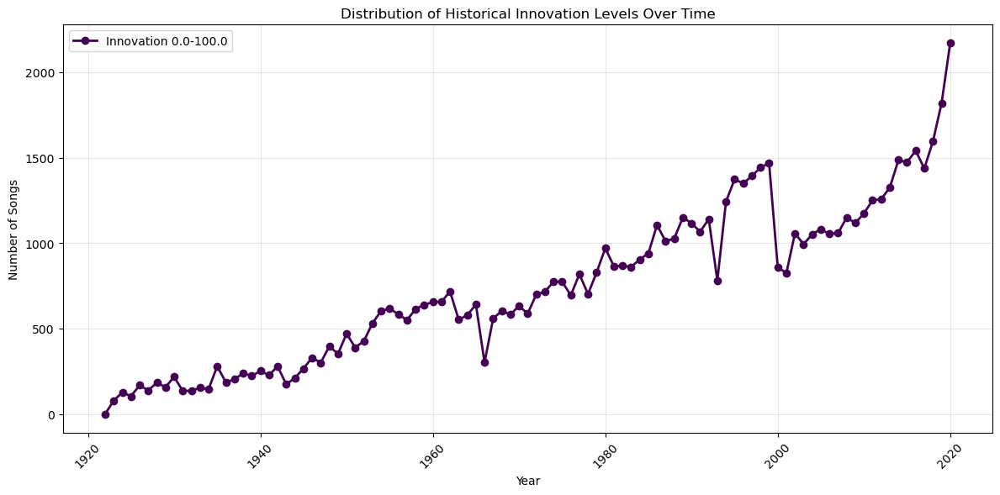

22:55:37 - cmdstanpy - INFO - Chain [1] start processing
22:55:38 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

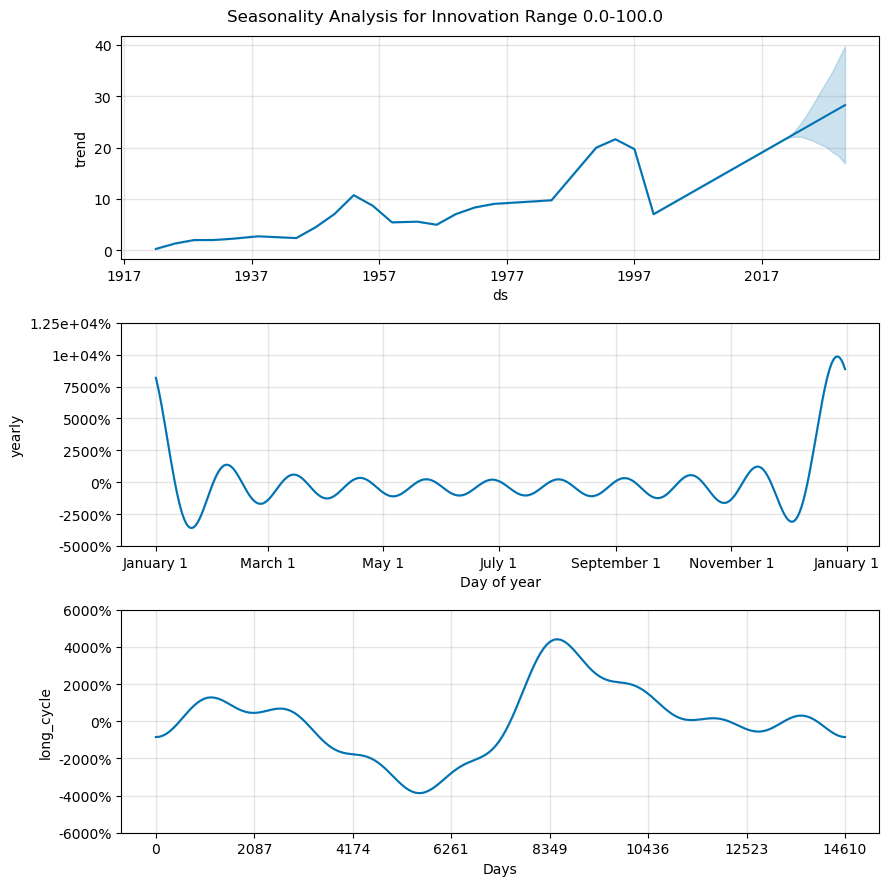

<Figure size 1200x600 with 0 Axes>

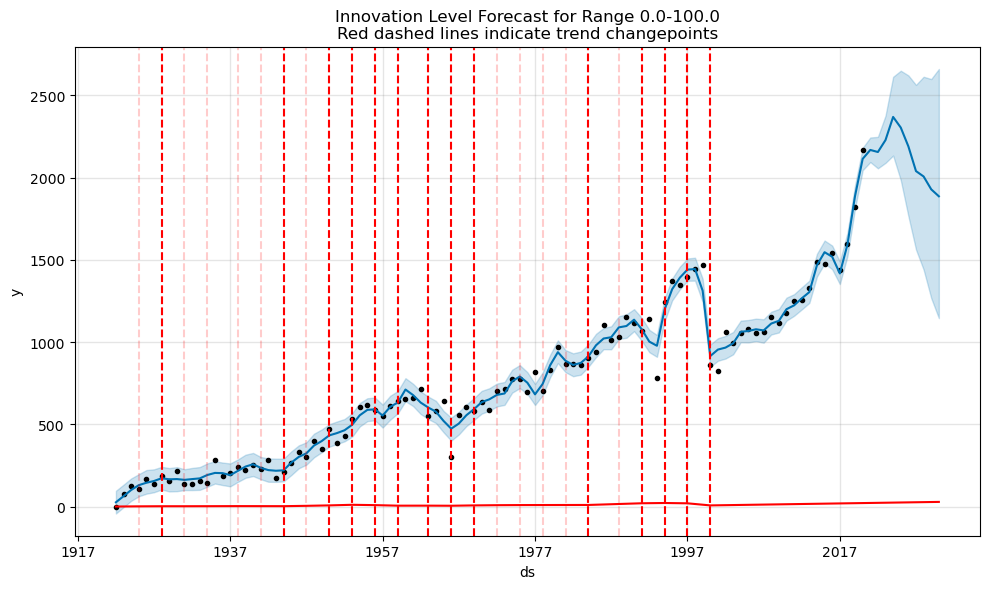

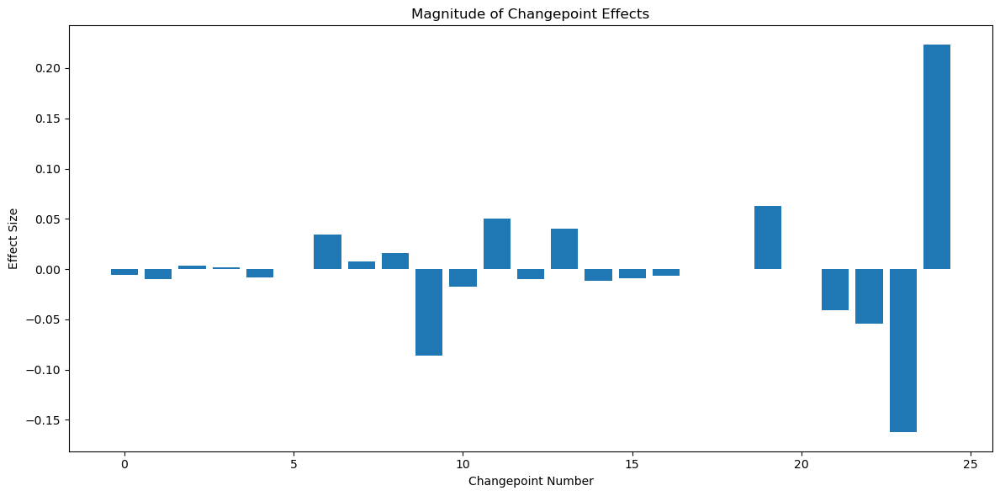

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10,cycle_years=45):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    # Save the time series data
    filename = f'innovation_timeseries_{distance_type}.csv'
    if artist_name:
        filename = f'innovation_timeseries_{artist_name}_{distance_type}.csv'
    results_df.to_csv(filename)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0,    # Emphasize seasonal patterns
            n_changepoints=25  # Increase number of changepoints
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=cycle_years*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast with changepoints
        plt.figure(figsize=(12, 6))
        fig = model.plot(forecast)
        
        # Add vertical lines for changepoints
        ax = fig.gca()
        for cp in model.changepoints:
            ax.axvline(x=cp, color='r', alpha=0.2, linestyle='--')
            

        from prophet.plot import add_changepoints_to_plot
        a = add_changepoints_to_plot(ax, model, forecast)


        plt.title(f'Innovation Level Forecast for Range {range_name}\nRed dashed lines indicate trend changepoints')
        plt.tight_layout()
        plt.show()
        
        # Plot changepoint effects
        deltas = model.params['delta'].mean(0)
        fig = plt.figure(figsize=(12, 6))
        ax = fig.add_subplot(111)
        ax.bar(range(len(deltas)), deltas)
        ax.set_title('Magnitude of Changepoint Effects')
        ax.set_xlabel('Changepoint Number')
        ax.set_ylabel('Effect Size')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0,100],
    forecast_years=10,
    cycle_years=40
)

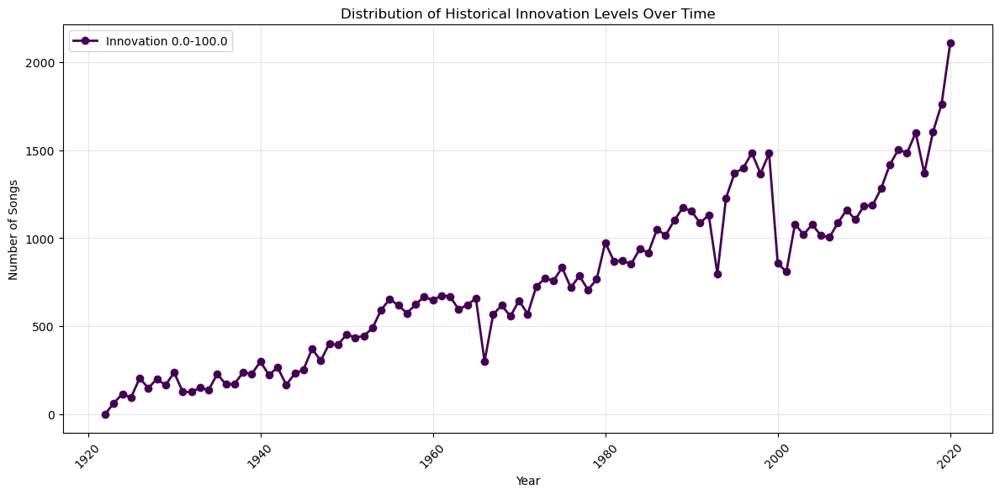

22:56:42 - cmdstanpy - INFO - Chain [1] start processing
22:56:43 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

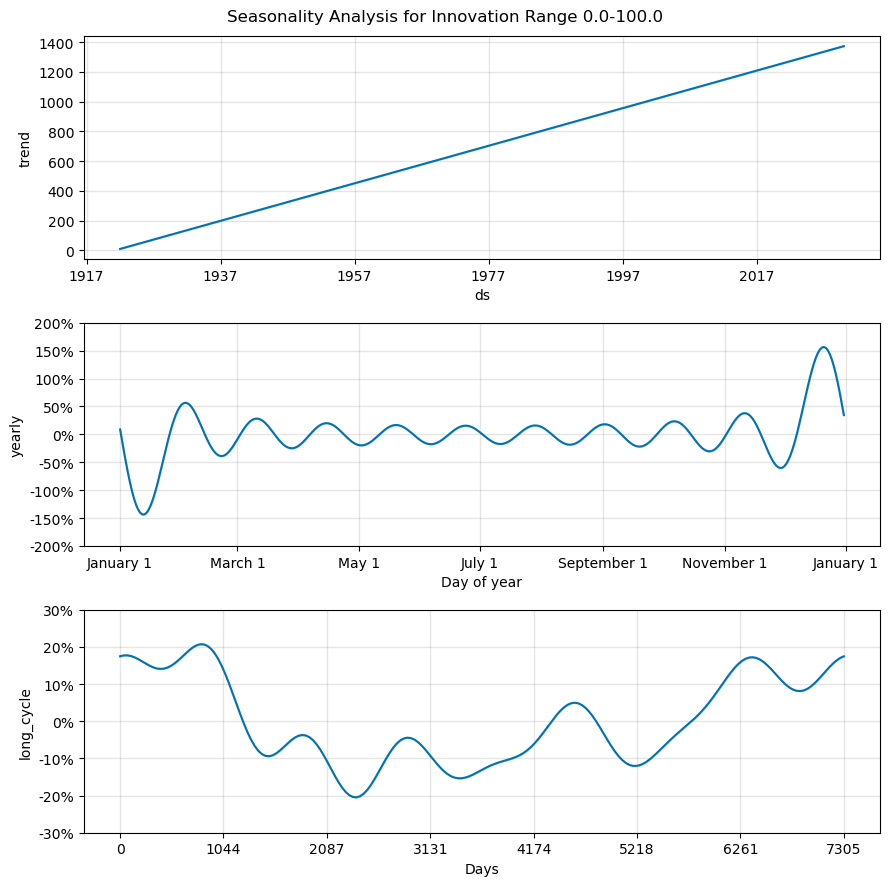

<Figure size 1200x600 with 0 Axes>

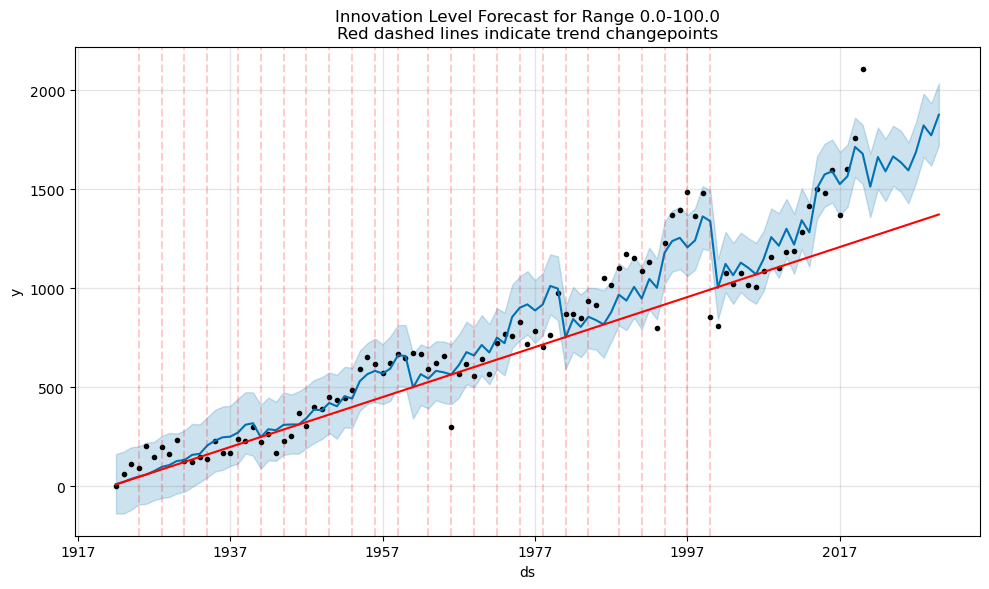

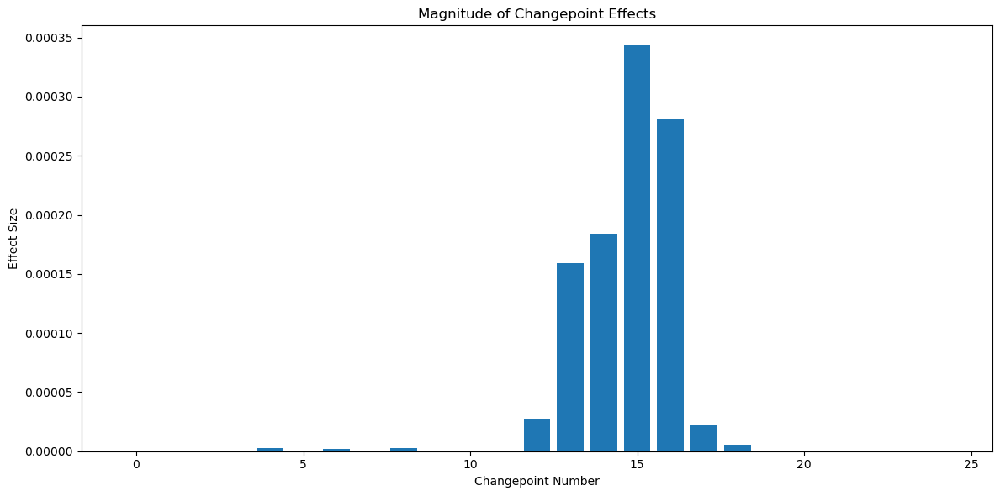

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10,cycle_years=45):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    # Save the time series data
    filename = f'innovation_timeseries_{distance_type}.csv'
    if artist_name:
        filename = f'innovation_timeseries_{artist_name}_{distance_type}.csv'
    results_df.to_csv(filename)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0,    # Emphasize seasonal patterns
            n_changepoints=25  # Increase number of changepoints
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=cycle_years*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast with changepoints
        plt.figure(figsize=(12, 6))
        fig = model.plot(forecast)
        
        # Add vertical lines for changepoints
        ax = fig.gca()
        for cp in model.changepoints:
            ax.axvline(x=cp, color='r', alpha=0.2, linestyle='--')
            

        from prophet.plot import add_changepoints_to_plot
        a = add_changepoints_to_plot(ax, model, forecast)


        plt.title(f'Innovation Level Forecast for Range {range_name}\nRed dashed lines indicate trend changepoints')
        plt.tight_layout()
        plt.show()
        
        # Plot changepoint effects
        deltas = model.params['delta'].mean(0)
        fig = plt.figure(figsize=(12, 6))
        ax = fig.add_subplot(111)
        ax.bar(range(len(deltas)), deltas)
        ax.set_title('Magnitude of Changepoint Effects')
        ax.set_xlabel('Changepoint Number')
        ax.set_ylabel('Effect Size')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0,100],
    forecast_years=10,
    cycle_years=20,
    seed=42
)

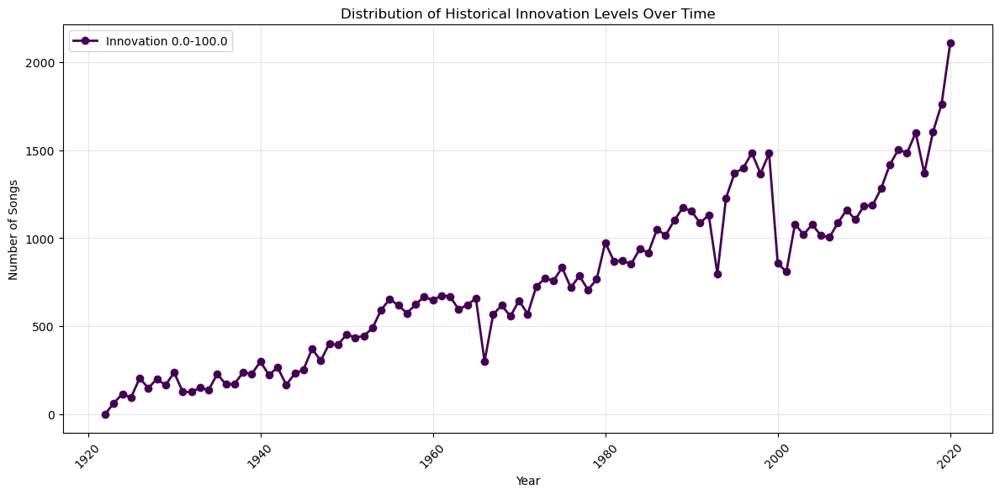

22:58:22 - cmdstanpy - INFO - Chain [1] start processing
22:58:23 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

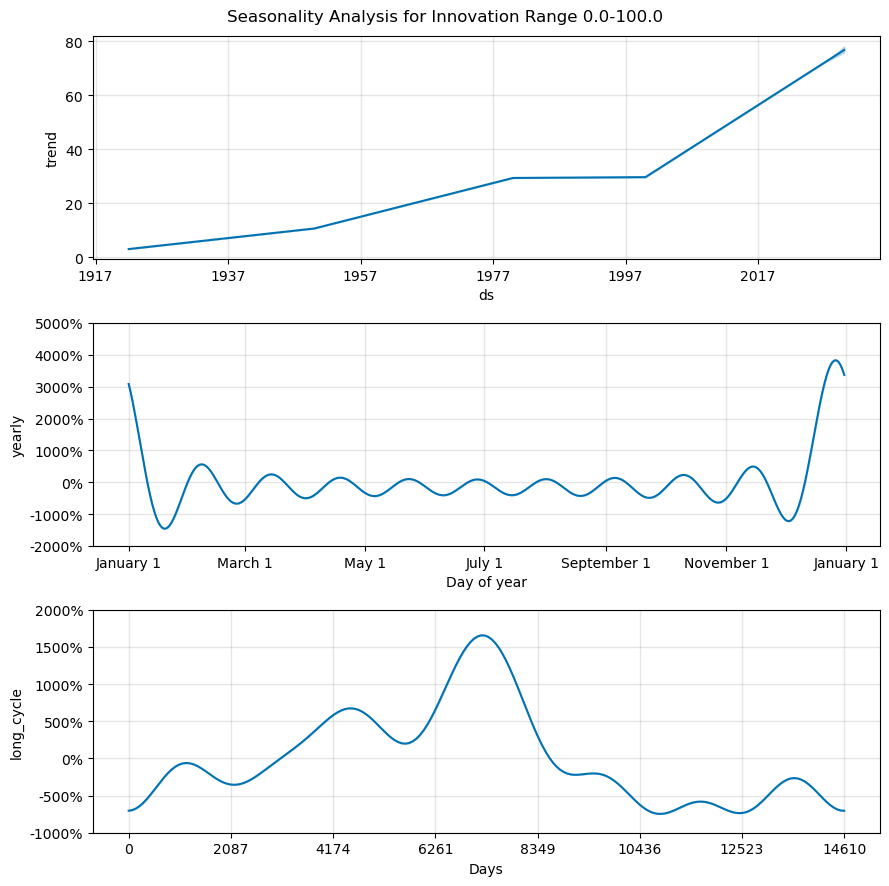

<Figure size 1200x600 with 0 Axes>

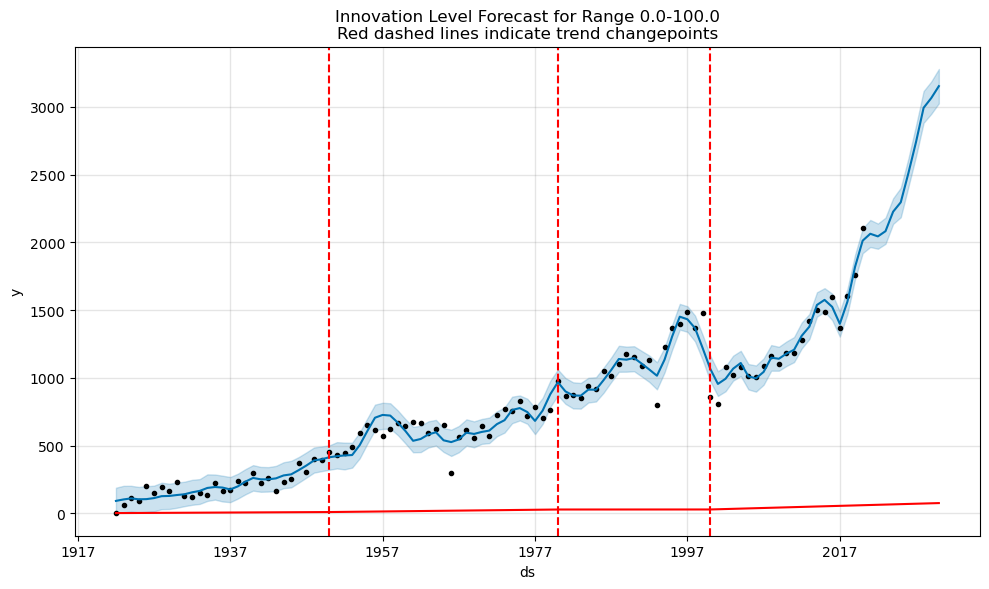

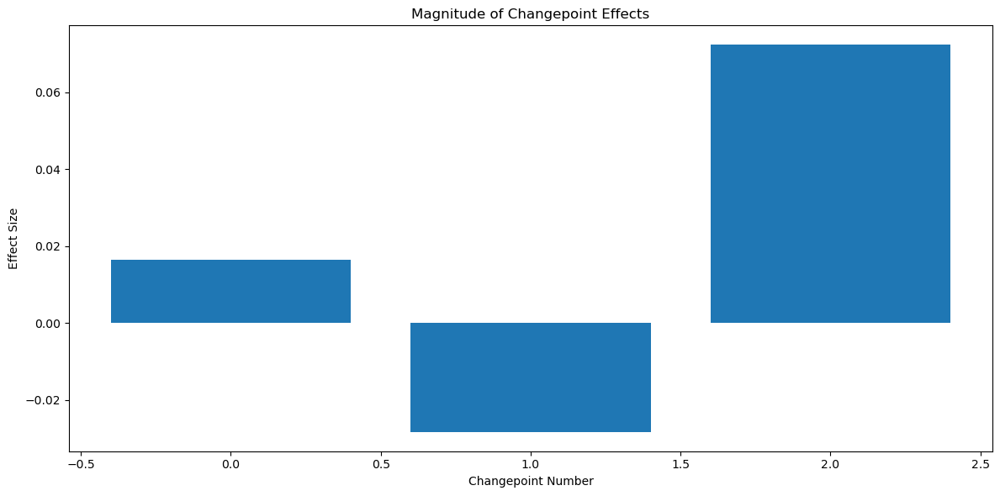

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10,cycle_years=45):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    # Save the time series data
    filename = f'innovation_timeseries_{distance_type}.csv'
    if artist_name:
        filename = f'innovation_timeseries_{artist_name}_{distance_type}.csv'
    results_df.to_csv(filename)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0,    # Emphasize seasonal patterns
            n_changepoints=25,  # Increase number of changepoints
            changepoints = ['1950-01-01', '1980-01-01', '2000-01-01']
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=cycle_years*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast with changepoints
        plt.figure(figsize=(12, 6))
        fig = model.plot(forecast)
        
        # Add vertical lines for changepoints
        ax = fig.gca()
        for cp in model.changepoints:
            ax.axvline(x=cp, color='r', alpha=0.2, linestyle='--')
            

        from prophet.plot import add_changepoints_to_plot
        a = add_changepoints_to_plot(ax, model, forecast)


        plt.title(f'Innovation Level Forecast for Range {range_name}\nRed dashed lines indicate trend changepoints')
        plt.tight_layout()
        plt.show()
        
        # Plot changepoint effects
        deltas = model.params['delta'].mean(0)
        fig = plt.figure(figsize=(12, 6))
        ax = fig.add_subplot(111)
        ax.bar(range(len(deltas)), deltas)
        ax.set_title('Magnitude of Changepoint Effects')
        ax.set_xlabel('Changepoint Number')
        ax.set_ylabel('Effect Size')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0,100],
    forecast_years=10,
    cycle_years=40,
    seed=42
)

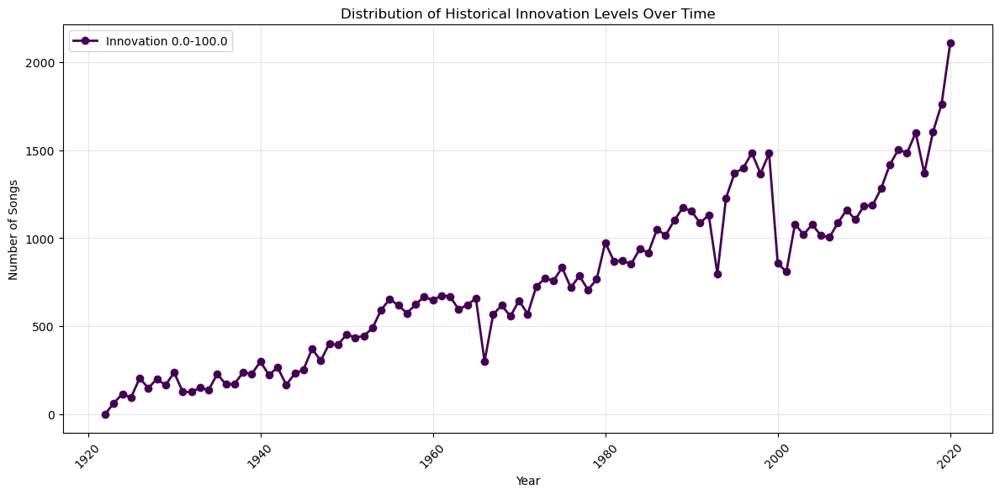

22:59:42 - cmdstanpy - INFO - Chain [1] start processing
22:59:42 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

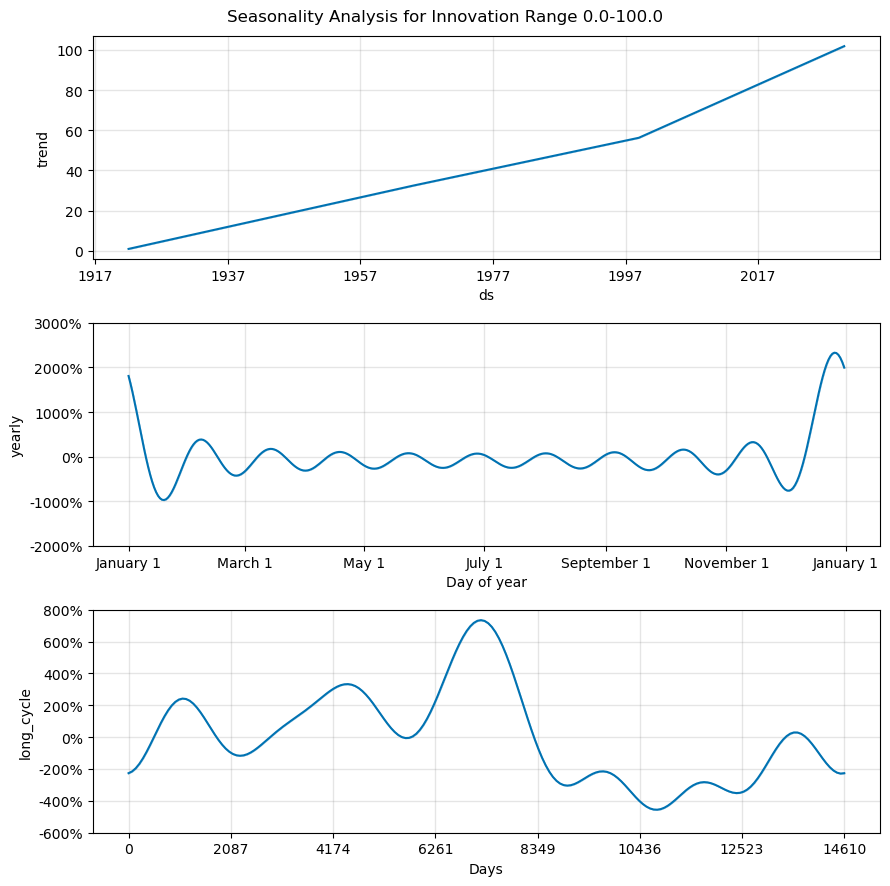

<Figure size 1200x600 with 0 Axes>

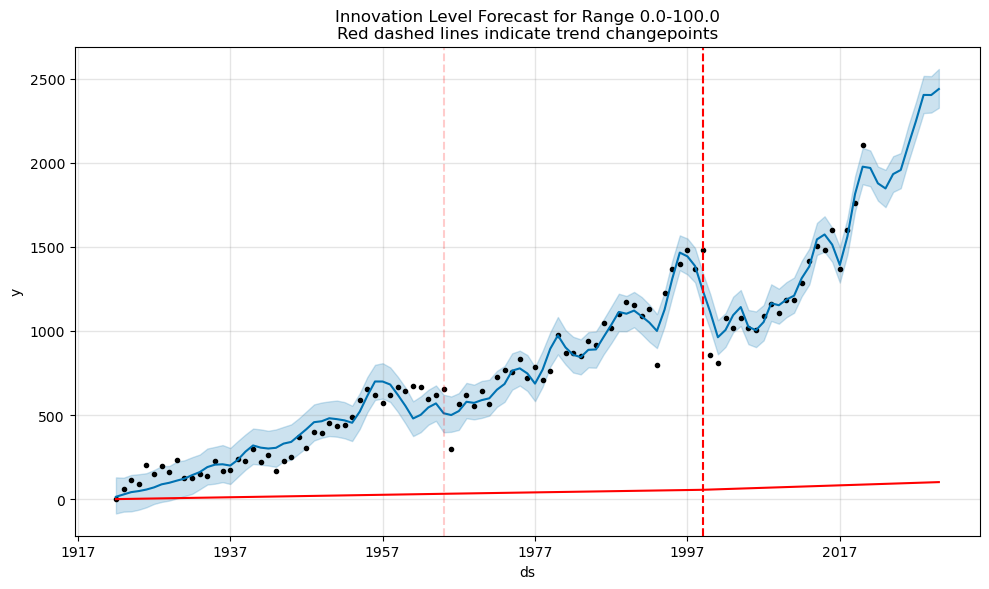

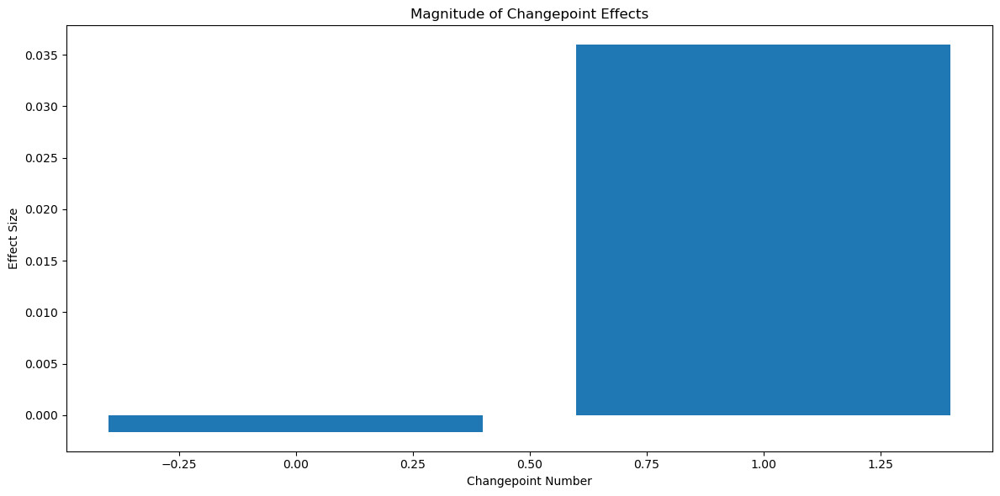

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10,cycle_years=45):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    # Save the time series data
    filename = f'innovation_timeseries_{distance_type}.csv'
    if artist_name:
        filename = f'innovation_timeseries_{artist_name}_{distance_type}.csv'
    results_df.to_csv(filename)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0,    # Emphasize seasonal patterns
            n_changepoints=25,  # Increase number of changepoints
            changepoints = ['1965-01-01', '1999-01-01']
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=cycle_years*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast with changepoints
        plt.figure(figsize=(12, 6))
        fig = model.plot(forecast)
        
        # Add vertical lines for changepoints
        ax = fig.gca()
        for cp in model.changepoints:
            ax.axvline(x=cp, color='r', alpha=0.2, linestyle='--')
            

        from prophet.plot import add_changepoints_to_plot
        a = add_changepoints_to_plot(ax, model, forecast)


        plt.title(f'Innovation Level Forecast for Range {range_name}\nRed dashed lines indicate trend changepoints')
        plt.tight_layout()
        plt.show()
        
        # Plot changepoint effects
        deltas = model.params['delta'].mean(0)
        fig = plt.figure(figsize=(12, 6))
        ax = fig.add_subplot(111)
        ax.bar(range(len(deltas)), deltas)
        ax.set_title('Magnitude of Changepoint Effects')
        ax.set_xlabel('Changepoint Number')
        ax.set_ylabel('Effect Size')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0,100],
    forecast_years=10,
    cycle_years=40,
    seed=42
)

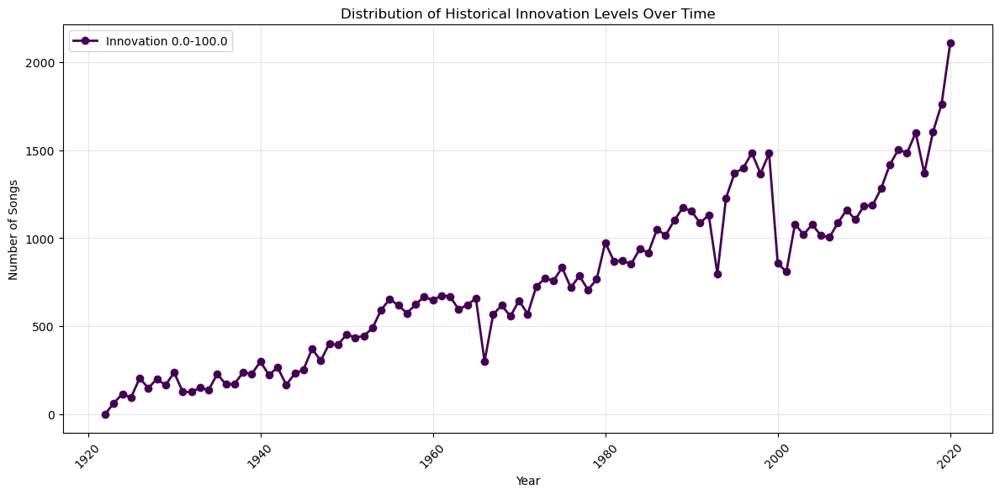

23:00:59 - cmdstanpy - INFO - Chain [1] start processing
23:00:59 - cmdstanpy - INFO - Chain [1] done processing


<Figure size 1500x1000 with 0 Axes>

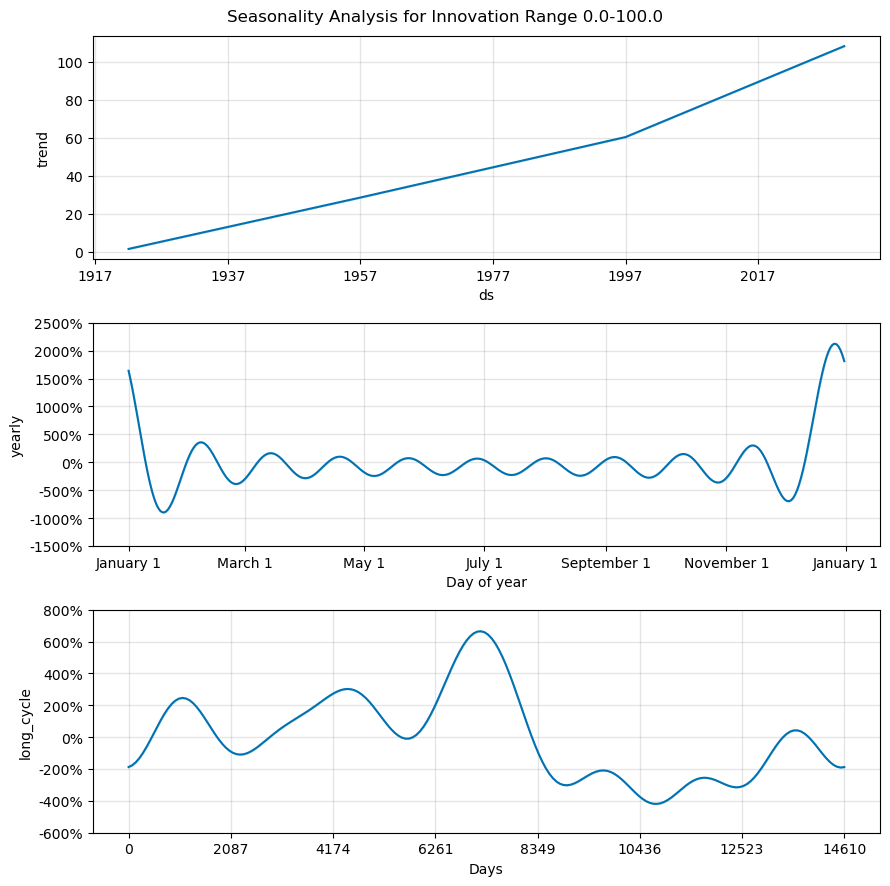

<Figure size 1200x600 with 0 Axes>

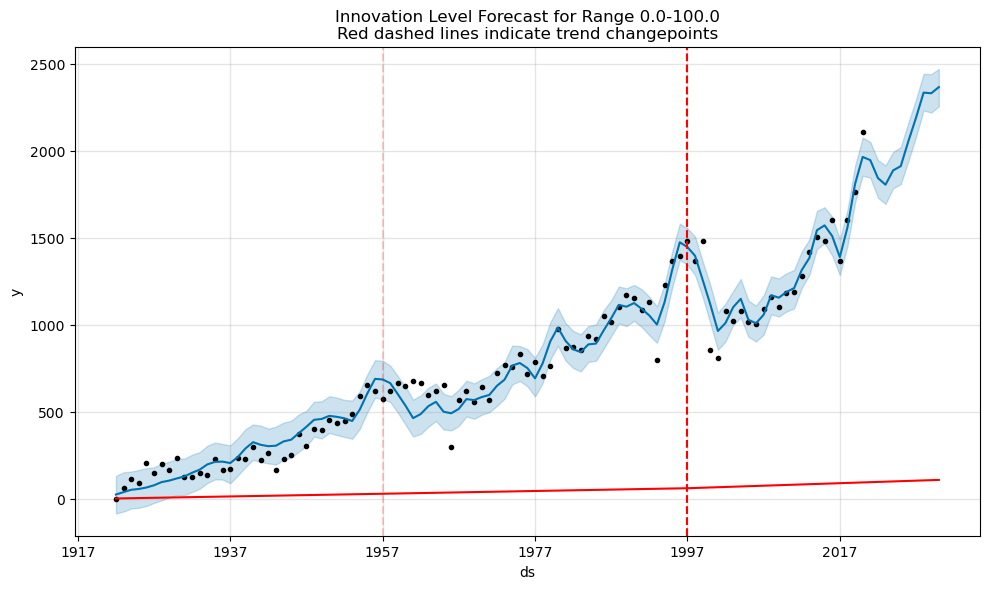

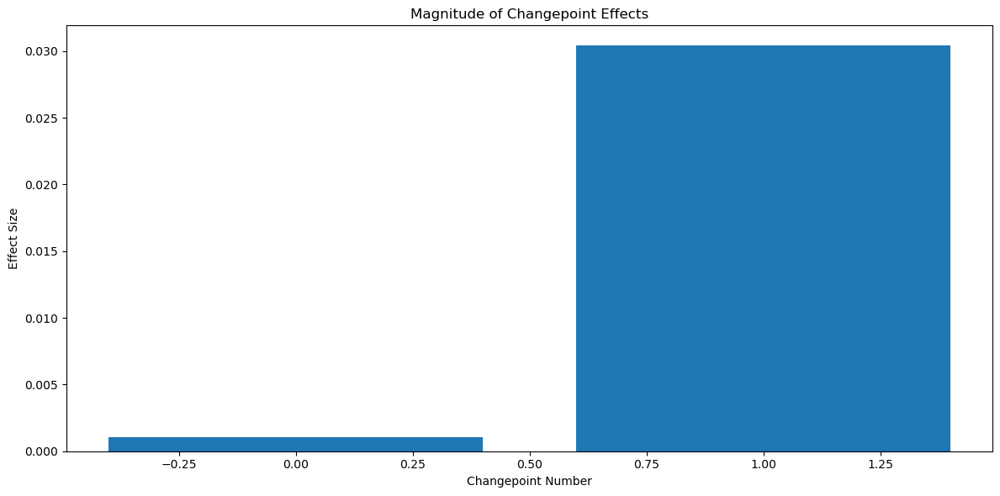

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10,cycle_years=20,
                                 changepoints=None):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    # Save the time series data
    filename = f'innovation_timeseries_{distance_type}.csv'
    if artist_name:
        filename = f'innovation_timeseries_{artist_name}_{distance_type}.csv'
    results_df.to_csv(filename)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0,    # Emphasize seasonal patterns
            n_changepoints=25,  # Increase number of changepoints
            changepoints = changepoints
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=cycle_years*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast with changepoints
        plt.figure(figsize=(12, 6))
        fig = model.plot(forecast)
        
        # Add vertical lines for changepoints
        ax = fig.gca()
        for cp in model.changepoints:
            ax.axvline(x=cp, color='r', alpha=0.2, linestyle='--')
            

        from prophet.plot import add_changepoints_to_plot
        a = add_changepoints_to_plot(ax, model, forecast)


        plt.title(f'Innovation Level Forecast for Range {range_name}\nRed dashed lines indicate trend changepoints')
        plt.tight_layout()
        plt.show()
        
        # Plot changepoint effects
        deltas = model.params['delta'].mean(0)
        fig = plt.figure(figsize=(12, 6))
        ax = fig.add_subplot(111)
        ax.bar(range(len(deltas)), deltas)
        ax.set_title('Magnitude of Changepoint Effects')
        ax.set_xlabel('Changepoint Number')
        ax.set_ylabel('Effect Size')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0,100],
    forecast_years=10,
    cycle_years=40,
    seed=42,
    changepoints=['1957-01-01', '1997-01-01']
)

In [ ]:
# %%

def analyze_innovation_seasonality(cluster_data, artist_name=None, sample_size=0.1, seed=None,
                                 bins=[0, 1, 2, 3, 4], distance_type='historical',
                                 forecast_years=10,cycle_years=20,
                                 changepoints=None):
    """
    Analyze seasonality in innovation levels using Prophet, optimized for yearly data
    
    Args:
        cluster_data: DataFrame with cluster predictions and features
        artist_name: Optional artist name to filter data
        sample_size: Fraction of data to sample
        seed: Random seed for sampling
        bins: Innovation level ranges
        distance_type: Type of distance to calculate ('historical' or 'internal')
        forecast_years: Number of years to forecast
    """
    from prophet import Prophet
    
    # Get innovation data using existing function
    results_df = plot_innovation_levels_over_time(cluster_data, artist_name, sample_size, 
                                                seed, bins, distance_type)
    
    # Save the time series data
    filename = f'innovation_timeseries_{distance_type}.csv'
    if artist_name:
        filename = f'innovation_timeseries_{artist_name}_{distance_type}.csv'
    results_df.to_csv(filename)
    
    prophet_results = {}
    bin_ranges = [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)]
    
    for range_name in bin_ranges:
        # Prepare DataFrame for Prophet
        df = pd.DataFrame({
            'ds': pd.to_datetime(results_df.index.astype(str) + '-01-01'),  # Convert to date format
            'y': results_df[range_name]
        })
        
        # Initialize Prophet model with yearly parameters
        model = Prophet(
            yearly_seasonality=True,  # Capture year-to-year patterns
            weekly_seasonality=False,
            daily_seasonality=False,
            seasonality_mode='multiplicative',  # Better for long-term trends
            changepoint_prior_scale=0.05,  # Control overall trend flexibility
            seasonality_prior_scale=10.0,    # Emphasize seasonal patterns
            n_changepoints=25,  # Increase number of changepoints
            changepoints = changepoints
        )
        
        # Add 45-year cycle
        model.add_seasonality(
            name='long_cycle',
            period=cycle_years*365.25,  # 45 year cycle in days
            fourier_order=8    # Higher order for more complex patterns
        )
        
        model.fit(df)
        
        # Make future predictions
        future = model.make_future_dataframe(
            periods=forecast_years,
            freq='Y',
            include_history=True
        )
        forecast = model.predict(future)
        
        # Store results
        prophet_results[range_name] = {
            'model': model,
            'forecast': forecast,
            'actual': df
        }
        
        # Plot the results
        plt.figure(figsize=(15, 10))
        
        # Plot components
        model.plot_components(forecast)
        plt.suptitle(f'Seasonality Analysis for Innovation Range {range_name}')
        plt.tight_layout()
        plt.show()
        
        # Plot forecast with changepoints
        plt.figure(figsize=(12, 6))
        fig = model.plot(forecast)
        
        # Add vertical lines for changepoints
        ax = fig.gca()
        for cp in model.changepoints:
            ax.axvline(x=cp, color='r', alpha=0.2, linestyle='--')
            

        from prophet.plot import add_changepoints_to_plot
        a = add_changepoints_to_plot(ax, model, forecast)


        plt.title(f'Innovation Level Forecast for Range {range_name}\nRed dashed lines indicate trend changepoints')
        plt.tight_layout()
        plt.show()
        
        # Plot changepoint effects
        deltas = model.params['delta'].mean(0)
        fig = plt.figure(figsize=(12, 6))
        ax = fig.add_subplot(111)
        ax.bar(range(len(deltas)), deltas)
        ax.set_title('Magnitude of Changepoint Effects')
        ax.set_xlabel('Changepoint Number')
        ax.set_ylabel('Effect Size')
        plt.tight_layout()
        plt.show()
    
    return prophet_results

# Example usage:
prophet_results = analyze_innovation_seasonality(
    cluster_results, 
    distance_type='historical',
    sample_size=0.1,
    bins=[0,100],
    forecast_years=10,
    cycle_years=40,
    seed=42,
    changepoints=['1960-01-01', '1997-01-01', '2017-01-01']
)

: 